<a href="https://colab.research.google.com/github/sayakpaul/GAN-Hacks/blob/master/CycleGAN_With_Tweaked_IN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The notebook uses the following references:
- https://github.com/udacity/deep-learning-v2-pytorch/blob/master/cycle-gan/CycleGAN_Solution.ipynb
- Machine Learning Mastery's implementation of Cycle GANs (from the book [Generative Adversarial Networks with Python](https://machinelearningmastery.com/generative_adversarial_networks/)).

In [1]:
%tensorflow_version 2.x

TensorFlow 2.x selected.


In [0]:
!wget https://gist.githubusercontent.com/sayakpaul/1e0f3ae671b62413d9ee98626a71f23d/raw/31df245ab4476db32563f6b86e3a22890df6e487/download_cyclegan_data.sh

In [3]:
!sh download_cyclegan_data.sh monet2photo

download_cyclegan_data.sh: 5: download_cyclegan_data.sh: [[: not found
for details.

--2020-03-27 04:25:04--  https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/monet2photo.zip
Resolving people.eecs.berkeley.edu (people.eecs.berkeley.edu)... 128.32.189.73
Connecting to people.eecs.berkeley.edu (people.eecs.berkeley.edu)|128.32.189.73|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 305231073 (291M) [application/zip]
Saving to: ‘/content/monet2photo.zip’

/content/monet2phot 100%[===================>] 291.09M  42.3MB/s    in 7.4s    

2020-03-27 04:25:12 (39.3 MB/s) - ‘/content/monet2photo.zip’ saved [305231073/305231073]



In [4]:
!ls monet2photo/

testA  testB  trainA  trainB


In [5]:
!apt-get install tree

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 25 not upgraded.
Need to get 40.7 kB of archives.
After this operation, 105 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tree amd64 1.7.0-5 [40.7 kB]
Fetched 40.7 kB in 0s (109 kB/s)
Selecting previously unselected package tree.
(Reading database ... 144542 files and directories currently installed.)
Preparing to unpack .../tree_1.7.0-5_amd64.deb ...
Unpacking tree (1.7.0-5) ...
Setting up tree (1.7.0-5) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...


In [6]:
!tree --dirsfirst --filelimit 10 monet2photo

monet2photo
├── testA [121 entries exceeds filelimit, not opening dir]
├── testB [751 entries exceeds filelimit, not opening dir]
├── trainA [1072 entries exceeds filelimit, not opening dir]
└── trainB [6287 entries exceeds filelimit, not opening dir]

4 directories, 0 files


In [0]:
# imports
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from os import listdir
import numpy as np
from tqdm import tqdm

In [0]:
# load all images in a directory into memory
def load_images(path, size=(128,128)):
    data_list = list()
    
    # enumerate filenames in directory, assume all are images
    for filename in tqdm(listdir(path)):
        # load and resize the image
        pixels = load_img(path + filename, target_size=size)
        # convert to numpy array
        pixels = img_to_array(pixels)
        # store
        data_list.append(pixels)
    
    return np.array(data_list)

Dataset A refers to images of [Monet](https://en.wikipedia.org/wiki/Claude_Monet)'s paintings and Dataset B refers to normal landscape images. 

In [9]:
# dataset path
path = "monet2photo/"

# load dataset A
dataA1 = load_images(path + "trainA/") 
dataA2 = load_images(path + "testA/") 
dataA = np.concatenate([dataA1, dataA2])
print("Loaded dataA: ", dataA.shape)

# load dataset B
dataB1 = load_images(path + "trainB/") 
dataB2 = load_images(path + "testB/") 
dataB = np.concatenate([dataB1, dataB2])
print("Loaded dataB: ", dataB.shape)

  1%|          | 62/6287 [00:00<00:10, 615.55it/s]

Loaded dataA:  (1193, 128, 128, 3)


100%|██████████| 751/751 [00:01<00:00, 637.28it/s]


Loaded dataB:  (7038, 128, 128, 3)


In [0]:
import matplotlib.pyplot as plt

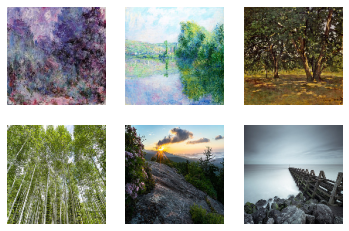

In [11]:
n_samples = 3

# plot source images
for i in range(n_samples): 
    plt.subplot(2, n_samples, 1 + i) 
    plt.axis("off") 
    plt.imshow(dataA[i].astype("int"))
 
# plot target image
for i in range(n_samples):
    plt.subplot(2, n_samples, 1 + n_samples + i) 
    plt.axis("off") 
    plt.imshow(dataB[i].astype("int"))   

In [0]:
# needed for instance normalization
!pip install -q  --no-deps tensorflow-addons~=0.7

In [0]:
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.optimizers import *
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
import tensorflow_addons as tfa

In [0]:
# define the discriminator model
def define_discriminator(image_shape):
    # source image input
    in_image = Input(shape=image_shape)

    # init
    init = RandomNormal(stddev=0.02)
    
    # C64
    d = Conv2D(64, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(in_image)
    d = LeakyReLU(alpha=0.2)(d)

    # C128
    d = Conv2D(128, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C256
    d = Conv2D(256, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C512
    d = Conv2D(512, (4,4), strides=(2,2), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(d)
    d = LeakyReLU(alpha=0.2)(d)

    # second last output layer
    d = Conv2D(512, (4,4), padding="same", kernel_initializer=init)(d) 
    d = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(d)
    d = LeakyReLU(alpha=0.2)(d)

    # patch output
    patch_out = Conv2D(1, (4,4), padding="same", kernel_initializer=init)(d) 
    
    # define model
    model = Model(in_image, patch_out)
    
    return model 

In [0]:
# generator a resnet block
def resnet_block(n_filters, input_layer):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    
    # first layer convolutional layer
    g = Conv2D(n_filters, (3,3), padding="same", kernel_initializer=init)(input_layer) 
    g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
    g = Activation("relu")(g)
    
    # second convolutional layer
    g = Conv2D(n_filters, (3,3), padding="same", kernel_initializer=init)(g) 
    g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
    
    # concatenate merge channel-wise with input layer
    g = Concatenate()([g, input_layer])
    
    return g

In [0]:
# define the standalone generator model
def define_generator(image_shape=(256,256,3), n_resnet=6):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# image input
	in_image = Input(shape=image_shape)

	# c7s1-64
	g = Conv2D(64, (7,7), padding='same', kernel_initializer=init)(in_image)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# d128
	g = Conv2D(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# d256
	g = Conv2D(256, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# R256
	for _ in range(n_resnet):
		g = resnet_block(256, g)

	# u128
	g = Conv2DTranspose(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# u64
	g = Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	g = Activation('relu')(g)

	# c7s1-3
	g = Conv2D(3, (7,7), padding='same', kernel_initializer=init)(g)
	g = tfa.layers.InstanceNormalization(axis=3, 
            center=True, 
            scale=True,
            beta_initializer="random_uniform",
            gamma_initializer="random_uniform")(g)
	out_image = Activation('tanh')(g)

	# define model
	model = Model(in_image, out_image)

	return model

In [17]:
# discriminator
discriminator = define_discriminator((128,128,3))
discriminator.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 128, 128, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 64, 64, 64)        3136      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 128)       131200    
_________________________________________________________________
instance_normalization (Inst (None, 32, 32, 128)       256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 256)       524544

In [18]:
# generator
generator = define_generator()
generator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 256, 256, 64) 9472        input_2[0][0]                    
__________________________________________________________________________________________________
instance_normalization_4 (Insta (None, 256, 256, 64) 128         conv2d_6[0][0]                   
__________________________________________________________________________________________________
activation (Activation)         (None, 256, 256, 64) 0           instance_normalization_4[0][0]   
____________________________________________________________________________________________

In [0]:
# # output omitted for brevity
# from tensorflow.keras.utils import plot_model
# plot_model(discriminator, "discriminator.png", show_shapes=True)
# plot_model(generator, "generator.png", show_shapes=True)

In [0]:
# input shape
image_shape = (128, 128, 3)

# generator: A -> B
g_model_AtoB = define_generator(image_shape, n_resnet=6)
# generator: B -> A
g_model_BtoA = define_generator(image_shape, n_resnet=6)

# discriminator: A -> [real/fake]
d_model_A = define_discriminator(image_shape)
# discriminator: B -> [real/fake]
d_model_B = define_discriminator(image_shape)

In [0]:
import tensorflow as tf

In [0]:
def real_mse_loss(D_out):
    mse = tf.keras.losses.MeanSquaredError()
    # how close is the produced output from being "real"?
    # label for real is 1
    ones = tf.ones_like(len(D_out), dtype=tf.float32)
    return mse(D_out, ones)

def fake_mse_loss(D_out):
    mse = tf.keras.losses.MeanSquaredError()
    # how close is the produced output from being "fake"?
    # label for fake is 0
    zeros = tf.zeros_like(len(D_out), dtype=tf.float32)
    return mse(D_out, zeros)

def cycle_consistency_loss(real_im, reconstructed_im, lambda_weight):
    mae = tf.keras.losses.MeanAbsoluteError()
    # calculate reconstruction loss 
    # as absolute value difference between the real and reconstructed images
    reconstr_loss = mae(real_im, reconstructed_im)
    # return weighted loss
    return lambda_weight*reconstr_loss 

In [0]:
# these values come from the original paper
###########################################

# hyperparams for Adam optimizer
lr=0.0002
beta1=0.5
beta2=0.999 # default value

# create optimizers for the generators and discriminators
g_AtoB_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
g_BtoA_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
d_model_A_opt = Adam(lr, beta_1=beta1, beta_2=beta2)
d_model_B_opt = Adam(lr, beta_1=beta1, beta_2=beta2)

In [0]:
@tf.function
def train_discriminator_A(dA, gBA, images_B, images_A, d_model_A_opt):
    with tf.GradientTape() as tape:
        # discriminator A
        dA_real_logits = dA(images_A)
        dA_real_loss = real_mse_loss(dA_real_logits)

        # discriminator A on fake stuff
        fake_A = gBA(images_B)
        dA_fake_logits = dA(fake_A)
        dA_fake_loss = fake_mse_loss(dA_fake_logits)

        # total dA loss
        total_dA_loss = dA_real_loss + dA_fake_loss

    # compute gradients and backprop
    dA_grads = tape.gradient(total_dA_loss, dA.trainable_variables)
    d_model_A_opt.apply_gradients(zip(dA_grads, dA.trainable_variables))

    return total_dA_loss

# <-------------------------------------------------------------------->

@tf.function
def train_discriminator_B(dB, gAB, images_A, images_B, d_model_B_opt):
    with tf.GradientTape() as tape:
        # discriminator B
        dB_real_logits = dB(images_B)
        dB_real_loss = real_mse_loss(dB_real_logits)

        # discriminator B on fake stuff
        fake_B = gAB(images_A)
        dB_fake_logits = dB(fake_B)
        dB_fake_loss = fake_mse_loss(dB_fake_logits)

        # total dA loss
        total_dB_loss = dB_real_loss + dB_fake_loss

    # compute gradients and backprop
    dB_grads = tape.gradient(total_dB_loss, dB.trainable_variables)
    d_model_B_opt.apply_gradients(zip(dB_grads, dB.trainable_variables))

    return total_dB_loss

In [0]:
@tf.function
def train_generator_AB(dB, gAB, gBA, images_A, images_B, g_AtoB_opt):
    ###### Generator AB ######
    #########################
    with tf.GradientTape() as tape:
        # generate images from domain A to domain B, compute loss (weight 1) via
        # discriminator B
        fake_B = gAB(images_A)
        dB_fake_logits = dB(fake_B)
        gAB_loss = real_mse_loss(dB_fake_logits)

        # identity loss (weight 5)
        identity_B = gAB(images_B)
        id_loss = cycle_consistency_loss(images_B, identity_B, 5)

        # cycle consistency loss (weight 10)
        reconstructed_A = gBA(fake_B)
        reconstructed_A_loss = cycle_consistency_loss(images_A, reconstructed_A, 10)

        # total loss
        total_gAB_loss = gAB_loss + id_loss + reconstructed_A_loss
    
    # compute gradients and backprop
    gAB_grads = tape.gradient(total_gAB_loss, gAB.trainable_variables)
    g_AtoB_opt.apply_gradients(zip(gAB_grads, gAB.trainable_variables))

    return total_gAB_loss
    
# <-------------------------------------------------------------------->

@tf.function
def train_generator_BA(dA, gBA, gAB, images_B, images_A, g_BtoA_opt):
    ###### Generator BA ######
    #########################
    with tf.GradientTape() as tape:
        # generate images from domain B to domain A, compute loss (weight 1) via
        # discriminator A
        fake_A = gBA(images_B)
        dA_fake_logits = dA(fake_A)
        gBA_loss = real_mse_loss(dA_fake_logits)

        # identity loss (weight 5)
        identity_A = gBA(images_A)
        id_loss = cycle_consistency_loss(images_A, identity_A, 5)

        # cycle consistency loss (weight 10)
        reconstructed_B = gAB(fake_A)
        reconstructed_B_loss = cycle_consistency_loss(images_B, reconstructed_B, 10)

        # total loss
        total_gBA_loss = gBA_loss + id_loss + reconstructed_B_loss
    
    # compute gradients and backprop
    gBA_grads = tape.gradient(total_gBA_loss, gBA.trainable_variables)
    g_BtoA_opt.apply_gradients(zip(gBA_grads, gBA.trainable_variables))

    return total_gBA_loss

In [0]:
# # check if everything works (should be run only once)

# sample_Images_A = dataA[32].reshape(1, 128, 128, 3)
# sample_Images_B = dataB[32].reshape(1, 128, 128, 3)

# print(train_discriminator_A(d_model_A, g_model_BtoA, sample_Images_B, sample_Images_A, d_model_A_opt))
# print(train_discriminator_B(d_model_B, g_model_AtoB, sample_Images_A, sample_Images_B, d_model_B_opt))

# print(train_generator_AB(d_model_B, g_model_AtoB, g_model_BtoA, sample_Images_A, sample_Images_B, g_AtoB_opt))
# print(train_generator_BA(d_model_A, g_model_BtoA, g_model_AtoB, sample_Images_B, sample_Images_A, g_BtoA_opt))

In [0]:
# select a random sample of images from the dataset
def select_sample(dataset, n_samples):
	# choose random instances
	ix = np.random.randint(0, dataset.shape[0], n_samples)
	# retrieve selected images
	X = dataset[ix]
	return X

# plot the image, the translation, and the reconstruction
def show_plot(imagesX, imagesY1, imagesY2):
	images = np.vstack((imagesX, imagesY1, imagesY2))
	titles = ['Real', 'Generated', 'Reconstructed']
	# scale from [-1,1] to [0,1]
	images = (images + 1) / 2.0
	# plot images row by row
	for i in range(len(images)):
		# define subplot
		plt.subplot(1, len(images), 1 + i)
		# turn off axis
		plt.axis('off')
		# plot raw pixel data
		plt.imshow(images[i])
		# title
		plt.title(titles[i])
	plt.show()
 
def show_model_progress(gAB, gBA, dataA, dataB):
	# A -> B -> A
	print("[INFO] Domain A to Domain B")
	real_A = select_sample(dataA, 1)
	B_generated  = gAB(real_A)
	A_reconstructed = gBA(B_generated)
	show_plot(real_A, B_generated, A_reconstructed)

	# B -> A -> B
	print("[INFO] Domain B to Domain A")
	real_B = select_sample(dataB, 1)
	A_generated  = gBA(real_B)
	B_reconstructed = gAB(A_generated)
	show_plot(real_B, A_generated, B_reconstructed)

Note that we are supposed to be using Instance Normalization during prediction time as well but not in the way Batch Normalization used. During inference, Batch Normalization uses statistics from training data (by keeping a track of mean and std. stats in form of exponential weighted moving average). This behavior is also referred to as **inference mode**. That is not the case when using Instance Normalization. This is clarified in the paper: https://arxiv.org/abs/1607.08022. In Keras, when you use `model.predict` (assuming the model was trained using Batch Normalization) it defaults to inference mode. I could not find a simple way to disable this behavior so, we are using the model directly on our data instead of using `model.predict`. This is something to keep in mind. 

In [0]:
# scale data to ([-1, 1]) and convert to TF Dataset
scaled_dataA = (dataA - 127.5) / 127.5
scaled_dataB = (dataB - 127.5) / 127.5
data_A_TF = tf.data.Dataset.from_tensor_slices(scaled_dataA).batch(16).prefetch(100)
data_B_TF = tf.data.Dataset.from_tensor_slices(scaled_dataB).batch(16).prefetch(100)

In [0]:
# metrics to keep track of the mean loss for each epoch
gen_AB_metric = tf.keras.metrics.Mean()
gen_BA_metric = tf.keras.metrics.Mean()
disc_A_metric = tf.keras.metrics.Mean()
disc_B_metric = tf.keras.metrics.Mean()

In [29]:
!nvidia-smi

Fri Mar 27 04:40:34 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.64.00    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    31W / 250W |    865MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
# constants
visualize_every = 50
epochs = 100
steps_per_epoch = min(len(dataA)//16, len(dataB)//16)

  0%|          | 0/100 [00:00<?, ?it/s]

epoch: 0 step: 0 dA_loss: 1.000 dB_loss: 0.868 gAB_loss :7.455 gBA_loss: 8.305
[INFO] Domain A to Domain B


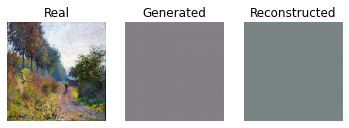

[INFO] Domain B to Domain A


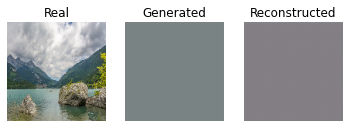

epoch: 0 step: 1 dA_loss: 0.898 dB_loss: 0.789 gAB_loss :7.310 gBA_loss: 7.707
epoch: 0 step: 2 dA_loss: 0.816 dB_loss: 0.724 gAB_loss :6.915 gBA_loss: 7.726
epoch: 0 step: 3 dA_loss: 0.748 dB_loss: 0.671 gAB_loss :6.907 gBA_loss: 7.603
epoch: 0 step: 4 dA_loss: 0.699 dB_loss: 0.633 gAB_loss :6.943 gBA_loss: 7.422
epoch: 0 step: 5 dA_loss: 0.657 dB_loss: 0.599 gAB_loss :7.142 gBA_loss: 7.534
epoch: 0 step: 6 dA_loss: 0.625 dB_loss: 0.572 gAB_loss :6.621 gBA_loss: 7.394
epoch: 0 step: 7 dA_loss: 0.590 dB_loss: 0.550 gAB_loss :6.696 gBA_loss: 7.206
epoch: 0 step: 8 dA_loss: 0.574 dB_loss: 0.534 gAB_loss :6.080 gBA_loss: 6.830
epoch: 0 step: 9 dA_loss: 0.554 dB_loss: 0.521 gAB_loss :6.206 gBA_loss: 6.827
epoch: 0 step: 10 dA_loss: 0.541 dB_loss: 0.512 gAB_loss :7.400 gBA_loss: 7.896
epoch: 0 step: 11 dA_loss: 0.532 dB_loss: 0.498 gAB_loss :6.416 gBA_loss: 6.976
epoch: 0 step: 12 dA_loss: 0.519 dB_loss: 0.502 gAB_loss :6.558 gBA_loss: 7.009
epoch: 0 step: 13 dA_loss: 0.513 dB_loss: 0.488 g

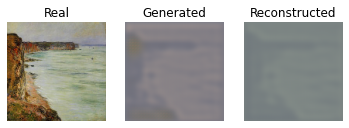

[INFO] Domain B to Domain A


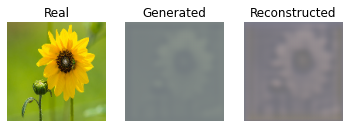

epoch: 0 step: 51 dA_loss: 0.029 dB_loss: 0.018 gAB_loss :7.200 gBA_loss: 7.550
epoch: 0 step: 52 dA_loss: 0.026 dB_loss: 0.021 gAB_loss :7.041 gBA_loss: 7.374
epoch: 0 step: 53 dA_loss: 0.024 dB_loss: 0.014 gAB_loss :6.867 gBA_loss: 7.453
epoch: 0 step: 54 dA_loss: 0.021 dB_loss: 0.020 gAB_loss :6.963 gBA_loss: 7.683
epoch: 0 step: 55 dA_loss: 0.018 dB_loss: 0.016 gAB_loss :7.167 gBA_loss: 7.357
epoch: 0 step: 56 dA_loss: 0.016 dB_loss: 0.012 gAB_loss :6.923 gBA_loss: 7.410
epoch: 0 step: 57 dA_loss: 0.015 dB_loss: 0.011 gAB_loss :6.970 gBA_loss: 7.395
epoch: 0 step: 58 dA_loss: 0.013 dB_loss: 0.009 gAB_loss :7.050 gBA_loss: 7.540
epoch: 0 step: 59 dA_loss: 0.012 dB_loss: 0.008 gAB_loss :6.983 gBA_loss: 7.374
epoch: 0 step: 60 dA_loss: 0.010 dB_loss: 0.007 gAB_loss :7.345 gBA_loss: 7.495
epoch: 0 step: 61 dA_loss: 0.009 dB_loss: 0.010 gAB_loss :6.849 gBA_loss: 7.440
epoch: 0 step: 62 dA_loss: 0.012 dB_loss: 0.008 gAB_loss :6.987 gBA_loss: 7.377
epoch: 0 step: 63 dA_loss: 0.008 dB_loss

  1%|          | 1/100 [02:16<3:44:53, 136.30s/it]

epoch: 0 step: 73 dA_loss: 0.003 dB_loss: 0.004 gAB_loss :6.914 gBA_loss: 7.714
epoch: 1 step: 0 dA_loss: 0.003 dB_loss: 0.003 gAB_loss :7.314 gBA_loss: 7.978
[INFO] Domain A to Domain B


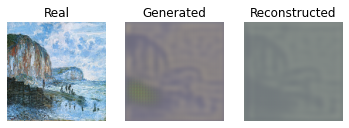

[INFO] Domain B to Domain A


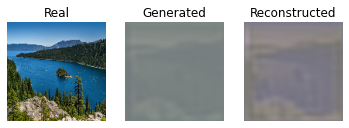

epoch: 1 step: 1 dA_loss: 0.003 dB_loss: 0.003 gAB_loss :7.251 gBA_loss: 7.481
epoch: 1 step: 2 dA_loss: 0.003 dB_loss: 0.003 gAB_loss :6.908 gBA_loss: 7.529
epoch: 1 step: 3 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :6.963 gBA_loss: 7.467
epoch: 1 step: 4 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :7.077 gBA_loss: 7.428
epoch: 1 step: 5 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :7.337 gBA_loss: 7.636
epoch: 1 step: 6 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :6.868 gBA_loss: 7.709
epoch: 1 step: 7 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :6.968 gBA_loss: 7.411
epoch: 1 step: 8 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :6.457 gBA_loss: 7.097
epoch: 1 step: 9 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :6.591 gBA_loss: 7.105
epoch: 1 step: 10 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :7.824 gBA_loss: 8.252
epoch: 1 step: 11 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :6.847 gBA_loss: 7.339
epoch: 1 step: 12 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :6.991 gBA_loss: 7.400
epoch: 1 step: 13 dA_loss: 0.002 dB_loss: 0.002 g

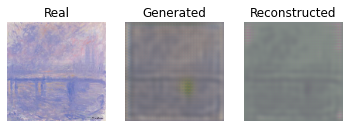

[INFO] Domain B to Domain A


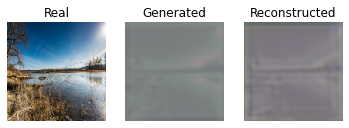

epoch: 1 step: 51 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :7.173 gBA_loss: 7.562
epoch: 1 step: 52 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.997 gBA_loss: 7.408
epoch: 1 step: 53 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.775 gBA_loss: 7.567
epoch: 1 step: 54 dA_loss: 0.000 dB_loss: 0.006 gAB_loss :6.787 gBA_loss: 7.917
epoch: 1 step: 55 dA_loss: 0.000 dB_loss: 0.025 gAB_loss :7.242 gBA_loss: 7.277
epoch: 1 step: 56 dA_loss: 0.000 dB_loss: 0.015 gAB_loss :6.813 gBA_loss: 7.301
epoch: 1 step: 57 dA_loss: 0.000 dB_loss: 0.020 gAB_loss :6.829 gBA_loss: 7.308
epoch: 1 step: 58 dA_loss: 0.000 dB_loss: 0.008 gAB_loss :6.894 gBA_loss: 7.441
epoch: 1 step: 59 dA_loss: 0.000 dB_loss: 0.015 gAB_loss :6.811 gBA_loss: 7.260
epoch: 1 step: 60 dA_loss: 0.000 dB_loss: 0.006 gAB_loss :7.197 gBA_loss: 7.376
epoch: 1 step: 61 dA_loss: 0.000 dB_loss: 0.006 gAB_loss :6.735 gBA_loss: 7.316
epoch: 1 step: 62 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :6.886 gBA_loss: 7.228
epoch: 1 step: 63 dA_loss: 0.000 dB_loss

  2%|▏         | 2/100 [03:55<3:24:12, 125.03s/it]

epoch: 1 step: 73 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.792 gBA_loss: 7.527
epoch: 2 step: 0 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :7.172 gBA_loss: 7.778
[INFO] Domain A to Domain B


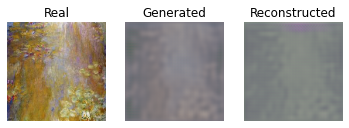

[INFO] Domain B to Domain A


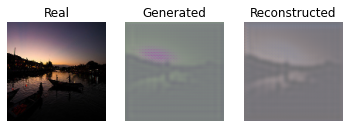

epoch: 2 step: 1 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :7.102 gBA_loss: 7.304
epoch: 2 step: 2 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.748 gBA_loss: 7.350
epoch: 2 step: 3 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.790 gBA_loss: 7.267
epoch: 2 step: 4 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.910 gBA_loss: 7.215
epoch: 2 step: 5 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :7.181 gBA_loss: 7.397
epoch: 2 step: 6 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.698 gBA_loss: 7.305
epoch: 2 step: 7 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.751 gBA_loss: 7.126
epoch: 2 step: 8 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.264 gBA_loss: 6.909
epoch: 2 step: 9 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.553 gBA_loss: 7.040
epoch: 2 step: 10 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :7.850 gBA_loss: 8.344
epoch: 2 step: 11 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.718 gBA_loss: 7.212
epoch: 2 step: 12 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :6.840 gBA_loss: 7.252
epoch: 2 step: 13 dA_loss: 0.001 dB_loss: 0.001 g

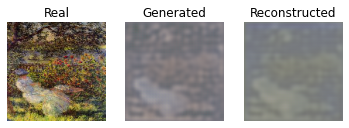

[INFO] Domain B to Domain A


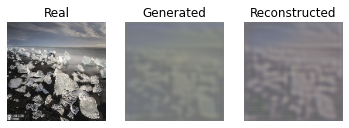

epoch: 2 step: 51 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :7.015 gBA_loss: 7.325
epoch: 2 step: 52 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :6.867 gBA_loss: 7.196
epoch: 2 step: 53 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.655 gBA_loss: 7.247
epoch: 2 step: 54 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :6.731 gBA_loss: 7.401
epoch: 2 step: 55 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.931 gBA_loss: 7.116
epoch: 2 step: 56 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.649 gBA_loss: 7.121
epoch: 2 step: 57 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.705 gBA_loss: 7.125
epoch: 2 step: 58 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.794 gBA_loss: 7.265
epoch: 2 step: 59 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.704 gBA_loss: 7.067
epoch: 2 step: 60 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :7.059 gBA_loss: 7.167
epoch: 2 step: 61 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.591 gBA_loss: 7.147
epoch: 2 step: 62 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.702 gBA_loss: 7.043
epoch: 2 step: 63 dA_loss: 0.000 dB_loss

  3%|▎         | 3/100 [05:33<3:09:08, 116.99s/it]

epoch: 2 step: 73 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.655 gBA_loss: 7.376
epoch: 3 step: 0 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :7.005 gBA_loss: 7.600
[INFO] Domain A to Domain B


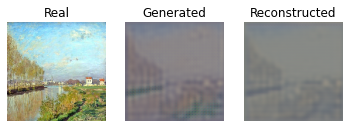

[INFO] Domain B to Domain A


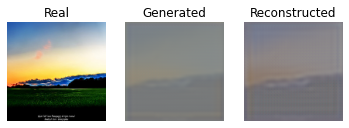

epoch: 3 step: 1 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.934 gBA_loss: 7.119
epoch: 3 step: 2 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.598 gBA_loss: 7.169
epoch: 3 step: 3 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.641 gBA_loss: 7.084
epoch: 3 step: 4 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.761 gBA_loss: 7.041
epoch: 3 step: 5 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :7.048 gBA_loss: 7.232
epoch: 3 step: 6 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.542 gBA_loss: 7.122
epoch: 3 step: 7 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.587 gBA_loss: 6.949
epoch: 3 step: 8 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.112 gBA_loss: 6.774
epoch: 3 step: 9 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.293 gBA_loss: 6.764
epoch: 3 step: 10 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :7.536 gBA_loss: 7.898
epoch: 3 step: 11 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.583 gBA_loss: 7.026
epoch: 3 step: 12 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.701 gBA_loss: 7.050
epoch: 3 step: 13 dA_loss: 0.000 dB_loss: 0.000 g

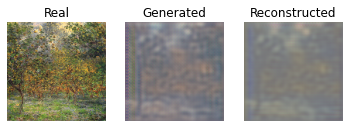

[INFO] Domain B to Domain A


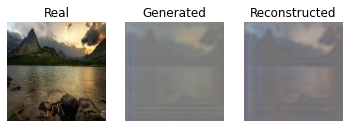

epoch: 3 step: 51 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.883 gBA_loss: 7.227
epoch: 3 step: 52 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.753 gBA_loss: 7.152
epoch: 3 step: 53 dA_loss: 0.000 dB_loss: 0.000 gAB_loss :6.583 gBA_loss: 7.145
epoch: 3 step: 54 dA_loss: 0.000 dB_loss: 0.006 gAB_loss :6.395 gBA_loss: 7.275
epoch: 3 step: 55 dA_loss: 0.000 dB_loss: 0.072 gAB_loss :6.946 gBA_loss: 7.038
epoch: 3 step: 56 dA_loss: 0.000 dB_loss: 0.532 gAB_loss :5.907 gBA_loss: 6.963
epoch: 3 step: 57 dA_loss: 0.000 dB_loss: 0.437 gAB_loss :6.236 gBA_loss: 6.971
epoch: 3 step: 58 dA_loss: 0.000 dB_loss: 0.274 gAB_loss :6.500 gBA_loss: 7.114
epoch: 3 step: 59 dA_loss: 0.000 dB_loss: 0.126 gAB_loss :6.524 gBA_loss: 6.920
epoch: 3 step: 60 dA_loss: 0.000 dB_loss: 0.047 gAB_loss :6.848 gBA_loss: 7.096
epoch: 3 step: 61 dA_loss: 0.000 dB_loss: 0.066 gAB_loss :6.505 gBA_loss: 7.062
epoch: 3 step: 62 dA_loss: 0.000 dB_loss: 0.017 gAB_loss :6.576 gBA_loss: 6.886
epoch: 3 step: 63 dA_loss: 0.000 dB_loss

  4%|▍         | 4/100 [07:11<2:58:15, 111.41s/it]

epoch: 3 step: 73 dA_loss: 0.000 dB_loss: 0.175 gAB_loss :6.936 gBA_loss: 7.298
epoch: 4 step: 0 dA_loss: 0.000 dB_loss: 0.032 gAB_loss :7.049 gBA_loss: 7.452
[INFO] Domain A to Domain B


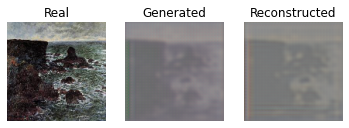

[INFO] Domain B to Domain A


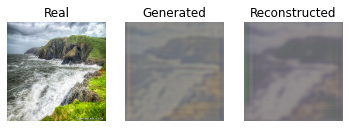

epoch: 4 step: 1 dA_loss: 0.000 dB_loss: 0.098 gAB_loss :6.857 gBA_loss: 6.980
epoch: 4 step: 2 dA_loss: 0.000 dB_loss: 0.016 gAB_loss :6.424 gBA_loss: 7.017
epoch: 4 step: 3 dA_loss: 0.000 dB_loss: 0.011 gAB_loss :6.473 gBA_loss: 6.932
epoch: 4 step: 4 dA_loss: 0.000 dB_loss: 0.006 gAB_loss :6.613 gBA_loss: 6.885
epoch: 4 step: 5 dA_loss: 0.000 dB_loss: 0.004 gAB_loss :6.924 gBA_loss: 7.062
epoch: 4 step: 6 dA_loss: 0.000 dB_loss: 0.004 gAB_loss :6.400 gBA_loss: 6.907
epoch: 4 step: 7 dA_loss: 0.000 dB_loss: 0.005 gAB_loss :6.421 gBA_loss: 6.731
epoch: 4 step: 8 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :5.984 gBA_loss: 6.616
epoch: 4 step: 9 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :6.161 gBA_loss: 6.596
epoch: 4 step: 10 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :7.399 gBA_loss: 7.731
epoch: 4 step: 11 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :6.464 gBA_loss: 6.864
epoch: 4 step: 12 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :6.564 gBA_loss: 6.873
epoch: 4 step: 13 dA_loss: 0.000 dB_loss: 0.004 g

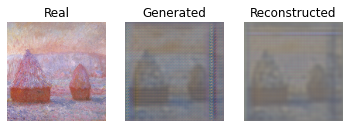

[INFO] Domain B to Domain A


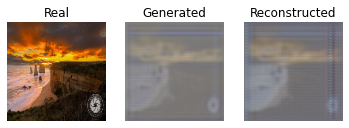

epoch: 4 step: 51 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.837 gBA_loss: 7.119
epoch: 4 step: 52 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.682 gBA_loss: 7.068
epoch: 4 step: 53 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.461 gBA_loss: 7.139
epoch: 4 step: 54 dA_loss: 0.001 dB_loss: 0.017 gAB_loss :6.459 gBA_loss: 7.140
epoch: 4 step: 55 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :6.816 gBA_loss: 6.921
epoch: 4 step: 56 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.487 gBA_loss: 6.829
epoch: 4 step: 57 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.485 gBA_loss: 6.863
epoch: 4 step: 58 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.558 gBA_loss: 7.062
epoch: 4 step: 59 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :6.508 gBA_loss: 6.795
epoch: 4 step: 60 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.831 gBA_loss: 6.884
epoch: 4 step: 61 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.380 gBA_loss: 6.898
epoch: 4 step: 62 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.464 gBA_loss: 6.759
epoch: 4 step: 63 dA_loss: 0.004 dB_loss

  5%|▌         | 5/100 [08:49<2:50:10, 107.48s/it]

epoch: 4 step: 73 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :6.464 gBA_loss: 7.107
epoch: 5 step: 0 dA_loss: 0.191 dB_loss: 0.001 gAB_loss :6.806 gBA_loss: 7.545
[INFO] Domain A to Domain B


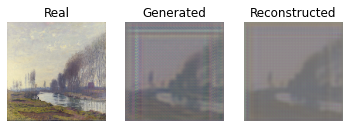

[INFO] Domain B to Domain A


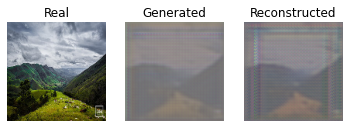

epoch: 5 step: 1 dA_loss: 0.046 dB_loss: 0.002 gAB_loss :6.728 gBA_loss: 7.059
epoch: 5 step: 2 dA_loss: 0.264 dB_loss: 0.001 gAB_loss :6.368 gBA_loss: 6.891
epoch: 5 step: 3 dA_loss: 0.011 dB_loss: 0.001 gAB_loss :6.381 gBA_loss: 6.719
epoch: 5 step: 4 dA_loss: 0.013 dB_loss: 0.002 gAB_loss :6.513 gBA_loss: 6.712
epoch: 5 step: 5 dA_loss: 0.009 dB_loss: 0.001 gAB_loss :6.828 gBA_loss: 6.918
epoch: 5 step: 6 dA_loss: 0.010 dB_loss: 0.002 gAB_loss :6.304 gBA_loss: 6.790
epoch: 5 step: 7 dA_loss: 0.005 dB_loss: 0.008 gAB_loss :6.290 gBA_loss: 6.631
epoch: 5 step: 8 dA_loss: 0.038 dB_loss: 0.002 gAB_loss :5.904 gBA_loss: 6.538
epoch: 5 step: 9 dA_loss: 0.004 dB_loss: 0.006 gAB_loss :6.170 gBA_loss: 6.489
epoch: 5 step: 10 dA_loss: 0.004 dB_loss: 0.002 gAB_loss :7.377 gBA_loss: 7.627
epoch: 5 step: 11 dA_loss: 0.004 dB_loss: 0.002 gAB_loss :6.417 gBA_loss: 6.787
epoch: 5 step: 12 dA_loss: 0.005 dB_loss: 0.002 gAB_loss :6.469 gBA_loss: 6.820
epoch: 5 step: 13 dA_loss: 0.003 dB_loss: 0.003 g

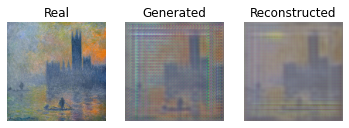

[INFO] Domain B to Domain A


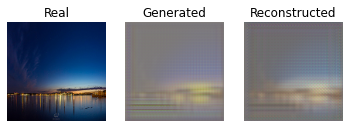

epoch: 5 step: 51 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.690 gBA_loss: 6.937
epoch: 5 step: 52 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.528 gBA_loss: 6.948
epoch: 5 step: 53 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.319 gBA_loss: 6.827
epoch: 5 step: 54 dA_loss: 0.001 dB_loss: 0.034 gAB_loss :6.077 gBA_loss: 6.973
epoch: 5 step: 55 dA_loss: 0.001 dB_loss: 0.281 gAB_loss :7.000 gBA_loss: 6.788
epoch: 5 step: 56 dA_loss: 0.001 dB_loss: 0.146 gAB_loss :6.499 gBA_loss: 6.639
epoch: 5 step: 57 dA_loss: 0.002 dB_loss: 0.052 gAB_loss :6.376 gBA_loss: 6.706
epoch: 5 step: 58 dA_loss: 0.001 dB_loss: 0.018 gAB_loss :6.369 gBA_loss: 6.873
epoch: 5 step: 59 dA_loss: 0.001 dB_loss: 0.018 gAB_loss :6.272 gBA_loss: 6.623
epoch: 5 step: 60 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :6.663 gBA_loss: 6.687
epoch: 5 step: 61 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :6.240 gBA_loss: 6.706
epoch: 5 step: 62 dA_loss: 0.002 dB_loss: 0.003 gAB_loss :6.327 gBA_loss: 6.537
epoch: 5 step: 63 dA_loss: 0.006 dB_loss

  6%|▌         | 6/100 [10:28<2:44:04, 104.73s/it]

epoch: 5 step: 73 dA_loss: 0.006 dB_loss: 0.164 gAB_loss :6.759 gBA_loss: 7.082
epoch: 6 step: 0 dA_loss: 0.002 dB_loss: 0.096 gAB_loss :6.880 gBA_loss: 7.157
[INFO] Domain A to Domain B


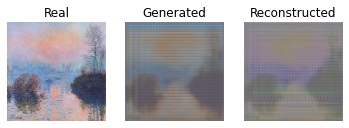

[INFO] Domain B to Domain A


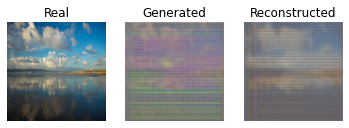

epoch: 6 step: 1 dA_loss: 0.009 dB_loss: 0.138 gAB_loss :6.699 gBA_loss: 6.798
epoch: 6 step: 2 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :6.209 gBA_loss: 6.841
epoch: 6 step: 3 dA_loss: 0.002 dB_loss: 0.016 gAB_loss :6.171 gBA_loss: 6.687
epoch: 6 step: 4 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :6.285 gBA_loss: 6.604
epoch: 6 step: 5 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :6.610 gBA_loss: 6.743
epoch: 6 step: 6 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :6.135 gBA_loss: 6.569
epoch: 6 step: 7 dA_loss: 0.000 dB_loss: 0.017 gAB_loss :6.069 gBA_loss: 6.392
epoch: 6 step: 8 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :5.689 gBA_loss: 6.386
epoch: 6 step: 9 dA_loss: 0.000 dB_loss: 0.004 gAB_loss :5.915 gBA_loss: 6.339
epoch: 6 step: 10 dA_loss: 0.000 dB_loss: 0.004 gAB_loss :7.194 gBA_loss: 7.503
epoch: 6 step: 11 dA_loss: 0.000 dB_loss: 0.003 gAB_loss :6.272 gBA_loss: 6.657
epoch: 6 step: 12 dA_loss: 0.000 dB_loss: 0.055 gAB_loss :6.260 gBA_loss: 6.719
epoch: 6 step: 13 dA_loss: 0.001 dB_loss: 0.047 g

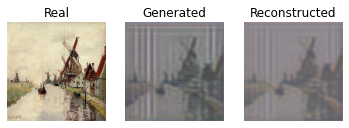

[INFO] Domain B to Domain A


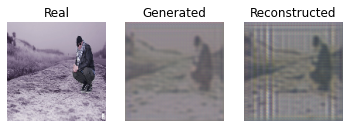

epoch: 6 step: 51 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.514 gBA_loss: 6.758
epoch: 6 step: 52 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.379 gBA_loss: 6.669
epoch: 6 step: 53 dA_loss: 0.007 dB_loss: 0.001 gAB_loss :6.087 gBA_loss: 6.570
epoch: 6 step: 54 dA_loss: 0.000 dB_loss: 0.061 gAB_loss :6.138 gBA_loss: 6.629
epoch: 6 step: 55 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :6.390 gBA_loss: 6.541
epoch: 6 step: 56 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.081 gBA_loss: 6.451
epoch: 6 step: 57 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.126 gBA_loss: 6.488
epoch: 6 step: 58 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.264 gBA_loss: 6.662
epoch: 6 step: 59 dA_loss: 0.000 dB_loss: 0.003 gAB_loss :6.137 gBA_loss: 6.426
epoch: 6 step: 60 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.491 gBA_loss: 6.547
epoch: 6 step: 61 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :6.097 gBA_loss: 6.570
epoch: 6 step: 62 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :6.188 gBA_loss: 6.380
epoch: 6 step: 63 dA_loss: 0.007 dB_loss

  7%|▋         | 7/100 [12:06<2:39:31, 102.91s/it]

epoch: 6 step: 73 dA_loss: 0.002 dB_loss: 0.007 gAB_loss :6.259 gBA_loss: 6.815
epoch: 7 step: 0 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :6.538 gBA_loss: 6.939
[INFO] Domain A to Domain B


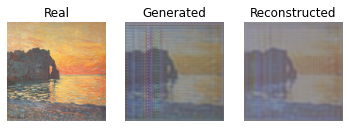

[INFO] Domain B to Domain A


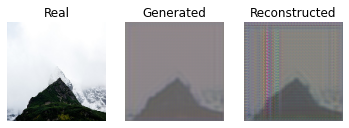

epoch: 7 step: 1 dA_loss: 0.003 dB_loss: 0.010 gAB_loss :6.441 gBA_loss: 6.509
epoch: 7 step: 2 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.097 gBA_loss: 6.606
epoch: 7 step: 3 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.101 gBA_loss: 6.517
epoch: 7 step: 4 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.230 gBA_loss: 6.479
epoch: 7 step: 5 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.534 gBA_loss: 6.604
epoch: 7 step: 6 dA_loss: 0.000 dB_loss: 0.002 gAB_loss :6.010 gBA_loss: 6.429
epoch: 7 step: 7 dA_loss: 0.001 dB_loss: 0.006 gAB_loss :5.903 gBA_loss: 6.228
epoch: 7 step: 8 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :5.617 gBA_loss: 6.227
epoch: 7 step: 9 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.815 gBA_loss: 6.158
epoch: 7 step: 10 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :7.088 gBA_loss: 7.340
epoch: 7 step: 11 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.122 gBA_loss: 6.494
epoch: 7 step: 12 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.201 gBA_loss: 6.466
epoch: 7 step: 13 dA_loss: 0.000 dB_loss: 0.001 g

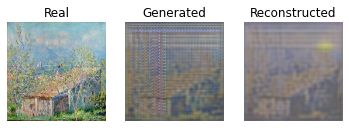

[INFO] Domain B to Domain A


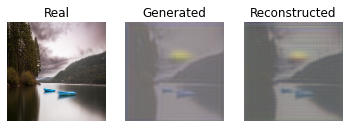

epoch: 7 step: 51 dA_loss: 0.009 dB_loss: 0.001 gAB_loss :6.451 gBA_loss: 6.634
epoch: 7 step: 52 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :6.313 gBA_loss: 6.571
epoch: 7 step: 53 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.034 gBA_loss: 6.486
epoch: 7 step: 54 dA_loss: 0.002 dB_loss: 0.062 gAB_loss :6.026 gBA_loss: 6.499
epoch: 7 step: 55 dA_loss: 0.001 dB_loss: 0.004 gAB_loss :6.272 gBA_loss: 6.456
epoch: 7 step: 56 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :6.026 gBA_loss: 6.318
epoch: 7 step: 57 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.080 gBA_loss: 6.345
epoch: 7 step: 58 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.197 gBA_loss: 6.491
epoch: 7 step: 59 dA_loss: 0.011 dB_loss: 0.002 gAB_loss :6.035 gBA_loss: 6.193
epoch: 7 step: 60 dA_loss: 0.011 dB_loss: 0.001 gAB_loss :6.378 gBA_loss: 6.356
epoch: 7 step: 61 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.951 gBA_loss: 6.443
epoch: 7 step: 62 dA_loss: 0.063 dB_loss: 0.001 gAB_loss :6.017 gBA_loss: 6.186
epoch: 7 step: 63 dA_loss: 0.032 dB_loss

  8%|▊         | 8/100 [13:45<2:35:39, 101.52s/it]

epoch: 7 step: 73 dA_loss: 0.024 dB_loss: 0.005 gAB_loss :6.065 gBA_loss: 6.618
epoch: 8 step: 0 dA_loss: 0.004 dB_loss: 0.002 gAB_loss :6.370 gBA_loss: 6.715
[INFO] Domain A to Domain B


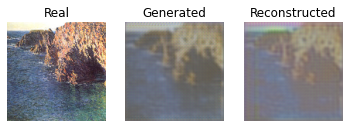

[INFO] Domain B to Domain A


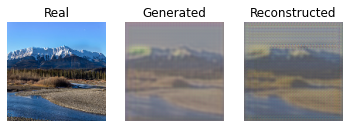

epoch: 8 step: 1 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :6.308 gBA_loss: 6.316
epoch: 8 step: 2 dA_loss: 0.006 dB_loss: 0.001 gAB_loss :5.987 gBA_loss: 6.419
epoch: 8 step: 3 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.984 gBA_loss: 6.309
epoch: 8 step: 4 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :6.128 gBA_loss: 6.325
epoch: 8 step: 5 dA_loss: 0.011 dB_loss: 0.001 gAB_loss :6.426 gBA_loss: 6.574
epoch: 8 step: 6 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :5.899 gBA_loss: 6.423
epoch: 8 step: 7 dA_loss: 0.004 dB_loss: 0.027 gAB_loss :5.451 gBA_loss: 6.172
epoch: 8 step: 8 dA_loss: 0.002 dB_loss: 0.266 gAB_loss :5.800 gBA_loss: 6.155
epoch: 8 step: 9 dA_loss: 0.002 dB_loss: 1.044 gAB_loss :5.595 gBA_loss: 6.034
epoch: 8 step: 10 dA_loss: 0.001 dB_loss: 0.415 gAB_loss :6.530 gBA_loss: 7.200
epoch: 8 step: 11 dA_loss: 0.001 dB_loss: 0.164 gAB_loss :5.469 gBA_loss: 6.281
epoch: 8 step: 12 dA_loss: 0.001 dB_loss: 0.193 gAB_loss :5.563 gBA_loss: 6.269
epoch: 8 step: 13 dA_loss: 0.000 dB_loss: 0.131 g

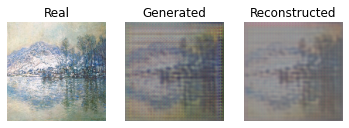

[INFO] Domain B to Domain A


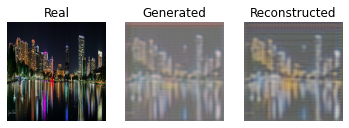

epoch: 8 step: 51 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :6.304 gBA_loss: 6.477
epoch: 8 step: 52 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.163 gBA_loss: 6.436
epoch: 8 step: 53 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.859 gBA_loss: 6.317
epoch: 8 step: 54 dA_loss: 0.000 dB_loss: 0.062 gAB_loss :5.880 gBA_loss: 6.351
epoch: 8 step: 55 dA_loss: 0.000 dB_loss: 0.006 gAB_loss :6.157 gBA_loss: 6.317
epoch: 8 step: 56 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :5.840 gBA_loss: 6.207
epoch: 8 step: 57 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :5.904 gBA_loss: 6.260
epoch: 8 step: 58 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.071 gBA_loss: 6.436
epoch: 8 step: 59 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :5.953 gBA_loss: 6.148
epoch: 8 step: 60 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.283 gBA_loss: 6.264
epoch: 8 step: 61 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.865 gBA_loss: 6.344
epoch: 8 step: 62 dA_loss: 0.053 dB_loss: 0.001 gAB_loss :5.929 gBA_loss: 6.020
epoch: 8 step: 63 dA_loss: 0.029 dB_loss

  9%|▉         | 9/100 [15:23<2:32:26, 100.51s/it]

epoch: 8 step: 73 dA_loss: 0.048 dB_loss: 0.045 gAB_loss :6.144 gBA_loss: 6.499
epoch: 9 step: 0 dA_loss: 0.005 dB_loss: 0.006 gAB_loss :6.365 gBA_loss: 6.569
[INFO] Domain A to Domain B


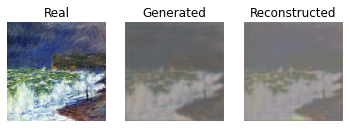

[INFO] Domain B to Domain A


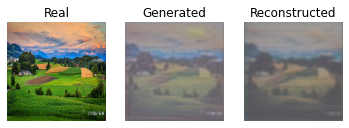

epoch: 9 step: 1 dA_loss: 0.004 dB_loss: 0.016 gAB_loss :6.221 gBA_loss: 6.161
epoch: 9 step: 2 dA_loss: 0.003 dB_loss: 0.004 gAB_loss :5.865 gBA_loss: 6.242
epoch: 9 step: 3 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :5.820 gBA_loss: 6.114
epoch: 9 step: 4 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.953 gBA_loss: 6.133
epoch: 9 step: 5 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.254 gBA_loss: 6.272
epoch: 9 step: 6 dA_loss: 0.001 dB_loss: 0.007 gAB_loss :5.704 gBA_loss: 6.067
epoch: 9 step: 7 dA_loss: 0.001 dB_loss: 0.061 gAB_loss :5.586 gBA_loss: 5.833
epoch: 9 step: 8 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :5.271 gBA_loss: 5.927
epoch: 9 step: 9 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :5.471 gBA_loss: 5.837
epoch: 9 step: 10 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.762 gBA_loss: 7.028
epoch: 9 step: 11 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :5.832 gBA_loss: 6.122
epoch: 9 step: 12 dA_loss: 0.000 dB_loss: 0.012 gAB_loss :5.868 gBA_loss: 6.112
epoch: 9 step: 13 dA_loss: 0.000 dB_loss: 0.033 g

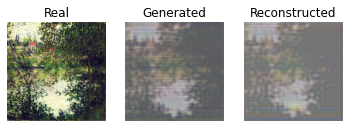

[INFO] Domain B to Domain A


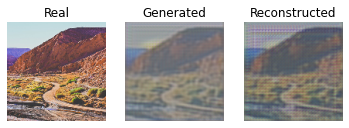

epoch: 9 step: 51 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.217 gBA_loss: 6.373
epoch: 9 step: 52 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :6.086 gBA_loss: 6.351
epoch: 9 step: 53 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.769 gBA_loss: 6.194
epoch: 9 step: 54 dA_loss: 0.001 dB_loss: 0.067 gAB_loss :5.815 gBA_loss: 6.210
epoch: 9 step: 55 dA_loss: 0.001 dB_loss: 0.008 gAB_loss :6.114 gBA_loss: 6.235
epoch: 9 step: 56 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :5.755 gBA_loss: 6.089
epoch: 9 step: 57 dA_loss: 0.001 dB_loss: 0.005 gAB_loss :5.806 gBA_loss: 6.134
epoch: 9 step: 58 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.990 gBA_loss: 6.293
epoch: 9 step: 59 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.868 gBA_loss: 5.989
epoch: 9 step: 60 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.183 gBA_loss: 6.061
epoch: 9 step: 61 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.783 gBA_loss: 6.157
epoch: 9 step: 62 dA_loss: 0.029 dB_loss: 0.001 gAB_loss :5.802 gBA_loss: 5.828
epoch: 9 step: 63 dA_loss: 0.053 dB_loss

 10%|█         | 10/100 [17:01<2:29:44, 99.83s/it]

epoch: 9 step: 73 dA_loss: 0.057 dB_loss: 0.085 gAB_loss :6.047 gBA_loss: 6.422
epoch: 10 step: 0 dA_loss: 0.098 dB_loss: 0.006 gAB_loss :6.329 gBA_loss: 6.753
[INFO] Domain A to Domain B


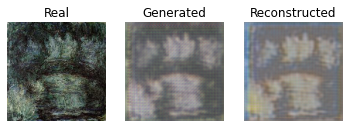

[INFO] Domain B to Domain A


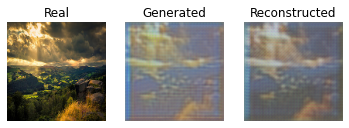

epoch: 10 step: 1 dA_loss: 0.014 dB_loss: 0.291 gAB_loss :6.041 gBA_loss: 6.319
epoch: 10 step: 2 dA_loss: 0.088 dB_loss: 0.007 gAB_loss :5.653 gBA_loss: 6.232
epoch: 10 step: 3 dA_loss: 0.004 dB_loss: 0.011 gAB_loss :5.598 gBA_loss: 5.999
epoch: 10 step: 4 dA_loss: 0.005 dB_loss: 0.008 gAB_loss :5.751 gBA_loss: 5.989
epoch: 10 step: 5 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :6.088 gBA_loss: 6.138
epoch: 10 step: 6 dA_loss: 0.007 dB_loss: 0.007 gAB_loss :5.623 gBA_loss: 5.932
epoch: 10 step: 7 dA_loss: 0.002 dB_loss: 0.062 gAB_loss :5.508 gBA_loss: 5.709
epoch: 10 step: 8 dA_loss: 0.031 dB_loss: 0.001 gAB_loss :5.225 gBA_loss: 5.820
epoch: 10 step: 9 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :5.399 gBA_loss: 5.693
epoch: 10 step: 10 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :6.688 gBA_loss: 6.907
epoch: 10 step: 11 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :5.752 gBA_loss: 6.013
epoch: 10 step: 12 dA_loss: 0.001 dB_loss: 0.040 gAB_loss :5.737 gBA_loss: 6.004
epoch: 10 step: 13 dA_loss: 0.003 dB_

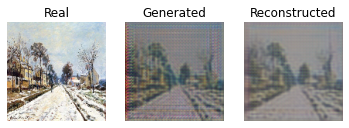

[INFO] Domain B to Domain A


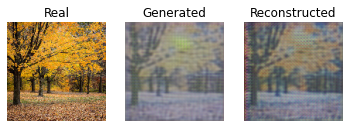

epoch: 10 step: 51 dA_loss: 0.070 dB_loss: 0.002 gAB_loss :6.182 gBA_loss: 6.325
epoch: 10 step: 52 dA_loss: 0.050 dB_loss: 0.001 gAB_loss :6.037 gBA_loss: 6.234
epoch: 10 step: 53 dA_loss: 0.059 dB_loss: 0.002 gAB_loss :5.651 gBA_loss: 5.965
epoch: 10 step: 54 dA_loss: 0.004 dB_loss: 0.067 gAB_loss :5.664 gBA_loss: 5.972
epoch: 10 step: 55 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :5.991 gBA_loss: 6.084
epoch: 10 step: 56 dA_loss: 0.032 dB_loss: 0.003 gAB_loss :5.623 gBA_loss: 5.874
epoch: 10 step: 57 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :5.675 gBA_loss: 5.946
epoch: 10 step: 58 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :5.850 gBA_loss: 6.126
epoch: 10 step: 59 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :5.714 gBA_loss: 5.838
epoch: 10 step: 60 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.049 gBA_loss: 5.931
epoch: 10 step: 61 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.648 gBA_loss: 6.034
epoch: 10 step: 62 dA_loss: 0.065 dB_loss: 0.001 gAB_loss :5.687 gBA_loss: 5.761
epoch: 10 step: 63 dA_loss: 

 11%|█         | 11/100 [18:39<2:27:21, 99.35s/it]

epoch: 10 step: 73 dA_loss: 0.022 dB_loss: 0.073 gAB_loss :5.931 gBA_loss: 6.298
epoch: 11 step: 0 dA_loss: 0.006 dB_loss: 0.004 gAB_loss :6.120 gBA_loss: 6.349
[INFO] Domain A to Domain B


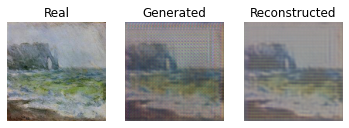

[INFO] Domain B to Domain A


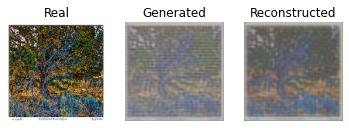

epoch: 11 step: 1 dA_loss: 0.024 dB_loss: 0.116 gAB_loss :5.930 gBA_loss: 6.011
epoch: 11 step: 2 dA_loss: 0.004 dB_loss: 0.004 gAB_loss :5.565 gBA_loss: 6.101
epoch: 11 step: 3 dA_loss: 0.001 dB_loss: 0.014 gAB_loss :5.483 gBA_loss: 5.930
epoch: 11 step: 4 dA_loss: 0.001 dB_loss: 0.016 gAB_loss :5.762 gBA_loss: 5.939
epoch: 11 step: 5 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.079 gBA_loss: 6.035
epoch: 11 step: 6 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :5.560 gBA_loss: 5.788
epoch: 11 step: 7 dA_loss: 0.000 dB_loss: 0.064 gAB_loss :5.365 gBA_loss: 5.557
epoch: 11 step: 8 dA_loss: 0.005 dB_loss: 0.001 gAB_loss :5.086 gBA_loss: 5.738
epoch: 11 step: 9 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :5.265 gBA_loss: 5.603
epoch: 11 step: 10 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :6.572 gBA_loss: 6.804
epoch: 11 step: 11 dA_loss: 0.000 dB_loss: 0.001 gAB_loss :5.645 gBA_loss: 5.920
epoch: 11 step: 12 dA_loss: 0.000 dB_loss: 0.054 gAB_loss :5.635 gBA_loss: 5.884
epoch: 11 step: 13 dA_loss: 0.000 dB_

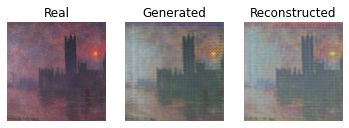

[INFO] Domain B to Domain A


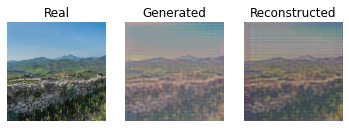

epoch: 11 step: 51 dA_loss: 0.009 dB_loss: 0.001 gAB_loss :6.070 gBA_loss: 6.264
epoch: 11 step: 52 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.911 gBA_loss: 6.225
epoch: 11 step: 53 dA_loss: 0.039 dB_loss: 0.002 gAB_loss :5.517 gBA_loss: 5.859
epoch: 11 step: 54 dA_loss: 0.007 dB_loss: 0.063 gAB_loss :5.573 gBA_loss: 5.868
epoch: 11 step: 55 dA_loss: 0.059 dB_loss: 0.009 gAB_loss :5.941 gBA_loss: 6.198
epoch: 11 step: 56 dA_loss: 0.050 dB_loss: 0.003 gAB_loss :5.566 gBA_loss: 5.928
epoch: 11 step: 57 dA_loss: 0.009 dB_loss: 0.002 gAB_loss :5.595 gBA_loss: 5.898
epoch: 11 step: 58 dA_loss: 0.004 dB_loss: 0.001 gAB_loss :5.744 gBA_loss: 6.032
epoch: 11 step: 59 dA_loss: 0.014 dB_loss: 0.006 gAB_loss :5.577 gBA_loss: 5.710
epoch: 11 step: 60 dA_loss: 0.006 dB_loss: 0.001 gAB_loss :5.914 gBA_loss: 5.811
epoch: 11 step: 61 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :5.529 gBA_loss: 5.937
epoch: 11 step: 62 dA_loss: 0.066 dB_loss: 0.002 gAB_loss :5.580 gBA_loss: 5.661
epoch: 11 step: 63 dA_loss: 

 12%|█▏        | 12/100 [20:18<2:25:11, 99.00s/it]

epoch: 11 step: 73 dA_loss: 0.002 dB_loss: 0.143 gAB_loss :5.804 gBA_loss: 6.215
epoch: 12 step: 0 dA_loss: 0.007 dB_loss: 0.005 gAB_loss :6.025 gBA_loss: 6.247
[INFO] Domain A to Domain B


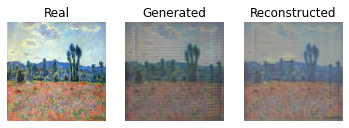

[INFO] Domain B to Domain A


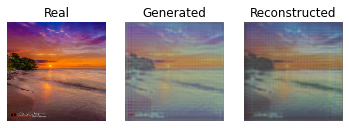

epoch: 12 step: 1 dA_loss: 0.009 dB_loss: 0.245 gAB_loss :5.839 gBA_loss: 5.909
epoch: 12 step: 2 dA_loss: 0.060 dB_loss: 0.042 gAB_loss :5.479 gBA_loss: 5.970
epoch: 12 step: 3 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :5.382 gBA_loss: 5.819
epoch: 12 step: 4 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :5.561 gBA_loss: 5.853
epoch: 12 step: 5 dA_loss: 0.020 dB_loss: 0.008 gAB_loss :5.921 gBA_loss: 5.908
epoch: 12 step: 6 dA_loss: 0.059 dB_loss: 0.006 gAB_loss :5.487 gBA_loss: 5.844
epoch: 12 step: 7 dA_loss: 0.003 dB_loss: 0.064 gAB_loss :5.285 gBA_loss: 5.542
epoch: 12 step: 8 dA_loss: 0.034 dB_loss: 0.001 gAB_loss :5.039 gBA_loss: 5.693
epoch: 12 step: 9 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :5.205 gBA_loss: 5.495
epoch: 12 step: 10 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :6.503 gBA_loss: 6.700
epoch: 12 step: 11 dA_loss: 0.001 dB_loss: 0.000 gAB_loss :5.584 gBA_loss: 5.809
epoch: 12 step: 12 dA_loss: 0.001 dB_loss: 0.043 gAB_loss :5.549 gBA_loss: 5.787
epoch: 12 step: 13 dA_loss: 0.001 dB_

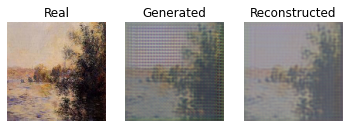

[INFO] Domain B to Domain A


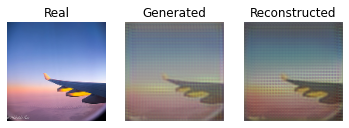

epoch: 12 step: 51 dA_loss: 0.040 dB_loss: 0.001 gAB_loss :5.955 gBA_loss: 6.115
epoch: 12 step: 52 dA_loss: 0.003 dB_loss: 0.003 gAB_loss :5.861 gBA_loss: 6.111
epoch: 12 step: 53 dA_loss: 0.054 dB_loss: 0.001 gAB_loss :5.484 gBA_loss: 5.790
epoch: 12 step: 54 dA_loss: 0.005 dB_loss: 0.067 gAB_loss :5.519 gBA_loss: 5.762
epoch: 12 step: 55 dA_loss: 0.013 dB_loss: 0.033 gAB_loss :5.785 gBA_loss: 6.068
epoch: 12 step: 56 dA_loss: 0.048 dB_loss: 0.142 gAB_loss :5.671 gBA_loss: 5.744
epoch: 12 step: 57 dA_loss: 0.001 dB_loss: 0.421 gAB_loss :5.476 gBA_loss: 5.764
epoch: 12 step: 58 dA_loss: 0.001 dB_loss: 0.066 gAB_loss :5.502 gBA_loss: 5.904
epoch: 12 step: 59 dA_loss: 0.007 dB_loss: 0.056 gAB_loss :5.253 gBA_loss: 5.611
epoch: 12 step: 60 dA_loss: 0.002 dB_loss: 0.032 gAB_loss :5.627 gBA_loss: 5.727
epoch: 12 step: 61 dA_loss: 0.001 dB_loss: 0.024 gAB_loss :5.350 gBA_loss: 5.873
epoch: 12 step: 62 dA_loss: 0.065 dB_loss: 0.037 gAB_loss :5.427 gBA_loss: 5.560
epoch: 12 step: 63 dA_loss: 

 13%|█▎        | 13/100 [21:56<2:23:12, 98.76s/it]

epoch: 12 step: 73 dA_loss: 0.015 dB_loss: 0.049 gAB_loss :5.698 gBA_loss: 6.080
epoch: 13 step: 0 dA_loss: 0.085 dB_loss: 0.002 gAB_loss :5.934 gBA_loss: 6.246
[INFO] Domain A to Domain B


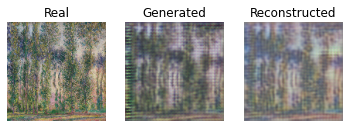

[INFO] Domain B to Domain A


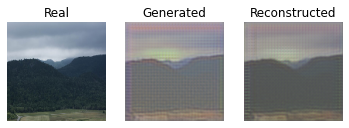

epoch: 13 step: 1 dA_loss: 0.004 dB_loss: 0.090 gAB_loss :5.767 gBA_loss: 5.916
epoch: 13 step: 2 dA_loss: 0.090 dB_loss: 0.008 gAB_loss :5.445 gBA_loss: 5.909
epoch: 13 step: 3 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :5.358 gBA_loss: 5.752
epoch: 13 step: 4 dA_loss: 0.002 dB_loss: 0.018 gAB_loss :5.557 gBA_loss: 5.781
epoch: 13 step: 5 dA_loss: 0.013 dB_loss: 0.007 gAB_loss :5.945 gBA_loss: 5.846
epoch: 13 step: 6 dA_loss: 0.018 dB_loss: 0.005 gAB_loss :5.435 gBA_loss: 5.587
epoch: 13 step: 7 dA_loss: 0.026 dB_loss: 0.068 gAB_loss :5.277 gBA_loss: 5.555
epoch: 13 step: 8 dA_loss: 0.009 dB_loss: 0.002 gAB_loss :5.056 gBA_loss: 5.768
epoch: 13 step: 9 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :5.191 gBA_loss: 5.552
epoch: 13 step: 10 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :6.474 gBA_loss: 6.716
epoch: 13 step: 11 dA_loss: 0.019 dB_loss: 0.001 gAB_loss :5.606 gBA_loss: 5.801
epoch: 13 step: 12 dA_loss: 0.001 dB_loss: 0.082 gAB_loss :5.509 gBA_loss: 5.731
epoch: 13 step: 13 dA_loss: 0.002 dB_

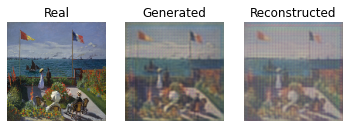

[INFO] Domain B to Domain A


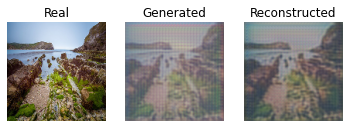

epoch: 13 step: 51 dA_loss: 0.048 dB_loss: 0.000 gAB_loss :5.897 gBA_loss: 6.031
epoch: 13 step: 52 dA_loss: 0.007 dB_loss: 0.002 gAB_loss :5.749 gBA_loss: 6.012
epoch: 13 step: 53 dA_loss: 0.061 dB_loss: 0.003 gAB_loss :5.340 gBA_loss: 5.685
epoch: 13 step: 54 dA_loss: 0.002 dB_loss: 0.062 gAB_loss :5.355 gBA_loss: 5.604
epoch: 13 step: 55 dA_loss: 0.002 dB_loss: 0.046 gAB_loss :5.701 gBA_loss: 5.798
epoch: 13 step: 56 dA_loss: 0.059 dB_loss: 0.001 gAB_loss :5.326 gBA_loss: 5.532
epoch: 13 step: 57 dA_loss: 0.014 dB_loss: 0.021 gAB_loss :5.229 gBA_loss: 5.578
epoch: 13 step: 58 dA_loss: 0.006 dB_loss: 0.025 gAB_loss :5.518 gBA_loss: 5.795
epoch: 13 step: 59 dA_loss: 0.013 dB_loss: 0.002 gAB_loss :5.424 gBA_loss: 5.514
epoch: 13 step: 60 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :5.775 gBA_loss: 5.606
epoch: 13 step: 61 dA_loss: 0.002 dB_loss: 0.001 gAB_loss :5.416 gBA_loss: 5.767
epoch: 13 step: 62 dA_loss: 0.072 dB_loss: 0.001 gAB_loss :5.444 gBA_loss: 5.509
epoch: 13 step: 63 dA_loss: 

 14%|█▍        | 14/100 [23:34<2:21:19, 98.60s/it]

epoch: 13 step: 73 dA_loss: 0.059 dB_loss: 0.002 gAB_loss :5.500 gBA_loss: 5.966
epoch: 14 step: 0 dA_loss: 0.008 dB_loss: 0.003 gAB_loss :5.707 gBA_loss: 6.020
[INFO] Domain A to Domain B


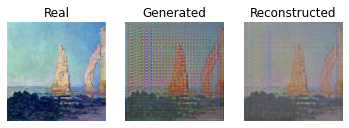

[INFO] Domain B to Domain A


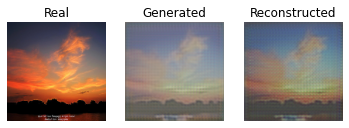

epoch: 14 step: 1 dA_loss: 0.005 dB_loss: 0.001 gAB_loss :5.675 gBA_loss: 5.687
epoch: 14 step: 2 dA_loss: 0.052 dB_loss: 0.001 gAB_loss :5.436 gBA_loss: 5.754
epoch: 14 step: 3 dA_loss: 0.003 dB_loss: 0.001 gAB_loss :5.381 gBA_loss: 5.593
epoch: 14 step: 4 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.516 gBA_loss: 5.623
epoch: 14 step: 5 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.784 gBA_loss: 5.713
epoch: 14 step: 6 dA_loss: 0.019 dB_loss: 0.002 gAB_loss :5.247 gBA_loss: 5.429
epoch: 14 step: 7 dA_loss: 0.001 dB_loss: 0.065 gAB_loss :5.080 gBA_loss: 5.250
epoch: 14 step: 8 dA_loss: 0.016 dB_loss: 0.001 gAB_loss :4.926 gBA_loss: 5.542
epoch: 14 step: 9 dA_loss: 0.012 dB_loss: 0.001 gAB_loss :5.121 gBA_loss: 5.393
epoch: 14 step: 10 dA_loss: 0.011 dB_loss: 0.000 gAB_loss :6.428 gBA_loss: 6.689
epoch: 14 step: 11 dA_loss: 0.031 dB_loss: 0.000 gAB_loss :5.525 gBA_loss: 5.741
epoch: 14 step: 12 dA_loss: 0.013 dB_loss: 0.080 gAB_loss :5.404 gBA_loss: 5.650
epoch: 14 step: 13 dA_loss: 0.027 dB_

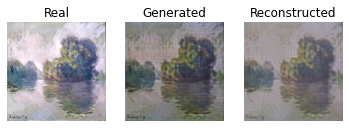

[INFO] Domain B to Domain A


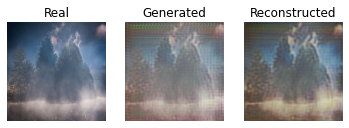

epoch: 14 step: 51 dA_loss: 0.032 dB_loss: 0.001 gAB_loss :5.787 gBA_loss: 5.882
epoch: 14 step: 52 dA_loss: 0.004 dB_loss: 0.008 gAB_loss :5.636 gBA_loss: 5.904
epoch: 14 step: 53 dA_loss: 0.058 dB_loss: 0.001 gAB_loss :5.245 gBA_loss: 5.610
epoch: 14 step: 54 dA_loss: 0.002 dB_loss: 0.064 gAB_loss :5.254 gBA_loss: 5.508
epoch: 14 step: 55 dA_loss: 0.001 dB_loss: 0.036 gAB_loss :5.591 gBA_loss: 5.804
epoch: 14 step: 56 dA_loss: 0.053 dB_loss: 0.033 gAB_loss :5.414 gBA_loss: 5.483
epoch: 14 step: 57 dA_loss: 0.002 dB_loss: 0.133 gAB_loss :5.319 gBA_loss: 5.534
epoch: 14 step: 58 dA_loss: 0.002 dB_loss: 0.000 gAB_loss :5.448 gBA_loss: 5.690
epoch: 14 step: 59 dA_loss: 0.024 dB_loss: 0.010 gAB_loss :5.255 gBA_loss: 5.353
epoch: 14 step: 60 dA_loss: 0.005 dB_loss: 0.001 gAB_loss :5.573 gBA_loss: 5.464
epoch: 14 step: 61 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.248 gBA_loss: 5.663
epoch: 14 step: 62 dA_loss: 0.069 dB_loss: 0.002 gAB_loss :5.285 gBA_loss: 5.367
epoch: 14 step: 63 dA_loss: 

 15%|█▌        | 15/100 [25:12<2:19:30, 98.48s/it]

epoch: 14 step: 73 dA_loss: 0.054 dB_loss: 0.236 gAB_loss :4.966 gBA_loss: 5.942
epoch: 15 step: 0 dA_loss: 0.007 dB_loss: 0.131 gAB_loss :5.227 gBA_loss: 5.964
[INFO] Domain A to Domain B


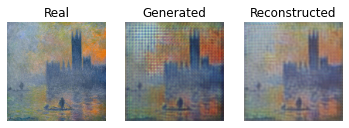

[INFO] Domain B to Domain A


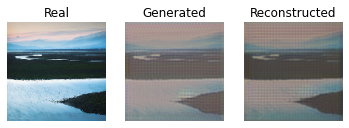

epoch: 15 step: 1 dA_loss: 0.005 dB_loss: 0.152 gAB_loss :5.242 gBA_loss: 5.642
epoch: 15 step: 2 dA_loss: 0.055 dB_loss: 0.074 gAB_loss :5.072 gBA_loss: 5.721
epoch: 15 step: 3 dA_loss: 0.001 dB_loss: 0.047 gAB_loss :5.095 gBA_loss: 5.512
epoch: 15 step: 4 dA_loss: 0.001 dB_loss: 0.031 gAB_loss :5.296 gBA_loss: 5.536
epoch: 15 step: 5 dA_loss: 0.001 dB_loss: 0.039 gAB_loss :5.610 gBA_loss: 5.622
epoch: 15 step: 6 dA_loss: 0.003 dB_loss: 0.033 gAB_loss :5.047 gBA_loss: 5.341
epoch: 15 step: 7 dA_loss: 0.001 dB_loss: 0.063 gAB_loss :4.859 gBA_loss: 5.154
epoch: 15 step: 8 dA_loss: 0.017 dB_loss: 0.008 gAB_loss :4.744 gBA_loss: 5.409
epoch: 15 step: 9 dA_loss: 0.027 dB_loss: 0.020 gAB_loss :4.928 gBA_loss: 5.430
epoch: 15 step: 10 dA_loss: 0.002 dB_loss: 0.020 gAB_loss :6.252 gBA_loss: 6.613
epoch: 15 step: 11 dA_loss: 0.002 dB_loss: 0.011 gAB_loss :5.469 gBA_loss: 5.725
epoch: 15 step: 12 dA_loss: 0.001 dB_loss: 0.109 gAB_loss :5.371 gBA_loss: 5.596
epoch: 15 step: 13 dA_loss: 0.005 dB_

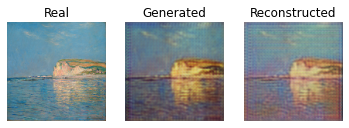

[INFO] Domain B to Domain A


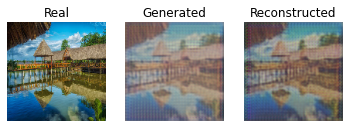

epoch: 15 step: 51 dA_loss: 0.039 dB_loss: 0.001 gAB_loss :5.747 gBA_loss: 5.898
epoch: 15 step: 52 dA_loss: 0.008 dB_loss: 0.005 gAB_loss :5.619 gBA_loss: 5.964
epoch: 15 step: 53 dA_loss: 0.066 dB_loss: 0.005 gAB_loss :5.258 gBA_loss: 5.629
epoch: 15 step: 54 dA_loss: 0.004 dB_loss: 0.065 gAB_loss :5.269 gBA_loss: 5.496
epoch: 15 step: 55 dA_loss: 0.001 dB_loss: 0.061 gAB_loss :5.637 gBA_loss: 5.734
epoch: 15 step: 56 dA_loss: 0.060 dB_loss: 0.001 gAB_loss :5.242 gBA_loss: 5.407
epoch: 15 step: 57 dA_loss: 0.003 dB_loss: 0.067 gAB_loss :5.201 gBA_loss: 5.468
epoch: 15 step: 58 dA_loss: 0.008 dB_loss: 0.001 gAB_loss :5.368 gBA_loss: 5.667
epoch: 15 step: 59 dA_loss: 0.064 dB_loss: 0.003 gAB_loss :5.217 gBA_loss: 5.367
epoch: 15 step: 60 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.563 gBA_loss: 5.443
epoch: 15 step: 61 dA_loss: 0.001 dB_loss: 0.003 gAB_loss :5.213 gBA_loss: 5.615
epoch: 15 step: 62 dA_loss: 0.069 dB_loss: 0.002 gAB_loss :5.239 gBA_loss: 5.289
epoch: 15 step: 63 dA_loss: 

 16%|█▌        | 16/100 [26:50<2:17:43, 98.38s/it]

epoch: 15 step: 73 dA_loss: 0.060 dB_loss: 0.079 gAB_loss :5.348 gBA_loss: 5.922
epoch: 16 step: 0 dA_loss: 0.006 dB_loss: 0.022 gAB_loss :5.600 gBA_loss: 5.926
[INFO] Domain A to Domain B


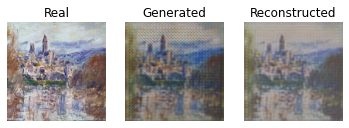

[INFO] Domain B to Domain A


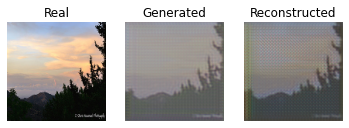

epoch: 16 step: 1 dA_loss: 0.005 dB_loss: 0.125 gAB_loss :5.458 gBA_loss: 5.598
epoch: 16 step: 2 dA_loss: 0.057 dB_loss: 0.050 gAB_loss :5.176 gBA_loss: 5.884
epoch: 16 step: 3 dA_loss: 0.001 dB_loss: 0.126 gAB_loss :5.466 gBA_loss: 5.550
epoch: 16 step: 4 dA_loss: 0.001 dB_loss: 0.018 gAB_loss :5.511 gBA_loss: 5.529
epoch: 16 step: 5 dA_loss: 0.002 dB_loss: 0.036 gAB_loss :5.730 gBA_loss: 5.572
epoch: 16 step: 6 dA_loss: 0.002 dB_loss: 0.055 gAB_loss :5.117 gBA_loss: 5.268
epoch: 16 step: 7 dA_loss: 0.004 dB_loss: 0.063 gAB_loss :4.846 gBA_loss: 5.039
epoch: 16 step: 8 dA_loss: 0.035 dB_loss: 0.002 gAB_loss :4.707 gBA_loss: 5.341
epoch: 16 step: 9 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :4.862 gBA_loss: 5.124
epoch: 16 step: 10 dA_loss: 0.043 dB_loss: 0.004 gAB_loss :6.156 gBA_loss: 6.471
epoch: 16 step: 11 dA_loss: 0.066 dB_loss: 0.003 gAB_loss :5.328 gBA_loss: 5.596
epoch: 16 step: 12 dA_loss: 0.026 dB_loss: 0.070 gAB_loss :5.219 gBA_loss: 5.490
epoch: 16 step: 13 dA_loss: 0.049 dB_

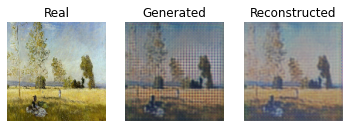

[INFO] Domain B to Domain A


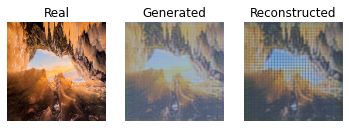

epoch: 16 step: 51 dA_loss: 0.047 dB_loss: 0.038 gAB_loss :5.692 gBA_loss: 5.759
epoch: 16 step: 52 dA_loss: 0.059 dB_loss: 0.041 gAB_loss :5.552 gBA_loss: 5.982
epoch: 16 step: 53 dA_loss: 0.066 dB_loss: 0.009 gAB_loss :5.035 gBA_loss: 5.652
epoch: 16 step: 54 dA_loss: 0.032 dB_loss: 0.067 gAB_loss :5.088 gBA_loss: 5.489
epoch: 16 step: 55 dA_loss: 0.001 dB_loss: 0.084 gAB_loss :5.575 gBA_loss: 5.740
epoch: 16 step: 56 dA_loss: 0.064 dB_loss: 0.003 gAB_loss :5.216 gBA_loss: 5.373
epoch: 16 step: 57 dA_loss: 0.053 dB_loss: 0.145 gAB_loss :5.111 gBA_loss: 5.385
epoch: 16 step: 58 dA_loss: 0.003 dB_loss: 0.002 gAB_loss :5.244 gBA_loss: 5.552
epoch: 16 step: 59 dA_loss: 0.056 dB_loss: 0.024 gAB_loss :5.036 gBA_loss: 5.282
epoch: 16 step: 60 dA_loss: 0.004 dB_loss: 0.043 gAB_loss :5.502 gBA_loss: 5.312
epoch: 16 step: 61 dA_loss: 0.002 dB_loss: 0.039 gAB_loss :5.164 gBA_loss: 5.507
epoch: 16 step: 62 dA_loss: 0.071 dB_loss: 0.020 gAB_loss :5.160 gBA_loss: 5.194
epoch: 16 step: 63 dA_loss: 

 17%|█▋        | 17/100 [28:29<2:16:01, 98.33s/it]

epoch: 16 step: 73 dA_loss: 0.191 dB_loss: 0.023 gAB_loss :5.345 gBA_loss: 5.956
epoch: 17 step: 0 dA_loss: 0.271 dB_loss: 0.003 gAB_loss :5.495 gBA_loss: 5.726
[INFO] Domain A to Domain B


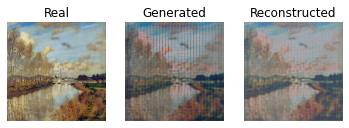

[INFO] Domain B to Domain A


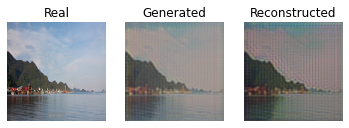

epoch: 17 step: 1 dA_loss: 0.017 dB_loss: 0.023 gAB_loss :5.430 gBA_loss: 5.339
epoch: 17 step: 2 dA_loss: 0.177 dB_loss: 0.003 gAB_loss :5.177 gBA_loss: 5.361
epoch: 17 step: 3 dA_loss: 0.102 dB_loss: 0.004 gAB_loss :5.077 gBA_loss: 5.145
epoch: 17 step: 4 dA_loss: 0.036 dB_loss: 0.003 gAB_loss :5.212 gBA_loss: 5.241
epoch: 17 step: 5 dA_loss: 0.047 dB_loss: 0.002 gAB_loss :5.547 gBA_loss: 5.328
epoch: 17 step: 6 dA_loss: 0.032 dB_loss: 0.005 gAB_loss :4.980 gBA_loss: 5.047
epoch: 17 step: 7 dA_loss: 0.009 dB_loss: 0.067 gAB_loss :4.785 gBA_loss: 4.838
epoch: 17 step: 8 dA_loss: 0.187 dB_loss: 0.003 gAB_loss :4.751 gBA_loss: 5.451
epoch: 17 step: 9 dA_loss: 0.061 dB_loss: 0.007 gAB_loss :4.896 gBA_loss: 5.226
epoch: 17 step: 10 dA_loss: 0.005 dB_loss: 0.006 gAB_loss :6.153 gBA_loss: 6.364
epoch: 17 step: 11 dA_loss: 0.074 dB_loss: 0.002 gAB_loss :5.380 gBA_loss: 5.500
epoch: 17 step: 12 dA_loss: 0.017 dB_loss: 0.111 gAB_loss :5.237 gBA_loss: 5.345
epoch: 17 step: 13 dA_loss: 0.058 dB_

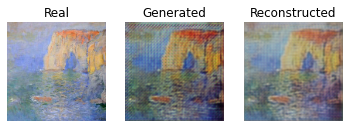

[INFO] Domain B to Domain A


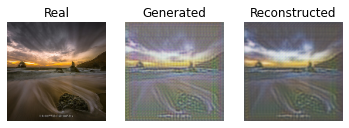

epoch: 17 step: 51 dA_loss: 0.058 dB_loss: 0.001 gAB_loss :5.597 gBA_loss: 5.594
epoch: 17 step: 52 dA_loss: 0.126 dB_loss: 0.004 gAB_loss :5.476 gBA_loss: 5.610
epoch: 17 step: 53 dA_loss: 0.059 dB_loss: 0.001 gAB_loss :5.046 gBA_loss: 5.278
epoch: 17 step: 54 dA_loss: 0.009 dB_loss: 0.064 gAB_loss :5.026 gBA_loss: 5.139
epoch: 17 step: 55 dA_loss: 0.005 dB_loss: 0.062 gAB_loss :5.426 gBA_loss: 5.536
epoch: 17 step: 56 dA_loss: 0.061 dB_loss: 0.009 gAB_loss :5.090 gBA_loss: 5.202
epoch: 17 step: 57 dA_loss: 0.047 dB_loss: 0.092 gAB_loss :5.001 gBA_loss: 5.252
epoch: 17 step: 58 dA_loss: 0.073 dB_loss: 0.009 gAB_loss :5.204 gBA_loss: 5.432
epoch: 17 step: 59 dA_loss: 0.235 dB_loss: 0.023 gAB_loss :5.156 gBA_loss: 5.413
epoch: 17 step: 60 dA_loss: 0.020 dB_loss: 0.005 gAB_loss :5.515 gBA_loss: 5.419
epoch: 17 step: 61 dA_loss: 0.150 dB_loss: 0.049 gAB_loss :5.120 gBA_loss: 5.533
epoch: 17 step: 62 dA_loss: 0.104 dB_loss: 0.030 gAB_loss :5.263 gBA_loss: 5.091
epoch: 17 step: 63 dA_loss: 

 18%|█▊        | 18/100 [30:07<2:14:27, 98.38s/it]

epoch: 17 step: 73 dA_loss: 0.130 dB_loss: 0.003 gAB_loss :5.266 gBA_loss: 5.700
epoch: 18 step: 0 dA_loss: 0.013 dB_loss: 0.001 gAB_loss :5.390 gBA_loss: 5.673
[INFO] Domain A to Domain B


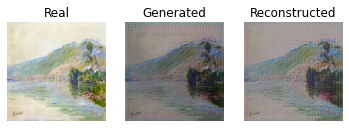

[INFO] Domain B to Domain A


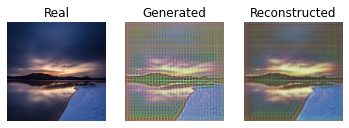

epoch: 18 step: 1 dA_loss: 0.004 dB_loss: 0.003 gAB_loss :5.356 gBA_loss: 5.398
epoch: 18 step: 2 dA_loss: 0.063 dB_loss: 0.004 gAB_loss :5.140 gBA_loss: 5.475
epoch: 18 step: 3 dA_loss: 0.001 dB_loss: 0.002 gAB_loss :5.009 gBA_loss: 5.243
epoch: 18 step: 4 dA_loss: 0.001 dB_loss: 0.001 gAB_loss :5.151 gBA_loss: 5.291
epoch: 18 step: 5 dA_loss: 0.042 dB_loss: 0.000 gAB_loss :5.458 gBA_loss: 5.296
epoch: 18 step: 6 dA_loss: 0.032 dB_loss: 0.001 gAB_loss :4.897 gBA_loss: 4.900
epoch: 18 step: 7 dA_loss: 0.021 dB_loss: 0.064 gAB_loss :4.662 gBA_loss: 4.769
epoch: 18 step: 8 dA_loss: 0.042 dB_loss: 0.001 gAB_loss :4.629 gBA_loss: 5.183
epoch: 18 step: 9 dA_loss: 0.011 dB_loss: 0.002 gAB_loss :4.786 gBA_loss: 5.063
epoch: 18 step: 10 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :6.043 gBA_loss: 6.286
epoch: 18 step: 11 dA_loss: 0.043 dB_loss: 0.001 gAB_loss :5.246 gBA_loss: 5.386
epoch: 18 step: 12 dA_loss: 0.028 dB_loss: 0.078 gAB_loss :5.101 gBA_loss: 5.313
epoch: 18 step: 13 dA_loss: 0.002 dB_

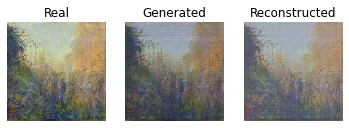

[INFO] Domain B to Domain A


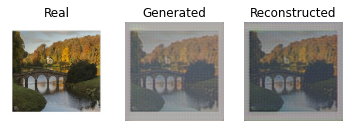

epoch: 18 step: 51 dA_loss: 0.056 dB_loss: 0.001 gAB_loss :5.536 gBA_loss: 5.482
epoch: 18 step: 52 dA_loss: 0.044 dB_loss: 0.006 gAB_loss :5.412 gBA_loss: 5.602
epoch: 18 step: 53 dA_loss: 0.122 dB_loss: 0.001 gAB_loss :5.024 gBA_loss: 5.312
epoch: 18 step: 54 dA_loss: 0.023 dB_loss: 0.063 gAB_loss :5.001 gBA_loss: 5.149
epoch: 18 step: 55 dA_loss: 0.006 dB_loss: 0.063 gAB_loss :5.412 gBA_loss: 5.546
epoch: 18 step: 56 dA_loss: 0.080 dB_loss: 0.002 gAB_loss :5.055 gBA_loss: 5.167
epoch: 18 step: 57 dA_loss: 0.025 dB_loss: 0.077 gAB_loss :4.971 gBA_loss: 5.170
epoch: 18 step: 58 dA_loss: 0.490 dB_loss: 0.013 gAB_loss :5.384 gBA_loss: 5.848
epoch: 18 step: 59 dA_loss: 0.153 dB_loss: 0.008 gAB_loss :5.206 gBA_loss: 5.475
epoch: 18 step: 60 dA_loss: 0.347 dB_loss: 0.001 gAB_loss :5.441 gBA_loss: 5.248
epoch: 18 step: 61 dA_loss: 0.288 dB_loss: 0.004 gAB_loss :5.063 gBA_loss: 5.212
epoch: 18 step: 62 dA_loss: 0.145 dB_loss: 0.004 gAB_loss :5.031 gBA_loss: 4.755
epoch: 18 step: 63 dA_loss: 

 19%|█▉        | 19/100 [31:45<2:12:44, 98.32s/it]

epoch: 18 step: 73 dA_loss: 0.255 dB_loss: 0.071 gAB_loss :5.288 gBA_loss: 5.624
epoch: 19 step: 0 dA_loss: 0.157 dB_loss: 0.002 gAB_loss :5.380 gBA_loss: 5.421
[INFO] Domain A to Domain B


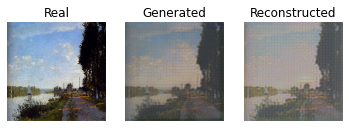

[INFO] Domain B to Domain A


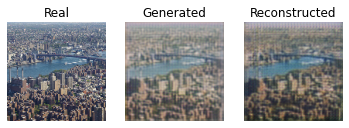

epoch: 19 step: 1 dA_loss: 0.034 dB_loss: 0.054 gAB_loss :5.239 gBA_loss: 5.111
epoch: 19 step: 2 dA_loss: 0.134 dB_loss: 0.003 gAB_loss :4.922 gBA_loss: 5.208
epoch: 19 step: 3 dA_loss: 0.041 dB_loss: 0.060 gAB_loss :5.060 gBA_loss: 4.999
epoch: 19 step: 4 dA_loss: 0.017 dB_loss: 0.003 gAB_loss :5.190 gBA_loss: 5.092
epoch: 19 step: 5 dA_loss: 0.058 dB_loss: 0.005 gAB_loss :5.457 gBA_loss: 5.130
epoch: 19 step: 6 dA_loss: 0.030 dB_loss: 0.026 gAB_loss :4.900 gBA_loss: 4.831
epoch: 19 step: 7 dA_loss: 0.013 dB_loss: 0.066 gAB_loss :4.595 gBA_loss: 4.644
epoch: 19 step: 8 dA_loss: 0.139 dB_loss: 0.004 gAB_loss :4.560 gBA_loss: 4.997
epoch: 19 step: 9 dA_loss: 0.053 dB_loss: 0.046 gAB_loss :4.684 gBA_loss: 4.900
epoch: 19 step: 10 dA_loss: 0.028 dB_loss: 0.002 gAB_loss :5.985 gBA_loss: 6.233
epoch: 19 step: 11 dA_loss: 0.033 dB_loss: 0.005 gAB_loss :5.187 gBA_loss: 5.380
epoch: 19 step: 12 dA_loss: 0.012 dB_loss: 0.101 gAB_loss :4.955 gBA_loss: 5.285
epoch: 19 step: 13 dA_loss: 0.082 dB_

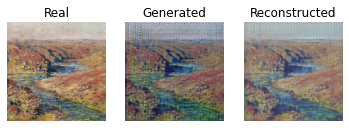

[INFO] Domain B to Domain A


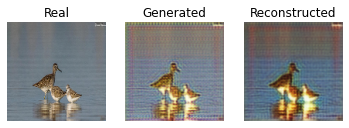

epoch: 19 step: 51 dA_loss: 0.048 dB_loss: 0.001 gAB_loss :5.514 gBA_loss: 5.438
epoch: 19 step: 52 dA_loss: 0.033 dB_loss: 0.011 gAB_loss :5.358 gBA_loss: 5.554
epoch: 19 step: 53 dA_loss: 0.101 dB_loss: 0.002 gAB_loss :4.940 gBA_loss: 5.348
epoch: 19 step: 54 dA_loss: 0.024 dB_loss: 0.069 gAB_loss :4.923 gBA_loss: 5.144
epoch: 19 step: 55 dA_loss: 0.001 dB_loss: 0.069 gAB_loss :5.393 gBA_loss: 5.523
epoch: 19 step: 56 dA_loss: 0.076 dB_loss: 0.003 gAB_loss :5.035 gBA_loss: 5.135
epoch: 19 step: 57 dA_loss: 0.027 dB_loss: 0.112 gAB_loss :4.904 gBA_loss: 5.168
epoch: 19 step: 58 dA_loss: 0.003 dB_loss: 0.003 gAB_loss :5.065 gBA_loss: 5.318
epoch: 19 step: 59 dA_loss: 0.072 dB_loss: 0.015 gAB_loss :5.026 gBA_loss: 4.940
epoch: 19 step: 60 dA_loss: 0.023 dB_loss: 0.003 gAB_loss :5.336 gBA_loss: 5.081
epoch: 19 step: 61 dA_loss: 0.001 dB_loss: 0.018 gAB_loss :4.995 gBA_loss: 5.331
epoch: 19 step: 62 dA_loss: 0.066 dB_loss: 0.005 gAB_loss :4.939 gBA_loss: 5.008
epoch: 19 step: 63 dA_loss: 

 20%|██        | 20/100 [33:23<2:11:01, 98.27s/it]

epoch: 19 step: 73 dA_loss: 0.114 dB_loss: 0.006 gAB_loss :5.208 gBA_loss: 5.554
epoch: 20 step: 0 dA_loss: 0.009 dB_loss: 0.001 gAB_loss :5.278 gBA_loss: 5.446
[INFO] Domain A to Domain B


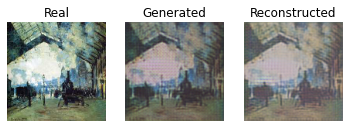

[INFO] Domain B to Domain A


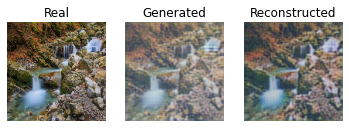

epoch: 20 step: 1 dA_loss: 0.011 dB_loss: 0.014 gAB_loss :5.171 gBA_loss: 5.186
epoch: 20 step: 2 dA_loss: 0.060 dB_loss: 0.003 gAB_loss :4.933 gBA_loss: 5.330
epoch: 20 step: 3 dA_loss: 0.002 dB_loss: 0.054 gAB_loss :5.039 gBA_loss: 5.099
epoch: 20 step: 4 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :5.143 gBA_loss: 5.157
epoch: 20 step: 5 dA_loss: 0.023 dB_loss: 0.184 gAB_loss :5.353 gBA_loss: 5.068
epoch: 20 step: 6 dA_loss: 0.126 dB_loss: 0.107 gAB_loss :4.775 gBA_loss: 4.911
epoch: 20 step: 7 dA_loss: 0.004 dB_loss: 0.065 gAB_loss :4.425 gBA_loss: 4.676
epoch: 20 step: 8 dA_loss: 0.119 dB_loss: 0.009 gAB_loss :4.431 gBA_loss: 4.974
epoch: 20 step: 9 dA_loss: 0.017 dB_loss: 0.056 gAB_loss :4.464 gBA_loss: 4.835
epoch: 20 step: 10 dA_loss: 0.039 dB_loss: 0.040 gAB_loss :5.872 gBA_loss: 6.154
epoch: 20 step: 11 dA_loss: 0.013 dB_loss: 0.005 gAB_loss :5.208 gBA_loss: 5.353
epoch: 20 step: 12 dA_loss: 0.004 dB_loss: 0.115 gAB_loss :5.038 gBA_loss: 5.209
epoch: 20 step: 13 dA_loss: 0.084 dB_

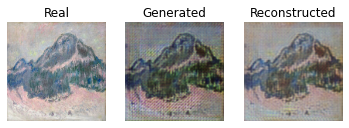

[INFO] Domain B to Domain A


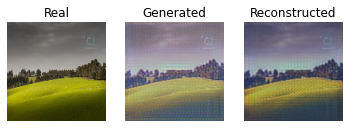

epoch: 20 step: 51 dA_loss: 0.056 dB_loss: 0.012 gAB_loss :5.414 gBA_loss: 5.489
epoch: 20 step: 52 dA_loss: 0.061 dB_loss: 0.054 gAB_loss :5.378 gBA_loss: 5.540
epoch: 20 step: 53 dA_loss: 0.076 dB_loss: 0.002 gAB_loss :5.010 gBA_loss: 5.226
epoch: 20 step: 54 dA_loss: 0.002 dB_loss: 0.066 gAB_loss :4.937 gBA_loss: 5.027
epoch: 20 step: 55 dA_loss: 0.001 dB_loss: 0.064 gAB_loss :5.338 gBA_loss: 5.427
epoch: 20 step: 56 dA_loss: 0.111 dB_loss: 0.001 gAB_loss :4.919 gBA_loss: 5.039
epoch: 20 step: 57 dA_loss: 0.075 dB_loss: 0.174 gAB_loss :4.807 gBA_loss: 5.010
epoch: 20 step: 58 dA_loss: 0.060 dB_loss: 0.004 gAB_loss :4.969 gBA_loss: 5.231
epoch: 20 step: 59 dA_loss: 0.087 dB_loss: 0.058 gAB_loss :4.789 gBA_loss: 4.952
epoch: 20 step: 60 dA_loss: 0.002 dB_loss: 0.014 gAB_loss :5.107 gBA_loss: 5.036
epoch: 20 step: 61 dA_loss: 0.002 dB_loss: 0.030 gAB_loss :4.705 gBA_loss: 5.695
epoch: 20 step: 62 dA_loss: 0.081 dB_loss: 0.548 gAB_loss :5.460 gBA_loss: 5.049
epoch: 20 step: 63 dA_loss: 

 21%|██        | 21/100 [35:02<2:09:21, 98.25s/it]

epoch: 20 step: 73 dA_loss: 0.106 dB_loss: 0.089 gAB_loss :4.895 gBA_loss: 5.596
epoch: 21 step: 0 dA_loss: 0.021 dB_loss: 0.216 gAB_loss :5.162 gBA_loss: 5.510
[INFO] Domain A to Domain B


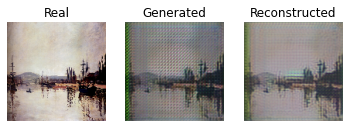

[INFO] Domain B to Domain A


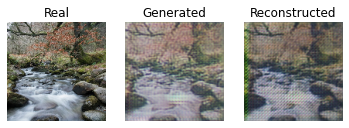

epoch: 21 step: 1 dA_loss: 0.015 dB_loss: 0.213 gAB_loss :5.165 gBA_loss: 5.281
epoch: 21 step: 2 dA_loss: 0.110 dB_loss: 0.108 gAB_loss :4.979 gBA_loss: 5.329
epoch: 21 step: 3 dA_loss: 0.004 dB_loss: 0.034 gAB_loss :4.831 gBA_loss: 5.066
epoch: 21 step: 4 dA_loss: 0.002 dB_loss: 0.018 gAB_loss :4.920 gBA_loss: 5.113
epoch: 21 step: 5 dA_loss: 0.056 dB_loss: 0.073 gAB_loss :5.166 gBA_loss: 5.099
epoch: 21 step: 6 dA_loss: 0.022 dB_loss: 0.032 gAB_loss :4.552 gBA_loss: 4.851
epoch: 21 step: 7 dA_loss: 0.003 dB_loss: 0.210 gAB_loss :4.485 gBA_loss: 4.628
epoch: 21 step: 8 dA_loss: 0.167 dB_loss: 0.065 gAB_loss :4.539 gBA_loss: 4.966
epoch: 21 step: 9 dA_loss: 0.045 dB_loss: 0.237 gAB_loss :4.604 gBA_loss: 4.795
epoch: 21 step: 10 dA_loss: 0.067 dB_loss: 0.073 gAB_loss :5.780 gBA_loss: 6.159
epoch: 21 step: 11 dA_loss: 0.031 dB_loss: 0.076 gAB_loss :4.963 gBA_loss: 5.317
epoch: 21 step: 12 dA_loss: 0.023 dB_loss: 0.125 gAB_loss :4.824 gBA_loss: 5.178
epoch: 21 step: 13 dA_loss: 0.086 dB_

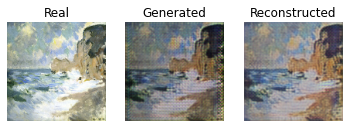

[INFO] Domain B to Domain A


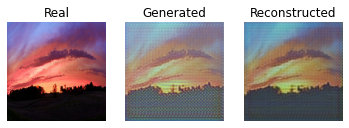

epoch: 21 step: 51 dA_loss: 0.117 dB_loss: 0.016 gAB_loss :5.442 gBA_loss: 5.508
epoch: 21 step: 52 dA_loss: 0.058 dB_loss: 0.019 gAB_loss :5.137 gBA_loss: 5.613
epoch: 21 step: 53 dA_loss: 0.100 dB_loss: 0.091 gAB_loss :5.057 gBA_loss: 5.195
epoch: 21 step: 54 dA_loss: 0.062 dB_loss: 0.105 gAB_loss :4.956 gBA_loss: 4.900
epoch: 21 step: 55 dA_loss: 0.003 dB_loss: 0.069 gAB_loss :5.328 gBA_loss: 5.326
epoch: 21 step: 56 dA_loss: 0.106 dB_loss: 0.013 gAB_loss :4.898 gBA_loss: 4.934
epoch: 21 step: 57 dA_loss: 0.046 dB_loss: 0.180 gAB_loss :4.772 gBA_loss: 4.947
epoch: 21 step: 58 dA_loss: 0.029 dB_loss: 0.006 gAB_loss :4.939 gBA_loss: 5.031
epoch: 21 step: 59 dA_loss: 0.247 dB_loss: 0.056 gAB_loss :4.777 gBA_loss: 4.950
epoch: 21 step: 60 dA_loss: 0.013 dB_loss: 0.027 gAB_loss :5.072 gBA_loss: 5.056
epoch: 21 step: 61 dA_loss: 0.119 dB_loss: 0.043 gAB_loss :4.749 gBA_loss: 5.193
epoch: 21 step: 62 dA_loss: 0.072 dB_loss: 0.032 gAB_loss :4.726 gBA_loss: 4.792
epoch: 21 step: 63 dA_loss: 

 22%|██▏       | 22/100 [36:40<2:07:45, 98.28s/it]

epoch: 21 step: 73 dA_loss: 0.134 dB_loss: 0.017 gAB_loss :5.105 gBA_loss: 5.491
epoch: 22 step: 0 dA_loss: 0.008 dB_loss: 0.002 gAB_loss :5.125 gBA_loss: 5.356
[INFO] Domain A to Domain B


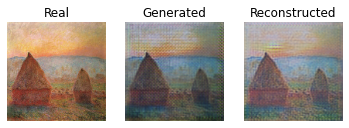

[INFO] Domain B to Domain A


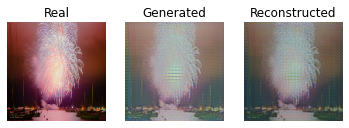

epoch: 22 step: 1 dA_loss: 0.006 dB_loss: 0.118 gAB_loss :5.033 gBA_loss: 5.110
epoch: 22 step: 2 dA_loss: 0.148 dB_loss: 0.005 gAB_loss :4.819 gBA_loss: 5.170
epoch: 22 step: 3 dA_loss: 0.003 dB_loss: 0.032 gAB_loss :4.836 gBA_loss: 4.937
epoch: 22 step: 4 dA_loss: 0.008 dB_loss: 0.001 gAB_loss :4.958 gBA_loss: 4.985
epoch: 22 step: 5 dA_loss: 0.071 dB_loss: 0.016 gAB_loss :5.254 gBA_loss: 5.067
epoch: 22 step: 6 dA_loss: 0.097 dB_loss: 0.003 gAB_loss :4.740 gBA_loss: 4.731
epoch: 22 step: 7 dA_loss: 0.005 dB_loss: 0.063 gAB_loss :4.379 gBA_loss: 4.451
epoch: 22 step: 8 dA_loss: 0.121 dB_loss: 0.004 gAB_loss :4.421 gBA_loss: 4.797
epoch: 22 step: 9 dA_loss: 0.127 dB_loss: 0.063 gAB_loss :4.580 gBA_loss: 4.880
epoch: 22 step: 10 dA_loss: 0.002 dB_loss: 0.002 gAB_loss :5.790 gBA_loss: 6.048
epoch: 22 step: 11 dA_loss: 0.213 dB_loss: 0.004 gAB_loss :5.052 gBA_loss: 5.179
epoch: 22 step: 12 dA_loss: 0.187 dB_loss: 0.108 gAB_loss :4.859 gBA_loss: 4.934
epoch: 22 step: 13 dA_loss: 0.076 dB_

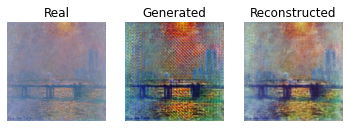

[INFO] Domain B to Domain A


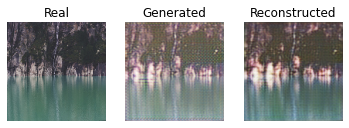

epoch: 22 step: 51 dA_loss: 0.046 dB_loss: 0.019 gAB_loss :5.402 gBA_loss: 5.355
epoch: 22 step: 52 dA_loss: 0.057 dB_loss: 0.024 gAB_loss :5.103 gBA_loss: 5.419
epoch: 22 step: 53 dA_loss: 0.067 dB_loss: 0.031 gAB_loss :4.910 gBA_loss: 5.065
epoch: 22 step: 54 dA_loss: 0.005 dB_loss: 0.066 gAB_loss :4.861 gBA_loss: 4.843
epoch: 22 step: 55 dA_loss: 0.005 dB_loss: 0.066 gAB_loss :5.270 gBA_loss: 5.294
epoch: 22 step: 56 dA_loss: 0.063 dB_loss: 0.001 gAB_loss :4.858 gBA_loss: 4.936
epoch: 22 step: 57 dA_loss: 0.062 dB_loss: 0.188 gAB_loss :4.739 gBA_loss: 4.988
epoch: 22 step: 58 dA_loss: 0.006 dB_loss: 0.003 gAB_loss :4.914 gBA_loss: 5.146
epoch: 22 step: 59 dA_loss: 0.062 dB_loss: 0.059 gAB_loss :4.722 gBA_loss: 4.766
epoch: 22 step: 60 dA_loss: 0.005 dB_loss: 0.042 gAB_loss :5.041 gBA_loss: 4.854
epoch: 22 step: 61 dA_loss: 0.004 dB_loss: 0.033 gAB_loss :4.695 gBA_loss: 5.101
epoch: 22 step: 62 dA_loss: 0.070 dB_loss: 0.038 gAB_loss :4.561 gBA_loss: 4.771
epoch: 22 step: 63 dA_loss: 

 23%|██▎       | 23/100 [38:18<2:06:10, 98.32s/it]

epoch: 22 step: 73 dA_loss: 0.144 dB_loss: 0.060 gAB_loss :4.844 gBA_loss: 5.431
epoch: 23 step: 0 dA_loss: 0.031 dB_loss: 0.035 gAB_loss :4.812 gBA_loss: 5.238
[INFO] Domain A to Domain B


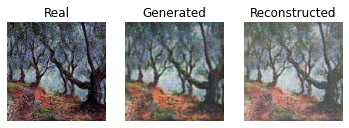

[INFO] Domain B to Domain A


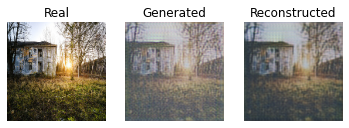

epoch: 23 step: 1 dA_loss: 0.010 dB_loss: 0.092 gAB_loss :4.779 gBA_loss: 5.013
epoch: 23 step: 2 dA_loss: 0.111 dB_loss: 0.122 gAB_loss :4.699 gBA_loss: 5.097
epoch: 23 step: 3 dA_loss: 0.014 dB_loss: 0.042 gAB_loss :4.699 gBA_loss: 4.868
epoch: 23 step: 4 dA_loss: 0.009 dB_loss: 0.052 gAB_loss :4.814 gBA_loss: 4.915
epoch: 23 step: 5 dA_loss: 0.060 dB_loss: 0.045 gAB_loss :5.101 gBA_loss: 4.922
epoch: 23 step: 6 dA_loss: 0.032 dB_loss: 0.051 gAB_loss :4.572 gBA_loss: 4.581
epoch: 23 step: 7 dA_loss: 0.015 dB_loss: 0.062 gAB_loss :4.217 gBA_loss: 4.374
epoch: 23 step: 8 dA_loss: 0.181 dB_loss: 0.025 gAB_loss :4.288 gBA_loss: 4.884
epoch: 23 step: 9 dA_loss: 0.047 dB_loss: 0.054 gAB_loss :4.388 gBA_loss: 4.809
epoch: 23 step: 10 dA_loss: 0.001 dB_loss: 0.153 gAB_loss :5.825 gBA_loss: 5.965
epoch: 23 step: 11 dA_loss: 0.055 dB_loss: 0.060 gAB_loss :5.120 gBA_loss: 5.151
epoch: 23 step: 12 dA_loss: 0.027 dB_loss: 0.193 gAB_loss :4.872 gBA_loss: 4.978
epoch: 23 step: 13 dA_loss: 0.076 dB_

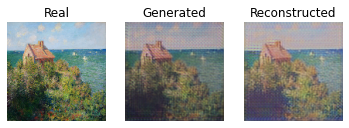

[INFO] Domain B to Domain A


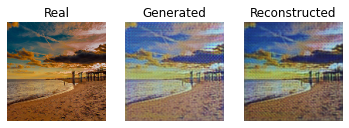

epoch: 23 step: 51 dA_loss: 0.049 dB_loss: 0.005 gAB_loss :5.389 gBA_loss: 5.391
epoch: 23 step: 52 dA_loss: 0.080 dB_loss: 0.035 gAB_loss :5.168 gBA_loss: 5.459
epoch: 23 step: 53 dA_loss: 0.103 dB_loss: 0.016 gAB_loss :4.871 gBA_loss: 5.120
epoch: 23 step: 54 dA_loss: 0.004 dB_loss: 0.067 gAB_loss :4.814 gBA_loss: 4.890
epoch: 23 step: 55 dA_loss: 0.001 dB_loss: 0.066 gAB_loss :5.212 gBA_loss: 5.312
epoch: 23 step: 56 dA_loss: 0.123 dB_loss: 0.001 gAB_loss :4.811 gBA_loss: 4.875
epoch: 23 step: 57 dA_loss: 0.025 dB_loss: 0.186 gAB_loss :4.687 gBA_loss: 4.752
epoch: 23 step: 58 dA_loss: 0.339 dB_loss: 0.002 gAB_loss :4.923 gBA_loss: 5.224
epoch: 23 step: 59 dA_loss: 0.135 dB_loss: 0.059 gAB_loss :4.716 gBA_loss: 4.843
epoch: 23 step: 60 dA_loss: 0.221 dB_loss: 0.017 gAB_loss :5.007 gBA_loss: 4.789
epoch: 23 step: 61 dA_loss: 0.148 dB_loss: 0.041 gAB_loss :4.657 gBA_loss: 4.890
epoch: 23 step: 62 dA_loss: 0.108 dB_loss: 0.017 gAB_loss :4.636 gBA_loss: 4.431
epoch: 23 step: 63 dA_loss: 

 24%|██▍       | 24/100 [39:57<2:04:33, 98.34s/it]

epoch: 23 step: 73 dA_loss: 0.225 dB_loss: 0.002 gAB_loss :5.067 gBA_loss: 5.476
epoch: 24 step: 0 dA_loss: 0.018 dB_loss: 0.002 gAB_loss :5.015 gBA_loss: 5.314
[INFO] Domain A to Domain B


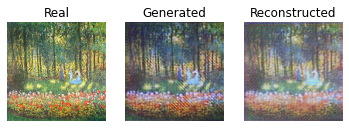

[INFO] Domain B to Domain A


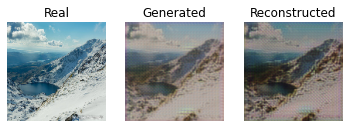

epoch: 24 step: 1 dA_loss: 0.009 dB_loss: 0.073 gAB_loss :4.406 gBA_loss: 5.202
epoch: 24 step: 2 dA_loss: 0.140 dB_loss: 0.823 gAB_loss :5.060 gBA_loss: 5.168
epoch: 24 step: 3 dA_loss: 0.052 dB_loss: 0.030 gAB_loss :4.925 gBA_loss: 4.886
epoch: 24 step: 4 dA_loss: 0.043 dB_loss: 0.062 gAB_loss :4.978 gBA_loss: 4.887
epoch: 24 step: 5 dA_loss: 0.061 dB_loss: 0.172 gAB_loss :5.124 gBA_loss: 4.870
epoch: 24 step: 6 dA_loss: 0.056 dB_loss: 0.135 gAB_loss :4.270 gBA_loss: 4.542
epoch: 24 step: 7 dA_loss: 0.019 dB_loss: 0.242 gAB_loss :4.327 gBA_loss: 4.369
epoch: 24 step: 8 dA_loss: 0.212 dB_loss: 0.040 gAB_loss :4.508 gBA_loss: 4.869
epoch: 24 step: 9 dA_loss: 0.067 dB_loss: 0.134 gAB_loss :4.570 gBA_loss: 4.700
epoch: 24 step: 10 dA_loss: 0.013 dB_loss: 0.025 gAB_loss :5.707 gBA_loss: 5.921
epoch: 24 step: 11 dA_loss: 0.055 dB_loss: 0.010 gAB_loss :4.964 gBA_loss: 5.102
epoch: 24 step: 12 dA_loss: 0.038 dB_loss: 0.113 gAB_loss :4.811 gBA_loss: 5.035
epoch: 24 step: 13 dA_loss: 0.112 dB_

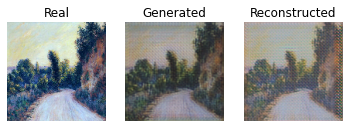

[INFO] Domain B to Domain A


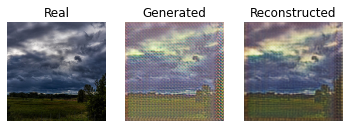

epoch: 24 step: 51 dA_loss: 0.076 dB_loss: 0.330 gAB_loss :4.886 gBA_loss: 5.405
epoch: 24 step: 52 dA_loss: 0.083 dB_loss: 0.255 gAB_loss :4.756 gBA_loss: 5.445
epoch: 24 step: 53 dA_loss: 0.076 dB_loss: 0.282 gAB_loss :4.345 gBA_loss: 5.005
epoch: 24 step: 54 dA_loss: 0.069 dB_loss: 0.408 gAB_loss :4.220 gBA_loss: 4.760
epoch: 24 step: 55 dA_loss: 0.005 dB_loss: 0.234 gAB_loss :4.680 gBA_loss: 5.263
epoch: 24 step: 56 dA_loss: 0.077 dB_loss: 0.276 gAB_loss :4.362 gBA_loss: 4.885
epoch: 24 step: 57 dA_loss: 0.104 dB_loss: 0.297 gAB_loss :4.287 gBA_loss: 5.006
epoch: 24 step: 58 dA_loss: 0.044 dB_loss: 0.187 gAB_loss :4.518 gBA_loss: 5.106
epoch: 24 step: 59 dA_loss: 0.089 dB_loss: 0.151 gAB_loss :4.371 gBA_loss: 4.665
epoch: 24 step: 60 dA_loss: 0.046 dB_loss: 0.225 gAB_loss :4.668 gBA_loss: 4.783
epoch: 24 step: 61 dA_loss: 0.011 dB_loss: 0.160 gAB_loss :4.473 gBA_loss: 5.106
epoch: 24 step: 62 dA_loss: 0.068 dB_loss: 0.140 gAB_loss :4.461 gBA_loss: 4.784
epoch: 24 step: 63 dA_loss: 

 25%|██▌       | 25/100 [41:35<2:02:56, 98.36s/it]

epoch: 24 step: 73 dA_loss: 0.101 dB_loss: 0.028 gAB_loss :4.834 gBA_loss: 5.405
epoch: 25 step: 0 dA_loss: 0.006 dB_loss: 0.021 gAB_loss :4.834 gBA_loss: 5.169
[INFO] Domain A to Domain B


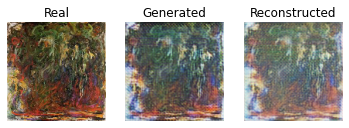

[INFO] Domain B to Domain A


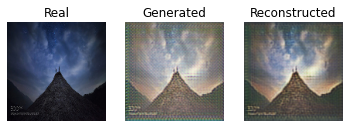

epoch: 25 step: 1 dA_loss: 0.008 dB_loss: 0.073 gAB_loss :4.688 gBA_loss: 4.983
epoch: 25 step: 2 dA_loss: 0.125 dB_loss: 0.116 gAB_loss :4.796 gBA_loss: 5.051
epoch: 25 step: 3 dA_loss: 0.015 dB_loss: 0.009 gAB_loss :4.687 gBA_loss: 4.839
epoch: 25 step: 4 dA_loss: 0.039 dB_loss: 0.008 gAB_loss :4.797 gBA_loss: 4.865
epoch: 25 step: 5 dA_loss: 0.061 dB_loss: 0.115 gAB_loss :5.044 gBA_loss: 4.834
epoch: 25 step: 6 dA_loss: 0.075 dB_loss: 0.049 gAB_loss :4.385 gBA_loss: 4.560
epoch: 25 step: 7 dA_loss: 0.019 dB_loss: 0.151 gAB_loss :4.245 gBA_loss: 4.294
epoch: 25 step: 8 dA_loss: 0.212 dB_loss: 0.054 gAB_loss :4.377 gBA_loss: 4.498
epoch: 25 step: 9 dA_loss: 0.217 dB_loss: 0.123 gAB_loss :4.437 gBA_loss: 4.743
epoch: 25 step: 10 dA_loss: 0.003 dB_loss: 0.012 gAB_loss :5.570 gBA_loss: 5.883
epoch: 25 step: 11 dA_loss: 0.188 dB_loss: 0.018 gAB_loss :4.885 gBA_loss: 5.052
epoch: 25 step: 12 dA_loss: 0.228 dB_loss: 0.120 gAB_loss :4.735 gBA_loss: 4.806
epoch: 25 step: 13 dA_loss: 0.125 dB_

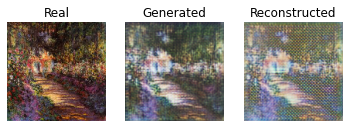

[INFO] Domain B to Domain A


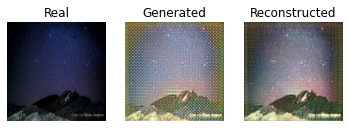

epoch: 25 step: 51 dA_loss: 0.132 dB_loss: 0.251 gAB_loss :5.350 gBA_loss: 5.481
epoch: 25 step: 52 dA_loss: 0.188 dB_loss: 0.061 gAB_loss :5.114 gBA_loss: 5.421
epoch: 25 step: 53 dA_loss: 0.131 dB_loss: 0.087 gAB_loss :4.646 gBA_loss: 4.940
epoch: 25 step: 54 dA_loss: 0.175 dB_loss: 0.099 gAB_loss :4.502 gBA_loss: 4.589
epoch: 25 step: 55 dA_loss: 0.018 dB_loss: 0.069 gAB_loss :4.881 gBA_loss: 5.042
epoch: 25 step: 56 dA_loss: 0.078 dB_loss: 0.016 gAB_loss :4.591 gBA_loss: 4.665
epoch: 25 step: 57 dA_loss: 0.081 dB_loss: 0.170 gAB_loss :4.488 gBA_loss: 4.678
epoch: 25 step: 58 dA_loss: 0.064 dB_loss: 0.011 gAB_loss :4.768 gBA_loss: 4.925
epoch: 25 step: 59 dA_loss: 0.117 dB_loss: 0.060 gAB_loss :4.644 gBA_loss: 4.663
epoch: 25 step: 60 dA_loss: 0.065 dB_loss: 0.032 gAB_loss :4.894 gBA_loss: 4.708
epoch: 25 step: 61 dA_loss: 0.037 dB_loss: 0.020 gAB_loss :4.531 gBA_loss: 4.901
epoch: 25 step: 62 dA_loss: 0.203 dB_loss: 0.105 gAB_loss :4.757 gBA_loss: 4.723
epoch: 25 step: 63 dA_loss: 

 26%|██▌       | 26/100 [43:13<2:01:17, 98.35s/it]

epoch: 25 step: 73 dA_loss: 0.171 dB_loss: 0.106 gAB_loss :5.001 gBA_loss: 5.448
epoch: 26 step: 0 dA_loss: 0.127 dB_loss: 0.040 gAB_loss :4.850 gBA_loss: 5.153
[INFO] Domain A to Domain B


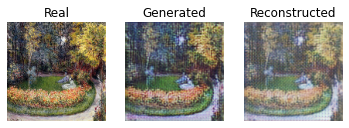

[INFO] Domain B to Domain A


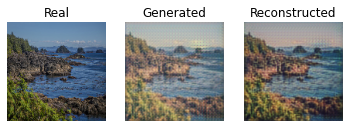

epoch: 26 step: 1 dA_loss: 0.010 dB_loss: 0.067 gAB_loss :4.424 gBA_loss: 4.962
epoch: 26 step: 2 dA_loss: 0.120 dB_loss: 0.564 gAB_loss :4.799 gBA_loss: 4.987
epoch: 26 step: 3 dA_loss: 0.021 dB_loss: 0.140 gAB_loss :4.617 gBA_loss: 4.737
epoch: 26 step: 4 dA_loss: 0.052 dB_loss: 0.349 gAB_loss :4.590 gBA_loss: 4.758
epoch: 26 step: 5 dA_loss: 0.060 dB_loss: 0.167 gAB_loss :4.808 gBA_loss: 4.748
epoch: 26 step: 6 dA_loss: 0.065 dB_loss: 0.134 gAB_loss :4.216 gBA_loss: 4.428
epoch: 26 step: 7 dA_loss: 0.019 dB_loss: 0.127 gAB_loss :3.838 gBA_loss: 4.151
epoch: 26 step: 8 dA_loss: 0.170 dB_loss: 0.049 gAB_loss :4.088 gBA_loss: 4.625
epoch: 26 step: 9 dA_loss: 0.122 dB_loss: 0.085 gAB_loss :4.300 gBA_loss: 4.625
epoch: 26 step: 10 dA_loss: 0.004 dB_loss: 0.063 gAB_loss :5.545 gBA_loss: 5.791
epoch: 26 step: 11 dA_loss: 0.046 dB_loss: 0.060 gAB_loss :4.925 gBA_loss: 5.026
epoch: 26 step: 12 dA_loss: 0.074 dB_loss: 0.116 gAB_loss :4.716 gBA_loss: 4.833
epoch: 26 step: 13 dA_loss: 0.093 dB_

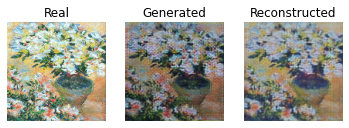

[INFO] Domain B to Domain A


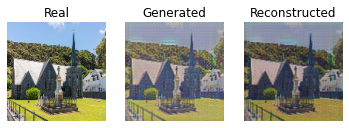

epoch: 26 step: 51 dA_loss: 0.053 dB_loss: 0.146 gAB_loss :5.179 gBA_loss: 5.317
epoch: 26 step: 52 dA_loss: 0.073 dB_loss: 0.012 gAB_loss :4.752 gBA_loss: 5.409
epoch: 26 step: 53 dA_loss: 0.076 dB_loss: 0.436 gAB_loss :4.908 gBA_loss: 5.056
epoch: 26 step: 54 dA_loss: 0.004 dB_loss: 0.657 gAB_loss :4.674 gBA_loss: 4.791
epoch: 26 step: 55 dA_loss: 0.002 dB_loss: 0.178 gAB_loss :4.943 gBA_loss: 5.215
epoch: 26 step: 56 dA_loss: 0.082 dB_loss: 0.127 gAB_loss :4.511 gBA_loss: 4.789
epoch: 26 step: 57 dA_loss: 0.027 dB_loss: 0.146 gAB_loss :4.294 gBA_loss: 4.746
epoch: 26 step: 58 dA_loss: 0.129 dB_loss: 0.115 gAB_loss :4.531 gBA_loss: 5.092
epoch: 26 step: 59 dA_loss: 0.097 dB_loss: 0.093 gAB_loss :4.527 gBA_loss: 4.681
epoch: 26 step: 60 dA_loss: 0.045 dB_loss: 0.162 gAB_loss :4.843 gBA_loss: 4.666
epoch: 26 step: 61 dA_loss: 0.054 dB_loss: 0.023 gAB_loss :4.651 gBA_loss: 5.066
epoch: 26 step: 62 dA_loss: 0.092 dB_loss: 0.124 gAB_loss :4.542 gBA_loss: 4.759
epoch: 26 step: 63 dA_loss: 

 27%|██▋       | 27/100 [44:52<1:59:37, 98.32s/it]

epoch: 26 step: 73 dA_loss: 0.118 dB_loss: 0.164 gAB_loss :4.886 gBA_loss: 5.321
epoch: 27 step: 0 dA_loss: 0.008 dB_loss: 0.057 gAB_loss :4.774 gBA_loss: 5.124
[INFO] Domain A to Domain B


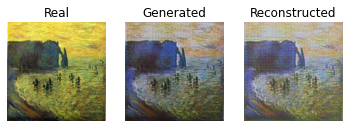

[INFO] Domain B to Domain A


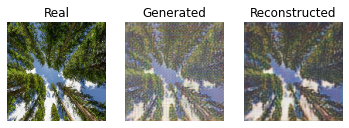

epoch: 27 step: 1 dA_loss: 0.005 dB_loss: 0.179 gAB_loss :4.695 gBA_loss: 4.941
epoch: 27 step: 2 dA_loss: 0.114 dB_loss: 0.067 gAB_loss :4.485 gBA_loss: 4.995
epoch: 27 step: 3 dA_loss: 0.003 dB_loss: 0.147 gAB_loss :4.482 gBA_loss: 4.761
epoch: 27 step: 4 dA_loss: 0.030 dB_loss: 0.034 gAB_loss :4.593 gBA_loss: 4.769
epoch: 27 step: 5 dA_loss: 0.072 dB_loss: 0.156 gAB_loss :4.875 gBA_loss: 4.769
epoch: 27 step: 6 dA_loss: 0.064 dB_loss: 0.139 gAB_loss :4.386 gBA_loss: 4.483
epoch: 27 step: 7 dA_loss: 0.074 dB_loss: 0.102 gAB_loss :3.974 gBA_loss: 4.182
epoch: 27 step: 8 dA_loss: 0.209 dB_loss: 0.047 gAB_loss :4.156 gBA_loss: 4.457
epoch: 27 step: 9 dA_loss: 0.524 dB_loss: 0.069 gAB_loss :4.433 gBA_loss: 4.737
epoch: 27 step: 10 dA_loss: 0.015 dB_loss: 0.044 gAB_loss :5.564 gBA_loss: 5.860
epoch: 27 step: 11 dA_loss: 0.249 dB_loss: 0.036 gAB_loss :4.911 gBA_loss: 4.972
epoch: 27 step: 12 dA_loss: 0.327 dB_loss: 0.114 gAB_loss :4.708 gBA_loss: 4.719
epoch: 27 step: 13 dA_loss: 0.171 dB_

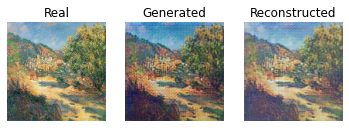

[INFO] Domain B to Domain A


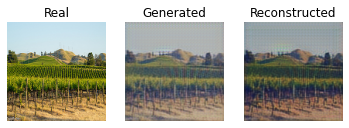

epoch: 27 step: 51 dA_loss: 0.070 dB_loss: 0.154 gAB_loss :4.957 gBA_loss: 5.127
epoch: 27 step: 52 dA_loss: 0.084 dB_loss: 0.175 gAB_loss :5.107 gBA_loss: 5.169
epoch: 27 step: 53 dA_loss: 0.071 dB_loss: 0.092 gAB_loss :4.723 gBA_loss: 4.784
epoch: 27 step: 54 dA_loss: 0.015 dB_loss: 0.154 gAB_loss :4.547 gBA_loss: 4.495
epoch: 27 step: 55 dA_loss: 0.014 dB_loss: 0.071 gAB_loss :4.906 gBA_loss: 5.054
epoch: 27 step: 56 dA_loss: 0.070 dB_loss: 0.062 gAB_loss :4.513 gBA_loss: 4.730
epoch: 27 step: 57 dA_loss: 0.050 dB_loss: 0.179 gAB_loss :4.312 gBA_loss: 4.766
epoch: 27 step: 58 dA_loss: 0.065 dB_loss: 0.047 gAB_loss :4.677 gBA_loss: 4.931
epoch: 27 step: 59 dA_loss: 0.102 dB_loss: 0.060 gAB_loss :4.540 gBA_loss: 4.553
epoch: 27 step: 60 dA_loss: 0.041 dB_loss: 0.071 gAB_loss :4.813 gBA_loss: 4.621
epoch: 27 step: 61 dA_loss: 0.015 dB_loss: 0.038 gAB_loss :4.533 gBA_loss: 4.950
epoch: 27 step: 62 dA_loss: 0.079 dB_loss: 0.071 gAB_loss :4.620 gBA_loss: 4.631
epoch: 27 step: 63 dA_loss: 

 28%|██▊       | 28/100 [46:30<1:58:05, 98.41s/it]

epoch: 27 step: 73 dA_loss: 0.087 dB_loss: 0.041 gAB_loss :4.883 gBA_loss: 5.262
epoch: 28 step: 0 dA_loss: 0.044 dB_loss: 0.011 gAB_loss :4.842 gBA_loss: 5.127
[INFO] Domain A to Domain B


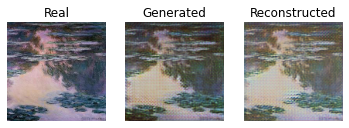

[INFO] Domain B to Domain A


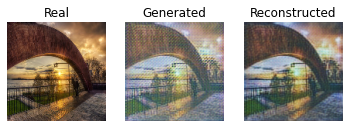

epoch: 28 step: 1 dA_loss: 0.005 dB_loss: 0.118 gAB_loss :4.762 gBA_loss: 4.939
epoch: 28 step: 2 dA_loss: 0.107 dB_loss: 0.029 gAB_loss :4.580 gBA_loss: 5.032
epoch: 28 step: 3 dA_loss: 0.008 dB_loss: 0.093 gAB_loss :4.648 gBA_loss: 4.745
epoch: 28 step: 4 dA_loss: 0.055 dB_loss: 0.018 gAB_loss :4.682 gBA_loss: 4.742
epoch: 28 step: 5 dA_loss: 0.060 dB_loss: 0.223 gAB_loss :4.901 gBA_loss: 4.702
epoch: 28 step: 6 dA_loss: 0.047 dB_loss: 0.258 gAB_loss :4.350 gBA_loss: 4.362
epoch: 28 step: 7 dA_loss: 0.042 dB_loss: 0.066 gAB_loss :3.862 gBA_loss: 4.027
epoch: 28 step: 8 dA_loss: 0.243 dB_loss: 0.058 gAB_loss :4.089 gBA_loss: 4.930
epoch: 28 step: 9 dA_loss: 0.091 dB_loss: 0.126 gAB_loss :4.344 gBA_loss: 4.582
epoch: 28 step: 10 dA_loss: 0.004 dB_loss: 0.038 gAB_loss :5.504 gBA_loss: 5.642
epoch: 28 step: 11 dA_loss: 0.005 dB_loss: 0.046 gAB_loss :4.836 gBA_loss: 4.908
epoch: 28 step: 12 dA_loss: 0.022 dB_loss: 0.122 gAB_loss :4.604 gBA_loss: 4.761
epoch: 28 step: 13 dA_loss: 0.047 dB_

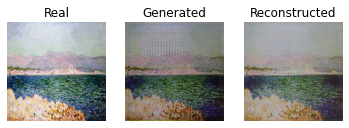

[INFO] Domain B to Domain A


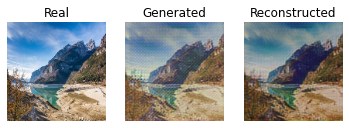

epoch: 28 step: 51 dA_loss: 0.089 dB_loss: 0.114 gAB_loss :4.940 gBA_loss: 5.209
epoch: 28 step: 52 dA_loss: 0.060 dB_loss: 0.197 gAB_loss :5.054 gBA_loss: 5.217
epoch: 28 step: 53 dA_loss: 0.118 dB_loss: 0.082 gAB_loss :4.677 gBA_loss: 4.925
epoch: 28 step: 54 dA_loss: 0.006 dB_loss: 0.127 gAB_loss :4.511 gBA_loss: 4.585
epoch: 28 step: 55 dA_loss: 0.007 dB_loss: 0.078 gAB_loss :4.880 gBA_loss: 5.086
epoch: 28 step: 56 dA_loss: 0.137 dB_loss: 0.068 gAB_loss :4.497 gBA_loss: 4.709
epoch: 28 step: 57 dA_loss: 0.040 dB_loss: 0.161 gAB_loss :4.225 gBA_loss: 4.635
epoch: 28 step: 58 dA_loss: 0.126 dB_loss: 0.105 gAB_loss :4.682 gBA_loss: 4.975
epoch: 28 step: 59 dA_loss: 0.085 dB_loss: 0.056 gAB_loss :4.577 gBA_loss: 4.570
epoch: 28 step: 60 dA_loss: 0.014 dB_loss: 0.153 gAB_loss :4.803 gBA_loss: 4.628
epoch: 28 step: 61 dA_loss: 0.008 dB_loss: 0.089 gAB_loss :4.522 gBA_loss: 4.889
epoch: 28 step: 62 dA_loss: 0.077 dB_loss: 0.094 gAB_loss :4.375 gBA_loss: 4.575
epoch: 28 step: 63 dA_loss: 

 29%|██▉       | 29/100 [48:08<1:56:21, 98.33s/it]

epoch: 28 step: 73 dA_loss: 0.144 dB_loss: 0.161 gAB_loss :4.830 gBA_loss: 5.287
epoch: 29 step: 0 dA_loss: 0.008 dB_loss: 0.045 gAB_loss :4.665 gBA_loss: 5.016
[INFO] Domain A to Domain B


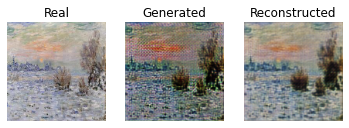

[INFO] Domain B to Domain A


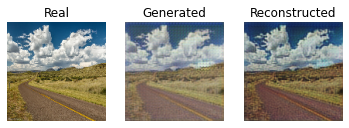

epoch: 29 step: 1 dA_loss: 0.005 dB_loss: 0.122 gAB_loss :4.625 gBA_loss: 4.841
epoch: 29 step: 2 dA_loss: 0.079 dB_loss: 0.101 gAB_loss :4.432 gBA_loss: 4.895
epoch: 29 step: 3 dA_loss: 0.015 dB_loss: 0.030 gAB_loss :4.326 gBA_loss: 4.637
epoch: 29 step: 4 dA_loss: 0.051 dB_loss: 0.016 gAB_loss :4.457 gBA_loss: 4.663
epoch: 29 step: 5 dA_loss: 0.049 dB_loss: 0.072 gAB_loss :4.716 gBA_loss: 4.583
epoch: 29 step: 6 dA_loss: 0.070 dB_loss: 0.026 gAB_loss :4.312 gBA_loss: 4.305
epoch: 29 step: 7 dA_loss: 0.111 dB_loss: 0.071 gAB_loss :4.036 gBA_loss: 4.263
epoch: 29 step: 8 dA_loss: 0.268 dB_loss: 0.038 gAB_loss :4.265 gBA_loss: 4.856
epoch: 29 step: 9 dA_loss: 0.117 dB_loss: 0.087 gAB_loss :4.262 gBA_loss: 4.425
epoch: 29 step: 10 dA_loss: 0.017 dB_loss: 0.059 gAB_loss :5.495 gBA_loss: 5.443
epoch: 29 step: 11 dA_loss: 0.138 dB_loss: 0.051 gAB_loss :4.883 gBA_loss: 4.914
epoch: 29 step: 12 dA_loss: 0.102 dB_loss: 0.130 gAB_loss :4.632 gBA_loss: 4.772
epoch: 29 step: 13 dA_loss: 0.070 dB_

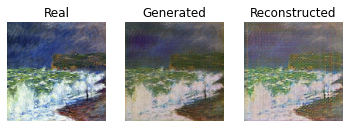

[INFO] Domain B to Domain A


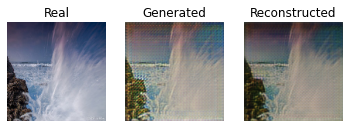

epoch: 29 step: 51 dA_loss: 0.060 dB_loss: 0.164 gAB_loss :5.173 gBA_loss: 5.201
epoch: 29 step: 52 dA_loss: 0.061 dB_loss: 0.042 gAB_loss :4.816 gBA_loss: 5.330
epoch: 29 step: 53 dA_loss: 0.053 dB_loss: 0.143 gAB_loss :4.760 gBA_loss: 4.896
epoch: 29 step: 54 dA_loss: 0.005 dB_loss: 0.139 gAB_loss :4.544 gBA_loss: 4.522
epoch: 29 step: 55 dA_loss: 0.008 dB_loss: 0.098 gAB_loss :4.911 gBA_loss: 5.031
epoch: 29 step: 56 dA_loss: 0.060 dB_loss: 0.185 gAB_loss :4.539 gBA_loss: 4.720
epoch: 29 step: 57 dA_loss: 0.048 dB_loss: 0.153 gAB_loss :4.317 gBA_loss: 4.724
epoch: 29 step: 58 dA_loss: 0.037 dB_loss: 0.041 gAB_loss :4.459 gBA_loss: 4.995
epoch: 29 step: 59 dA_loss: 0.116 dB_loss: 0.122 gAB_loss :4.563 gBA_loss: 4.690
epoch: 29 step: 60 dA_loss: 0.057 dB_loss: 0.151 gAB_loss :4.830 gBA_loss: 4.617
epoch: 29 step: 61 dA_loss: 0.133 dB_loss: 0.071 gAB_loss :4.601 gBA_loss: 5.150
epoch: 29 step: 62 dA_loss: 0.073 dB_loss: 0.114 gAB_loss :4.488 gBA_loss: 4.704
epoch: 29 step: 63 dA_loss: 

 30%|███       | 30/100 [49:47<1:54:38, 98.26s/it]

epoch: 29 step: 73 dA_loss: 0.134 dB_loss: 0.130 gAB_loss :4.796 gBA_loss: 5.149
epoch: 30 step: 0 dA_loss: 0.074 dB_loss: 0.039 gAB_loss :4.670 gBA_loss: 5.096
[INFO] Domain A to Domain B


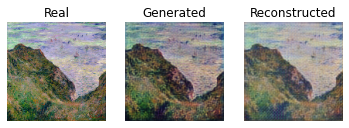

[INFO] Domain B to Domain A


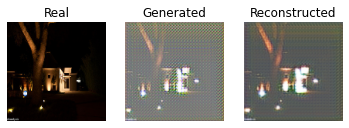

epoch: 30 step: 1 dA_loss: 0.013 dB_loss: 0.128 gAB_loss :4.604 gBA_loss: 4.888
epoch: 30 step: 2 dA_loss: 0.133 dB_loss: 0.081 gAB_loss :4.421 gBA_loss: 4.917
epoch: 30 step: 3 dA_loss: 0.099 dB_loss: 0.066 gAB_loss :4.360 gBA_loss: 4.636
epoch: 30 step: 4 dA_loss: 0.081 dB_loss: 0.019 gAB_loss :4.498 gBA_loss: 4.609
epoch: 30 step: 5 dA_loss: 0.057 dB_loss: 0.113 gAB_loss :4.774 gBA_loss: 4.563
epoch: 30 step: 6 dA_loss: 0.046 dB_loss: 0.028 gAB_loss :4.271 gBA_loss: 4.251
epoch: 30 step: 7 dA_loss: 0.035 dB_loss: 0.071 gAB_loss :3.868 gBA_loss: 4.116
epoch: 30 step: 8 dA_loss: 0.161 dB_loss: 0.100 gAB_loss :4.243 gBA_loss: 4.722
epoch: 30 step: 9 dA_loss: 0.081 dB_loss: 0.156 gAB_loss :4.333 gBA_loss: 4.362
epoch: 30 step: 10 dA_loss: 0.140 dB_loss: 0.056 gAB_loss :5.472 gBA_loss: 5.665
epoch: 30 step: 11 dA_loss: 0.011 dB_loss: 0.052 gAB_loss :4.813 gBA_loss: 4.935
epoch: 30 step: 12 dA_loss: 0.184 dB_loss: 0.107 gAB_loss :4.575 gBA_loss: 4.741
epoch: 30 step: 13 dA_loss: 0.072 dB_

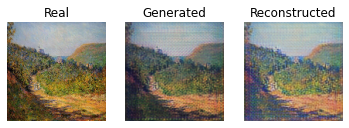

[INFO] Domain B to Domain A


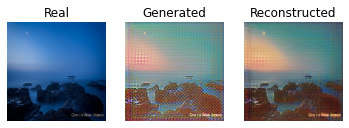

epoch: 30 step: 51 dA_loss: 0.089 dB_loss: 0.100 gAB_loss :5.023 gBA_loss: 5.196
epoch: 30 step: 52 dA_loss: 0.089 dB_loss: 0.123 gAB_loss :5.115 gBA_loss: 5.206
epoch: 30 step: 53 dA_loss: 0.053 dB_loss: 0.074 gAB_loss :4.692 gBA_loss: 4.778
epoch: 30 step: 54 dA_loss: 0.012 dB_loss: 0.124 gAB_loss :4.492 gBA_loss: 4.428
epoch: 30 step: 55 dA_loss: 0.029 dB_loss: 0.070 gAB_loss :4.850 gBA_loss: 5.039
epoch: 30 step: 56 dA_loss: 0.054 dB_loss: 0.061 gAB_loss :4.458 gBA_loss: 4.708
epoch: 30 step: 57 dA_loss: 0.087 dB_loss: 0.154 gAB_loss :4.173 gBA_loss: 4.710
epoch: 30 step: 58 dA_loss: 0.011 dB_loss: 0.148 gAB_loss :4.737 gBA_loss: 4.832
epoch: 30 step: 59 dA_loss: 0.128 dB_loss: 0.128 gAB_loss :4.513 gBA_loss: 4.539
epoch: 30 step: 60 dA_loss: 0.064 dB_loss: 0.212 gAB_loss :4.645 gBA_loss: 4.452
epoch: 30 step: 61 dA_loss: 0.021 dB_loss: 0.064 gAB_loss :4.272 gBA_loss: 4.818
epoch: 30 step: 62 dA_loss: 0.127 dB_loss: 0.075 gAB_loss :4.266 gBA_loss: 4.634
epoch: 30 step: 63 dA_loss: 

 31%|███       | 31/100 [51:25<1:52:58, 98.24s/it]

epoch: 30 step: 73 dA_loss: 0.132 dB_loss: 0.045 gAB_loss :4.696 gBA_loss: 5.176
epoch: 31 step: 0 dA_loss: 0.018 dB_loss: 0.025 gAB_loss :4.622 gBA_loss: 5.014
[INFO] Domain A to Domain B


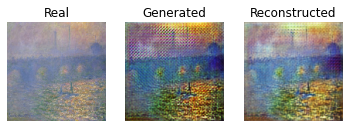

[INFO] Domain B to Domain A


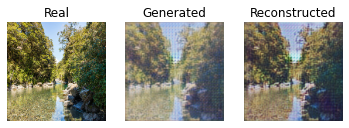

epoch: 31 step: 1 dA_loss: 0.004 dB_loss: 0.129 gAB_loss :4.666 gBA_loss: 4.868
epoch: 31 step: 2 dA_loss: 0.063 dB_loss: 0.060 gAB_loss :4.548 gBA_loss: 4.915
epoch: 31 step: 3 dA_loss: 0.004 dB_loss: 0.028 gAB_loss :4.446 gBA_loss: 4.643
epoch: 31 step: 4 dA_loss: 0.053 dB_loss: 0.006 gAB_loss :4.532 gBA_loss: 4.636
epoch: 31 step: 5 dA_loss: 0.056 dB_loss: 0.099 gAB_loss :4.751 gBA_loss: 4.595
epoch: 31 step: 6 dA_loss: 0.044 dB_loss: 0.018 gAB_loss :4.212 gBA_loss: 4.270
epoch: 31 step: 7 dA_loss: 0.014 dB_loss: 0.137 gAB_loss :4.050 gBA_loss: 4.000
epoch: 31 step: 8 dA_loss: 0.142 dB_loss: 0.066 gAB_loss :4.267 gBA_loss: 4.711
epoch: 31 step: 9 dA_loss: 0.021 dB_loss: 0.269 gAB_loss :4.279 gBA_loss: 4.379
epoch: 31 step: 10 dA_loss: 0.022 dB_loss: 0.049 gAB_loss :5.342 gBA_loss: 5.558
epoch: 31 step: 11 dA_loss: 0.022 dB_loss: 0.059 gAB_loss :4.694 gBA_loss: 4.921
epoch: 31 step: 12 dA_loss: 0.055 dB_loss: 0.107 gAB_loss :4.468 gBA_loss: 4.800
epoch: 31 step: 13 dA_loss: 0.051 dB_

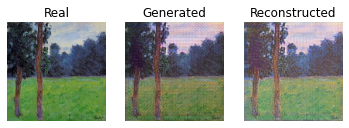

[INFO] Domain B to Domain A


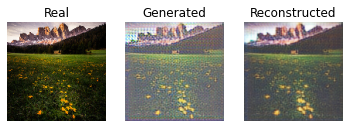

epoch: 31 step: 51 dA_loss: 0.049 dB_loss: 0.094 gAB_loss :5.005 gBA_loss: 5.122
epoch: 31 step: 52 dA_loss: 0.052 dB_loss: 0.044 gAB_loss :4.784 gBA_loss: 5.252
epoch: 31 step: 53 dA_loss: 0.050 dB_loss: 0.062 gAB_loss :4.684 gBA_loss: 4.863
epoch: 31 step: 54 dA_loss: 0.007 dB_loss: 0.096 gAB_loss :4.543 gBA_loss: 4.481
epoch: 31 step: 55 dA_loss: 0.004 dB_loss: 0.066 gAB_loss :4.903 gBA_loss: 5.024
epoch: 31 step: 56 dA_loss: 0.053 dB_loss: 0.019 gAB_loss :4.551 gBA_loss: 4.664
epoch: 31 step: 57 dA_loss: 0.019 dB_loss: 0.124 gAB_loss :4.355 gBA_loss: 4.681
epoch: 31 step: 58 dA_loss: 0.005 dB_loss: 0.011 gAB_loss :4.570 gBA_loss: 4.855
epoch: 31 step: 59 dA_loss: 0.056 dB_loss: 0.019 gAB_loss :4.424 gBA_loss: 4.456
epoch: 31 step: 60 dA_loss: 0.011 dB_loss: 0.081 gAB_loss :4.593 gBA_loss: 4.612
epoch: 31 step: 61 dA_loss: 0.005 dB_loss: 0.219 gAB_loss :4.732 gBA_loss: 4.886
epoch: 31 step: 62 dA_loss: 0.063 dB_loss: 0.311 gAB_loss :4.517 gBA_loss: 4.476
epoch: 31 step: 63 dA_loss: 

 32%|███▏      | 32/100 [53:03<1:51:17, 98.19s/it]

epoch: 31 step: 73 dA_loss: 0.153 dB_loss: 0.081 gAB_loss :4.706 gBA_loss: 5.015
epoch: 32 step: 0 dA_loss: 0.063 dB_loss: 0.223 gAB_loss :4.744 gBA_loss: 4.793
[INFO] Domain A to Domain B


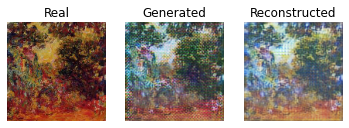

[INFO] Domain B to Domain A


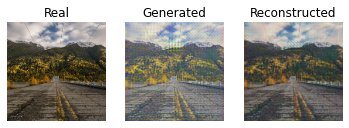

epoch: 32 step: 1 dA_loss: 0.044 dB_loss: 0.293 gAB_loss :4.705 gBA_loss: 4.812
epoch: 32 step: 2 dA_loss: 0.059 dB_loss: 0.138 gAB_loss :4.489 gBA_loss: 4.838
epoch: 32 step: 3 dA_loss: 0.045 dB_loss: 0.161 gAB_loss :4.249 gBA_loss: 4.616
epoch: 32 step: 4 dA_loss: 0.059 dB_loss: 0.049 gAB_loss :4.277 gBA_loss: 4.612
epoch: 32 step: 5 dA_loss: 0.051 dB_loss: 0.143 gAB_loss :4.580 gBA_loss: 4.560
epoch: 32 step: 6 dA_loss: 0.063 dB_loss: 0.060 gAB_loss :4.078 gBA_loss: 4.221
epoch: 32 step: 7 dA_loss: 0.038 dB_loss: 0.088 gAB_loss :3.722 gBA_loss: 3.888
epoch: 32 step: 8 dA_loss: 0.160 dB_loss: 0.048 gAB_loss :4.045 gBA_loss: 4.607
epoch: 32 step: 9 dA_loss: 0.069 dB_loss: 0.091 gAB_loss :4.156 gBA_loss: 4.392
epoch: 32 step: 10 dA_loss: 0.019 dB_loss: 0.074 gAB_loss :5.289 gBA_loss: 5.574
epoch: 32 step: 11 dA_loss: 0.003 dB_loss: 0.061 gAB_loss :4.716 gBA_loss: 4.900
epoch: 32 step: 12 dA_loss: 0.063 dB_loss: 0.119 gAB_loss :4.481 gBA_loss: 4.733
epoch: 32 step: 13 dA_loss: 0.062 dB_

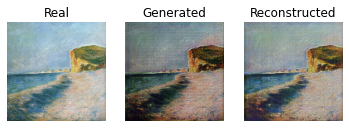

[INFO] Domain B to Domain A


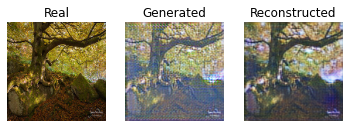

epoch: 32 step: 51 dA_loss: 0.081 dB_loss: 0.099 gAB_loss :4.979 gBA_loss: 5.094
epoch: 32 step: 52 dA_loss: 0.045 dB_loss: 0.043 gAB_loss :4.747 gBA_loss: 5.193
epoch: 32 step: 53 dA_loss: 0.062 dB_loss: 0.066 gAB_loss :4.688 gBA_loss: 4.806
epoch: 32 step: 54 dA_loss: 0.020 dB_loss: 0.099 gAB_loss :4.537 gBA_loss: 4.520
epoch: 32 step: 55 dA_loss: 0.004 dB_loss: 0.069 gAB_loss :4.885 gBA_loss: 5.069
epoch: 32 step: 56 dA_loss: 0.073 dB_loss: 0.038 gAB_loss :4.551 gBA_loss: 4.678
epoch: 32 step: 57 dA_loss: 0.056 dB_loss: 0.122 gAB_loss :4.309 gBA_loss: 4.639
epoch: 32 step: 58 dA_loss: 0.016 dB_loss: 0.026 gAB_loss :4.462 gBA_loss: 4.794
epoch: 32 step: 59 dA_loss: 0.087 dB_loss: 0.037 gAB_loss :4.440 gBA_loss: 4.434
epoch: 32 step: 60 dA_loss: 0.036 dB_loss: 0.090 gAB_loss :4.612 gBA_loss: 4.362
epoch: 32 step: 61 dA_loss: 0.104 dB_loss: 0.029 gAB_loss :4.604 gBA_loss: 4.909
epoch: 32 step: 62 dA_loss: 0.061 dB_loss: 0.077 gAB_loss :4.456 gBA_loss: 4.460
epoch: 32 step: 63 dA_loss: 

 33%|███▎      | 33/100 [54:41<1:49:37, 98.17s/it]

epoch: 32 step: 73 dA_loss: 0.130 dB_loss: 0.064 gAB_loss :4.754 gBA_loss: 5.171
epoch: 33 step: 0 dA_loss: 0.016 dB_loss: 0.008 gAB_loss :4.624 gBA_loss: 4.908
[INFO] Domain A to Domain B


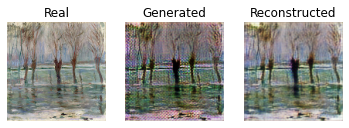

[INFO] Domain B to Domain A


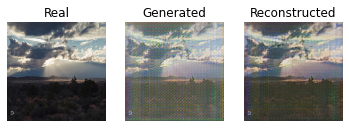

epoch: 33 step: 1 dA_loss: 0.011 dB_loss: 0.121 gAB_loss :4.610 gBA_loss: 4.766
epoch: 33 step: 2 dA_loss: 0.059 dB_loss: 0.053 gAB_loss :4.399 gBA_loss: 4.834
epoch: 33 step: 3 dA_loss: 0.006 dB_loss: 0.294 gAB_loss :4.445 gBA_loss: 4.569
epoch: 33 step: 4 dA_loss: 0.048 dB_loss: 0.122 gAB_loss :4.462 gBA_loss: 4.573
epoch: 33 step: 5 dA_loss: 0.055 dB_loss: 0.391 gAB_loss :4.649 gBA_loss: 4.549
epoch: 33 step: 6 dA_loss: 0.060 dB_loss: 0.386 gAB_loss :4.092 gBA_loss: 4.246
epoch: 33 step: 7 dA_loss: 0.042 dB_loss: 0.195 gAB_loss :3.545 gBA_loss: 3.944
epoch: 33 step: 8 dA_loss: 0.150 dB_loss: 0.087 gAB_loss :3.783 gBA_loss: 4.553
epoch: 33 step: 9 dA_loss: 0.185 dB_loss: 0.131 gAB_loss :3.972 gBA_loss: 4.530
epoch: 33 step: 10 dA_loss: 0.006 dB_loss: 0.123 gAB_loss :5.163 gBA_loss: 5.580
epoch: 33 step: 11 dA_loss: 0.006 dB_loss: 0.074 gAB_loss :4.663 gBA_loss: 4.855
epoch: 33 step: 12 dA_loss: 0.130 dB_loss: 0.132 gAB_loss :4.468 gBA_loss: 4.665
epoch: 33 step: 13 dA_loss: 0.051 dB_

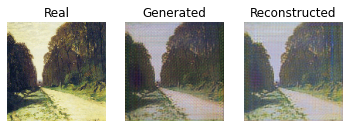

[INFO] Domain B to Domain A


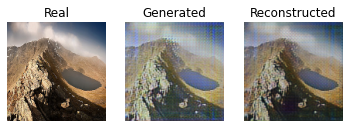

epoch: 33 step: 51 dA_loss: 0.055 dB_loss: 0.085 gAB_loss :5.031 gBA_loss: 5.109
epoch: 33 step: 52 dA_loss: 0.036 dB_loss: 0.056 gAB_loss :5.030 gBA_loss: 5.322
epoch: 33 step: 53 dA_loss: 0.053 dB_loss: 0.077 gAB_loss :4.579 gBA_loss: 4.885
epoch: 33 step: 54 dA_loss: 0.006 dB_loss: 0.076 gAB_loss :4.359 gBA_loss: 4.475
epoch: 33 step: 55 dA_loss: 0.005 dB_loss: 0.069 gAB_loss :4.804 gBA_loss: 5.030
epoch: 33 step: 56 dA_loss: 0.073 dB_loss: 0.041 gAB_loss :4.497 gBA_loss: 4.669
epoch: 33 step: 57 dA_loss: 0.049 dB_loss: 0.140 gAB_loss :4.368 gBA_loss: 4.708
epoch: 33 step: 58 dA_loss: 0.014 dB_loss: 0.027 gAB_loss :4.644 gBA_loss: 4.894
epoch: 33 step: 59 dA_loss: 0.149 dB_loss: 0.021 gAB_loss :4.530 gBA_loss: 4.660
epoch: 33 step: 60 dA_loss: 0.254 dB_loss: 0.042 gAB_loss :4.544 gBA_loss: 4.515
epoch: 33 step: 61 dA_loss: 0.122 dB_loss: 0.063 gAB_loss :4.619 gBA_loss: 4.663
epoch: 33 step: 62 dA_loss: 0.066 dB_loss: 0.132 gAB_loss :4.427 gBA_loss: 4.160
epoch: 33 step: 63 dA_loss: 

 34%|███▍      | 34/100 [56:19<1:47:59, 98.17s/it]

epoch: 33 step: 73 dA_loss: 0.116 dB_loss: 0.029 gAB_loss :4.735 gBA_loss: 5.119
epoch: 34 step: 0 dA_loss: 0.008 dB_loss: 0.030 gAB_loss :4.544 gBA_loss: 4.796
[INFO] Domain A to Domain B


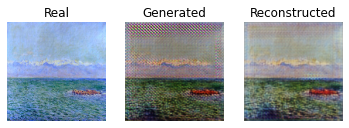

[INFO] Domain B to Domain A


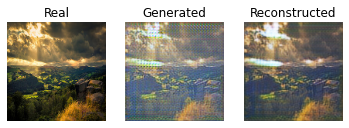

epoch: 34 step: 1 dA_loss: 0.016 dB_loss: 0.121 gAB_loss :4.568 gBA_loss: 4.669
epoch: 34 step: 2 dA_loss: 0.058 dB_loss: 0.046 gAB_loss :4.409 gBA_loss: 4.771
epoch: 34 step: 3 dA_loss: 0.009 dB_loss: 0.023 gAB_loss :4.358 gBA_loss: 4.639
epoch: 34 step: 4 dA_loss: 0.048 dB_loss: 0.008 gAB_loss :4.492 gBA_loss: 4.601
epoch: 34 step: 5 dA_loss: 0.051 dB_loss: 0.042 gAB_loss :4.731 gBA_loss: 4.550
epoch: 34 step: 6 dA_loss: 0.069 dB_loss: 0.007 gAB_loss :4.232 gBA_loss: 4.293
epoch: 34 step: 7 dA_loss: 0.044 dB_loss: 0.068 gAB_loss :3.910 gBA_loss: 4.014
epoch: 34 step: 8 dA_loss: 0.163 dB_loss: 0.029 gAB_loss :4.177 gBA_loss: 4.609
epoch: 34 step: 9 dA_loss: 0.101 dB_loss: 0.121 gAB_loss :4.353 gBA_loss: 4.308
epoch: 34 step: 10 dA_loss: 0.103 dB_loss: 0.064 gAB_loss :5.375 gBA_loss: 5.582
epoch: 34 step: 11 dA_loss: 0.005 dB_loss: 0.109 gAB_loss :4.778 gBA_loss: 4.864
epoch: 34 step: 12 dA_loss: 0.110 dB_loss: 0.166 gAB_loss :4.462 gBA_loss: 4.674
epoch: 34 step: 13 dA_loss: 0.101 dB_

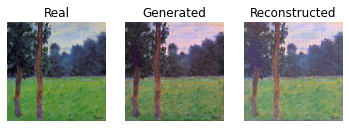

[INFO] Domain B to Domain A


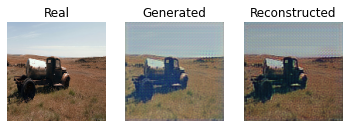

epoch: 34 step: 51 dA_loss: 0.057 dB_loss: 0.124 gAB_loss :4.996 gBA_loss: 4.992
epoch: 34 step: 52 dA_loss: 0.022 dB_loss: 0.039 gAB_loss :4.761 gBA_loss: 5.379
epoch: 34 step: 53 dA_loss: 0.054 dB_loss: 0.248 gAB_loss :4.775 gBA_loss: 4.866
epoch: 34 step: 54 dA_loss: 0.007 dB_loss: 0.173 gAB_loss :4.489 gBA_loss: 4.475
epoch: 34 step: 55 dA_loss: 0.013 dB_loss: 0.090 gAB_loss :4.842 gBA_loss: 5.058
epoch: 34 step: 56 dA_loss: 0.100 dB_loss: 0.059 gAB_loss :4.507 gBA_loss: 4.563
epoch: 34 step: 57 dA_loss: 0.203 dB_loss: 0.159 gAB_loss :4.281 gBA_loss: 4.873
epoch: 34 step: 58 dA_loss: 0.040 dB_loss: 0.150 gAB_loss :4.669 gBA_loss: 4.917
epoch: 34 step: 59 dA_loss: 0.100 dB_loss: 0.092 gAB_loss :4.418 gBA_loss: 4.447
epoch: 34 step: 60 dA_loss: 0.151 dB_loss: 0.129 gAB_loss :4.373 gBA_loss: 4.334
epoch: 34 step: 61 dA_loss: 0.068 dB_loss: 0.192 gAB_loss :4.555 gBA_loss: 4.468
epoch: 34 step: 62 dA_loss: 0.355 dB_loss: 0.178 gAB_loss :4.368 gBA_loss: 4.353
epoch: 34 step: 63 dA_loss: 

 35%|███▌      | 35/100 [57:57<1:46:21, 98.17s/it]

epoch: 34 step: 73 dA_loss: 0.116 dB_loss: 0.044 gAB_loss :4.709 gBA_loss: 4.982
epoch: 35 step: 0 dA_loss: 0.051 dB_loss: 0.031 gAB_loss :4.570 gBA_loss: 4.750
[INFO] Domain A to Domain B


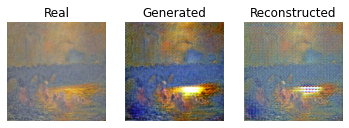

[INFO] Domain B to Domain A


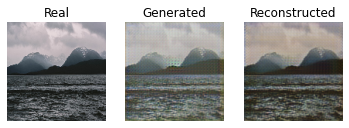

epoch: 35 step: 1 dA_loss: 0.025 dB_loss: 0.138 gAB_loss :4.556 gBA_loss: 4.768
epoch: 35 step: 2 dA_loss: 0.057 dB_loss: 0.072 gAB_loss :4.333 gBA_loss: 4.802
epoch: 35 step: 3 dA_loss: 0.077 dB_loss: 0.049 gAB_loss :4.294 gBA_loss: 4.516
epoch: 35 step: 4 dA_loss: 0.028 dB_loss: 0.011 gAB_loss :4.414 gBA_loss: 4.426
epoch: 35 step: 5 dA_loss: 0.150 dB_loss: 0.080 gAB_loss :4.704 gBA_loss: 4.655
epoch: 35 step: 6 dA_loss: 0.063 dB_loss: 0.022 gAB_loss :4.219 gBA_loss: 4.372
epoch: 35 step: 7 dA_loss: 0.054 dB_loss: 0.069 gAB_loss :3.765 gBA_loss: 4.000
epoch: 35 step: 8 dA_loss: 0.208 dB_loss: 0.080 gAB_loss :4.126 gBA_loss: 4.652
epoch: 35 step: 9 dA_loss: 0.107 dB_loss: 0.073 gAB_loss :4.239 gBA_loss: 4.250
epoch: 35 step: 10 dA_loss: 0.020 dB_loss: 0.046 gAB_loss :5.166 gBA_loss: 5.267
epoch: 35 step: 11 dA_loss: 0.017 dB_loss: 0.066 gAB_loss :4.677 gBA_loss: 4.624
epoch: 35 step: 12 dA_loss: 0.072 dB_loss: 0.122 gAB_loss :4.485 gBA_loss: 4.530
epoch: 35 step: 13 dA_loss: 0.048 dB_

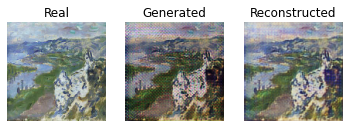

[INFO] Domain B to Domain A


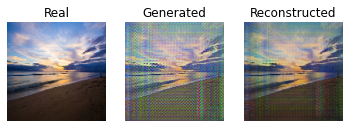

epoch: 35 step: 51 dA_loss: 0.067 dB_loss: 0.069 gAB_loss :4.986 gBA_loss: 4.993
epoch: 35 step: 52 dA_loss: 0.090 dB_loss: 0.054 gAB_loss :4.951 gBA_loss: 5.370
epoch: 35 step: 53 dA_loss: 0.063 dB_loss: 0.048 gAB_loss :4.507 gBA_loss: 4.870
epoch: 35 step: 54 dA_loss: 0.022 dB_loss: 0.090 gAB_loss :4.349 gBA_loss: 4.425
epoch: 35 step: 55 dA_loss: 0.005 dB_loss: 0.080 gAB_loss :4.757 gBA_loss: 4.948
epoch: 35 step: 56 dA_loss: 0.078 dB_loss: 0.053 gAB_loss :4.482 gBA_loss: 4.522
epoch: 35 step: 57 dA_loss: 0.038 dB_loss: 0.121 gAB_loss :4.290 gBA_loss: 4.518
epoch: 35 step: 58 dA_loss: 0.006 dB_loss: 0.043 gAB_loss :4.517 gBA_loss: 4.749
epoch: 35 step: 59 dA_loss: 0.073 dB_loss: 0.015 gAB_loss :4.354 gBA_loss: 4.466
epoch: 35 step: 60 dA_loss: 0.064 dB_loss: 0.047 gAB_loss :4.538 gBA_loss: 4.371
epoch: 35 step: 61 dA_loss: 0.015 dB_loss: 0.045 gAB_loss :4.569 gBA_loss: 4.623
epoch: 35 step: 62 dA_loss: 0.117 dB_loss: 0.064 gAB_loss :4.372 gBA_loss: 4.484
epoch: 35 step: 63 dA_loss: 

 36%|███▌      | 36/100 [59:36<1:44:44, 98.20s/it]

epoch: 35 step: 73 dA_loss: 0.138 dB_loss: 0.013 gAB_loss :4.744 gBA_loss: 5.127
epoch: 36 step: 0 dA_loss: 0.024 dB_loss: 0.010 gAB_loss :4.611 gBA_loss: 4.701
[INFO] Domain A to Domain B


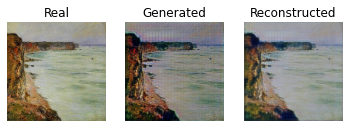

[INFO] Domain B to Domain A


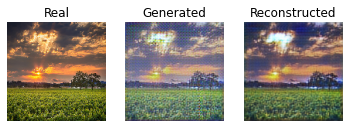

epoch: 36 step: 1 dA_loss: 0.037 dB_loss: 0.121 gAB_loss :4.610 gBA_loss: 4.593
epoch: 36 step: 2 dA_loss: 0.075 dB_loss: 0.052 gAB_loss :4.425 gBA_loss: 4.768
epoch: 36 step: 3 dA_loss: 0.012 dB_loss: 0.015 gAB_loss :4.265 gBA_loss: 4.566
epoch: 36 step: 4 dA_loss: 0.044 dB_loss: 0.013 gAB_loss :4.375 gBA_loss: 4.541
epoch: 36 step: 5 dA_loss: 0.030 dB_loss: 0.041 gAB_loss :4.698 gBA_loss: 4.457
epoch: 36 step: 6 dA_loss: 0.194 dB_loss: 0.033 gAB_loss :4.362 gBA_loss: 4.476
epoch: 36 step: 7 dA_loss: 0.060 dB_loss: 0.063 gAB_loss :3.913 gBA_loss: 4.048
epoch: 36 step: 8 dA_loss: 0.233 dB_loss: 0.041 gAB_loss :4.124 gBA_loss: 4.633
epoch: 36 step: 9 dA_loss: 0.176 dB_loss: 0.060 gAB_loss :4.165 gBA_loss: 4.184
epoch: 36 step: 10 dA_loss: 0.041 dB_loss: 0.036 gAB_loss :5.114 gBA_loss: 5.205
epoch: 36 step: 11 dA_loss: 0.029 dB_loss: 0.094 gAB_loss :4.773 gBA_loss: 4.605
epoch: 36 step: 12 dA_loss: 0.083 dB_loss: 0.115 gAB_loss :4.466 gBA_loss: 4.528
epoch: 36 step: 13 dA_loss: 0.053 dB_

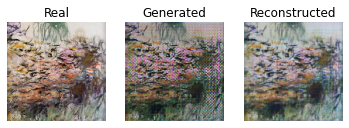

[INFO] Domain B to Domain A


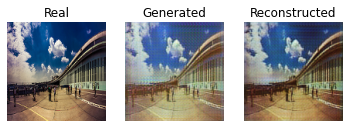

epoch: 36 step: 51 dA_loss: 0.050 dB_loss: 0.126 gAB_loss :5.002 gBA_loss: 5.035
epoch: 36 step: 52 dA_loss: 0.011 dB_loss: 0.031 gAB_loss :4.779 gBA_loss: 5.247
epoch: 36 step: 53 dA_loss: 0.047 dB_loss: 0.100 gAB_loss :4.763 gBA_loss: 4.781
epoch: 36 step: 54 dA_loss: 0.011 dB_loss: 0.095 gAB_loss :4.495 gBA_loss: 4.434
epoch: 36 step: 55 dA_loss: 0.008 dB_loss: 0.092 gAB_loss :4.851 gBA_loss: 5.007
epoch: 36 step: 56 dA_loss: 0.053 dB_loss: 0.067 gAB_loss :4.525 gBA_loss: 4.633
epoch: 36 step: 57 dA_loss: 0.066 dB_loss: 0.118 gAB_loss :4.302 gBA_loss: 4.618
epoch: 36 step: 58 dA_loss: 0.024 dB_loss: 0.057 gAB_loss :4.525 gBA_loss: 4.875
epoch: 36 step: 59 dA_loss: 0.060 dB_loss: 0.009 gAB_loss :4.370 gBA_loss: 4.520
epoch: 36 step: 60 dA_loss: 0.053 dB_loss: 0.058 gAB_loss :4.407 gBA_loss: 4.236
epoch: 36 step: 61 dA_loss: 0.189 dB_loss: 0.051 gAB_loss :4.449 gBA_loss: 4.920
epoch: 36 step: 62 dA_loss: 0.060 dB_loss: 0.029 gAB_loss :4.367 gBA_loss: 4.499
epoch: 36 step: 63 dA_loss: 

 37%|███▋      | 37/100 [1:01:14<1:43:07, 98.22s/it]

epoch: 36 step: 73 dA_loss: 0.123 dB_loss: 0.017 gAB_loss :4.714 gBA_loss: 5.028
epoch: 37 step: 0 dA_loss: 0.042 dB_loss: 0.026 gAB_loss :4.554 gBA_loss: 4.701
[INFO] Domain A to Domain B


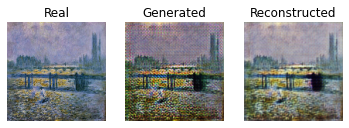

[INFO] Domain B to Domain A


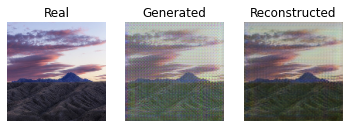

epoch: 37 step: 1 dA_loss: 0.019 dB_loss: 0.110 gAB_loss :4.547 gBA_loss: 4.668
epoch: 37 step: 2 dA_loss: 0.057 dB_loss: 0.015 gAB_loss :4.398 gBA_loss: 4.751
epoch: 37 step: 3 dA_loss: 0.026 dB_loss: 0.081 gAB_loss :4.413 gBA_loss: 4.624
epoch: 37 step: 4 dA_loss: 0.056 dB_loss: 0.002 gAB_loss :4.459 gBA_loss: 4.663
epoch: 37 step: 5 dA_loss: 0.050 dB_loss: 0.120 gAB_loss :4.712 gBA_loss: 4.663
epoch: 37 step: 6 dA_loss: 0.071 dB_loss: 0.016 gAB_loss :4.192 gBA_loss: 4.351
epoch: 37 step: 7 dA_loss: 0.057 dB_loss: 0.068 gAB_loss :3.754 gBA_loss: 3.968
epoch: 37 step: 8 dA_loss: 0.138 dB_loss: 0.096 gAB_loss :4.196 gBA_loss: 4.647
epoch: 37 step: 9 dA_loss: 0.122 dB_loss: 0.066 gAB_loss :4.251 gBA_loss: 4.334
epoch: 37 step: 10 dA_loss: 0.009 dB_loss: 0.064 gAB_loss :5.215 gBA_loss: 5.366
epoch: 37 step: 11 dA_loss: 0.007 dB_loss: 0.073 gAB_loss :4.661 gBA_loss: 4.692
epoch: 37 step: 12 dA_loss: 0.055 dB_loss: 0.116 gAB_loss :4.336 gBA_loss: 4.611
epoch: 37 step: 13 dA_loss: 0.047 dB_

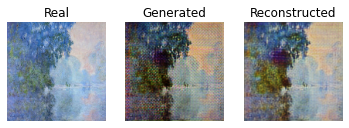

[INFO] Domain B to Domain A


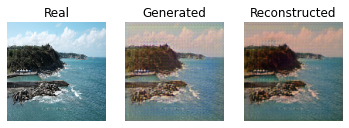

epoch: 37 step: 51 dA_loss: 0.085 dB_loss: 0.116 gAB_loss :4.923 gBA_loss: 4.895
epoch: 37 step: 52 dA_loss: 0.011 dB_loss: 0.044 gAB_loss :4.732 gBA_loss: 5.044
epoch: 37 step: 53 dA_loss: 0.126 dB_loss: 0.030 gAB_loss :4.397 gBA_loss: 4.816
epoch: 37 step: 54 dA_loss: 0.026 dB_loss: 0.166 gAB_loss :4.375 gBA_loss: 4.442
epoch: 37 step: 55 dA_loss: 0.005 dB_loss: 0.067 gAB_loss :4.799 gBA_loss: 4.973
epoch: 37 step: 56 dA_loss: 0.113 dB_loss: 0.068 gAB_loss :4.518 gBA_loss: 4.562
epoch: 37 step: 57 dA_loss: 0.061 dB_loss: 0.119 gAB_loss :4.266 gBA_loss: 4.505
epoch: 37 step: 58 dA_loss: 0.010 dB_loss: 0.061 gAB_loss :4.491 gBA_loss: 4.681
epoch: 37 step: 59 dA_loss: 0.025 dB_loss: 0.012 gAB_loss :4.272 gBA_loss: 4.315
epoch: 37 step: 60 dA_loss: 0.036 dB_loss: 0.057 gAB_loss :4.500 gBA_loss: 4.400
epoch: 37 step: 61 dA_loss: 0.007 dB_loss: 0.135 gAB_loss :4.535 gBA_loss: 4.726
epoch: 37 step: 62 dA_loss: 0.066 dB_loss: 0.101 gAB_loss :4.317 gBA_loss: 4.362
epoch: 37 step: 63 dA_loss: 

 38%|███▊      | 38/100 [1:02:52<1:41:35, 98.32s/it]

epoch: 37 step: 73 dA_loss: 0.117 dB_loss: 0.007 gAB_loss :4.722 gBA_loss: 5.064
epoch: 38 step: 0 dA_loss: 0.063 dB_loss: 0.048 gAB_loss :4.523 gBA_loss: 4.698
[INFO] Domain A to Domain B


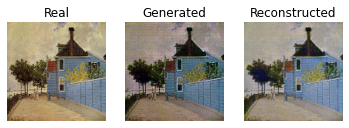

[INFO] Domain B to Domain A


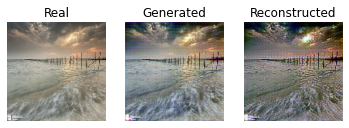

epoch: 38 step: 1 dA_loss: 0.012 dB_loss: 0.127 gAB_loss :4.553 gBA_loss: 4.636
epoch: 38 step: 2 dA_loss: 0.043 dB_loss: 0.033 gAB_loss :4.353 gBA_loss: 4.669
epoch: 38 step: 3 dA_loss: 0.016 dB_loss: 0.036 gAB_loss :4.163 gBA_loss: 4.494
epoch: 38 step: 4 dA_loss: 0.050 dB_loss: 0.018 gAB_loss :4.313 gBA_loss: 4.597
epoch: 38 step: 5 dA_loss: 0.018 dB_loss: 0.024 gAB_loss :4.639 gBA_loss: 4.660
epoch: 38 step: 6 dA_loss: 0.059 dB_loss: 0.019 gAB_loss :4.183 gBA_loss: 4.301
epoch: 38 step: 7 dA_loss: 0.037 dB_loss: 0.061 gAB_loss :3.780 gBA_loss: 3.971
epoch: 38 step: 8 dA_loss: 0.094 dB_loss: 0.038 gAB_loss :4.025 gBA_loss: 4.576
epoch: 38 step: 9 dA_loss: 0.108 dB_loss: 0.072 gAB_loss :4.207 gBA_loss: 4.267
epoch: 38 step: 10 dA_loss: 0.026 dB_loss: 0.039 gAB_loss :5.192 gBA_loss: 5.370
epoch: 38 step: 11 dA_loss: 0.026 dB_loss: 0.066 gAB_loss :4.661 gBA_loss: 4.794
epoch: 38 step: 12 dA_loss: 0.058 dB_loss: 0.091 gAB_loss :4.522 gBA_loss: 4.688
epoch: 38 step: 13 dA_loss: 0.045 dB_

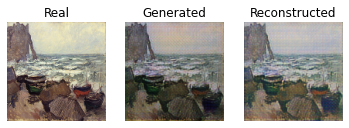

[INFO] Domain B to Domain A


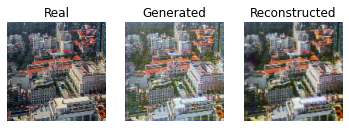

epoch: 38 step: 51 dA_loss: 0.128 dB_loss: 0.071 gAB_loss :4.940 gBA_loss: 4.983
epoch: 38 step: 52 dA_loss: 0.023 dB_loss: 0.040 gAB_loss :4.769 gBA_loss: 5.032
epoch: 38 step: 53 dA_loss: 0.041 dB_loss: 0.033 gAB_loss :4.378 gBA_loss: 4.613
epoch: 38 step: 54 dA_loss: 0.036 dB_loss: 0.165 gAB_loss :4.300 gBA_loss: 4.300
epoch: 38 step: 55 dA_loss: 0.039 dB_loss: 0.071 gAB_loss :4.748 gBA_loss: 4.914
epoch: 38 step: 56 dA_loss: 0.048 dB_loss: 0.061 gAB_loss :4.489 gBA_loss: 4.675
epoch: 38 step: 57 dA_loss: 0.088 dB_loss: 0.113 gAB_loss :4.266 gBA_loss: 4.641
epoch: 38 step: 58 dA_loss: 0.008 dB_loss: 0.054 gAB_loss :4.491 gBA_loss: 4.736
epoch: 38 step: 59 dA_loss: 0.035 dB_loss: 0.005 gAB_loss :4.304 gBA_loss: 4.411
epoch: 38 step: 60 dA_loss: 0.138 dB_loss: 0.047 gAB_loss :4.516 gBA_loss: 4.510
epoch: 38 step: 61 dA_loss: 0.038 dB_loss: 0.017 gAB_loss :4.352 gBA_loss: 4.633
epoch: 38 step: 62 dA_loss: 0.203 dB_loss: 0.020 gAB_loss :4.258 gBA_loss: 4.569
epoch: 38 step: 63 dA_loss: 

 39%|███▉      | 39/100 [1:04:31<1:39:56, 98.31s/it]

epoch: 38 step: 73 dA_loss: 0.119 dB_loss: 0.007 gAB_loss :4.732 gBA_loss: 5.045
epoch: 39 step: 0 dA_loss: 0.078 dB_loss: 0.033 gAB_loss :4.533 gBA_loss: 4.652
[INFO] Domain A to Domain B


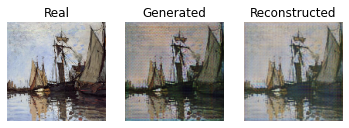

[INFO] Domain B to Domain A


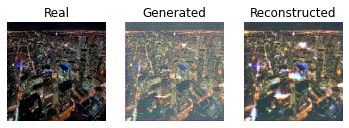

epoch: 39 step: 1 dA_loss: 0.013 dB_loss: 0.122 gAB_loss :4.533 gBA_loss: 4.574
epoch: 39 step: 2 dA_loss: 0.034 dB_loss: 0.022 gAB_loss :4.424 gBA_loss: 4.653
epoch: 39 step: 3 dA_loss: 0.056 dB_loss: 0.011 gAB_loss :4.304 gBA_loss: 4.428
epoch: 39 step: 4 dA_loss: 0.138 dB_loss: 0.006 gAB_loss :4.444 gBA_loss: 4.654
epoch: 39 step: 5 dA_loss: 0.020 dB_loss: 0.039 gAB_loss :4.686 gBA_loss: 4.595
epoch: 39 step: 6 dA_loss: 0.115 dB_loss: 0.017 gAB_loss :4.111 gBA_loss: 4.177
epoch: 39 step: 7 dA_loss: 0.053 dB_loss: 0.170 gAB_loss :3.860 gBA_loss: 3.777
epoch: 39 step: 8 dA_loss: 0.131 dB_loss: 0.053 gAB_loss :4.092 gBA_loss: 4.472
epoch: 39 step: 9 dA_loss: 0.096 dB_loss: 0.173 gAB_loss :4.126 gBA_loss: 4.141
epoch: 39 step: 10 dA_loss: 0.021 dB_loss: 0.045 gAB_loss :5.052 gBA_loss: 5.174
epoch: 39 step: 11 dA_loss: 0.039 dB_loss: 0.052 gAB_loss :4.511 gBA_loss: 4.632
epoch: 39 step: 12 dA_loss: 0.065 dB_loss: 0.068 gAB_loss :4.344 gBA_loss: 4.539
epoch: 39 step: 13 dA_loss: 0.046 dB_

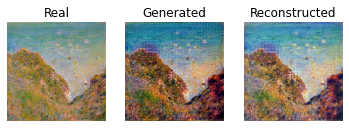

[INFO] Domain B to Domain A


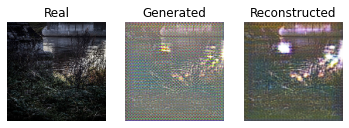

epoch: 39 step: 51 dA_loss: 0.059 dB_loss: 0.064 gAB_loss :4.925 gBA_loss: 4.966
epoch: 39 step: 52 dA_loss: 0.018 dB_loss: 0.020 gAB_loss :4.800 gBA_loss: 5.109
epoch: 39 step: 53 dA_loss: 0.046 dB_loss: 0.022 gAB_loss :4.430 gBA_loss: 4.740
epoch: 39 step: 54 dA_loss: 0.012 dB_loss: 0.154 gAB_loss :4.365 gBA_loss: 4.368
epoch: 39 step: 55 dA_loss: 0.055 dB_loss: 0.070 gAB_loss :4.777 gBA_loss: 4.901
epoch: 39 step: 56 dA_loss: 0.129 dB_loss: 0.060 gAB_loss :4.489 gBA_loss: 4.668
epoch: 39 step: 57 dA_loss: 0.115 dB_loss: 0.106 gAB_loss :4.251 gBA_loss: 4.633
epoch: 39 step: 58 dA_loss: 0.038 dB_loss: 0.048 gAB_loss :4.481 gBA_loss: 4.723
epoch: 39 step: 59 dA_loss: 0.039 dB_loss: 0.006 gAB_loss :4.264 gBA_loss: 4.380
epoch: 39 step: 60 dA_loss: 0.062 dB_loss: 0.032 gAB_loss :4.475 gBA_loss: 4.351
epoch: 39 step: 61 dA_loss: 0.040 dB_loss: 0.014 gAB_loss :4.366 gBA_loss: 4.779
epoch: 39 step: 62 dA_loss: 0.052 dB_loss: 0.010 gAB_loss :4.265 gBA_loss: 4.323
epoch: 39 step: 63 dA_loss: 

 40%|████      | 40/100 [1:06:09<1:38:19, 98.33s/it]

epoch: 39 step: 73 dA_loss: 0.212 dB_loss: 0.041 gAB_loss :4.639 gBA_loss: 4.920
epoch: 40 step: 0 dA_loss: 0.158 dB_loss: 0.056 gAB_loss :4.404 gBA_loss: 4.475
[INFO] Domain A to Domain B


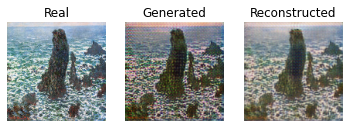

[INFO] Domain B to Domain A


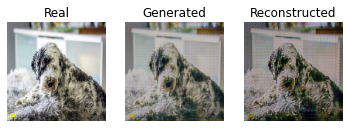

epoch: 40 step: 1 dA_loss: 0.101 dB_loss: 0.100 gAB_loss :4.388 gBA_loss: 4.413
epoch: 40 step: 2 dA_loss: 0.140 dB_loss: 0.069 gAB_loss :4.428 gBA_loss: 4.534
epoch: 40 step: 3 dA_loss: 0.110 dB_loss: 0.012 gAB_loss :4.297 gBA_loss: 4.345
epoch: 40 step: 4 dA_loss: 0.162 dB_loss: 0.006 gAB_loss :4.349 gBA_loss: 4.303
epoch: 40 step: 5 dA_loss: 0.321 dB_loss: 0.051 gAB_loss :4.667 gBA_loss: 4.591
epoch: 40 step: 6 dA_loss: 0.185 dB_loss: 0.027 gAB_loss :4.128 gBA_loss: 4.237
epoch: 40 step: 7 dA_loss: 0.136 dB_loss: 0.060 gAB_loss :3.678 gBA_loss: 3.764
epoch: 40 step: 8 dA_loss: 0.188 dB_loss: 0.051 gAB_loss :4.063 gBA_loss: 4.403
epoch: 40 step: 9 dA_loss: 0.164 dB_loss: 0.051 gAB_loss :4.157 gBA_loss: 4.182
epoch: 40 step: 10 dA_loss: 0.028 dB_loss: 0.038 gAB_loss :5.143 gBA_loss: 5.259
epoch: 40 step: 11 dA_loss: 0.014 dB_loss: 0.068 gAB_loss :4.666 gBA_loss: 4.614
epoch: 40 step: 12 dA_loss: 0.118 dB_loss: 0.048 gAB_loss :4.426 gBA_loss: 4.484
epoch: 40 step: 13 dA_loss: 0.101 dB_

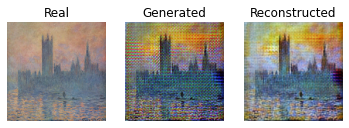

[INFO] Domain B to Domain A


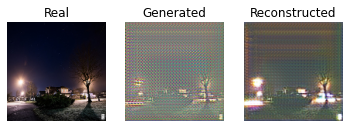

epoch: 40 step: 51 dA_loss: 0.102 dB_loss: 0.091 gAB_loss :5.000 gBA_loss: 4.904
epoch: 40 step: 52 dA_loss: 0.025 dB_loss: 0.043 gAB_loss :4.863 gBA_loss: 5.085
epoch: 40 step: 53 dA_loss: 0.066 dB_loss: 0.110 gAB_loss :4.467 gBA_loss: 4.890
epoch: 40 step: 54 dA_loss: 0.058 dB_loss: 0.120 gAB_loss :4.366 gBA_loss: 4.391
epoch: 40 step: 55 dA_loss: 0.005 dB_loss: 0.086 gAB_loss :4.664 gBA_loss: 4.893
epoch: 40 step: 56 dA_loss: 0.045 dB_loss: 0.059 gAB_loss :4.401 gBA_loss: 4.420
epoch: 40 step: 57 dA_loss: 0.197 dB_loss: 0.105 gAB_loss :4.240 gBA_loss: 4.766
epoch: 40 step: 58 dA_loss: 0.082 dB_loss: 0.046 gAB_loss :4.439 gBA_loss: 4.781
epoch: 40 step: 59 dA_loss: 0.066 dB_loss: 0.007 gAB_loss :4.230 gBA_loss: 4.131
epoch: 40 step: 60 dA_loss: 0.101 dB_loss: 0.039 gAB_loss :4.473 gBA_loss: 4.154
epoch: 40 step: 61 dA_loss: 0.203 dB_loss: 0.014 gAB_loss :4.432 gBA_loss: 4.845
epoch: 40 step: 62 dA_loss: 0.050 dB_loss: 0.011 gAB_loss :4.255 gBA_loss: 4.360
epoch: 40 step: 63 dA_loss: 

 41%|████      | 41/100 [1:07:47<1:36:42, 98.36s/it]

epoch: 40 step: 73 dA_loss: 0.098 dB_loss: 0.006 gAB_loss :4.676 gBA_loss: 5.040
epoch: 41 step: 0 dA_loss: 0.053 dB_loss: 0.023 gAB_loss :4.471 gBA_loss: 4.696
[INFO] Domain A to Domain B


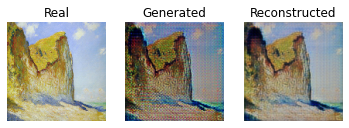

[INFO] Domain B to Domain A


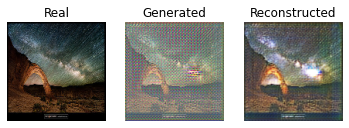

epoch: 41 step: 1 dA_loss: 0.025 dB_loss: 0.098 gAB_loss :4.453 gBA_loss: 4.558
epoch: 41 step: 2 dA_loss: 0.035 dB_loss: 0.024 gAB_loss :4.319 gBA_loss: 4.596
epoch: 41 step: 3 dA_loss: 0.021 dB_loss: 0.048 gAB_loss :4.257 gBA_loss: 4.357
epoch: 41 step: 4 dA_loss: 0.061 dB_loss: 0.004 gAB_loss :4.352 gBA_loss: 4.451
epoch: 41 step: 5 dA_loss: 0.021 dB_loss: 0.066 gAB_loss :4.637 gBA_loss: 4.601
epoch: 41 step: 6 dA_loss: 0.055 dB_loss: 0.061 gAB_loss :4.006 gBA_loss: 4.205
epoch: 41 step: 7 dA_loss: 0.023 dB_loss: 0.085 gAB_loss :3.680 gBA_loss: 3.842
epoch: 41 step: 8 dA_loss: 0.086 dB_loss: 0.028 gAB_loss :4.061 gBA_loss: 4.493
epoch: 41 step: 9 dA_loss: 0.071 dB_loss: 0.029 gAB_loss :4.133 gBA_loss: 4.213
epoch: 41 step: 10 dA_loss: 0.075 dB_loss: 0.020 gAB_loss :5.106 gBA_loss: 5.439
epoch: 41 step: 11 dA_loss: 0.005 dB_loss: 0.072 gAB_loss :4.739 gBA_loss: 4.770
epoch: 41 step: 12 dA_loss: 0.139 dB_loss: 0.045 gAB_loss :4.387 gBA_loss: 4.563
epoch: 41 step: 13 dA_loss: 0.066 dB_

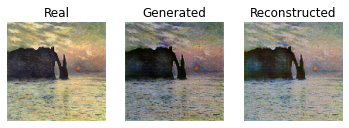

[INFO] Domain B to Domain A


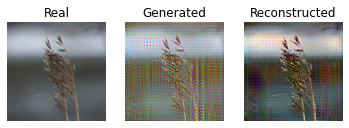

epoch: 41 step: 51 dA_loss: 0.072 dB_loss: 0.085 gAB_loss :4.860 gBA_loss: 4.859
epoch: 41 step: 52 dA_loss: 0.029 dB_loss: 0.049 gAB_loss :4.636 gBA_loss: 4.991
epoch: 41 step: 53 dA_loss: 0.096 dB_loss: 0.028 gAB_loss :4.301 gBA_loss: 4.837
epoch: 41 step: 54 dA_loss: 0.063 dB_loss: 0.104 gAB_loss :4.221 gBA_loss: 4.402
epoch: 41 step: 55 dA_loss: 0.007 dB_loss: 0.098 gAB_loss :4.706 gBA_loss: 4.849
epoch: 41 step: 56 dA_loss: 0.077 dB_loss: 0.072 gAB_loss :4.446 gBA_loss: 4.495
epoch: 41 step: 57 dA_loss: 0.054 dB_loss: 0.113 gAB_loss :4.187 gBA_loss: 4.432
epoch: 41 step: 58 dA_loss: 0.068 dB_loss: 0.052 gAB_loss :4.402 gBA_loss: 4.574
epoch: 41 step: 59 dA_loss: 0.047 dB_loss: 0.008 gAB_loss :4.204 gBA_loss: 4.322
epoch: 41 step: 60 dA_loss: 0.092 dB_loss: 0.057 gAB_loss :4.410 gBA_loss: 4.306
epoch: 41 step: 61 dA_loss: 0.028 dB_loss: 0.037 gAB_loss :4.293 gBA_loss: 4.525
epoch: 41 step: 62 dA_loss: 0.068 dB_loss: 0.011 gAB_loss :4.111 gBA_loss: 4.233
epoch: 41 step: 63 dA_loss: 

 42%|████▏     | 42/100 [1:09:26<1:35:05, 98.37s/it]

epoch: 41 step: 73 dA_loss: 0.094 dB_loss: 0.148 gAB_loss :4.433 gBA_loss: 5.030
epoch: 42 step: 0 dA_loss: 0.018 dB_loss: 0.107 gAB_loss :4.262 gBA_loss: 4.748
[INFO] Domain A to Domain B


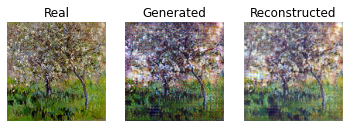

[INFO] Domain B to Domain A


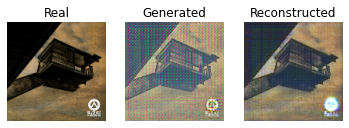

epoch: 42 step: 1 dA_loss: 0.041 dB_loss: 0.350 gAB_loss :4.622 gBA_loss: 4.645
epoch: 42 step: 2 dA_loss: 0.042 dB_loss: 0.132 gAB_loss :4.338 gBA_loss: 4.602
epoch: 42 step: 3 dA_loss: 0.036 dB_loss: 0.166 gAB_loss :4.021 gBA_loss: 4.516
epoch: 42 step: 4 dA_loss: 0.129 dB_loss: 0.045 gAB_loss :4.052 gBA_loss: 4.409
epoch: 42 step: 5 dA_loss: 0.182 dB_loss: 0.084 gAB_loss :4.476 gBA_loss: 4.712
epoch: 42 step: 6 dA_loss: 0.121 dB_loss: 0.084 gAB_loss :4.192 gBA_loss: 4.260
epoch: 42 step: 7 dA_loss: 0.221 dB_loss: 0.090 gAB_loss :3.737 gBA_loss: 3.752
epoch: 42 step: 8 dA_loss: 0.135 dB_loss: 0.060 gAB_loss :4.013 gBA_loss: 4.333
epoch: 42 step: 9 dA_loss: 0.188 dB_loss: 0.070 gAB_loss :4.227 gBA_loss: 4.309
epoch: 42 step: 10 dA_loss: 0.151 dB_loss: 0.056 gAB_loss :5.119 gBA_loss: 5.369
epoch: 42 step: 11 dA_loss: 0.026 dB_loss: 0.078 gAB_loss :4.597 gBA_loss: 4.822
epoch: 42 step: 12 dA_loss: 0.169 dB_loss: 0.055 gAB_loss :4.394 gBA_loss: 4.502
epoch: 42 step: 13 dA_loss: 0.114 dB_

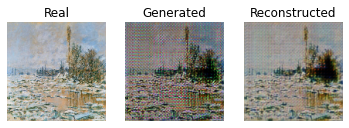

[INFO] Domain B to Domain A


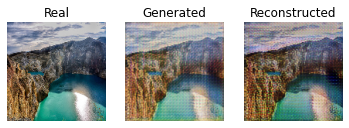

epoch: 42 step: 51 dA_loss: 0.099 dB_loss: 0.067 gAB_loss :4.916 gBA_loss: 4.888
epoch: 42 step: 52 dA_loss: 0.144 dB_loss: 0.020 gAB_loss :4.786 gBA_loss: 5.368
epoch: 42 step: 53 dA_loss: 0.054 dB_loss: 0.037 gAB_loss :4.454 gBA_loss: 4.849
epoch: 42 step: 54 dA_loss: 0.095 dB_loss: 0.061 gAB_loss :4.251 gBA_loss: 4.338
epoch: 42 step: 55 dA_loss: 0.088 dB_loss: 0.099 gAB_loss :4.698 gBA_loss: 4.734
epoch: 42 step: 56 dA_loss: 0.097 dB_loss: 0.055 gAB_loss :4.445 gBA_loss: 4.539
epoch: 42 step: 57 dA_loss: 0.064 dB_loss: 0.106 gAB_loss :4.183 gBA_loss: 4.523
epoch: 42 step: 58 dA_loss: 0.077 dB_loss: 0.056 gAB_loss :4.396 gBA_loss: 4.651
epoch: 42 step: 59 dA_loss: 0.059 dB_loss: 0.014 gAB_loss :4.198 gBA_loss: 4.197
epoch: 42 step: 60 dA_loss: 0.080 dB_loss: 0.055 gAB_loss :4.426 gBA_loss: 4.349
epoch: 42 step: 61 dA_loss: 0.056 dB_loss: 0.077 gAB_loss :4.290 gBA_loss: 4.726
epoch: 42 step: 62 dA_loss: 0.028 dB_loss: 0.015 gAB_loss :4.083 gBA_loss: 4.367
epoch: 42 step: 63 dA_loss: 

 43%|████▎     | 43/100 [1:11:04<1:33:27, 98.38s/it]

epoch: 42 step: 73 dA_loss: 0.116 dB_loss: 0.027 gAB_loss :4.682 gBA_loss: 5.041
epoch: 43 step: 0 dA_loss: 0.024 dB_loss: 0.123 gAB_loss :4.384 gBA_loss: 4.756
[INFO] Domain A to Domain B


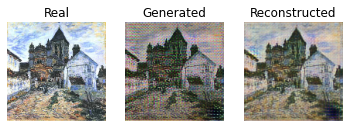

[INFO] Domain B to Domain A


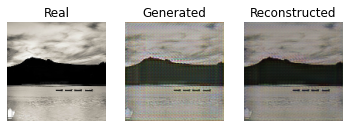

epoch: 43 step: 1 dA_loss: 0.043 dB_loss: 0.089 gAB_loss :4.312 gBA_loss: 4.702
epoch: 43 step: 2 dA_loss: 0.049 dB_loss: 0.067 gAB_loss :4.357 gBA_loss: 4.630
epoch: 43 step: 3 dA_loss: 0.019 dB_loss: 0.043 gAB_loss :4.255 gBA_loss: 4.477
epoch: 43 step: 4 dA_loss: 0.073 dB_loss: 0.004 gAB_loss :4.304 gBA_loss: 4.374
epoch: 43 step: 5 dA_loss: 0.030 dB_loss: 0.078 gAB_loss :4.591 gBA_loss: 4.533
epoch: 43 step: 6 dA_loss: 0.066 dB_loss: 0.030 gAB_loss :4.065 gBA_loss: 4.168
epoch: 43 step: 7 dA_loss: 0.071 dB_loss: 0.067 gAB_loss :3.598 gBA_loss: 3.655
epoch: 43 step: 8 dA_loss: 0.127 dB_loss: 0.050 gAB_loss :3.949 gBA_loss: 4.738
epoch: 43 step: 9 dA_loss: 0.046 dB_loss: 0.146 gAB_loss :4.423 gBA_loss: 4.446
epoch: 43 step: 10 dA_loss: 0.070 dB_loss: 0.070 gAB_loss :5.378 gBA_loss: 5.711
epoch: 43 step: 11 dA_loss: 0.007 dB_loss: 0.104 gAB_loss :4.729 gBA_loss: 4.874
epoch: 43 step: 12 dA_loss: 0.083 dB_loss: 0.051 gAB_loss :4.430 gBA_loss: 4.580
epoch: 43 step: 13 dA_loss: 0.051 dB_

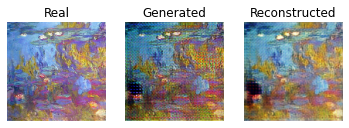

[INFO] Domain B to Domain A


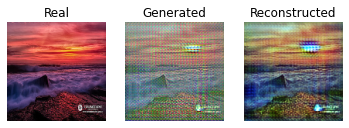

epoch: 43 step: 51 dA_loss: 0.082 dB_loss: 0.078 gAB_loss :4.940 gBA_loss: 5.151
epoch: 43 step: 52 dA_loss: 0.033 dB_loss: 0.023 gAB_loss :4.685 gBA_loss: 5.123
epoch: 43 step: 53 dA_loss: 0.024 dB_loss: 0.042 gAB_loss :4.395 gBA_loss: 4.728
epoch: 43 step: 54 dA_loss: 0.107 dB_loss: 0.064 gAB_loss :4.234 gBA_loss: 4.516
epoch: 43 step: 55 dA_loss: 0.011 dB_loss: 0.097 gAB_loss :4.689 gBA_loss: 4.976
epoch: 43 step: 56 dA_loss: 0.062 dB_loss: 0.061 gAB_loss :4.405 gBA_loss: 4.614
epoch: 43 step: 57 dA_loss: 0.063 dB_loss: 0.106 gAB_loss :4.139 gBA_loss: 4.482
epoch: 43 step: 58 dA_loss: 0.023 dB_loss: 0.053 gAB_loss :4.376 gBA_loss: 4.638
epoch: 43 step: 59 dA_loss: 0.073 dB_loss: 0.012 gAB_loss :4.155 gBA_loss: 4.394
epoch: 43 step: 60 dA_loss: 0.092 dB_loss: 0.053 gAB_loss :4.378 gBA_loss: 4.339
epoch: 43 step: 61 dA_loss: 0.040 dB_loss: 0.047 gAB_loss :4.239 gBA_loss: 4.448
epoch: 43 step: 62 dA_loss: 0.126 dB_loss: 0.010 gAB_loss :4.074 gBA_loss: 4.440
epoch: 43 step: 63 dA_loss: 

 44%|████▍     | 44/100 [1:12:42<1:31:46, 98.33s/it]

epoch: 43 step: 73 dA_loss: 0.085 dB_loss: 0.036 gAB_loss :4.693 gBA_loss: 5.021
epoch: 44 step: 0 dA_loss: 0.009 dB_loss: 0.190 gAB_loss :4.377 gBA_loss: 4.690
[INFO] Domain A to Domain B


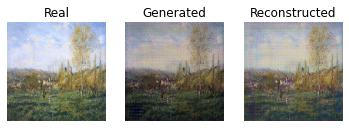

[INFO] Domain B to Domain A


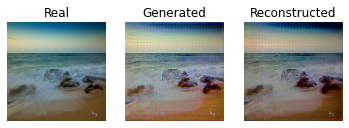

epoch: 44 step: 1 dA_loss: 0.036 dB_loss: 0.190 gAB_loss :4.326 gBA_loss: 4.577
epoch: 44 step: 2 dA_loss: 0.028 dB_loss: 0.087 gAB_loss :4.091 gBA_loss: 4.553
epoch: 44 step: 3 dA_loss: 0.026 dB_loss: 0.062 gAB_loss :4.059 gBA_loss: 4.480
epoch: 44 step: 4 dA_loss: 0.085 dB_loss: 0.014 gAB_loss :4.254 gBA_loss: 4.328
epoch: 44 step: 5 dA_loss: 0.039 dB_loss: 0.044 gAB_loss :4.583 gBA_loss: 4.620
epoch: 44 step: 6 dA_loss: 0.033 dB_loss: 0.026 gAB_loss :4.061 gBA_loss: 4.159
epoch: 44 step: 7 dA_loss: 0.026 dB_loss: 0.059 gAB_loss :3.600 gBA_loss: 3.725
epoch: 44 step: 8 dA_loss: 0.085 dB_loss: 0.042 gAB_loss :3.907 gBA_loss: 4.439
epoch: 44 step: 9 dA_loss: 0.045 dB_loss: 0.053 gAB_loss :4.095 gBA_loss: 4.342
epoch: 44 step: 10 dA_loss: 0.012 dB_loss: 0.043 gAB_loss :5.112 gBA_loss: 5.379
epoch: 44 step: 11 dA_loss: 0.004 dB_loss: 0.045 gAB_loss :4.644 gBA_loss: 4.774
epoch: 44 step: 12 dA_loss: 0.060 dB_loss: 0.014 gAB_loss :4.395 gBA_loss: 4.553
epoch: 44 step: 13 dA_loss: 0.061 dB_

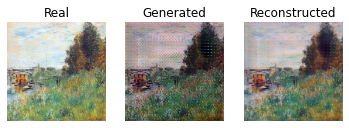

[INFO] Domain B to Domain A


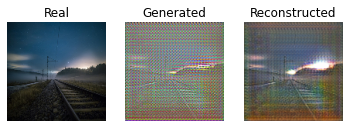

epoch: 44 step: 51 dA_loss: 0.088 dB_loss: 0.070 gAB_loss :4.823 gBA_loss: 5.023
epoch: 44 step: 52 dA_loss: 0.112 dB_loss: 0.010 gAB_loss :4.628 gBA_loss: 4.990
epoch: 44 step: 53 dA_loss: 0.033 dB_loss: 0.032 gAB_loss :4.382 gBA_loss: 4.563
epoch: 44 step: 54 dA_loss: 0.045 dB_loss: 0.057 gAB_loss :4.138 gBA_loss: 4.150
epoch: 44 step: 55 dA_loss: 0.037 dB_loss: 0.062 gAB_loss :4.481 gBA_loss: 4.732
epoch: 44 step: 56 dA_loss: 0.052 dB_loss: 0.043 gAB_loss :4.308 gBA_loss: 4.516
epoch: 44 step: 57 dA_loss: 0.053 dB_loss: 0.103 gAB_loss :4.093 gBA_loss: 4.497
epoch: 44 step: 58 dA_loss: 0.034 dB_loss: 0.043 gAB_loss :4.427 gBA_loss: 4.620
epoch: 44 step: 59 dA_loss: 0.072 dB_loss: 0.003 gAB_loss :4.271 gBA_loss: 4.285
epoch: 44 step: 60 dA_loss: 0.072 dB_loss: 0.061 gAB_loss :4.444 gBA_loss: 4.277
epoch: 44 step: 61 dA_loss: 0.076 dB_loss: 0.041 gAB_loss :4.298 gBA_loss: 4.521
epoch: 44 step: 62 dA_loss: 0.014 dB_loss: 0.011 gAB_loss :4.049 gBA_loss: 4.030
epoch: 44 step: 63 dA_loss: 

 45%|████▌     | 45/100 [1:14:21<1:30:07, 98.33s/it]

epoch: 44 step: 73 dA_loss: 0.100 dB_loss: 0.007 gAB_loss :4.653 gBA_loss: 4.993
epoch: 45 step: 0 dA_loss: 0.014 dB_loss: 0.058 gAB_loss :4.409 gBA_loss: 4.714
[INFO] Domain A to Domain B


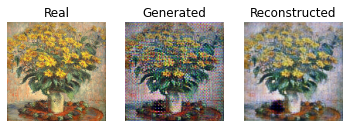

[INFO] Domain B to Domain A


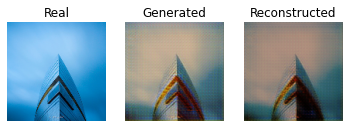

epoch: 45 step: 1 dA_loss: 0.034 dB_loss: 0.044 gAB_loss :4.347 gBA_loss: 4.584
epoch: 45 step: 2 dA_loss: 0.038 dB_loss: 0.091 gAB_loss :4.338 gBA_loss: 4.549
epoch: 45 step: 3 dA_loss: 0.011 dB_loss: 0.032 gAB_loss :4.172 gBA_loss: 4.309
epoch: 45 step: 4 dA_loss: 0.080 dB_loss: 0.004 gAB_loss :4.239 gBA_loss: 4.292
epoch: 45 step: 5 dA_loss: 0.028 dB_loss: 0.039 gAB_loss :4.548 gBA_loss: 4.552
epoch: 45 step: 6 dA_loss: 0.055 dB_loss: 0.012 gAB_loss :4.002 gBA_loss: 4.207
epoch: 45 step: 7 dA_loss: 0.067 dB_loss: 0.060 gAB_loss :3.589 gBA_loss: 3.554
epoch: 45 step: 8 dA_loss: 0.158 dB_loss: 0.035 gAB_loss :3.952 gBA_loss: 4.765
epoch: 45 step: 9 dA_loss: 0.021 dB_loss: 0.019 gAB_loss :4.042 gBA_loss: 4.373
epoch: 45 step: 10 dA_loss: 0.058 dB_loss: 0.041 gAB_loss :5.063 gBA_loss: 5.338
epoch: 45 step: 11 dA_loss: 0.048 dB_loss: 0.052 gAB_loss :4.696 gBA_loss: 4.896
epoch: 45 step: 12 dA_loss: 0.145 dB_loss: 0.012 gAB_loss :4.495 gBA_loss: 4.666
epoch: 45 step: 13 dA_loss: 0.131 dB_

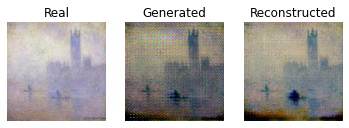

[INFO] Domain B to Domain A


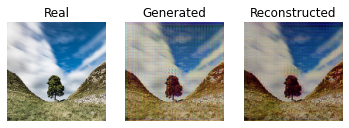

epoch: 45 step: 51 dA_loss: 0.096 dB_loss: 0.058 gAB_loss :4.747 gBA_loss: 5.001
epoch: 45 step: 52 dA_loss: 0.122 dB_loss: 0.022 gAB_loss :4.624 gBA_loss: 4.910
epoch: 45 step: 53 dA_loss: 0.044 dB_loss: 0.019 gAB_loss :4.408 gBA_loss: 4.561
epoch: 45 step: 54 dA_loss: 0.077 dB_loss: 0.059 gAB_loss :4.170 gBA_loss: 4.241
epoch: 45 step: 55 dA_loss: 0.062 dB_loss: 0.069 gAB_loss :4.493 gBA_loss: 4.719
epoch: 45 step: 56 dA_loss: 0.094 dB_loss: 0.043 gAB_loss :4.278 gBA_loss: 4.715
epoch: 45 step: 57 dA_loss: 0.058 dB_loss: 0.154 gAB_loss :4.226 gBA_loss: 4.536
epoch: 45 step: 58 dA_loss: 0.140 dB_loss: 0.054 gAB_loss :4.418 gBA_loss: 4.484
epoch: 45 step: 59 dA_loss: 0.054 dB_loss: 0.053 gAB_loss :4.160 gBA_loss: 3.963
epoch: 45 step: 60 dA_loss: 0.103 dB_loss: 0.054 gAB_loss :4.370 gBA_loss: 4.200
epoch: 45 step: 61 dA_loss: 0.067 dB_loss: 0.009 gAB_loss :4.271 gBA_loss: 4.554
epoch: 45 step: 62 dA_loss: 0.031 dB_loss: 0.006 gAB_loss :4.018 gBA_loss: 4.052
epoch: 45 step: 63 dA_loss: 

 46%|████▌     | 46/100 [1:15:59<1:28:27, 98.28s/it]

epoch: 45 step: 73 dA_loss: 0.056 dB_loss: 0.009 gAB_loss :4.650 gBA_loss: 5.033
epoch: 46 step: 0 dA_loss: 0.011 dB_loss: 0.003 gAB_loss :4.433 gBA_loss: 4.697
[INFO] Domain A to Domain B


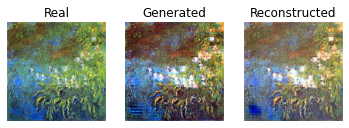

[INFO] Domain B to Domain A


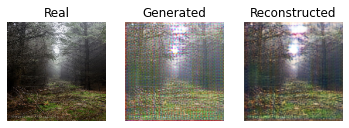

epoch: 46 step: 1 dA_loss: 0.047 dB_loss: 0.073 gAB_loss :4.473 gBA_loss: 4.581
epoch: 46 step: 2 dA_loss: 0.039 dB_loss: 0.033 gAB_loss :4.263 gBA_loss: 4.548
epoch: 46 step: 3 dA_loss: 0.009 dB_loss: 0.013 gAB_loss :4.193 gBA_loss: 4.306
epoch: 46 step: 4 dA_loss: 0.074 dB_loss: 0.009 gAB_loss :4.261 gBA_loss: 4.253
epoch: 46 step: 5 dA_loss: 0.064 dB_loss: 0.036 gAB_loss :4.546 gBA_loss: 4.571
epoch: 46 step: 6 dA_loss: 0.046 dB_loss: 0.012 gAB_loss :3.979 gBA_loss: 4.120
epoch: 46 step: 7 dA_loss: 0.112 dB_loss: 0.059 gAB_loss :3.575 gBA_loss: 3.659
epoch: 46 step: 8 dA_loss: 0.086 dB_loss: 0.060 gAB_loss :3.968 gBA_loss: 4.371
epoch: 46 step: 9 dA_loss: 0.122 dB_loss: 0.017 gAB_loss :4.045 gBA_loss: 4.434
epoch: 46 step: 10 dA_loss: 0.067 dB_loss: 0.024 gAB_loss :4.915 gBA_loss: 5.335
epoch: 46 step: 11 dA_loss: 0.007 dB_loss: 0.068 gAB_loss :4.610 gBA_loss: 4.682
epoch: 46 step: 12 dA_loss: 0.166 dB_loss: 0.024 gAB_loss :4.451 gBA_loss: 4.439
epoch: 46 step: 13 dA_loss: 0.083 dB_

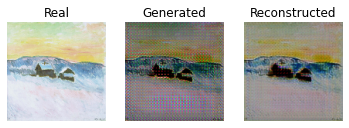

[INFO] Domain B to Domain A


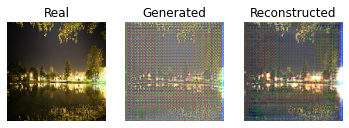

epoch: 46 step: 51 dA_loss: 0.074 dB_loss: 0.065 gAB_loss :4.755 gBA_loss: 4.870
epoch: 46 step: 52 dA_loss: 0.055 dB_loss: 0.030 gAB_loss :4.553 gBA_loss: 4.868
epoch: 46 step: 53 dA_loss: 0.081 dB_loss: 0.042 gAB_loss :4.285 gBA_loss: 4.791
epoch: 46 step: 54 dA_loss: 0.075 dB_loss: 0.129 gAB_loss :4.223 gBA_loss: 4.333
epoch: 46 step: 55 dA_loss: 0.087 dB_loss: 0.096 gAB_loss :4.549 gBA_loss: 4.690
epoch: 46 step: 56 dA_loss: 0.090 dB_loss: 0.083 gAB_loss :4.235 gBA_loss: 4.362
epoch: 46 step: 57 dA_loss: 0.061 dB_loss: 0.107 gAB_loss :3.998 gBA_loss: 4.355
epoch: 46 step: 58 dA_loss: 0.081 dB_loss: 0.058 gAB_loss :4.297 gBA_loss: 4.526
epoch: 46 step: 59 dA_loss: 0.049 dB_loss: 0.034 gAB_loss :4.241 gBA_loss: 4.044
epoch: 46 step: 60 dA_loss: 0.045 dB_loss: 0.057 gAB_loss :4.428 gBA_loss: 4.234
epoch: 46 step: 61 dA_loss: 0.102 dB_loss: 0.055 gAB_loss :4.352 gBA_loss: 4.800
epoch: 46 step: 62 dA_loss: 0.064 dB_loss: 0.006 gAB_loss :4.029 gBA_loss: 4.211
epoch: 46 step: 63 dA_loss: 

 47%|████▋     | 47/100 [1:17:37<1:26:46, 98.24s/it]

epoch: 46 step: 73 dA_loss: 0.057 dB_loss: 0.012 gAB_loss :4.631 gBA_loss: 5.054
epoch: 47 step: 0 dA_loss: 0.011 dB_loss: 0.032 gAB_loss :4.385 gBA_loss: 4.628
[INFO] Domain A to Domain B


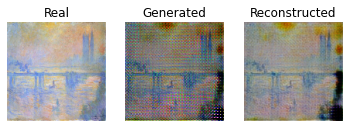

[INFO] Domain B to Domain A


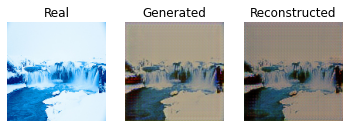

epoch: 47 step: 1 dA_loss: 0.042 dB_loss: 0.065 gAB_loss :4.349 gBA_loss: 4.489
epoch: 47 step: 2 dA_loss: 0.053 dB_loss: 0.060 gAB_loss :4.335 gBA_loss: 4.470
epoch: 47 step: 3 dA_loss: 0.033 dB_loss: 0.008 gAB_loss :4.150 gBA_loss: 4.178
epoch: 47 step: 4 dA_loss: 0.084 dB_loss: 0.010 gAB_loss :4.194 gBA_loss: 4.224
epoch: 47 step: 5 dA_loss: 0.040 dB_loss: 0.041 gAB_loss :4.487 gBA_loss: 4.562
epoch: 47 step: 6 dA_loss: 0.049 dB_loss: 0.017 gAB_loss :3.931 gBA_loss: 4.085
epoch: 47 step: 7 dA_loss: 0.044 dB_loss: 0.084 gAB_loss :3.551 gBA_loss: 3.556
epoch: 47 step: 8 dA_loss: 0.098 dB_loss: 0.036 gAB_loss :3.928 gBA_loss: 4.464
epoch: 47 step: 9 dA_loss: 0.033 dB_loss: 0.024 gAB_loss :3.968 gBA_loss: 4.291
epoch: 47 step: 10 dA_loss: 0.024 dB_loss: 0.057 gAB_loss :4.834 gBA_loss: 5.266
epoch: 47 step: 11 dA_loss: 0.008 dB_loss: 0.097 gAB_loss :4.723 gBA_loss: 4.699
epoch: 47 step: 12 dA_loss: 0.063 dB_loss: 0.029 gAB_loss :4.518 gBA_loss: 4.529
epoch: 47 step: 13 dA_loss: 0.080 dB_

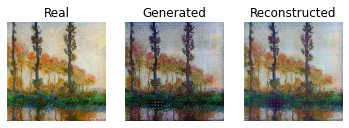

[INFO] Domain B to Domain A


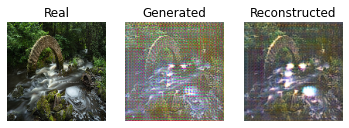

epoch: 47 step: 51 dA_loss: 0.081 dB_loss: 0.054 gAB_loss :4.719 gBA_loss: 4.884
epoch: 47 step: 52 dA_loss: 0.077 dB_loss: 0.013 gAB_loss :4.525 gBA_loss: 4.861
epoch: 47 step: 53 dA_loss: 0.036 dB_loss: 0.018 gAB_loss :4.316 gBA_loss: 4.607
epoch: 47 step: 54 dA_loss: 0.060 dB_loss: 0.082 gAB_loss :4.181 gBA_loss: 4.316
epoch: 47 step: 55 dA_loss: 0.020 dB_loss: 0.069 gAB_loss :4.495 gBA_loss: 4.765
epoch: 47 step: 56 dA_loss: 0.057 dB_loss: 0.050 gAB_loss :4.266 gBA_loss: 4.482
epoch: 47 step: 57 dA_loss: 0.059 dB_loss: 0.099 gAB_loss :4.160 gBA_loss: 4.513
epoch: 47 step: 58 dA_loss: 0.090 dB_loss: 0.031 gAB_loss :4.438 gBA_loss: 4.732
epoch: 47 step: 59 dA_loss: 0.036 dB_loss: 0.002 gAB_loss :4.230 gBA_loss: 4.199
epoch: 47 step: 60 dA_loss: 0.072 dB_loss: 0.056 gAB_loss :4.424 gBA_loss: 4.159
epoch: 47 step: 61 dA_loss: 0.075 dB_loss: 0.052 gAB_loss :4.293 gBA_loss: 4.438
epoch: 47 step: 62 dA_loss: 0.109 dB_loss: 0.004 gAB_loss :4.043 gBA_loss: 4.361
epoch: 47 step: 63 dA_loss: 

 48%|████▊     | 48/100 [1:19:16<1:25:13, 98.34s/it]

epoch: 47 step: 73 dA_loss: 0.054 dB_loss: 0.005 gAB_loss :4.656 gBA_loss: 5.005
epoch: 48 step: 0 dA_loss: 0.006 dB_loss: 0.142 gAB_loss :4.302 gBA_loss: 4.622
[INFO] Domain A to Domain B


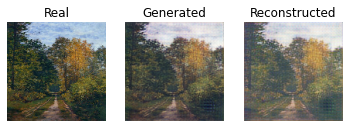

[INFO] Domain B to Domain A


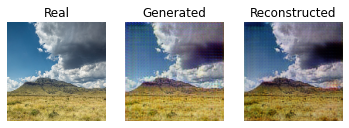

epoch: 48 step: 1 dA_loss: 0.038 dB_loss: 0.047 gAB_loss :4.226 gBA_loss: 4.532
epoch: 48 step: 2 dA_loss: 0.019 dB_loss: 0.164 gAB_loss :4.342 gBA_loss: 4.518
epoch: 48 step: 3 dA_loss: 0.016 dB_loss: 0.076 gAB_loss :4.117 gBA_loss: 4.318
epoch: 48 step: 4 dA_loss: 0.076 dB_loss: 0.042 gAB_loss :4.130 gBA_loss: 4.240
epoch: 48 step: 5 dA_loss: 0.036 dB_loss: 0.136 gAB_loss :4.337 gBA_loss: 4.555
epoch: 48 step: 6 dA_loss: 0.026 dB_loss: 0.056 gAB_loss :3.865 gBA_loss: 4.158
epoch: 48 step: 7 dA_loss: 0.038 dB_loss: 0.167 gAB_loss :3.688 gBA_loss: 3.648
epoch: 48 step: 8 dA_loss: 0.055 dB_loss: 0.054 gAB_loss :4.011 gBA_loss: 4.334
epoch: 48 step: 9 dA_loss: 0.111 dB_loss: 0.073 gAB_loss :3.950 gBA_loss: 4.392
epoch: 48 step: 10 dA_loss: 0.063 dB_loss: 0.094 gAB_loss :4.743 gBA_loss: 5.273
epoch: 48 step: 11 dA_loss: 0.006 dB_loss: 0.075 gAB_loss :4.519 gBA_loss: 4.657
epoch: 48 step: 12 dA_loss: 0.137 dB_loss: 0.115 gAB_loss :4.362 gBA_loss: 4.408
epoch: 48 step: 13 dA_loss: 0.078 dB_

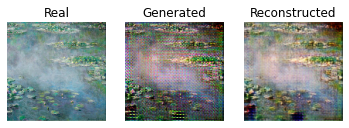

[INFO] Domain B to Domain A


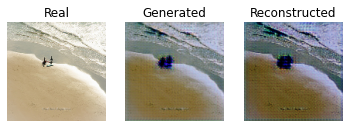

epoch: 48 step: 51 dA_loss: 0.047 dB_loss: 0.067 gAB_loss :4.740 gBA_loss: 4.826
epoch: 48 step: 52 dA_loss: 0.024 dB_loss: 0.035 gAB_loss :4.547 gBA_loss: 4.932
epoch: 48 step: 53 dA_loss: 0.015 dB_loss: 0.052 gAB_loss :4.256 gBA_loss: 4.635
epoch: 48 step: 54 dA_loss: 0.057 dB_loss: 0.102 gAB_loss :4.124 gBA_loss: 4.211
epoch: 48 step: 55 dA_loss: 0.067 dB_loss: 0.087 gAB_loss :4.568 gBA_loss: 4.829
epoch: 48 step: 56 dA_loss: 0.081 dB_loss: 0.066 gAB_loss :4.258 gBA_loss: 4.710
epoch: 48 step: 57 dA_loss: 0.108 dB_loss: 0.073 gAB_loss :4.066 gBA_loss: 4.475
epoch: 48 step: 58 dA_loss: 0.113 dB_loss: 0.045 gAB_loss :4.474 gBA_loss: 4.428
epoch: 48 step: 59 dA_loss: 0.053 dB_loss: 0.003 gAB_loss :4.245 gBA_loss: 3.913
epoch: 48 step: 60 dA_loss: 0.091 dB_loss: 0.063 gAB_loss :4.385 gBA_loss: 4.228
epoch: 48 step: 61 dA_loss: 0.075 dB_loss: 0.036 gAB_loss :4.252 gBA_loss: 4.543
epoch: 48 step: 62 dA_loss: 0.030 dB_loss: 0.005 gAB_loss :3.947 gBA_loss: 4.007
epoch: 48 step: 63 dA_loss: 

 49%|████▉     | 49/100 [1:20:54<1:23:32, 98.29s/it]

epoch: 48 step: 73 dA_loss: 0.065 dB_loss: 0.004 gAB_loss :4.646 gBA_loss: 4.997
epoch: 49 step: 0 dA_loss: 0.057 dB_loss: 0.052 gAB_loss :4.354 gBA_loss: 4.523
[INFO] Domain A to Domain B


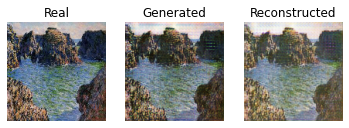

[INFO] Domain B to Domain A


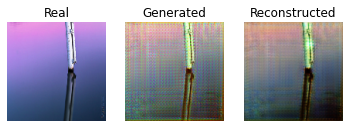

epoch: 49 step: 1 dA_loss: 0.042 dB_loss: 0.049 gAB_loss :4.319 gBA_loss: 4.436
epoch: 49 step: 2 dA_loss: 0.045 dB_loss: 0.026 gAB_loss :4.190 gBA_loss: 4.400
epoch: 49 step: 3 dA_loss: 0.073 dB_loss: 0.032 gAB_loss :4.187 gBA_loss: 4.065
epoch: 49 step: 4 dA_loss: 0.304 dB_loss: 0.005 gAB_loss :4.269 gBA_loss: 4.614
epoch: 49 step: 5 dA_loss: 0.281 dB_loss: 0.049 gAB_loss :4.474 gBA_loss: 4.421
epoch: 49 step: 6 dA_loss: 0.119 dB_loss: 0.019 gAB_loss :3.897 gBA_loss: 3.868
epoch: 49 step: 7 dA_loss: 0.125 dB_loss: 0.055 gAB_loss :3.472 gBA_loss: 3.400
epoch: 49 step: 8 dA_loss: 0.128 dB_loss: 0.052 gAB_loss :3.855 gBA_loss: 4.271
epoch: 49 step: 9 dA_loss: 0.087 dB_loss: 0.110 gAB_loss :4.032 gBA_loss: 4.203
epoch: 49 step: 10 dA_loss: 0.022 dB_loss: 0.107 gAB_loss :4.893 gBA_loss: 5.200
epoch: 49 step: 11 dA_loss: 0.011 dB_loss: 0.075 gAB_loss :4.493 gBA_loss: 4.618
epoch: 49 step: 12 dA_loss: 0.061 dB_loss: 0.037 gAB_loss :4.232 gBA_loss: 4.419
epoch: 49 step: 13 dA_loss: 0.108 dB_

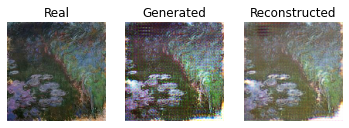

[INFO] Domain B to Domain A


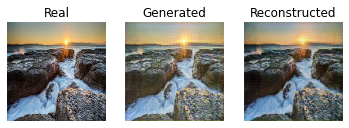

epoch: 49 step: 51 dA_loss: 0.043 dB_loss: 0.057 gAB_loss :4.606 gBA_loss: 4.775
epoch: 49 step: 52 dA_loss: 0.045 dB_loss: 0.028 gAB_loss :4.519 gBA_loss: 4.784
epoch: 49 step: 53 dA_loss: 0.026 dB_loss: 0.029 gAB_loss :4.332 gBA_loss: 4.553
epoch: 49 step: 54 dA_loss: 0.053 dB_loss: 0.059 gAB_loss :4.091 gBA_loss: 4.231
epoch: 49 step: 55 dA_loss: 0.042 dB_loss: 0.076 gAB_loss :4.491 gBA_loss: 4.780
epoch: 49 step: 56 dA_loss: 0.047 dB_loss: 0.047 gAB_loss :4.241 gBA_loss: 4.466
epoch: 49 step: 57 dA_loss: 0.077 dB_loss: 0.068 gAB_loss :4.004 gBA_loss: 4.316
epoch: 49 step: 58 dA_loss: 0.042 dB_loss: 0.006 gAB_loss :4.289 gBA_loss: 4.554
epoch: 49 step: 59 dA_loss: 0.036 dB_loss: 0.009 gAB_loss :4.132 gBA_loss: 4.183
epoch: 49 step: 60 dA_loss: 0.058 dB_loss: 0.048 gAB_loss :4.300 gBA_loss: 4.176
epoch: 49 step: 61 dA_loss: 0.045 dB_loss: 0.050 gAB_loss :4.235 gBA_loss: 4.416
epoch: 49 step: 62 dA_loss: 0.031 dB_loss: 0.007 gAB_loss :4.051 gBA_loss: 4.178
epoch: 49 step: 63 dA_loss: 

 50%|█████     | 50/100 [1:22:32<1:21:52, 98.24s/it]

epoch: 49 step: 73 dA_loss: 0.044 dB_loss: 0.014 gAB_loss :4.624 gBA_loss: 4.984
epoch: 50 step: 0 dA_loss: 0.014 dB_loss: 0.034 gAB_loss :4.380 gBA_loss: 4.673
[INFO] Domain A to Domain B


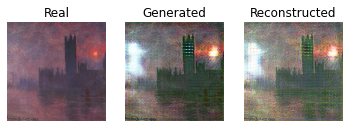

[INFO] Domain B to Domain A


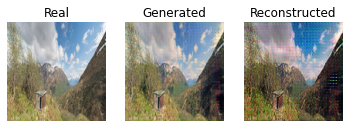

epoch: 50 step: 1 dA_loss: 0.032 dB_loss: 0.051 gAB_loss :4.317 gBA_loss: 4.570
epoch: 50 step: 2 dA_loss: 0.032 dB_loss: 0.029 gAB_loss :4.220 gBA_loss: 4.510
epoch: 50 step: 3 dA_loss: 0.015 dB_loss: 0.022 gAB_loss :4.146 gBA_loss: 4.195
epoch: 50 step: 4 dA_loss: 0.111 dB_loss: 0.012 gAB_loss :4.302 gBA_loss: 4.330
epoch: 50 step: 5 dA_loss: 0.063 dB_loss: 0.018 gAB_loss :4.520 gBA_loss: 4.759
epoch: 50 step: 6 dA_loss: 0.030 dB_loss: 0.008 gAB_loss :3.938 gBA_loss: 4.176
epoch: 50 step: 7 dA_loss: 0.057 dB_loss: 0.057 gAB_loss :3.523 gBA_loss: 3.671
epoch: 50 step: 8 dA_loss: 0.064 dB_loss: 0.037 gAB_loss :3.866 gBA_loss: 4.319
epoch: 50 step: 9 dA_loss: 0.035 dB_loss: 0.061 gAB_loss :3.899 gBA_loss: 4.135
epoch: 50 step: 10 dA_loss: 0.017 dB_loss: 0.094 gAB_loss :4.757 gBA_loss: 5.137
epoch: 50 step: 11 dA_loss: 0.014 dB_loss: 0.019 gAB_loss :4.498 gBA_loss: 4.629
epoch: 50 step: 12 dA_loss: 0.037 dB_loss: 0.039 gAB_loss :4.346 gBA_loss: 4.476
epoch: 50 step: 13 dA_loss: 0.058 dB_

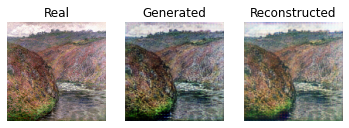

[INFO] Domain B to Domain A


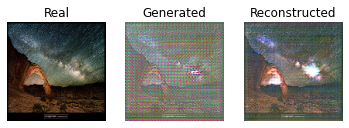

epoch: 50 step: 51 dA_loss: 0.056 dB_loss: 0.057 gAB_loss :4.662 gBA_loss: 4.752
epoch: 50 step: 52 dA_loss: 0.013 dB_loss: 0.018 gAB_loss :4.476 gBA_loss: 4.845
epoch: 50 step: 53 dA_loss: 0.025 dB_loss: 0.026 gAB_loss :4.221 gBA_loss: 4.566
epoch: 50 step: 54 dA_loss: 0.042 dB_loss: 0.069 gAB_loss :4.109 gBA_loss: 4.276
epoch: 50 step: 55 dA_loss: 0.017 dB_loss: 0.068 gAB_loss :4.490 gBA_loss: 4.746
epoch: 50 step: 56 dA_loss: 0.039 dB_loss: 0.054 gAB_loss :4.204 gBA_loss: 4.439
epoch: 50 step: 57 dA_loss: 0.061 dB_loss: 0.099 gAB_loss :4.138 gBA_loss: 4.371
epoch: 50 step: 58 dA_loss: 0.019 dB_loss: 0.067 gAB_loss :4.335 gBA_loss: 4.461
epoch: 50 step: 59 dA_loss: 0.030 dB_loss: 0.038 gAB_loss :4.089 gBA_loss: 4.094
epoch: 50 step: 60 dA_loss: 0.037 dB_loss: 0.062 gAB_loss :4.255 gBA_loss: 4.200
epoch: 50 step: 61 dA_loss: 0.054 dB_loss: 0.009 gAB_loss :4.203 gBA_loss: 4.524
epoch: 50 step: 62 dA_loss: 0.013 dB_loss: 0.008 gAB_loss :3.968 gBA_loss: 4.082
epoch: 50 step: 63 dA_loss: 

 51%|█████     | 51/100 [1:24:10<1:20:12, 98.22s/it]

epoch: 50 step: 73 dA_loss: 0.049 dB_loss: 0.007 gAB_loss :4.621 gBA_loss: 4.994
epoch: 51 step: 0 dA_loss: 0.066 dB_loss: 0.042 gAB_loss :4.299 gBA_loss: 4.502
[INFO] Domain A to Domain B


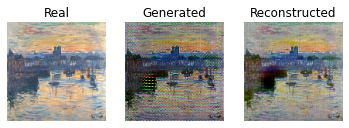

[INFO] Domain B to Domain A


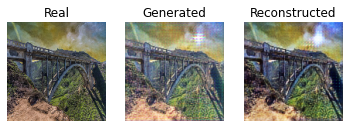

epoch: 51 step: 1 dA_loss: 0.027 dB_loss: 0.035 gAB_loss :4.398 gBA_loss: 4.438
epoch: 51 step: 2 dA_loss: 0.059 dB_loss: 0.029 gAB_loss :4.222 gBA_loss: 4.430
epoch: 51 step: 3 dA_loss: 0.069 dB_loss: 0.012 gAB_loss :4.075 gBA_loss: 4.007
epoch: 51 step: 4 dA_loss: 0.178 dB_loss: 0.004 gAB_loss :4.215 gBA_loss: 4.562
epoch: 51 step: 5 dA_loss: 0.087 dB_loss: 0.013 gAB_loss :4.455 gBA_loss: 4.460
epoch: 51 step: 6 dA_loss: 0.027 dB_loss: 0.011 gAB_loss :3.948 gBA_loss: 3.965
epoch: 51 step: 7 dA_loss: 0.011 dB_loss: 0.058 gAB_loss :3.563 gBA_loss: 3.743
epoch: 51 step: 8 dA_loss: 0.071 dB_loss: 0.033 gAB_loss :3.896 gBA_loss: 4.446
epoch: 51 step: 9 dA_loss: 0.020 dB_loss: 0.054 gAB_loss :3.977 gBA_loss: 4.145
epoch: 51 step: 10 dA_loss: 0.021 dB_loss: 0.083 gAB_loss :4.748 gBA_loss: 5.080
epoch: 51 step: 11 dA_loss: 0.016 dB_loss: 0.021 gAB_loss :4.470 gBA_loss: 4.666
epoch: 51 step: 12 dA_loss: 0.038 dB_loss: 0.058 gAB_loss :4.375 gBA_loss: 4.527
epoch: 51 step: 13 dA_loss: 0.065 dB_

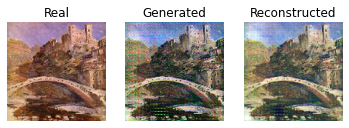

[INFO] Domain B to Domain A


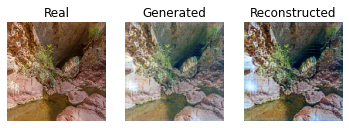

epoch: 51 step: 51 dA_loss: 0.043 dB_loss: 0.061 gAB_loss :4.632 gBA_loss: 4.822
epoch: 51 step: 52 dA_loss: 0.016 dB_loss: 0.019 gAB_loss :4.507 gBA_loss: 4.861
epoch: 51 step: 53 dA_loss: 0.014 dB_loss: 0.023 gAB_loss :4.268 gBA_loss: 4.515
epoch: 51 step: 54 dA_loss: 0.043 dB_loss: 0.072 gAB_loss :4.008 gBA_loss: 4.162
epoch: 51 step: 55 dA_loss: 0.018 dB_loss: 0.086 gAB_loss :4.488 gBA_loss: 4.680
epoch: 51 step: 56 dA_loss: 0.040 dB_loss: 0.068 gAB_loss :4.151 gBA_loss: 4.441
epoch: 51 step: 57 dA_loss: 0.048 dB_loss: 0.108 gAB_loss :4.175 gBA_loss: 4.356
epoch: 51 step: 58 dA_loss: 0.017 dB_loss: 0.064 gAB_loss :4.365 gBA_loss: 4.489
epoch: 51 step: 59 dA_loss: 0.059 dB_loss: 0.034 gAB_loss :4.122 gBA_loss: 4.343
epoch: 51 step: 60 dA_loss: 0.063 dB_loss: 0.069 gAB_loss :4.171 gBA_loss: 4.226
epoch: 51 step: 61 dA_loss: 0.048 dB_loss: 0.023 gAB_loss :4.079 gBA_loss: 4.451
epoch: 51 step: 62 dA_loss: 0.042 dB_loss: 0.033 gAB_loss :4.217 gBA_loss: 3.912
epoch: 51 step: 63 dA_loss: 

 52%|█████▏    | 52/100 [1:25:48<1:18:33, 98.20s/it]

epoch: 51 step: 73 dA_loss: 0.045 dB_loss: 0.008 gAB_loss :4.674 gBA_loss: 5.116
epoch: 52 step: 0 dA_loss: 0.008 dB_loss: 0.091 gAB_loss :4.469 gBA_loss: 4.681
[INFO] Domain A to Domain B


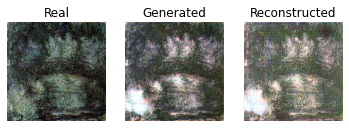

[INFO] Domain B to Domain A


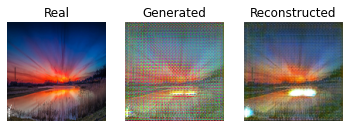

epoch: 52 step: 1 dA_loss: 0.017 dB_loss: 0.072 gAB_loss :4.293 gBA_loss: 4.558
epoch: 52 step: 2 dA_loss: 0.014 dB_loss: 0.055 gAB_loss :4.204 gBA_loss: 4.508
epoch: 52 step: 3 dA_loss: 0.014 dB_loss: 0.049 gAB_loss :4.175 gBA_loss: 4.251
epoch: 52 step: 4 dA_loss: 0.067 dB_loss: 0.010 gAB_loss :4.230 gBA_loss: 4.074
epoch: 52 step: 5 dA_loss: 0.145 dB_loss: 0.038 gAB_loss :4.450 gBA_loss: 4.622
epoch: 52 step: 6 dA_loss: 0.047 dB_loss: 0.006 gAB_loss :3.889 gBA_loss: 4.179
epoch: 52 step: 7 dA_loss: 0.270 dB_loss: 0.101 gAB_loss :3.527 gBA_loss: 3.535
epoch: 52 step: 8 dA_loss: 0.089 dB_loss: 0.059 gAB_loss :3.892 gBA_loss: 4.116
epoch: 52 step: 9 dA_loss: 0.106 dB_loss: 0.061 gAB_loss :3.932 gBA_loss: 3.950
epoch: 52 step: 10 dA_loss: 0.081 dB_loss: 0.098 gAB_loss :4.780 gBA_loss: 4.966
epoch: 52 step: 11 dA_loss: 0.056 dB_loss: 0.048 gAB_loss :4.427 gBA_loss: 4.576
epoch: 52 step: 12 dA_loss: 0.090 dB_loss: 0.032 gAB_loss :4.217 gBA_loss: 4.437
epoch: 52 step: 13 dA_loss: 0.078 dB_

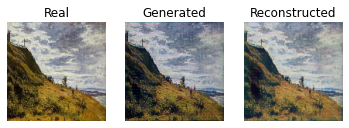

[INFO] Domain B to Domain A


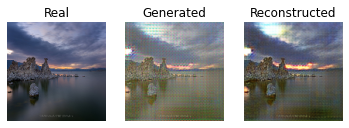

epoch: 52 step: 51 dA_loss: 0.055 dB_loss: 0.048 gAB_loss :4.602 gBA_loss: 4.715
epoch: 52 step: 52 dA_loss: 0.023 dB_loss: 0.009 gAB_loss :4.493 gBA_loss: 4.846
epoch: 52 step: 53 dA_loss: 0.023 dB_loss: 0.009 gAB_loss :4.260 gBA_loss: 4.606
epoch: 52 step: 54 dA_loss: 0.041 dB_loss: 0.063 gAB_loss :4.116 gBA_loss: 4.225
epoch: 52 step: 55 dA_loss: 0.038 dB_loss: 0.067 gAB_loss :4.385 gBA_loss: 4.653
epoch: 52 step: 56 dA_loss: 0.041 dB_loss: 0.075 gAB_loss :4.275 gBA_loss: 4.373
epoch: 52 step: 57 dA_loss: 0.081 dB_loss: 0.051 gAB_loss :4.076 gBA_loss: 4.386
epoch: 52 step: 58 dA_loss: 0.014 dB_loss: 0.023 gAB_loss :4.281 gBA_loss: 4.507
epoch: 52 step: 59 dA_loss: 0.025 dB_loss: 0.005 gAB_loss :4.102 gBA_loss: 4.135
epoch: 52 step: 60 dA_loss: 0.038 dB_loss: 0.033 gAB_loss :4.260 gBA_loss: 4.150
epoch: 52 step: 61 dA_loss: 0.031 dB_loss: 0.022 gAB_loss :4.185 gBA_loss: 4.436
epoch: 52 step: 62 dA_loss: 0.035 dB_loss: 0.010 gAB_loss :3.971 gBA_loss: 4.228
epoch: 52 step: 63 dA_loss: 

 53%|█████▎    | 53/100 [1:27:26<1:16:54, 98.19s/it]

epoch: 52 step: 73 dA_loss: 0.044 dB_loss: 0.012 gAB_loss :4.589 gBA_loss: 4.984
epoch: 53 step: 0 dA_loss: 0.023 dB_loss: 0.125 gAB_loss :4.244 gBA_loss: 4.599
[INFO] Domain A to Domain B


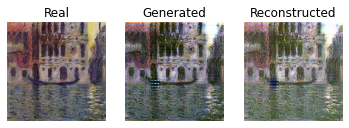

[INFO] Domain B to Domain A


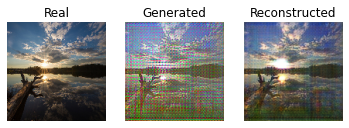

epoch: 53 step: 1 dA_loss: 0.018 dB_loss: 0.107 gAB_loss :4.226 gBA_loss: 4.544
epoch: 53 step: 2 dA_loss: 0.035 dB_loss: 0.098 gAB_loss :4.121 gBA_loss: 4.360
epoch: 53 step: 3 dA_loss: 0.025 dB_loss: 0.031 gAB_loss :4.041 gBA_loss: 4.275
epoch: 53 step: 4 dA_loss: 0.091 dB_loss: 0.010 gAB_loss :4.158 gBA_loss: 4.127
epoch: 53 step: 5 dA_loss: 0.104 dB_loss: 0.028 gAB_loss :4.503 gBA_loss: 4.775
epoch: 53 step: 6 dA_loss: 0.025 dB_loss: 0.028 gAB_loss :3.761 gBA_loss: 4.225
epoch: 53 step: 7 dA_loss: 0.091 dB_loss: 0.161 gAB_loss :3.714 gBA_loss: 3.663
epoch: 53 step: 8 dA_loss: 0.070 dB_loss: 0.064 gAB_loss :3.933 gBA_loss: 4.111
epoch: 53 step: 9 dA_loss: 0.153 dB_loss: 0.129 gAB_loss :3.901 gBA_loss: 4.193
epoch: 53 step: 10 dA_loss: 0.024 dB_loss: 0.093 gAB_loss :4.776 gBA_loss: 5.062
epoch: 53 step: 11 dA_loss: 0.009 dB_loss: 0.034 gAB_loss :4.492 gBA_loss: 4.565
epoch: 53 step: 12 dA_loss: 0.038 dB_loss: 0.010 gAB_loss :4.291 gBA_loss: 4.388
epoch: 53 step: 13 dA_loss: 0.074 dB_

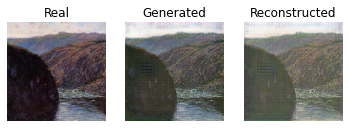

[INFO] Domain B to Domain A


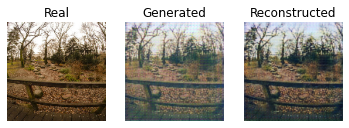

epoch: 53 step: 51 dA_loss: 0.061 dB_loss: 0.043 gAB_loss :4.608 gBA_loss: 4.800
epoch: 53 step: 52 dA_loss: 0.036 dB_loss: 0.024 gAB_loss :4.530 gBA_loss: 4.855
epoch: 53 step: 53 dA_loss: 0.015 dB_loss: 0.012 gAB_loss :4.291 gBA_loss: 4.567
epoch: 53 step: 54 dA_loss: 0.044 dB_loss: 0.101 gAB_loss :4.153 gBA_loss: 4.241
epoch: 53 step: 55 dA_loss: 0.083 dB_loss: 0.075 gAB_loss :4.421 gBA_loss: 4.830
epoch: 53 step: 56 dA_loss: 0.080 dB_loss: 0.066 gAB_loss :3.973 gBA_loss: 4.471
epoch: 53 step: 57 dA_loss: 0.118 dB_loss: 0.141 gAB_loss :4.164 gBA_loss: 4.204
epoch: 53 step: 58 dA_loss: 0.031 dB_loss: 0.083 gAB_loss :4.330 gBA_loss: 4.419
epoch: 53 step: 59 dA_loss: 0.068 dB_loss: 0.100 gAB_loss :4.058 gBA_loss: 4.135
epoch: 53 step: 60 dA_loss: 0.056 dB_loss: 0.132 gAB_loss :4.062 gBA_loss: 4.150
epoch: 53 step: 61 dA_loss: 0.070 dB_loss: 0.065 gAB_loss :4.004 gBA_loss: 4.297
epoch: 53 step: 62 dA_loss: 0.024 dB_loss: 0.025 gAB_loss :3.790 gBA_loss: 3.882
epoch: 53 step: 63 dA_loss: 

 54%|█████▍    | 54/100 [1:29:05<1:15:16, 98.18s/it]

epoch: 53 step: 73 dA_loss: 0.045 dB_loss: 0.014 gAB_loss :4.650 gBA_loss: 4.897
epoch: 54 step: 0 dA_loss: 0.043 dB_loss: 0.091 gAB_loss :4.301 gBA_loss: 4.589
[INFO] Domain A to Domain B


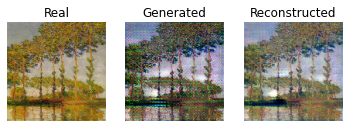

[INFO] Domain B to Domain A


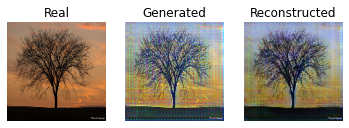

epoch: 54 step: 1 dA_loss: 0.015 dB_loss: 0.027 gAB_loss :4.276 gBA_loss: 4.515
epoch: 54 step: 2 dA_loss: 0.061 dB_loss: 0.035 gAB_loss :4.184 gBA_loss: 4.392
epoch: 54 step: 3 dA_loss: 0.033 dB_loss: 0.014 gAB_loss :4.108 gBA_loss: 4.031
epoch: 54 step: 4 dA_loss: 0.105 dB_loss: 0.008 gAB_loss :4.199 gBA_loss: 4.450
epoch: 54 step: 5 dA_loss: 0.009 dB_loss: 0.049 gAB_loss :4.367 gBA_loss: 4.507
epoch: 54 step: 6 dA_loss: 0.013 dB_loss: 0.019 gAB_loss :3.962 gBA_loss: 3.998
epoch: 54 step: 7 dA_loss: 0.008 dB_loss: 0.066 gAB_loss :3.547 gBA_loss: 3.672
epoch: 54 step: 8 dA_loss: 0.030 dB_loss: 0.043 gAB_loss :3.829 gBA_loss: 4.397
epoch: 54 step: 9 dA_loss: 0.007 dB_loss: 0.065 gAB_loss :3.951 gBA_loss: 4.123
epoch: 54 step: 10 dA_loss: 0.026 dB_loss: 0.101 gAB_loss :4.754 gBA_loss: 5.114
epoch: 54 step: 11 dA_loss: 0.011 dB_loss: 0.036 gAB_loss :4.418 gBA_loss: 4.619
epoch: 54 step: 12 dA_loss: 0.036 dB_loss: 0.016 gAB_loss :4.211 gBA_loss: 4.434
epoch: 54 step: 13 dA_loss: 0.051 dB_

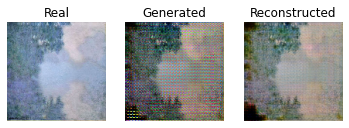

[INFO] Domain B to Domain A


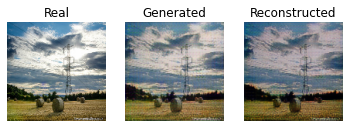

epoch: 54 step: 51 dA_loss: 0.042 dB_loss: 0.045 gAB_loss :4.601 gBA_loss: 4.738
epoch: 54 step: 52 dA_loss: 0.016 dB_loss: 0.012 gAB_loss :4.472 gBA_loss: 4.771
epoch: 54 step: 53 dA_loss: 0.009 dB_loss: 0.012 gAB_loss :4.244 gBA_loss: 4.492
epoch: 54 step: 54 dA_loss: 0.027 dB_loss: 0.074 gAB_loss :4.179 gBA_loss: 4.198
epoch: 54 step: 55 dA_loss: 0.007 dB_loss: 0.065 gAB_loss :4.410 gBA_loss: 4.598
epoch: 54 step: 56 dA_loss: 0.011 dB_loss: 0.078 gAB_loss :3.954 gBA_loss: 4.383
epoch: 54 step: 57 dA_loss: 0.053 dB_loss: 0.081 gAB_loss :4.086 gBA_loss: 4.351
epoch: 54 step: 58 dA_loss: 0.026 dB_loss: 0.009 gAB_loss :4.333 gBA_loss: 4.468
epoch: 54 step: 59 dA_loss: 0.019 dB_loss: 0.005 gAB_loss :4.148 gBA_loss: 4.070
epoch: 54 step: 60 dA_loss: 0.030 dB_loss: 0.088 gAB_loss :4.211 gBA_loss: 4.231
epoch: 54 step: 61 dA_loss: 0.045 dB_loss: 0.055 gAB_loss :4.049 gBA_loss: 4.399
epoch: 54 step: 62 dA_loss: 0.008 dB_loss: 0.014 gAB_loss :3.881 gBA_loss: 3.980
epoch: 54 step: 63 dA_loss: 

 55%|█████▌    | 55/100 [1:30:43<1:13:37, 98.17s/it]

epoch: 54 step: 73 dA_loss: 0.039 dB_loss: 0.014 gAB_loss :4.620 gBA_loss: 5.017
epoch: 55 step: 0 dA_loss: 0.038 dB_loss: 0.033 gAB_loss :4.404 gBA_loss: 4.631
[INFO] Domain A to Domain B


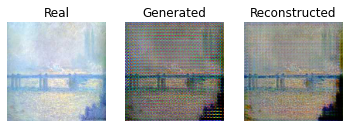

[INFO] Domain B to Domain A


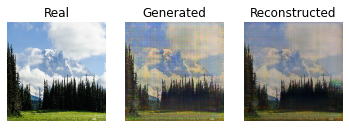

epoch: 55 step: 1 dA_loss: 0.008 dB_loss: 0.021 gAB_loss :4.399 gBA_loss: 4.540
epoch: 55 step: 2 dA_loss: 0.033 dB_loss: 0.016 gAB_loss :4.154 gBA_loss: 4.382
epoch: 55 step: 3 dA_loss: 0.047 dB_loss: 0.010 gAB_loss :4.036 gBA_loss: 3.979
epoch: 55 step: 4 dA_loss: 0.150 dB_loss: 0.007 gAB_loss :4.176 gBA_loss: 4.628
epoch: 55 step: 5 dA_loss: 0.016 dB_loss: 0.010 gAB_loss :4.485 gBA_loss: 4.507
epoch: 55 step: 6 dA_loss: 0.061 dB_loss: 0.009 gAB_loss :3.884 gBA_loss: 3.922
epoch: 55 step: 7 dA_loss: 0.085 dB_loss: 0.058 gAB_loss :3.508 gBA_loss: 3.410
epoch: 55 step: 8 dA_loss: 0.130 dB_loss: 0.044 gAB_loss :3.908 gBA_loss: 4.440
epoch: 55 step: 9 dA_loss: 0.052 dB_loss: 0.049 gAB_loss :3.974 gBA_loss: 4.243
epoch: 55 step: 10 dA_loss: 0.034 dB_loss: 0.086 gAB_loss :4.724 gBA_loss: 5.078
epoch: 55 step: 11 dA_loss: 0.028 dB_loss: 0.015 gAB_loss :4.432 gBA_loss: 4.466
epoch: 55 step: 12 dA_loss: 0.072 dB_loss: 0.028 gAB_loss :4.310 gBA_loss: 4.334
epoch: 55 step: 13 dA_loss: 0.053 dB_

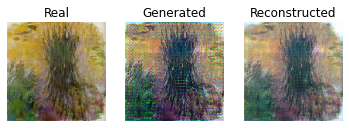

[INFO] Domain B to Domain A


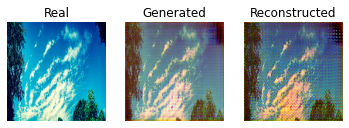

epoch: 55 step: 51 dA_loss: 0.029 dB_loss: 0.051 gAB_loss :4.616 gBA_loss: 4.764
epoch: 55 step: 52 dA_loss: 0.037 dB_loss: 0.037 gAB_loss :4.458 gBA_loss: 4.758
epoch: 55 step: 53 dA_loss: 0.005 dB_loss: 0.023 gAB_loss :4.155 gBA_loss: 4.460
epoch: 55 step: 54 dA_loss: 0.030 dB_loss: 0.055 gAB_loss :3.977 gBA_loss: 4.069
epoch: 55 step: 55 dA_loss: 0.014 dB_loss: 0.126 gAB_loss :4.463 gBA_loss: 4.501
epoch: 55 step: 56 dA_loss: 0.026 dB_loss: 0.148 gAB_loss :4.097 gBA_loss: 4.246
epoch: 55 step: 57 dA_loss: 0.053 dB_loss: 0.070 gAB_loss :3.882 gBA_loss: 4.297
epoch: 55 step: 58 dA_loss: 0.018 dB_loss: 0.034 gAB_loss :4.170 gBA_loss: 4.550
epoch: 55 step: 59 dA_loss: 0.010 dB_loss: 0.012 gAB_loss :4.083 gBA_loss: 4.139
epoch: 55 step: 60 dA_loss: 0.025 dB_loss: 0.027 gAB_loss :4.181 gBA_loss: 4.095
epoch: 55 step: 61 dA_loss: 0.039 dB_loss: 0.034 gAB_loss :4.202 gBA_loss: 4.398
epoch: 55 step: 62 dA_loss: 0.035 dB_loss: 0.011 gAB_loss :3.971 gBA_loss: 4.021
epoch: 55 step: 63 dA_loss: 

 56%|█████▌    | 56/100 [1:32:21<1:11:58, 98.14s/it]

epoch: 55 step: 73 dA_loss: 0.087 dB_loss: 0.046 gAB_loss :4.535 gBA_loss: 4.743
epoch: 56 step: 0 dA_loss: 0.065 dB_loss: 0.250 gAB_loss :4.126 gBA_loss: 4.455
[INFO] Domain A to Domain B


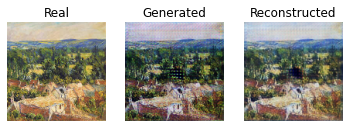

[INFO] Domain B to Domain A


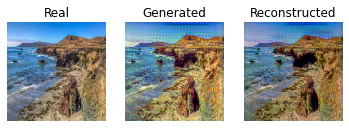

epoch: 56 step: 1 dA_loss: 0.021 dB_loss: 0.090 gAB_loss :4.153 gBA_loss: 4.521
epoch: 56 step: 2 dA_loss: 0.061 dB_loss: 0.035 gAB_loss :3.921 gBA_loss: 4.418
epoch: 56 step: 3 dA_loss: 0.098 dB_loss: 0.063 gAB_loss :3.952 gBA_loss: 3.930
epoch: 56 step: 4 dA_loss: 0.080 dB_loss: 0.018 gAB_loss :4.160 gBA_loss: 3.987
epoch: 56 step: 5 dA_loss: 0.156 dB_loss: 0.020 gAB_loss :4.435 gBA_loss: 4.620
epoch: 56 step: 6 dA_loss: 0.042 dB_loss: 0.026 gAB_loss :3.754 gBA_loss: 4.089
epoch: 56 step: 7 dA_loss: 0.098 dB_loss: 0.104 gAB_loss :3.536 gBA_loss: 3.617
epoch: 56 step: 8 dA_loss: 0.068 dB_loss: 0.057 gAB_loss :3.842 gBA_loss: 4.220
epoch: 56 step: 9 dA_loss: 0.037 dB_loss: 0.070 gAB_loss :3.915 gBA_loss: 3.911
epoch: 56 step: 10 dA_loss: 0.030 dB_loss: 0.090 gAB_loss :4.681 gBA_loss: 4.818
epoch: 56 step: 11 dA_loss: 0.058 dB_loss: 0.021 gAB_loss :4.343 gBA_loss: 4.426
epoch: 56 step: 12 dA_loss: 0.052 dB_loss: 0.021 gAB_loss :4.163 gBA_loss: 4.291
epoch: 56 step: 13 dA_loss: 0.039 dB_

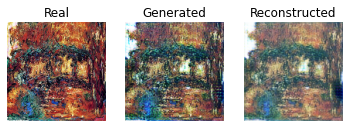

[INFO] Domain B to Domain A


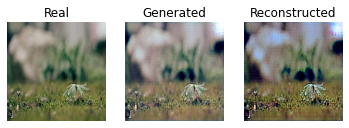

epoch: 56 step: 51 dA_loss: 0.057 dB_loss: 0.046 gAB_loss :4.615 gBA_loss: 4.640
epoch: 56 step: 52 dA_loss: 0.011 dB_loss: 0.014 gAB_loss :4.503 gBA_loss: 4.654
epoch: 56 step: 53 dA_loss: 0.017 dB_loss: 0.011 gAB_loss :4.245 gBA_loss: 4.361
epoch: 56 step: 54 dA_loss: 0.024 dB_loss: 0.062 gAB_loss :4.019 gBA_loss: 4.412
epoch: 56 step: 55 dA_loss: 0.008 dB_loss: 0.086 gAB_loss :4.544 gBA_loss: 4.581
epoch: 56 step: 56 dA_loss: 0.027 dB_loss: 0.091 gAB_loss :4.086 gBA_loss: 4.372
epoch: 56 step: 57 dA_loss: 0.071 dB_loss: 0.055 gAB_loss :4.028 gBA_loss: 4.325
epoch: 56 step: 58 dA_loss: 0.018 dB_loss: 0.040 gAB_loss :4.410 gBA_loss: 4.445
epoch: 56 step: 59 dA_loss: 0.013 dB_loss: 0.007 gAB_loss :4.186 gBA_loss: 4.112
epoch: 56 step: 60 dA_loss: 0.050 dB_loss: 0.107 gAB_loss :4.186 gBA_loss: 4.040
epoch: 56 step: 61 dA_loss: 0.033 dB_loss: 0.071 gAB_loss :4.083 gBA_loss: 4.364
epoch: 56 step: 62 dA_loss: 0.046 dB_loss: 0.015 gAB_loss :3.799 gBA_loss: 4.103
epoch: 56 step: 63 dA_loss: 

 57%|█████▋    | 57/100 [1:33:59<1:10:20, 98.15s/it]

epoch: 56 step: 73 dA_loss: 0.081 dB_loss: 0.025 gAB_loss :4.589 gBA_loss: 5.034
epoch: 57 step: 0 dA_loss: 0.052 dB_loss: 0.029 gAB_loss :4.354 gBA_loss: 4.590
[INFO] Domain A to Domain B


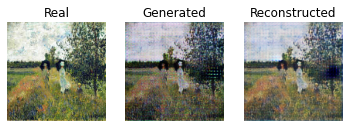

[INFO] Domain B to Domain A


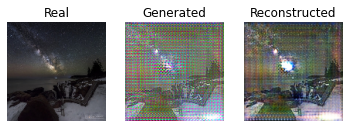

epoch: 57 step: 1 dA_loss: 0.010 dB_loss: 0.011 gAB_loss :4.460 gBA_loss: 4.491
epoch: 57 step: 2 dA_loss: 0.045 dB_loss: 0.017 gAB_loss :4.080 gBA_loss: 4.414
epoch: 57 step: 3 dA_loss: 0.082 dB_loss: 0.015 gAB_loss :3.957 gBA_loss: 3.905
epoch: 57 step: 4 dA_loss: 0.054 dB_loss: 0.015 gAB_loss :4.171 gBA_loss: 4.060
epoch: 57 step: 5 dA_loss: 0.096 dB_loss: 0.017 gAB_loss :4.467 gBA_loss: 4.639
epoch: 57 step: 6 dA_loss: 0.028 dB_loss: 0.033 gAB_loss :3.930 gBA_loss: 4.048
epoch: 57 step: 7 dA_loss: 0.044 dB_loss: 0.058 gAB_loss :3.473 gBA_loss: 3.632
epoch: 57 step: 8 dA_loss: 0.047 dB_loss: 0.057 gAB_loss :3.827 gBA_loss: 4.244
epoch: 57 step: 9 dA_loss: 0.027 dB_loss: 0.049 gAB_loss :3.903 gBA_loss: 3.928
epoch: 57 step: 10 dA_loss: 0.029 dB_loss: 0.083 gAB_loss :4.676 gBA_loss: 4.876
epoch: 57 step: 11 dA_loss: 0.037 dB_loss: 0.011 gAB_loss :4.351 gBA_loss: 4.425
epoch: 57 step: 12 dA_loss: 0.054 dB_loss: 0.022 gAB_loss :4.217 gBA_loss: 4.292
epoch: 57 step: 13 dA_loss: 0.023 dB_

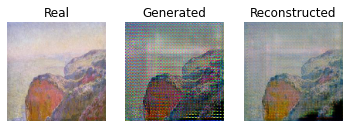

[INFO] Domain B to Domain A


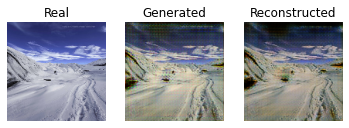

epoch: 57 step: 51 dA_loss: 0.076 dB_loss: 0.037 gAB_loss :4.578 gBA_loss: 4.643
epoch: 57 step: 52 dA_loss: 0.026 dB_loss: 0.009 gAB_loss :4.483 gBA_loss: 4.686
epoch: 57 step: 53 dA_loss: 0.022 dB_loss: 0.005 gAB_loss :4.222 gBA_loss: 4.411
epoch: 57 step: 54 dA_loss: 0.023 dB_loss: 0.048 gAB_loss :4.040 gBA_loss: 4.152
epoch: 57 step: 55 dA_loss: 0.018 dB_loss: 0.062 gAB_loss :4.312 gBA_loss: 4.574
epoch: 57 step: 56 dA_loss: 0.027 dB_loss: 0.040 gAB_loss :4.172 gBA_loss: 4.373
epoch: 57 step: 57 dA_loss: 0.085 dB_loss: 0.047 gAB_loss :4.010 gBA_loss: 4.257
epoch: 57 step: 58 dA_loss: 0.010 dB_loss: 0.014 gAB_loss :4.239 gBA_loss: 4.397
epoch: 57 step: 59 dA_loss: 0.013 dB_loss: 0.004 gAB_loss :4.084 gBA_loss: 4.073
epoch: 57 step: 60 dA_loss: 0.068 dB_loss: 0.022 gAB_loss :4.144 gBA_loss: 4.041
epoch: 57 step: 61 dA_loss: 0.049 dB_loss: 0.021 gAB_loss :4.187 gBA_loss: 4.161
epoch: 57 step: 62 dA_loss: 0.054 dB_loss: 0.014 gAB_loss :3.918 gBA_loss: 4.085
epoch: 57 step: 63 dA_loss: 

 58%|█████▊    | 58/100 [1:35:37<1:08:42, 98.14s/it]

epoch: 57 step: 73 dA_loss: 0.048 dB_loss: 0.092 gAB_loss :4.665 gBA_loss: 4.875
epoch: 58 step: 0 dA_loss: 0.071 dB_loss: 0.044 gAB_loss :4.368 gBA_loss: 4.478
[INFO] Domain A to Domain B


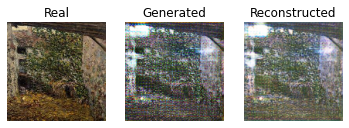

[INFO] Domain B to Domain A


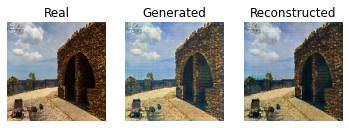

epoch: 58 step: 1 dA_loss: 0.033 dB_loss: 0.054 gAB_loss :4.347 gBA_loss: 4.550
epoch: 58 step: 2 dA_loss: 0.052 dB_loss: 0.038 gAB_loss :4.029 gBA_loss: 4.479
epoch: 58 step: 3 dA_loss: 0.121 dB_loss: 0.095 gAB_loss :4.070 gBA_loss: 3.963
epoch: 58 step: 4 dA_loss: 0.108 dB_loss: 0.025 gAB_loss :4.139 gBA_loss: 3.866
epoch: 58 step: 5 dA_loss: 0.075 dB_loss: 0.018 gAB_loss :4.345 gBA_loss: 4.390
epoch: 58 step: 6 dA_loss: 0.031 dB_loss: 0.030 gAB_loss :3.908 gBA_loss: 4.064
epoch: 58 step: 7 dA_loss: 0.024 dB_loss: 0.071 gAB_loss :3.538 gBA_loss: 3.734
epoch: 58 step: 8 dA_loss: 0.049 dB_loss: 0.049 gAB_loss :3.775 gBA_loss: 4.243
epoch: 58 step: 9 dA_loss: 0.029 dB_loss: 0.080 gAB_loss :3.913 gBA_loss: 3.979
epoch: 58 step: 10 dA_loss: 0.025 dB_loss: 0.087 gAB_loss :4.682 gBA_loss: 4.908
epoch: 58 step: 11 dA_loss: 0.042 dB_loss: 0.024 gAB_loss :4.337 gBA_loss: 4.536
epoch: 58 step: 12 dA_loss: 0.042 dB_loss: 0.022 gAB_loss :4.137 gBA_loss: 4.446
epoch: 58 step: 13 dA_loss: 0.021 dB_

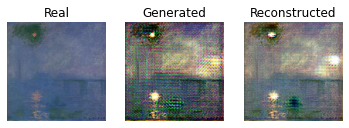

[INFO] Domain B to Domain A


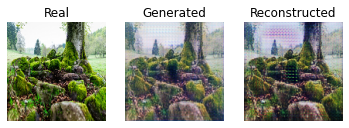

epoch: 58 step: 51 dA_loss: 0.026 dB_loss: 0.075 gAB_loss :4.703 gBA_loss: 4.677
epoch: 58 step: 52 dA_loss: 0.006 dB_loss: 0.048 gAB_loss :4.564 gBA_loss: 4.792
epoch: 58 step: 53 dA_loss: 0.032 dB_loss: 0.054 gAB_loss :4.244 gBA_loss: 4.413
epoch: 58 step: 54 dA_loss: 0.020 dB_loss: 0.078 gAB_loss :3.928 gBA_loss: 4.131
epoch: 58 step: 55 dA_loss: 0.015 dB_loss: 0.141 gAB_loss :4.527 gBA_loss: 4.543
epoch: 58 step: 56 dA_loss: 0.030 dB_loss: 0.181 gAB_loss :4.127 gBA_loss: 4.388
epoch: 58 step: 57 dA_loss: 0.072 dB_loss: 0.059 gAB_loss :3.863 gBA_loss: 4.302
epoch: 58 step: 58 dA_loss: 0.059 dB_loss: 0.055 gAB_loss :4.178 gBA_loss: 4.922
epoch: 58 step: 59 dA_loss: 0.061 dB_loss: 0.018 gAB_loss :4.120 gBA_loss: 4.223
epoch: 58 step: 60 dA_loss: 0.167 dB_loss: 0.040 gAB_loss :4.155 gBA_loss: 3.916
epoch: 58 step: 61 dA_loss: 0.035 dB_loss: 0.039 gAB_loss :4.169 gBA_loss: 4.049
epoch: 58 step: 62 dA_loss: 0.129 dB_loss: 0.017 gAB_loss :4.071 gBA_loss: 4.033
epoch: 58 step: 63 dA_loss: 

 59%|█████▉    | 59/100 [1:37:16<1:07:10, 98.30s/it]

epoch: 58 step: 73 dA_loss: 0.070 dB_loss: 0.059 gAB_loss :4.529 gBA_loss: 4.942
epoch: 59 step: 0 dA_loss: 0.076 dB_loss: 0.015 gAB_loss :4.350 gBA_loss: 4.519
[INFO] Domain A to Domain B


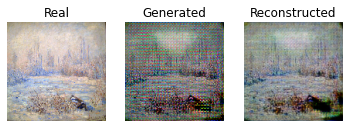

[INFO] Domain B to Domain A


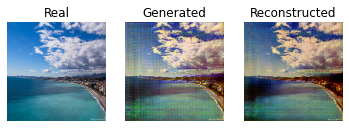

epoch: 59 step: 1 dA_loss: 0.011 dB_loss: 0.016 gAB_loss :4.440 gBA_loss: 4.452
epoch: 59 step: 2 dA_loss: 0.030 dB_loss: 0.019 gAB_loss :4.116 gBA_loss: 4.354
epoch: 59 step: 3 dA_loss: 0.087 dB_loss: 0.027 gAB_loss :4.040 gBA_loss: 4.222
epoch: 59 step: 4 dA_loss: 0.112 dB_loss: 0.021 gAB_loss :4.212 gBA_loss: 4.052
epoch: 59 step: 5 dA_loss: 0.025 dB_loss: 0.011 gAB_loss :4.399 gBA_loss: 4.208
epoch: 59 step: 6 dA_loss: 0.108 dB_loss: 0.016 gAB_loss :3.952 gBA_loss: 4.097
epoch: 59 step: 7 dA_loss: 0.027 dB_loss: 0.068 gAB_loss :3.567 gBA_loss: 3.830
epoch: 59 step: 8 dA_loss: 0.044 dB_loss: 0.042 gAB_loss :3.790 gBA_loss: 4.302
epoch: 59 step: 9 dA_loss: 0.132 dB_loss: 0.048 gAB_loss :3.878 gBA_loss: 3.889
epoch: 59 step: 10 dA_loss: 0.015 dB_loss: 0.081 gAB_loss :4.642 gBA_loss: 4.793
epoch: 59 step: 11 dA_loss: 0.046 dB_loss: 0.013 gAB_loss :4.389 gBA_loss: 4.336
epoch: 59 step: 12 dA_loss: 0.032 dB_loss: 0.018 gAB_loss :4.190 gBA_loss: 4.251
epoch: 59 step: 13 dA_loss: 0.015 dB_

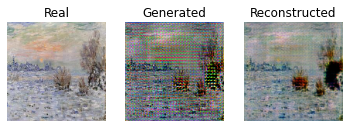

[INFO] Domain B to Domain A


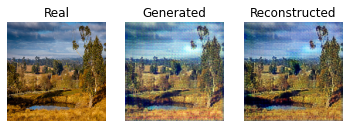

epoch: 59 step: 51 dA_loss: 0.034 dB_loss: 0.027 gAB_loss :4.589 gBA_loss: 4.669
epoch: 59 step: 52 dA_loss: 0.009 dB_loss: 0.013 gAB_loss :4.517 gBA_loss: 4.715
epoch: 59 step: 53 dA_loss: 0.027 dB_loss: 0.016 gAB_loss :4.304 gBA_loss: 4.411
epoch: 59 step: 54 dA_loss: 0.024 dB_loss: 0.066 gAB_loss :4.197 gBA_loss: 4.344
epoch: 59 step: 55 dA_loss: 0.024 dB_loss: 0.096 gAB_loss :4.321 gBA_loss: 4.558
epoch: 59 step: 56 dA_loss: 0.045 dB_loss: 0.058 gAB_loss :4.034 gBA_loss: 4.119
epoch: 59 step: 57 dA_loss: 0.072 dB_loss: 0.087 gAB_loss :4.094 gBA_loss: 4.223
epoch: 59 step: 58 dA_loss: 0.044 dB_loss: 0.037 gAB_loss :4.295 gBA_loss: 4.706
epoch: 59 step: 59 dA_loss: 0.020 dB_loss: 0.035 gAB_loss :4.064 gBA_loss: 4.203
epoch: 59 step: 60 dA_loss: 0.144 dB_loss: 0.071 gAB_loss :3.992 gBA_loss: 3.905
epoch: 59 step: 61 dA_loss: 0.053 dB_loss: 0.038 gAB_loss :4.107 gBA_loss: 4.001
epoch: 59 step: 62 dA_loss: 0.099 dB_loss: 0.007 gAB_loss :3.903 gBA_loss: 3.930
epoch: 59 step: 63 dA_loss: 

 60%|██████    | 60/100 [1:38:54<1:05:31, 98.29s/it]

epoch: 59 step: 73 dA_loss: 0.045 dB_loss: 0.009 gAB_loss :4.528 gBA_loss: 4.758
epoch: 60 step: 0 dA_loss: 0.080 dB_loss: 0.026 gAB_loss :4.272 gBA_loss: 4.583
[INFO] Domain A to Domain B


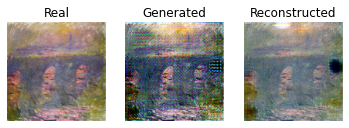

[INFO] Domain B to Domain A


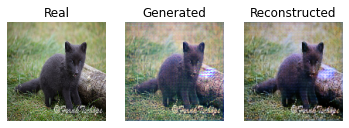

epoch: 60 step: 1 dA_loss: 0.012 dB_loss: 0.012 gAB_loss :4.348 gBA_loss: 4.495
epoch: 60 step: 2 dA_loss: 0.036 dB_loss: 0.018 gAB_loss :4.178 gBA_loss: 4.395
epoch: 60 step: 3 dA_loss: 0.105 dB_loss: 0.008 gAB_loss :4.072 gBA_loss: 3.977
epoch: 60 step: 4 dA_loss: 0.078 dB_loss: 0.010 gAB_loss :4.125 gBA_loss: 3.881
epoch: 60 step: 5 dA_loss: 0.024 dB_loss: 0.025 gAB_loss :4.224 gBA_loss: 4.047
epoch: 60 step: 6 dA_loss: 0.110 dB_loss: 0.021 gAB_loss :3.913 gBA_loss: 4.156
epoch: 60 step: 7 dA_loss: 0.022 dB_loss: 0.053 gAB_loss :3.513 gBA_loss: 3.788
epoch: 60 step: 8 dA_loss: 0.068 dB_loss: 0.046 gAB_loss :3.813 gBA_loss: 4.336
epoch: 60 step: 9 dA_loss: 0.047 dB_loss: 0.046 gAB_loss :3.904 gBA_loss: 3.973
epoch: 60 step: 10 dA_loss: 0.017 dB_loss: 0.079 gAB_loss :4.672 gBA_loss: 4.825
epoch: 60 step: 11 dA_loss: 0.016 dB_loss: 0.013 gAB_loss :4.318 gBA_loss: 4.261
epoch: 60 step: 12 dA_loss: 0.023 dB_loss: 0.026 gAB_loss :4.155 gBA_loss: 4.193
epoch: 60 step: 13 dA_loss: 0.010 dB_

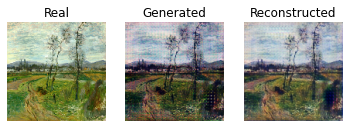

[INFO] Domain B to Domain A


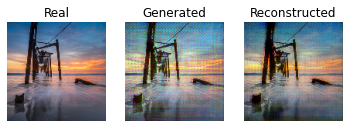

epoch: 60 step: 51 dA_loss: 0.024 dB_loss: 0.027 gAB_loss :4.648 gBA_loss: 4.667
epoch: 60 step: 52 dA_loss: 0.015 dB_loss: 0.009 gAB_loss :4.538 gBA_loss: 4.739
epoch: 60 step: 53 dA_loss: 0.041 dB_loss: 0.009 gAB_loss :4.284 gBA_loss: 4.505
epoch: 60 step: 54 dA_loss: 0.013 dB_loss: 0.058 gAB_loss :4.071 gBA_loss: 4.116
epoch: 60 step: 55 dA_loss: 0.014 dB_loss: 0.059 gAB_loss :4.267 gBA_loss: 4.403
epoch: 60 step: 56 dA_loss: 0.028 dB_loss: 0.043 gAB_loss :4.123 gBA_loss: 4.146
epoch: 60 step: 57 dA_loss: 0.064 dB_loss: 0.040 gAB_loss :3.931 gBA_loss: 4.143
epoch: 60 step: 58 dA_loss: 0.018 dB_loss: 0.024 gAB_loss :4.180 gBA_loss: 4.440
epoch: 60 step: 59 dA_loss: 0.032 dB_loss: 0.008 gAB_loss :4.092 gBA_loss: 4.232
epoch: 60 step: 60 dA_loss: 0.090 dB_loss: 0.022 gAB_loss :4.111 gBA_loss: 4.016
epoch: 60 step: 61 dA_loss: 0.039 dB_loss: 0.017 gAB_loss :4.172 gBA_loss: 4.035
epoch: 60 step: 62 dA_loss: 0.048 dB_loss: 0.015 gAB_loss :3.967 gBA_loss: 3.965
epoch: 60 step: 63 dA_loss: 

 61%|██████    | 61/100 [1:40:32<1:03:53, 98.31s/it]

epoch: 60 step: 73 dA_loss: 0.028 dB_loss: 0.044 gAB_loss :4.551 gBA_loss: 4.866
epoch: 61 step: 0 dA_loss: 0.031 dB_loss: 0.104 gAB_loss :4.151 gBA_loss: 4.402
[INFO] Domain A to Domain B


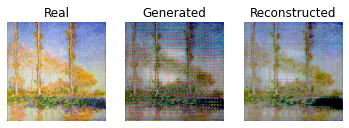

[INFO] Domain B to Domain A


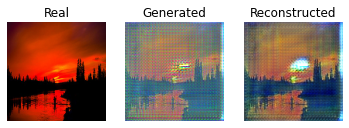

epoch: 61 step: 1 dA_loss: 0.018 dB_loss: 0.063 gAB_loss :4.316 gBA_loss: 4.464
epoch: 61 step: 2 dA_loss: 0.023 dB_loss: 0.052 gAB_loss :4.020 gBA_loss: 4.578
epoch: 61 step: 3 dA_loss: 0.079 dB_loss: 0.038 gAB_loss :4.025 gBA_loss: 4.101
epoch: 61 step: 4 dA_loss: 0.063 dB_loss: 0.007 gAB_loss :4.151 gBA_loss: 4.116
epoch: 61 step: 5 dA_loss: 0.028 dB_loss: 0.020 gAB_loss :4.349 gBA_loss: 4.405
epoch: 61 step: 6 dA_loss: 0.024 dB_loss: 0.022 gAB_loss :3.791 gBA_loss: 3.971
epoch: 61 step: 7 dA_loss: 0.017 dB_loss: 0.059 gAB_loss :3.479 gBA_loss: 3.705
epoch: 61 step: 8 dA_loss: 0.022 dB_loss: 0.054 gAB_loss :3.811 gBA_loss: 4.266
epoch: 61 step: 9 dA_loss: 0.034 dB_loss: 0.046 gAB_loss :3.887 gBA_loss: 4.001
epoch: 61 step: 10 dA_loss: 0.016 dB_loss: 0.079 gAB_loss :4.631 gBA_loss: 4.957
epoch: 61 step: 11 dA_loss: 0.032 dB_loss: 0.021 gAB_loss :4.281 gBA_loss: 4.398
epoch: 61 step: 12 dA_loss: 0.022 dB_loss: 0.045 gAB_loss :4.214 gBA_loss: 4.245
epoch: 61 step: 13 dA_loss: 0.008 dB_

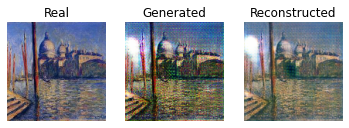

[INFO] Domain B to Domain A


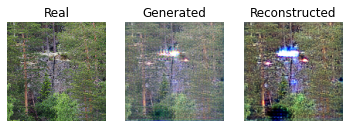

epoch: 61 step: 51 dA_loss: 0.030 dB_loss: 0.016 gAB_loss :4.510 gBA_loss: 4.666
epoch: 61 step: 52 dA_loss: 0.011 dB_loss: 0.024 gAB_loss :4.534 gBA_loss: 4.710
epoch: 61 step: 53 dA_loss: 0.050 dB_loss: 0.008 gAB_loss :4.261 gBA_loss: 4.262
epoch: 61 step: 54 dA_loss: 0.031 dB_loss: 0.053 gAB_loss :4.073 gBA_loss: 4.082
epoch: 61 step: 55 dA_loss: 0.040 dB_loss: 0.065 gAB_loss :4.176 gBA_loss: 4.582
epoch: 61 step: 56 dA_loss: 0.055 dB_loss: 0.067 gAB_loss :4.110 gBA_loss: 4.254
epoch: 61 step: 57 dA_loss: 0.052 dB_loss: 0.038 gAB_loss :3.901 gBA_loss: 4.134
epoch: 61 step: 58 dA_loss: 0.031 dB_loss: 0.030 gAB_loss :4.190 gBA_loss: 4.492
epoch: 61 step: 59 dA_loss: 0.037 dB_loss: 0.035 gAB_loss :4.062 gBA_loss: 4.099
epoch: 61 step: 60 dA_loss: 0.091 dB_loss: 0.026 gAB_loss :4.176 gBA_loss: 4.121
epoch: 61 step: 61 dA_loss: 0.078 dB_loss: 0.023 gAB_loss :4.115 gBA_loss: 4.230
epoch: 61 step: 62 dA_loss: 0.016 dB_loss: 0.011 gAB_loss :3.890 gBA_loss: 3.854
epoch: 61 step: 63 dA_loss: 

 62%|██████▏   | 62/100 [1:42:11<1:02:15, 98.31s/it]

epoch: 61 step: 73 dA_loss: 0.057 dB_loss: 0.076 gAB_loss :4.639 gBA_loss: 4.994
epoch: 62 step: 0 dA_loss: 0.047 dB_loss: 0.058 gAB_loss :4.341 gBA_loss: 4.539
[INFO] Domain A to Domain B


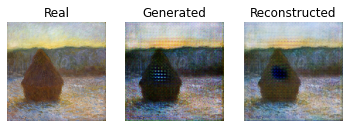

[INFO] Domain B to Domain A


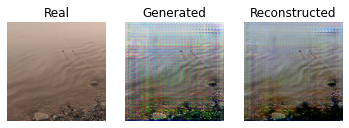

epoch: 62 step: 1 dA_loss: 0.026 dB_loss: 0.052 gAB_loss :4.300 gBA_loss: 4.653
epoch: 62 step: 2 dA_loss: 0.023 dB_loss: 0.015 gAB_loss :4.048 gBA_loss: 4.407
epoch: 62 step: 3 dA_loss: 0.070 dB_loss: 0.056 gAB_loss :4.167 gBA_loss: 4.179
epoch: 62 step: 4 dA_loss: 0.065 dB_loss: 0.021 gAB_loss :4.214 gBA_loss: 4.091
epoch: 62 step: 5 dA_loss: 0.037 dB_loss: 0.040 gAB_loss :4.259 gBA_loss: 4.096
epoch: 62 step: 6 dA_loss: 0.077 dB_loss: 0.047 gAB_loss :3.943 gBA_loss: 3.980
epoch: 62 step: 7 dA_loss: 0.020 dB_loss: 0.090 gAB_loss :3.433 gBA_loss: 3.793
epoch: 62 step: 8 dA_loss: 0.021 dB_loss: 0.062 gAB_loss :3.738 gBA_loss: 4.296
epoch: 62 step: 9 dA_loss: 0.047 dB_loss: 0.042 gAB_loss :3.897 gBA_loss: 3.893
epoch: 62 step: 10 dA_loss: 0.022 dB_loss: 0.075 gAB_loss :4.719 gBA_loss: 4.784
epoch: 62 step: 11 dA_loss: 0.027 dB_loss: 0.012 gAB_loss :4.314 gBA_loss: 4.307
epoch: 62 step: 12 dA_loss: 0.021 dB_loss: 0.023 gAB_loss :4.134 gBA_loss: 4.291
epoch: 62 step: 13 dA_loss: 0.009 dB_

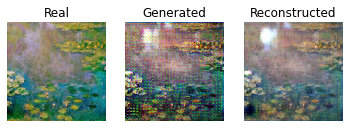

[INFO] Domain B to Domain A


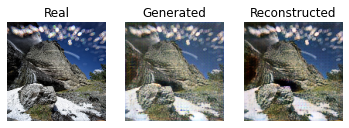

epoch: 62 step: 51 dA_loss: 0.017 dB_loss: 0.027 gAB_loss :4.620 gBA_loss: 4.545
epoch: 62 step: 52 dA_loss: 0.013 dB_loss: 0.011 gAB_loss :4.490 gBA_loss: 4.645
epoch: 62 step: 53 dA_loss: 0.014 dB_loss: 0.009 gAB_loss :4.220 gBA_loss: 4.335
epoch: 62 step: 54 dA_loss: 0.009 dB_loss: 0.081 gAB_loss :4.144 gBA_loss: 4.086
epoch: 62 step: 55 dA_loss: 0.032 dB_loss: 0.061 gAB_loss :4.288 gBA_loss: 4.471
epoch: 62 step: 56 dA_loss: 0.026 dB_loss: 0.047 gAB_loss :3.823 gBA_loss: 4.266
epoch: 62 step: 57 dA_loss: 0.059 dB_loss: 0.110 gAB_loss :4.061 gBA_loss: 4.122
epoch: 62 step: 58 dA_loss: 0.012 dB_loss: 0.042 gAB_loss :4.238 gBA_loss: 4.405
epoch: 62 step: 59 dA_loss: 0.024 dB_loss: 0.048 gAB_loss :3.988 gBA_loss: 4.141
epoch: 62 step: 60 dA_loss: 0.057 dB_loss: 0.085 gAB_loss :3.945 gBA_loss: 4.025
epoch: 62 step: 61 dA_loss: 0.060 dB_loss: 0.053 gAB_loss :4.024 gBA_loss: 4.249
epoch: 62 step: 62 dA_loss: 0.008 dB_loss: 0.013 gAB_loss :3.926 gBA_loss: 3.794
epoch: 62 step: 63 dA_loss: 

 63%|██████▎   | 63/100 [1:43:49<1:00:37, 98.30s/it]

epoch: 62 step: 73 dA_loss: 0.031 dB_loss: 0.152 gAB_loss :4.540 gBA_loss: 4.847
epoch: 63 step: 0 dA_loss: 0.036 dB_loss: 0.025 gAB_loss :4.359 gBA_loss: 4.475
[INFO] Domain A to Domain B


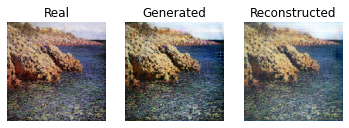

[INFO] Domain B to Domain A


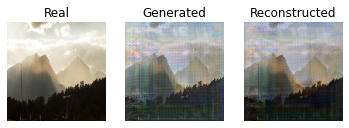

epoch: 63 step: 1 dA_loss: 0.008 dB_loss: 0.037 gAB_loss :4.314 gBA_loss: 4.387
epoch: 63 step: 2 dA_loss: 0.013 dB_loss: 0.068 gAB_loss :3.930 gBA_loss: 4.310
epoch: 63 step: 3 dA_loss: 0.053 dB_loss: 0.063 gAB_loss :4.036 gBA_loss: 4.093
epoch: 63 step: 4 dA_loss: 0.055 dB_loss: 0.023 gAB_loss :4.159 gBA_loss: 4.114
epoch: 63 step: 5 dA_loss: 0.027 dB_loss: 0.027 gAB_loss :4.300 gBA_loss: 4.118
epoch: 63 step: 6 dA_loss: 0.026 dB_loss: 0.014 gAB_loss :3.710 gBA_loss: 3.880
epoch: 63 step: 7 dA_loss: 0.025 dB_loss: 0.063 gAB_loss :3.472 gBA_loss: 3.739
epoch: 63 step: 8 dA_loss: 0.018 dB_loss: 0.063 gAB_loss :3.816 gBA_loss: 4.286
epoch: 63 step: 9 dA_loss: 0.031 dB_loss: 0.052 gAB_loss :3.868 gBA_loss: 3.967
epoch: 63 step: 10 dA_loss: 0.005 dB_loss: 0.076 gAB_loss :4.644 gBA_loss: 4.877
epoch: 63 step: 11 dA_loss: 0.022 dB_loss: 0.033 gAB_loss :4.233 gBA_loss: 4.281
epoch: 63 step: 12 dA_loss: 0.026 dB_loss: 0.051 gAB_loss :4.146 gBA_loss: 4.244
epoch: 63 step: 13 dA_loss: 0.007 dB_

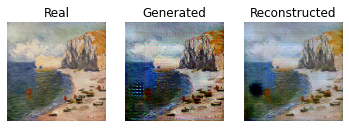

[INFO] Domain B to Domain A


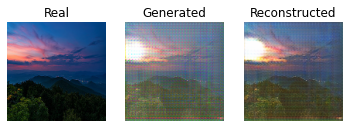

epoch: 63 step: 51 dA_loss: 0.008 dB_loss: 0.018 gAB_loss :4.484 gBA_loss: 4.568
epoch: 63 step: 52 dA_loss: 0.006 dB_loss: 0.009 gAB_loss :4.446 gBA_loss: 4.648
epoch: 63 step: 53 dA_loss: 0.022 dB_loss: 0.014 gAB_loss :4.199 gBA_loss: 4.200
epoch: 63 step: 54 dA_loss: 0.011 dB_loss: 0.069 gAB_loss :4.107 gBA_loss: 4.110
epoch: 63 step: 55 dA_loss: 0.053 dB_loss: 0.067 gAB_loss :4.290 gBA_loss: 4.564
epoch: 63 step: 56 dA_loss: 0.038 dB_loss: 0.061 gAB_loss :3.927 gBA_loss: 4.193
epoch: 63 step: 57 dA_loss: 0.081 dB_loss: 0.074 gAB_loss :3.951 gBA_loss: 3.998
epoch: 63 step: 58 dA_loss: 0.023 dB_loss: 0.023 gAB_loss :4.210 gBA_loss: 4.352
epoch: 63 step: 59 dA_loss: 0.012 dB_loss: 0.011 gAB_loss :4.110 gBA_loss: 3.994
epoch: 63 step: 60 dA_loss: 0.045 dB_loss: 0.046 gAB_loss :4.058 gBA_loss: 3.919
epoch: 63 step: 61 dA_loss: 0.034 dB_loss: 0.029 gAB_loss :4.091 gBA_loss: 4.146
epoch: 63 step: 62 dA_loss: 0.011 dB_loss: 0.018 gAB_loss :3.907 gBA_loss: 3.770
epoch: 63 step: 63 dA_loss: 

 64%|██████▍   | 64/100 [1:45:27<58:58, 98.28s/it]  

epoch: 63 step: 73 dA_loss: 0.031 dB_loss: 0.046 gAB_loss :4.585 gBA_loss: 4.872
epoch: 64 step: 0 dA_loss: 0.019 dB_loss: 0.028 gAB_loss :4.276 gBA_loss: 4.438
[INFO] Domain A to Domain B


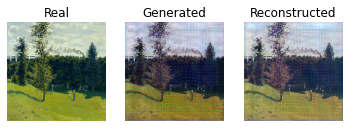

[INFO] Domain B to Domain A


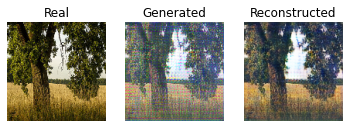

epoch: 64 step: 1 dA_loss: 0.007 dB_loss: 0.012 gAB_loss :4.315 gBA_loss: 4.362
epoch: 64 step: 2 dA_loss: 0.011 dB_loss: 0.032 gAB_loss :4.015 gBA_loss: 4.277
epoch: 64 step: 3 dA_loss: 0.028 dB_loss: 0.038 gAB_loss :3.881 gBA_loss: 3.983
epoch: 64 step: 4 dA_loss: 0.032 dB_loss: 0.018 gAB_loss :4.093 gBA_loss: 4.154
epoch: 64 step: 5 dA_loss: 0.010 dB_loss: 0.016 gAB_loss :4.358 gBA_loss: 4.180
epoch: 64 step: 6 dA_loss: 0.029 dB_loss: 0.029 gAB_loss :3.670 gBA_loss: 3.803
epoch: 64 step: 7 dA_loss: 0.017 dB_loss: 0.062 gAB_loss :3.490 gBA_loss: 3.590
epoch: 64 step: 8 dA_loss: 0.022 dB_loss: 0.064 gAB_loss :3.689 gBA_loss: 4.230
epoch: 64 step: 9 dA_loss: 0.026 dB_loss: 0.047 gAB_loss :3.770 gBA_loss: 3.950
epoch: 64 step: 10 dA_loss: 0.007 dB_loss: 0.074 gAB_loss :4.682 gBA_loss: 4.841
epoch: 64 step: 11 dA_loss: 0.020 dB_loss: 0.014 gAB_loss :4.322 gBA_loss: 4.312
epoch: 64 step: 12 dA_loss: 0.017 dB_loss: 0.040 gAB_loss :4.023 gBA_loss: 4.185
epoch: 64 step: 13 dA_loss: 0.010 dB_

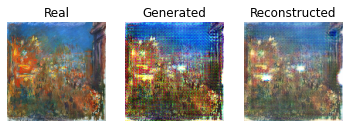

[INFO] Domain B to Domain A


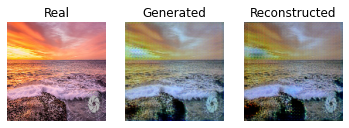

epoch: 64 step: 51 dA_loss: 0.019 dB_loss: 0.032 gAB_loss :4.601 gBA_loss: 4.523
epoch: 64 step: 52 dA_loss: 0.012 dB_loss: 0.077 gAB_loss :4.365 gBA_loss: 4.636
epoch: 64 step: 53 dA_loss: 0.019 dB_loss: 0.122 gAB_loss :4.183 gBA_loss: 4.141
epoch: 64 step: 54 dA_loss: 0.009 dB_loss: 0.126 gAB_loss :3.932 gBA_loss: 3.950
epoch: 64 step: 55 dA_loss: 0.032 dB_loss: 0.248 gAB_loss :4.574 gBA_loss: 4.497
epoch: 64 step: 56 dA_loss: 0.017 dB_loss: 0.318 gAB_loss :3.634 gBA_loss: 4.284
epoch: 64 step: 57 dA_loss: 0.041 dB_loss: 0.519 gAB_loss :4.003 gBA_loss: 4.117
epoch: 64 step: 58 dA_loss: 0.006 dB_loss: 0.265 gAB_loss :4.135 gBA_loss: 4.249
epoch: 64 step: 59 dA_loss: 0.028 dB_loss: 0.291 gAB_loss :3.801 gBA_loss: 4.117
epoch: 64 step: 60 dA_loss: 0.048 dB_loss: 0.230 gAB_loss :3.783 gBA_loss: 3.971
epoch: 64 step: 61 dA_loss: 0.020 dB_loss: 0.141 gAB_loss :3.817 gBA_loss: 4.089
epoch: 64 step: 62 dA_loss: 0.013 dB_loss: 0.106 gAB_loss :3.635 gBA_loss: 3.754
epoch: 64 step: 63 dA_loss: 

 65%|██████▌   | 65/100 [1:47:05<57:19, 98.26s/it]

epoch: 64 step: 73 dA_loss: 0.014 dB_loss: 0.052 gAB_loss :4.372 gBA_loss: 4.661
epoch: 65 step: 0 dA_loss: 0.030 dB_loss: 0.043 gAB_loss :4.148 gBA_loss: 4.432
[INFO] Domain A to Domain B


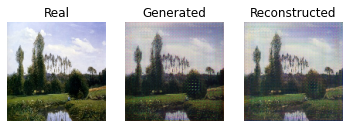

[INFO] Domain B to Domain A


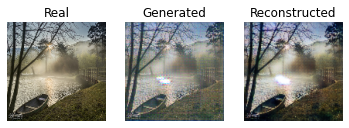

epoch: 65 step: 1 dA_loss: 0.007 dB_loss: 0.027 gAB_loss :4.347 gBA_loss: 4.415
epoch: 65 step: 2 dA_loss: 0.017 dB_loss: 0.047 gAB_loss :4.098 gBA_loss: 4.321
epoch: 65 step: 3 dA_loss: 0.030 dB_loss: 0.028 gAB_loss :3.921 gBA_loss: 3.951
epoch: 65 step: 4 dA_loss: 0.026 dB_loss: 0.017 gAB_loss :4.004 gBA_loss: 4.068
epoch: 65 step: 5 dA_loss: 0.010 dB_loss: 0.031 gAB_loss :4.146 gBA_loss: 4.128
epoch: 65 step: 6 dA_loss: 0.025 dB_loss: 0.067 gAB_loss :3.930 gBA_loss: 3.927
epoch: 65 step: 7 dA_loss: 0.016 dB_loss: 0.156 gAB_loss :3.442 gBA_loss: 3.614
epoch: 65 step: 8 dA_loss: 0.015 dB_loss: 0.099 gAB_loss :3.553 gBA_loss: 4.112
epoch: 65 step: 9 dA_loss: 0.020 dB_loss: 0.052 gAB_loss :3.696 gBA_loss: 3.843
epoch: 65 step: 10 dA_loss: 0.006 dB_loss: 0.089 gAB_loss :4.567 gBA_loss: 4.819
epoch: 65 step: 11 dA_loss: 0.014 dB_loss: 0.028 gAB_loss :4.263 gBA_loss: 4.281
epoch: 65 step: 12 dA_loss: 0.020 dB_loss: 0.030 gAB_loss :4.060 gBA_loss: 4.184
epoch: 65 step: 13 dA_loss: 0.008 dB_

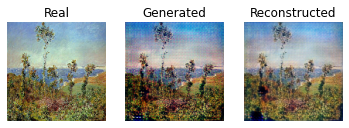

[INFO] Domain B to Domain A


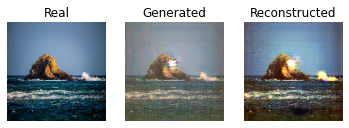

epoch: 65 step: 51 dA_loss: 0.008 dB_loss: 0.035 gAB_loss :4.597 gBA_loss: 4.502
epoch: 65 step: 52 dA_loss: 0.006 dB_loss: 0.031 gAB_loss :4.435 gBA_loss: 4.610
epoch: 65 step: 53 dA_loss: 0.011 dB_loss: 0.031 gAB_loss :4.092 gBA_loss: 4.229
epoch: 65 step: 54 dA_loss: 0.006 dB_loss: 0.071 gAB_loss :4.027 gBA_loss: 4.128
epoch: 65 step: 55 dA_loss: 0.007 dB_loss: 0.059 gAB_loss :4.192 gBA_loss: 4.361
epoch: 65 step: 56 dA_loss: 0.029 dB_loss: 0.067 gAB_loss :4.153 gBA_loss: 4.245
epoch: 65 step: 57 dA_loss: 0.032 dB_loss: 0.054 gAB_loss :3.914 gBA_loss: 4.115
epoch: 65 step: 58 dA_loss: 0.005 dB_loss: 0.025 gAB_loss :4.122 gBA_loss: 4.250
epoch: 65 step: 59 dA_loss: 0.006 dB_loss: 0.016 gAB_loss :4.016 gBA_loss: 3.848
epoch: 65 step: 60 dA_loss: 0.028 dB_loss: 0.053 gAB_loss :3.993 gBA_loss: 3.987
epoch: 65 step: 61 dA_loss: 0.034 dB_loss: 0.064 gAB_loss :4.170 gBA_loss: 4.198
epoch: 65 step: 62 dA_loss: 0.011 dB_loss: 0.008 gAB_loss :3.828 gBA_loss: 3.772
epoch: 65 step: 63 dA_loss: 

 66%|██████▌   | 66/100 [1:48:44<55:39, 98.22s/it]

epoch: 65 step: 73 dA_loss: 0.011 dB_loss: 0.084 gAB_loss :4.576 gBA_loss: 4.677
epoch: 66 step: 0 dA_loss: 0.016 dB_loss: 0.036 gAB_loss :4.354 gBA_loss: 4.258
[INFO] Domain A to Domain B


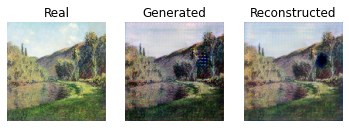

[INFO] Domain B to Domain A


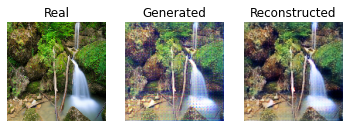

epoch: 66 step: 1 dA_loss: 0.030 dB_loss: 0.017 gAB_loss :4.298 gBA_loss: 4.356
epoch: 66 step: 2 dA_loss: 0.009 dB_loss: 0.054 gAB_loss :3.929 gBA_loss: 4.323
epoch: 66 step: 3 dA_loss: 0.023 dB_loss: 0.039 gAB_loss :3.936 gBA_loss: 3.956
epoch: 66 step: 4 dA_loss: 0.017 dB_loss: 0.008 gAB_loss :3.989 gBA_loss: 3.954
epoch: 66 step: 5 dA_loss: 0.021 dB_loss: 0.021 gAB_loss :4.205 gBA_loss: 4.212
epoch: 66 step: 6 dA_loss: 0.014 dB_loss: 0.019 gAB_loss :3.682 gBA_loss: 3.909
epoch: 66 step: 7 dA_loss: 0.009 dB_loss: 0.052 gAB_loss :3.377 gBA_loss: 3.597
epoch: 66 step: 8 dA_loss: 0.016 dB_loss: 0.104 gAB_loss :3.807 gBA_loss: 4.061
epoch: 66 step: 9 dA_loss: 0.016 dB_loss: 0.055 gAB_loss :3.861 gBA_loss: 3.851
epoch: 66 step: 10 dA_loss: 0.005 dB_loss: 0.092 gAB_loss :4.588 gBA_loss: 4.816
epoch: 66 step: 11 dA_loss: 0.008 dB_loss: 0.014 gAB_loss :4.157 gBA_loss: 4.224
epoch: 66 step: 12 dA_loss: 0.009 dB_loss: 0.065 gAB_loss :3.961 gBA_loss: 4.137
epoch: 66 step: 13 dA_loss: 0.011 dB_

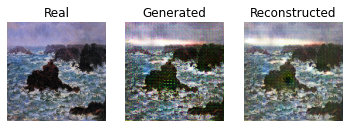

[INFO] Domain B to Domain A


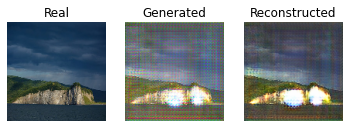

epoch: 66 step: 51 dA_loss: 0.010 dB_loss: 0.026 gAB_loss :4.545 gBA_loss: 4.469
epoch: 66 step: 52 dA_loss: 0.008 dB_loss: 0.038 gAB_loss :4.429 gBA_loss: 4.583
epoch: 66 step: 53 dA_loss: 0.005 dB_loss: 0.021 gAB_loss :4.140 gBA_loss: 4.241
epoch: 66 step: 54 dA_loss: 0.009 dB_loss: 0.048 gAB_loss :3.956 gBA_loss: 4.006
epoch: 66 step: 55 dA_loss: 0.010 dB_loss: 0.058 gAB_loss :4.058 gBA_loss: 4.316
epoch: 66 step: 56 dA_loss: 0.008 dB_loss: 0.127 gAB_loss :4.255 gBA_loss: 4.133
epoch: 66 step: 57 dA_loss: 0.053 dB_loss: 0.098 gAB_loss :3.945 gBA_loss: 4.230
epoch: 66 step: 58 dA_loss: 0.009 dB_loss: 0.052 gAB_loss :4.072 gBA_loss: 4.288
epoch: 66 step: 59 dA_loss: 0.005 dB_loss: 0.034 gAB_loss :3.851 gBA_loss: 3.823
epoch: 66 step: 60 dA_loss: 0.015 dB_loss: 0.052 gAB_loss :3.893 gBA_loss: 3.858
epoch: 66 step: 61 dA_loss: 0.048 dB_loss: 0.055 gAB_loss :3.972 gBA_loss: 4.107
epoch: 66 step: 62 dA_loss: 0.006 dB_loss: 0.025 gAB_loss :3.938 gBA_loss: 3.723
epoch: 66 step: 63 dA_loss: 

 67%|██████▋   | 67/100 [1:50:22<54:02, 98.25s/it]

epoch: 66 step: 73 dA_loss: 0.012 dB_loss: 0.029 gAB_loss :4.426 gBA_loss: 4.599
epoch: 67 step: 0 dA_loss: 0.018 dB_loss: 0.041 gAB_loss :4.186 gBA_loss: 4.210
[INFO] Domain A to Domain B


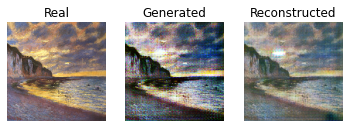

[INFO] Domain B to Domain A


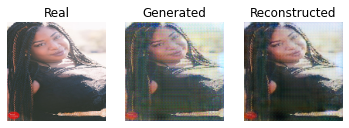

epoch: 67 step: 1 dA_loss: 0.020 dB_loss: 0.031 gAB_loss :4.352 gBA_loss: 4.390
epoch: 67 step: 2 dA_loss: 0.012 dB_loss: 0.038 gAB_loss :4.011 gBA_loss: 4.313
epoch: 67 step: 3 dA_loss: 0.018 dB_loss: 0.018 gAB_loss :3.861 gBA_loss: 4.013
epoch: 67 step: 4 dA_loss: 0.031 dB_loss: 0.019 gAB_loss :3.949 gBA_loss: 3.781
epoch: 67 step: 5 dA_loss: 0.030 dB_loss: 0.029 gAB_loss :4.221 gBA_loss: 4.154
epoch: 67 step: 6 dA_loss: 0.024 dB_loss: 0.013 gAB_loss :3.827 gBA_loss: 4.024
epoch: 67 step: 7 dA_loss: 0.012 dB_loss: 0.051 gAB_loss :3.397 gBA_loss: 3.659
epoch: 67 step: 8 dA_loss: 0.022 dB_loss: 0.069 gAB_loss :3.632 gBA_loss: 4.017
epoch: 67 step: 9 dA_loss: 0.012 dB_loss: 0.041 gAB_loss :3.781 gBA_loss: 3.755
epoch: 67 step: 10 dA_loss: 0.007 dB_loss: 0.080 gAB_loss :4.671 gBA_loss: 4.735
epoch: 67 step: 11 dA_loss: 0.008 dB_loss: 0.018 gAB_loss :4.249 gBA_loss: 4.161
epoch: 67 step: 12 dA_loss: 0.017 dB_loss: 0.028 gAB_loss :4.011 gBA_loss: 4.110
epoch: 67 step: 13 dA_loss: 0.004 dB_

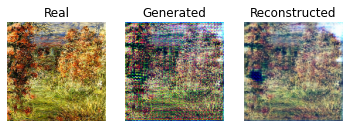

[INFO] Domain B to Domain A


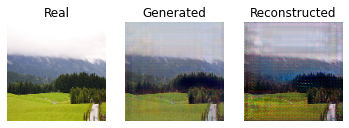

epoch: 67 step: 51 dA_loss: 0.008 dB_loss: 0.026 gAB_loss :4.416 gBA_loss: 4.433
epoch: 67 step: 52 dA_loss: 0.015 dB_loss: 0.044 gAB_loss :4.408 gBA_loss: 4.494
epoch: 67 step: 53 dA_loss: 0.014 dB_loss: 0.043 gAB_loss :4.105 gBA_loss: 4.283
epoch: 67 step: 54 dA_loss: 0.012 dB_loss: 0.056 gAB_loss :4.032 gBA_loss: 4.033
epoch: 67 step: 55 dA_loss: 0.014 dB_loss: 0.061 gAB_loss :4.256 gBA_loss: 4.182
epoch: 67 step: 56 dA_loss: 0.015 dB_loss: 0.100 gAB_loss :3.820 gBA_loss: 4.162
epoch: 67 step: 57 dA_loss: 0.043 dB_loss: 0.075 gAB_loss :3.820 gBA_loss: 4.190
epoch: 67 step: 58 dA_loss: 0.004 dB_loss: 0.027 gAB_loss :4.217 gBA_loss: 4.316
epoch: 67 step: 59 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :4.073 gBA_loss: 3.861
epoch: 67 step: 60 dA_loss: 0.020 dB_loss: 0.079 gAB_loss :4.003 gBA_loss: 3.818
epoch: 67 step: 61 dA_loss: 0.009 dB_loss: 0.032 gAB_loss :3.948 gBA_loss: 4.136
epoch: 67 step: 62 dA_loss: 0.017 dB_loss: 0.030 gAB_loss :3.742 gBA_loss: 3.820
epoch: 67 step: 63 dA_loss: 

 68%|██████▊   | 68/100 [1:52:00<52:23, 98.24s/it]

epoch: 67 step: 73 dA_loss: 0.015 dB_loss: 0.031 gAB_loss :4.406 gBA_loss: 4.753
epoch: 68 step: 0 dA_loss: 0.024 dB_loss: 0.029 gAB_loss :4.168 gBA_loss: 4.303
[INFO] Domain A to Domain B


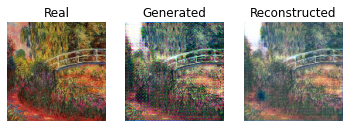

[INFO] Domain B to Domain A


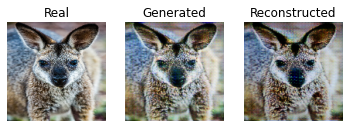

epoch: 68 step: 1 dA_loss: 0.004 dB_loss: 0.047 gAB_loss :4.402 gBA_loss: 4.200
epoch: 68 step: 2 dA_loss: 0.010 dB_loss: 0.040 gAB_loss :4.059 gBA_loss: 4.174
epoch: 68 step: 3 dA_loss: 0.009 dB_loss: 0.027 gAB_loss :3.801 gBA_loss: 3.981
epoch: 68 step: 4 dA_loss: 0.017 dB_loss: 0.014 gAB_loss :3.953 gBA_loss: 3.901
epoch: 68 step: 5 dA_loss: 0.008 dB_loss: 0.025 gAB_loss :4.226 gBA_loss: 4.053
epoch: 68 step: 6 dA_loss: 0.021 dB_loss: 0.016 gAB_loss :3.840 gBA_loss: 3.958
epoch: 68 step: 7 dA_loss: 0.006 dB_loss: 0.047 gAB_loss :3.363 gBA_loss: 3.550
epoch: 68 step: 8 dA_loss: 0.014 dB_loss: 0.059 gAB_loss :3.633 gBA_loss: 4.020
epoch: 68 step: 9 dA_loss: 0.012 dB_loss: 0.034 gAB_loss :3.766 gBA_loss: 3.783
epoch: 68 step: 10 dA_loss: 0.009 dB_loss: 0.054 gAB_loss :4.604 gBA_loss: 4.790
epoch: 68 step: 11 dA_loss: 0.007 dB_loss: 0.016 gAB_loss :4.212 gBA_loss: 4.156
epoch: 68 step: 12 dA_loss: 0.012 dB_loss: 0.024 gAB_loss :4.036 gBA_loss: 4.024
epoch: 68 step: 13 dA_loss: 0.010 dB_

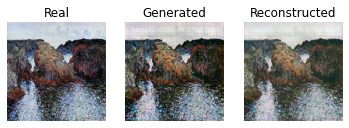

[INFO] Domain B to Domain A


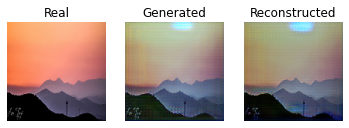

epoch: 68 step: 51 dA_loss: 0.015 dB_loss: 0.033 gAB_loss :4.429 gBA_loss: 4.385
epoch: 68 step: 52 dA_loss: 0.009 dB_loss: 0.043 gAB_loss :4.248 gBA_loss: 4.496
epoch: 68 step: 53 dA_loss: 0.010 dB_loss: 0.062 gAB_loss :3.911 gBA_loss: 4.189
epoch: 68 step: 54 dA_loss: 0.013 dB_loss: 0.080 gAB_loss :3.833 gBA_loss: 3.990
epoch: 68 step: 55 dA_loss: 0.019 dB_loss: 0.072 gAB_loss :4.172 gBA_loss: 4.306
epoch: 68 step: 56 dA_loss: 0.011 dB_loss: 0.050 gAB_loss :4.009 gBA_loss: 4.130
epoch: 68 step: 57 dA_loss: 0.023 dB_loss: 0.048 gAB_loss :3.840 gBA_loss: 4.063
epoch: 68 step: 58 dA_loss: 0.004 dB_loss: 0.027 gAB_loss :4.164 gBA_loss: 4.195
epoch: 68 step: 59 dA_loss: 0.004 dB_loss: 0.011 gAB_loss :3.984 gBA_loss: 3.784
epoch: 68 step: 60 dA_loss: 0.014 dB_loss: 0.050 gAB_loss :3.940 gBA_loss: 3.958
epoch: 68 step: 61 dA_loss: 0.021 dB_loss: 0.030 gAB_loss :3.922 gBA_loss: 4.169
epoch: 68 step: 62 dA_loss: 0.011 dB_loss: 0.010 gAB_loss :3.654 gBA_loss: 3.662
epoch: 68 step: 63 dA_loss: 

 69%|██████▉   | 69/100 [1:53:39<50:48, 98.33s/it]

epoch: 68 step: 73 dA_loss: 0.014 dB_loss: 0.058 gAB_loss :4.368 gBA_loss: 4.739
epoch: 69 step: 0 dA_loss: 0.017 dB_loss: 0.028 gAB_loss :4.194 gBA_loss: 4.296
[INFO] Domain A to Domain B


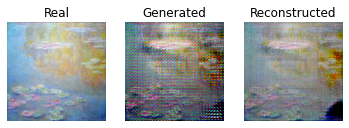

[INFO] Domain B to Domain A


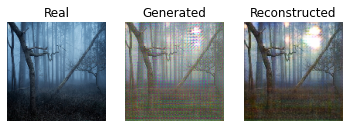

epoch: 69 step: 1 dA_loss: 0.007 dB_loss: 0.011 gAB_loss :4.214 gBA_loss: 4.195
epoch: 69 step: 2 dA_loss: 0.019 dB_loss: 0.017 gAB_loss :4.027 gBA_loss: 4.128
epoch: 69 step: 3 dA_loss: 0.009 dB_loss: 0.021 gAB_loss :3.891 gBA_loss: 3.866
epoch: 69 step: 4 dA_loss: 0.013 dB_loss: 0.013 gAB_loss :3.966 gBA_loss: 3.896
epoch: 69 step: 5 dA_loss: 0.018 dB_loss: 0.042 gAB_loss :4.152 gBA_loss: 4.158
epoch: 69 step: 6 dA_loss: 0.010 dB_loss: 0.011 gAB_loss :3.759 gBA_loss: 3.925
epoch: 69 step: 7 dA_loss: 0.008 dB_loss: 0.052 gAB_loss :3.397 gBA_loss: 3.512
epoch: 69 step: 8 dA_loss: 0.009 dB_loss: 0.044 gAB_loss :3.570 gBA_loss: 4.006
epoch: 69 step: 9 dA_loss: 0.009 dB_loss: 0.032 gAB_loss :3.727 gBA_loss: 3.767
epoch: 69 step: 10 dA_loss: 0.016 dB_loss: 0.043 gAB_loss :4.568 gBA_loss: 4.737
epoch: 69 step: 11 dA_loss: 0.010 dB_loss: 0.021 gAB_loss :4.172 gBA_loss: 4.124
epoch: 69 step: 12 dA_loss: 0.017 dB_loss: 0.027 gAB_loss :4.051 gBA_loss: 4.067
epoch: 69 step: 13 dA_loss: 0.005 dB_

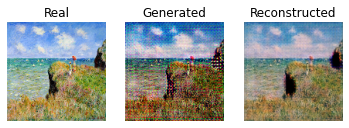

[INFO] Domain B to Domain A


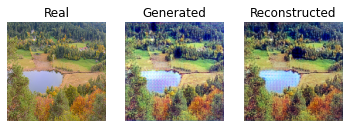

epoch: 69 step: 51 dA_loss: 0.034 dB_loss: 0.040 gAB_loss :4.428 gBA_loss: 4.345
epoch: 69 step: 52 dA_loss: 0.016 dB_loss: 0.017 gAB_loss :4.269 gBA_loss: 4.458
epoch: 69 step: 53 dA_loss: 0.016 dB_loss: 0.061 gAB_loss :4.149 gBA_loss: 4.204
epoch: 69 step: 54 dA_loss: 0.021 dB_loss: 0.044 gAB_loss :4.056 gBA_loss: 3.968
epoch: 69 step: 55 dA_loss: 0.112 dB_loss: 0.077 gAB_loss :4.005 gBA_loss: 4.366
epoch: 69 step: 56 dA_loss: 0.068 dB_loss: 0.153 gAB_loss :4.114 gBA_loss: 4.000
epoch: 69 step: 57 dA_loss: 0.073 dB_loss: 0.061 gAB_loss :3.729 gBA_loss: 4.043
epoch: 69 step: 58 dA_loss: 0.018 dB_loss: 0.061 gAB_loss :4.154 gBA_loss: 4.308
epoch: 69 step: 59 dA_loss: 0.014 dB_loss: 0.016 gAB_loss :3.992 gBA_loss: 3.850
epoch: 69 step: 60 dA_loss: 0.021 dB_loss: 0.075 gAB_loss :4.037 gBA_loss: 3.808
epoch: 69 step: 61 dA_loss: 0.016 dB_loss: 0.043 gAB_loss :3.909 gBA_loss: 4.021
epoch: 69 step: 62 dA_loss: 0.017 dB_loss: 0.011 gAB_loss :3.668 gBA_loss: 3.610
epoch: 69 step: 63 dA_loss: 

 70%|███████   | 70/100 [1:55:17<49:08, 98.28s/it]

epoch: 69 step: 73 dA_loss: 0.039 dB_loss: 0.021 gAB_loss :4.409 gBA_loss: 4.826
epoch: 70 step: 0 dA_loss: 0.018 dB_loss: 0.031 gAB_loss :4.185 gBA_loss: 4.297
[INFO] Domain A to Domain B


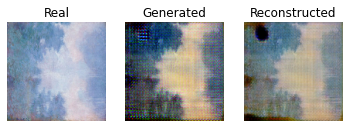

[INFO] Domain B to Domain A


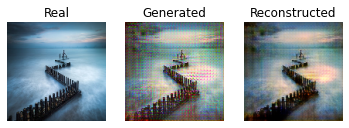

epoch: 70 step: 1 dA_loss: 0.010 dB_loss: 0.029 gAB_loss :4.262 gBA_loss: 4.193
epoch: 70 step: 2 dA_loss: 0.043 dB_loss: 0.031 gAB_loss :4.092 gBA_loss: 4.025
epoch: 70 step: 3 dA_loss: 0.009 dB_loss: 0.021 gAB_loss :3.791 gBA_loss: 3.713
epoch: 70 step: 4 dA_loss: 0.070 dB_loss: 0.008 gAB_loss :3.870 gBA_loss: 3.869
epoch: 70 step: 5 dA_loss: 0.017 dB_loss: 0.045 gAB_loss :4.196 gBA_loss: 4.020
epoch: 70 step: 6 dA_loss: 0.026 dB_loss: 0.014 gAB_loss :3.752 gBA_loss: 3.913
epoch: 70 step: 7 dA_loss: 0.009 dB_loss: 0.039 gAB_loss :3.301 gBA_loss: 3.555
epoch: 70 step: 8 dA_loss: 0.017 dB_loss: 0.063 gAB_loss :3.594 gBA_loss: 3.976
epoch: 70 step: 9 dA_loss: 0.013 dB_loss: 0.031 gAB_loss :3.748 gBA_loss: 3.745
epoch: 70 step: 10 dA_loss: 0.021 dB_loss: 0.058 gAB_loss :4.606 gBA_loss: 4.804
epoch: 70 step: 11 dA_loss: 0.010 dB_loss: 0.033 gAB_loss :4.146 gBA_loss: 4.113
epoch: 70 step: 12 dA_loss: 0.011 dB_loss: 0.027 gAB_loss :4.016 gBA_loss: 4.007
epoch: 70 step: 13 dA_loss: 0.020 dB_

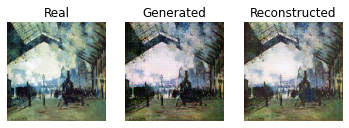

[INFO] Domain B to Domain A


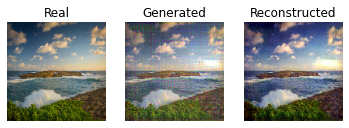

epoch: 70 step: 51 dA_loss: 0.014 dB_loss: 0.043 gAB_loss :4.565 gBA_loss: 4.326
epoch: 70 step: 52 dA_loss: 0.019 dB_loss: 0.051 gAB_loss :4.260 gBA_loss: 4.448
epoch: 70 step: 53 dA_loss: 0.009 dB_loss: 0.026 gAB_loss :4.041 gBA_loss: 4.210
epoch: 70 step: 54 dA_loss: 0.023 dB_loss: 0.043 gAB_loss :3.962 gBA_loss: 4.006
epoch: 70 step: 55 dA_loss: 0.011 dB_loss: 0.069 gAB_loss :4.056 gBA_loss: 4.148
epoch: 70 step: 56 dA_loss: 0.011 dB_loss: 0.050 gAB_loss :3.840 gBA_loss: 4.008
epoch: 70 step: 57 dA_loss: 0.022 dB_loss: 0.111 gAB_loss :3.964 gBA_loss: 4.016
epoch: 70 step: 58 dA_loss: 0.004 dB_loss: 0.049 gAB_loss :4.082 gBA_loss: 4.171
epoch: 70 step: 59 dA_loss: 0.006 dB_loss: 0.032 gAB_loss :3.808 gBA_loss: 3.693
epoch: 70 step: 60 dA_loss: 0.010 dB_loss: 0.070 gAB_loss :3.975 gBA_loss: 3.846
epoch: 70 step: 61 dA_loss: 0.009 dB_loss: 0.031 gAB_loss :3.866 gBA_loss: 4.103
epoch: 70 step: 62 dA_loss: 0.007 dB_loss: 0.009 gAB_loss :3.638 gBA_loss: 3.644
epoch: 70 step: 63 dA_loss: 

 71%|███████   | 71/100 [1:56:55<47:28, 98.23s/it]

epoch: 70 step: 73 dA_loss: 0.019 dB_loss: 0.034 gAB_loss :4.410 gBA_loss: 4.669
epoch: 71 step: 0 dA_loss: 0.009 dB_loss: 0.021 gAB_loss :4.096 gBA_loss: 4.296
[INFO] Domain A to Domain B


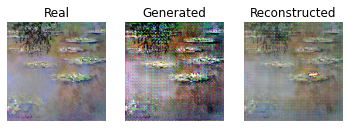

[INFO] Domain B to Domain A


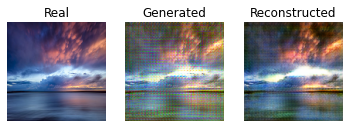

epoch: 71 step: 1 dA_loss: 0.009 dB_loss: 0.032 gAB_loss :4.224 gBA_loss: 4.218
epoch: 71 step: 2 dA_loss: 0.012 dB_loss: 0.034 gAB_loss :3.901 gBA_loss: 4.169
epoch: 71 step: 3 dA_loss: 0.018 dB_loss: 0.017 gAB_loss :3.799 gBA_loss: 3.744
epoch: 71 step: 4 dA_loss: 0.047 dB_loss: 0.008 gAB_loss :3.999 gBA_loss: 3.976
epoch: 71 step: 5 dA_loss: 0.022 dB_loss: 0.021 gAB_loss :4.219 gBA_loss: 4.113
epoch: 71 step: 6 dA_loss: 0.008 dB_loss: 0.011 gAB_loss :3.832 gBA_loss: 4.045
epoch: 71 step: 7 dA_loss: 0.008 dB_loss: 0.049 gAB_loss :3.510 gBA_loss: 3.553
epoch: 71 step: 8 dA_loss: 0.033 dB_loss: 0.038 gAB_loss :3.653 gBA_loss: 4.154
epoch: 71 step: 9 dA_loss: 0.026 dB_loss: 0.024 gAB_loss :3.748 gBA_loss: 3.864
epoch: 71 step: 10 dA_loss: 0.056 dB_loss: 0.037 gAB_loss :4.603 gBA_loss: 4.673
epoch: 71 step: 11 dA_loss: 0.058 dB_loss: 0.018 gAB_loss :4.148 gBA_loss: 4.173
epoch: 71 step: 12 dA_loss: 0.013 dB_loss: 0.017 gAB_loss :4.030 gBA_loss: 4.044
epoch: 71 step: 13 dA_loss: 0.044 dB_

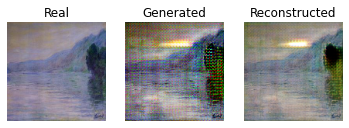

[INFO] Domain B to Domain A


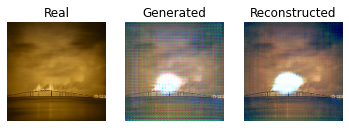

epoch: 71 step: 51 dA_loss: 0.047 dB_loss: 0.031 gAB_loss :4.541 gBA_loss: 4.187
epoch: 71 step: 52 dA_loss: 0.041 dB_loss: 0.059 gAB_loss :4.233 gBA_loss: 4.447
epoch: 71 step: 53 dA_loss: 0.018 dB_loss: 0.090 gAB_loss :3.877 gBA_loss: 4.232
epoch: 71 step: 54 dA_loss: 0.032 dB_loss: 0.064 gAB_loss :3.997 gBA_loss: 4.056
epoch: 71 step: 55 dA_loss: 0.012 dB_loss: 0.062 gAB_loss :4.074 gBA_loss: 4.079
epoch: 71 step: 56 dA_loss: 0.018 dB_loss: 0.066 gAB_loss :3.818 gBA_loss: 3.922
epoch: 71 step: 57 dA_loss: 0.026 dB_loss: 0.060 gAB_loss :3.757 gBA_loss: 4.005
epoch: 71 step: 58 dA_loss: 0.024 dB_loss: 0.020 gAB_loss :4.134 gBA_loss: 4.094
epoch: 71 step: 59 dA_loss: 0.012 dB_loss: 0.012 gAB_loss :3.998 gBA_loss: 3.668
epoch: 71 step: 60 dA_loss: 0.026 dB_loss: 0.048 gAB_loss :4.181 gBA_loss: 4.005
epoch: 71 step: 61 dA_loss: 0.012 dB_loss: 0.040 gAB_loss :3.950 gBA_loss: 4.081
epoch: 71 step: 62 dA_loss: 0.052 dB_loss: 0.009 gAB_loss :3.586 gBA_loss: 3.389
epoch: 71 step: 63 dA_loss: 

 72%|███████▏  | 72/100 [1:58:33<45:50, 98.24s/it]

epoch: 71 step: 73 dA_loss: 0.032 dB_loss: 0.019 gAB_loss :4.378 gBA_loss: 4.598
epoch: 72 step: 0 dA_loss: 0.021 dB_loss: 0.022 gAB_loss :4.120 gBA_loss: 4.351
[INFO] Domain A to Domain B


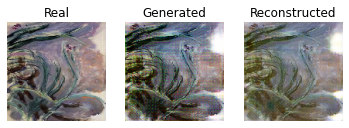

[INFO] Domain B to Domain A


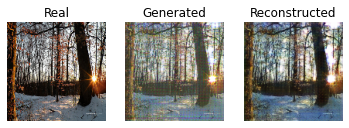

epoch: 72 step: 1 dA_loss: 0.012 dB_loss: 0.046 gAB_loss :4.338 gBA_loss: 4.291
epoch: 72 step: 2 dA_loss: 0.021 dB_loss: 0.050 gAB_loss :4.010 gBA_loss: 4.082
epoch: 72 step: 3 dA_loss: 0.022 dB_loss: 0.014 gAB_loss :3.697 gBA_loss: 3.583
epoch: 72 step: 4 dA_loss: 0.092 dB_loss: 0.040 gAB_loss :3.983 gBA_loss: 4.056
epoch: 72 step: 5 dA_loss: 0.068 dB_loss: 0.031 gAB_loss :4.119 gBA_loss: 3.917
epoch: 72 step: 6 dA_loss: 0.067 dB_loss: 0.103 gAB_loss :4.035 gBA_loss: 3.791
epoch: 72 step: 7 dA_loss: 0.048 dB_loss: 0.171 gAB_loss :3.230 gBA_loss: 3.276
epoch: 72 step: 8 dA_loss: 0.060 dB_loss: 0.071 gAB_loss :3.215 gBA_loss: 4.004
epoch: 72 step: 9 dA_loss: 0.031 dB_loss: 0.111 gAB_loss :3.693 gBA_loss: 3.745
epoch: 72 step: 10 dA_loss: 0.067 dB_loss: 0.043 gAB_loss :4.585 gBA_loss: 4.706
epoch: 72 step: 11 dA_loss: 0.017 dB_loss: 0.017 gAB_loss :4.125 gBA_loss: 4.015
epoch: 72 step: 12 dA_loss: 0.013 dB_loss: 0.038 gAB_loss :4.122 gBA_loss: 3.987
epoch: 72 step: 13 dA_loss: 0.012 dB_

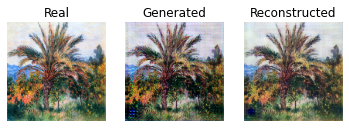

[INFO] Domain B to Domain A


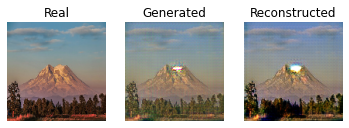

epoch: 72 step: 51 dA_loss: 0.017 dB_loss: 0.059 gAB_loss :4.386 gBA_loss: 4.390
epoch: 72 step: 52 dA_loss: 0.035 dB_loss: 0.066 gAB_loss :4.202 gBA_loss: 4.316
epoch: 72 step: 53 dA_loss: 0.010 dB_loss: 0.019 gAB_loss :4.088 gBA_loss: 4.052
epoch: 72 step: 54 dA_loss: 0.008 dB_loss: 0.119 gAB_loss :3.930 gBA_loss: 4.009
epoch: 72 step: 55 dA_loss: 0.113 dB_loss: 0.077 gAB_loss :4.020 gBA_loss: 4.397
epoch: 72 step: 56 dA_loss: 0.048 dB_loss: 0.081 gAB_loss :4.002 gBA_loss: 4.221
epoch: 72 step: 57 dA_loss: 0.057 dB_loss: 0.061 gAB_loss :3.788 gBA_loss: 3.938
epoch: 72 step: 58 dA_loss: 0.026 dB_loss: 0.020 gAB_loss :4.060 gBA_loss: 4.260
epoch: 72 step: 59 dA_loss: 0.044 dB_loss: 0.014 gAB_loss :3.897 gBA_loss: 3.867
epoch: 72 step: 60 dA_loss: 0.027 dB_loss: 0.054 gAB_loss :4.043 gBA_loss: 3.813
epoch: 72 step: 61 dA_loss: 0.020 dB_loss: 0.027 gAB_loss :3.911 gBA_loss: 4.017
epoch: 72 step: 62 dA_loss: 0.011 dB_loss: 0.014 gAB_loss :3.617 gBA_loss: 3.537
epoch: 72 step: 63 dA_loss: 

 73%|███████▎  | 73/100 [2:00:11<44:12, 98.22s/it]

epoch: 72 step: 73 dA_loss: 0.015 dB_loss: 0.035 gAB_loss :4.365 gBA_loss: 4.619
epoch: 73 step: 0 dA_loss: 0.012 dB_loss: 0.053 gAB_loss :3.978 gBA_loss: 4.233
[INFO] Domain A to Domain B


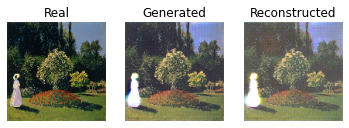

[INFO] Domain B to Domain A


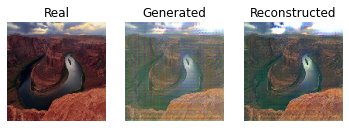

epoch: 73 step: 1 dA_loss: 0.012 dB_loss: 0.026 gAB_loss :3.969 gBA_loss: 4.144
epoch: 73 step: 2 dA_loss: 0.018 dB_loss: 0.113 gAB_loss :4.079 gBA_loss: 4.086
epoch: 73 step: 3 dA_loss: 0.022 dB_loss: 0.076 gAB_loss :3.669 gBA_loss: 3.884
epoch: 73 step: 4 dA_loss: 0.072 dB_loss: 0.017 gAB_loss :3.748 gBA_loss: 3.739
epoch: 73 step: 5 dA_loss: 0.045 dB_loss: 0.096 gAB_loss :3.986 gBA_loss: 3.859
epoch: 73 step: 6 dA_loss: 0.057 dB_loss: 0.026 gAB_loss :3.747 gBA_loss: 4.016
epoch: 73 step: 7 dA_loss: 0.073 dB_loss: 0.062 gAB_loss :3.462 gBA_loss: 3.390
epoch: 73 step: 8 dA_loss: 0.020 dB_loss: 0.069 gAB_loss :3.560 gBA_loss: 3.684
epoch: 73 step: 9 dA_loss: 0.122 dB_loss: 0.049 gAB_loss :3.807 gBA_loss: 3.882
epoch: 73 step: 10 dA_loss: 0.057 dB_loss: 0.042 gAB_loss :4.651 gBA_loss: 4.854
epoch: 73 step: 11 dA_loss: 0.016 dB_loss: 0.046 gAB_loss :4.092 gBA_loss: 4.115
epoch: 73 step: 12 dA_loss: 0.038 dB_loss: 0.035 gAB_loss :4.091 gBA_loss: 3.924
epoch: 73 step: 13 dA_loss: 0.051 dB_

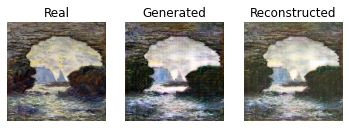

[INFO] Domain B to Domain A


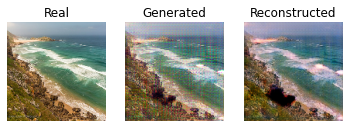

epoch: 73 step: 51 dA_loss: 0.026 dB_loss: 0.027 gAB_loss :4.462 gBA_loss: 4.345
epoch: 73 step: 52 dA_loss: 0.014 dB_loss: 0.040 gAB_loss :4.285 gBA_loss: 4.378
epoch: 73 step: 53 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :4.144 gBA_loss: 4.127
epoch: 73 step: 54 dA_loss: 0.015 dB_loss: 0.094 gAB_loss :3.996 gBA_loss: 3.947
epoch: 73 step: 55 dA_loss: 0.049 dB_loss: 0.071 gAB_loss :3.920 gBA_loss: 3.961
epoch: 73 step: 56 dA_loss: 0.030 dB_loss: 0.063 gAB_loss :3.785 gBA_loss: 4.000
epoch: 73 step: 57 dA_loss: 0.023 dB_loss: 0.048 gAB_loss :3.636 gBA_loss: 4.082
epoch: 73 step: 58 dA_loss: 0.029 dB_loss: 0.024 gAB_loss :4.057 gBA_loss: 4.088
epoch: 73 step: 59 dA_loss: 0.039 dB_loss: 0.012 gAB_loss :3.963 gBA_loss: 3.711
epoch: 73 step: 60 dA_loss: 0.034 dB_loss: 0.024 gAB_loss :4.158 gBA_loss: 3.912
epoch: 73 step: 61 dA_loss: 0.015 dB_loss: 0.024 gAB_loss :3.950 gBA_loss: 4.061
epoch: 73 step: 62 dA_loss: 0.086 dB_loss: 0.013 gAB_loss :3.610 gBA_loss: 3.415
epoch: 73 step: 63 dA_loss: 

 74%|███████▍  | 74/100 [2:01:50<42:33, 98.22s/it]

epoch: 73 step: 73 dA_loss: 0.013 dB_loss: 0.024 gAB_loss :4.372 gBA_loss: 4.469
epoch: 74 step: 0 dA_loss: 0.020 dB_loss: 0.023 gAB_loss :4.076 gBA_loss: 4.238
[INFO] Domain A to Domain B


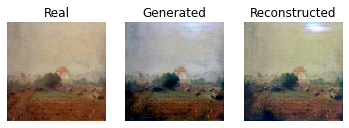

[INFO] Domain B to Domain A


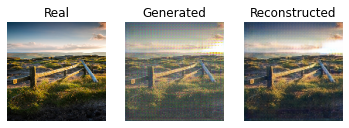

epoch: 74 step: 1 dA_loss: 0.013 dB_loss: 0.023 gAB_loss :4.054 gBA_loss: 4.140
epoch: 74 step: 2 dA_loss: 0.028 dB_loss: 0.041 gAB_loss :3.870 gBA_loss: 4.073
epoch: 74 step: 3 dA_loss: 0.020 dB_loss: 0.064 gAB_loss :3.736 gBA_loss: 3.684
epoch: 74 step: 4 dA_loss: 0.029 dB_loss: 0.006 gAB_loss :3.852 gBA_loss: 3.660
epoch: 74 step: 5 dA_loss: 0.022 dB_loss: 0.051 gAB_loss :4.078 gBA_loss: 3.865
epoch: 74 step: 6 dA_loss: 0.024 dB_loss: 0.014 gAB_loss :3.737 gBA_loss: 3.921
epoch: 74 step: 7 dA_loss: 0.037 dB_loss: 0.048 gAB_loss :3.413 gBA_loss: 3.436
epoch: 74 step: 8 dA_loss: 0.040 dB_loss: 0.039 gAB_loss :3.575 gBA_loss: 4.067
epoch: 74 step: 9 dA_loss: 0.018 dB_loss: 0.030 gAB_loss :3.708 gBA_loss: 3.766
epoch: 74 step: 10 dA_loss: 0.040 dB_loss: 0.039 gAB_loss :4.607 gBA_loss: 4.698
epoch: 74 step: 11 dA_loss: 0.008 dB_loss: 0.035 gAB_loss :4.158 gBA_loss: 3.975
epoch: 74 step: 12 dA_loss: 0.012 dB_loss: 0.028 gAB_loss :3.980 gBA_loss: 4.011
epoch: 74 step: 13 dA_loss: 0.009 dB_

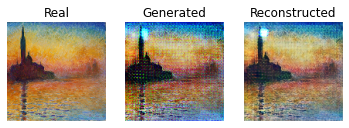

[INFO] Domain B to Domain A


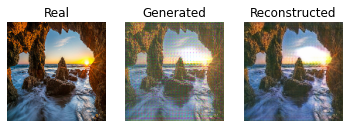

epoch: 74 step: 51 dA_loss: 0.072 dB_loss: 0.048 gAB_loss :4.447 gBA_loss: 4.191
epoch: 74 step: 52 dA_loss: 0.050 dB_loss: 0.020 gAB_loss :4.180 gBA_loss: 4.334
epoch: 74 step: 53 dA_loss: 0.061 dB_loss: 0.015 gAB_loss :4.113 gBA_loss: 4.172
epoch: 74 step: 54 dA_loss: 0.048 dB_loss: 0.071 gAB_loss :3.960 gBA_loss: 3.971
epoch: 74 step: 55 dA_loss: 0.094 dB_loss: 0.060 gAB_loss :3.968 gBA_loss: 3.925
epoch: 74 step: 56 dA_loss: 0.084 dB_loss: 0.075 gAB_loss :3.944 gBA_loss: 3.783
epoch: 74 step: 57 dA_loss: 0.041 dB_loss: 0.042 gAB_loss :3.737 gBA_loss: 3.816
epoch: 74 step: 58 dA_loss: 0.036 dB_loss: 0.021 gAB_loss :3.942 gBA_loss: 4.082
epoch: 74 step: 59 dA_loss: 0.034 dB_loss: 0.027 gAB_loss :3.894 gBA_loss: 3.651
epoch: 74 step: 60 dA_loss: 0.029 dB_loss: 0.036 gAB_loss :4.138 gBA_loss: 3.745
epoch: 74 step: 61 dA_loss: 0.019 dB_loss: 0.018 gAB_loss :3.982 gBA_loss: 3.938
epoch: 74 step: 62 dA_loss: 0.043 dB_loss: 0.020 gAB_loss :3.447 gBA_loss: 3.414
epoch: 74 step: 63 dA_loss: 

 75%|███████▌  | 75/100 [2:03:28<40:54, 98.20s/it]

epoch: 74 step: 73 dA_loss: 0.018 dB_loss: 0.016 gAB_loss :4.449 gBA_loss: 4.498
epoch: 75 step: 0 dA_loss: 0.026 dB_loss: 0.032 gAB_loss :4.090 gBA_loss: 4.275
[INFO] Domain A to Domain B


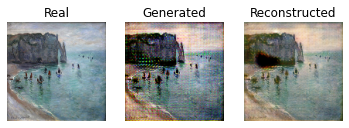

[INFO] Domain B to Domain A


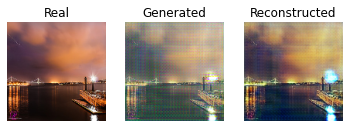

epoch: 75 step: 1 dA_loss: 0.016 dB_loss: 0.024 gAB_loss :4.111 gBA_loss: 4.095
epoch: 75 step: 2 dA_loss: 0.012 dB_loss: 0.054 gAB_loss :3.841 gBA_loss: 4.068
epoch: 75 step: 3 dA_loss: 0.028 dB_loss: 0.060 gAB_loss :3.811 gBA_loss: 3.621
epoch: 75 step: 4 dA_loss: 0.049 dB_loss: 0.009 gAB_loss :3.843 gBA_loss: 3.747
epoch: 75 step: 5 dA_loss: 0.042 dB_loss: 0.057 gAB_loss :3.987 gBA_loss: 3.797
epoch: 75 step: 6 dA_loss: 0.093 dB_loss: 0.028 gAB_loss :3.790 gBA_loss: 3.992
epoch: 75 step: 7 dA_loss: 0.046 dB_loss: 0.050 gAB_loss :3.395 gBA_loss: 3.354
epoch: 75 step: 8 dA_loss: 0.044 dB_loss: 0.068 gAB_loss :3.694 gBA_loss: 3.938
epoch: 75 step: 9 dA_loss: 0.035 dB_loss: 0.030 gAB_loss :3.780 gBA_loss: 3.816
epoch: 75 step: 10 dA_loss: 0.043 dB_loss: 0.054 gAB_loss :4.582 gBA_loss: 4.753
epoch: 75 step: 11 dA_loss: 0.010 dB_loss: 0.037 gAB_loss :3.944 gBA_loss: 4.011
epoch: 75 step: 12 dA_loss: 0.037 dB_loss: 0.078 gAB_loss :4.178 gBA_loss: 3.940
epoch: 75 step: 13 dA_loss: 0.029 dB_

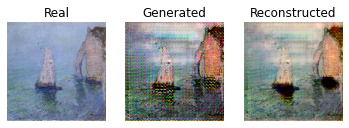

[INFO] Domain B to Domain A


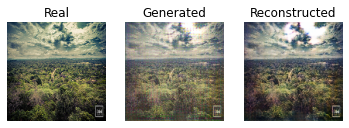

epoch: 75 step: 51 dA_loss: 0.021 dB_loss: 0.058 gAB_loss :4.361 gBA_loss: 4.278
epoch: 75 step: 52 dA_loss: 0.024 dB_loss: 0.062 gAB_loss :3.979 gBA_loss: 4.350
epoch: 75 step: 53 dA_loss: 0.005 dB_loss: 0.050 gAB_loss :3.952 gBA_loss: 4.131
epoch: 75 step: 54 dA_loss: 0.012 dB_loss: 0.081 gAB_loss :3.995 gBA_loss: 3.953
epoch: 75 step: 55 dA_loss: 0.024 dB_loss: 0.090 gAB_loss :4.225 gBA_loss: 4.041
epoch: 75 step: 56 dA_loss: 0.015 dB_loss: 0.079 gAB_loss :4.179 gBA_loss: 4.309
epoch: 75 step: 57 dA_loss: 0.006 dB_loss: 0.045 gAB_loss :3.783 gBA_loss: 4.137
epoch: 75 step: 58 dA_loss: 0.023 dB_loss: 0.030 gAB_loss :3.928 gBA_loss: 4.194
epoch: 75 step: 59 dA_loss: 0.020 dB_loss: 0.029 gAB_loss :3.790 gBA_loss: 3.761
epoch: 75 step: 60 dA_loss: 0.008 dB_loss: 0.040 gAB_loss :4.134 gBA_loss: 3.914
epoch: 75 step: 61 dA_loss: 0.007 dB_loss: 0.035 gAB_loss :4.044 gBA_loss: 4.122
epoch: 75 step: 62 dA_loss: 0.018 dB_loss: 0.014 gAB_loss :3.775 gBA_loss: 3.639
epoch: 75 step: 63 dA_loss: 

 76%|███████▌  | 76/100 [2:05:06<39:16, 98.17s/it]

epoch: 75 step: 73 dA_loss: 0.012 dB_loss: 0.037 gAB_loss :4.454 gBA_loss: 4.516
epoch: 76 step: 0 dA_loss: 0.011 dB_loss: 0.024 gAB_loss :4.124 gBA_loss: 4.195
[INFO] Domain A to Domain B


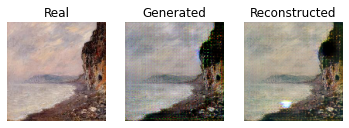

[INFO] Domain B to Domain A


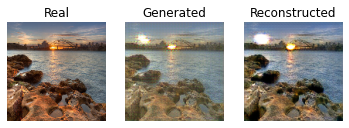

epoch: 76 step: 1 dA_loss: 0.009 dB_loss: 0.023 gAB_loss :4.102 gBA_loss: 4.077
epoch: 76 step: 2 dA_loss: 0.009 dB_loss: 0.034 gAB_loss :3.867 gBA_loss: 4.162
epoch: 76 step: 3 dA_loss: 0.019 dB_loss: 0.034 gAB_loss :3.566 gBA_loss: 3.798
epoch: 76 step: 4 dA_loss: 0.024 dB_loss: 0.031 gAB_loss :3.929 gBA_loss: 3.761
epoch: 76 step: 5 dA_loss: 0.017 dB_loss: 0.030 gAB_loss :4.247 gBA_loss: 3.855
epoch: 76 step: 6 dA_loss: 0.049 dB_loss: 0.012 gAB_loss :3.874 gBA_loss: 3.888
epoch: 76 step: 7 dA_loss: 0.020 dB_loss: 0.084 gAB_loss :3.220 gBA_loss: 3.577
epoch: 76 step: 8 dA_loss: 0.013 dB_loss: 0.048 gAB_loss :3.401 gBA_loss: 3.856
epoch: 76 step: 9 dA_loss: 0.015 dB_loss: 0.028 gAB_loss :3.665 gBA_loss: 3.653
epoch: 76 step: 10 dA_loss: 0.008 dB_loss: 0.043 gAB_loss :4.705 gBA_loss: 4.782
epoch: 76 step: 11 dA_loss: 0.005 dB_loss: 0.023 gAB_loss :4.151 gBA_loss: 4.037
epoch: 76 step: 12 dA_loss: 0.015 dB_loss: 0.018 gAB_loss :3.956 gBA_loss: 3.966
epoch: 76 step: 13 dA_loss: 0.013 dB_

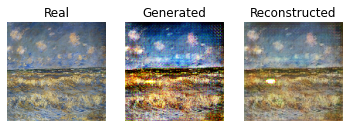

[INFO] Domain B to Domain A


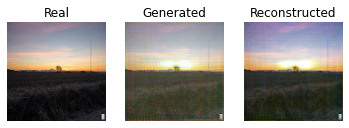

epoch: 76 step: 51 dA_loss: 0.025 dB_loss: 0.025 gAB_loss :4.358 gBA_loss: 4.310
epoch: 76 step: 52 dA_loss: 0.018 dB_loss: 0.047 gAB_loss :4.241 gBA_loss: 4.305
epoch: 76 step: 53 dA_loss: 0.006 dB_loss: 0.016 gAB_loss :4.160 gBA_loss: 4.118
epoch: 76 step: 54 dA_loss: 0.008 dB_loss: 0.076 gAB_loss :4.003 gBA_loss: 4.022
epoch: 76 step: 55 dA_loss: 0.019 dB_loss: 0.059 gAB_loss :3.933 gBA_loss: 4.042
epoch: 76 step: 56 dA_loss: 0.010 dB_loss: 0.041 gAB_loss :3.863 gBA_loss: 3.997
epoch: 76 step: 57 dA_loss: 0.021 dB_loss: 0.030 gAB_loss :3.702 gBA_loss: 4.040
epoch: 76 step: 58 dA_loss: 0.042 dB_loss: 0.022 gAB_loss :3.977 gBA_loss: 4.047
epoch: 76 step: 59 dA_loss: 0.022 dB_loss: 0.013 gAB_loss :3.820 gBA_loss: 3.672
epoch: 76 step: 60 dA_loss: 0.024 dB_loss: 0.032 gAB_loss :4.199 gBA_loss: 3.797
epoch: 76 step: 61 dA_loss: 0.020 dB_loss: 0.016 gAB_loss :4.051 gBA_loss: 4.068
epoch: 76 step: 62 dA_loss: 0.036 dB_loss: 0.043 gAB_loss :3.347 gBA_loss: 3.333
epoch: 76 step: 63 dA_loss: 

 77%|███████▋  | 77/100 [2:06:44<37:38, 98.18s/it]

epoch: 76 step: 73 dA_loss: 0.014 dB_loss: 0.017 gAB_loss :4.394 gBA_loss: 4.414
epoch: 77 step: 0 dA_loss: 0.043 dB_loss: 0.022 gAB_loss :4.122 gBA_loss: 4.315
[INFO] Domain A to Domain B


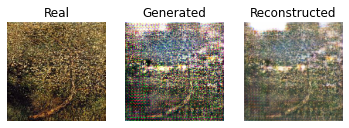

[INFO] Domain B to Domain A


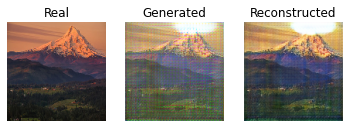

epoch: 77 step: 1 dA_loss: 0.015 dB_loss: 0.026 gAB_loss :4.185 gBA_loss: 4.113
epoch: 77 step: 2 dA_loss: 0.009 dB_loss: 0.041 gAB_loss :4.044 gBA_loss: 4.073
epoch: 77 step: 3 dA_loss: 0.024 dB_loss: 0.037 gAB_loss :3.629 gBA_loss: 3.665
epoch: 77 step: 4 dA_loss: 0.020 dB_loss: 0.027 gAB_loss :3.889 gBA_loss: 3.741
epoch: 77 step: 5 dA_loss: 0.034 dB_loss: 0.035 gAB_loss :4.152 gBA_loss: 3.940
epoch: 77 step: 6 dA_loss: 0.008 dB_loss: 0.012 gAB_loss :3.862 gBA_loss: 3.749
epoch: 77 step: 7 dA_loss: 0.028 dB_loss: 0.062 gAB_loss :3.283 gBA_loss: 3.362
epoch: 77 step: 8 dA_loss: 0.035 dB_loss: 0.044 gAB_loss :3.568 gBA_loss: 4.057
epoch: 77 step: 9 dA_loss: 0.023 dB_loss: 0.013 gAB_loss :3.679 gBA_loss: 3.832
epoch: 77 step: 10 dA_loss: 0.013 dB_loss: 0.022 gAB_loss :4.611 gBA_loss: 4.783
epoch: 77 step: 11 dA_loss: 0.005 dB_loss: 0.031 gAB_loss :4.100 gBA_loss: 3.958
epoch: 77 step: 12 dA_loss: 0.011 dB_loss: 0.015 gAB_loss :3.998 gBA_loss: 3.948
epoch: 77 step: 13 dA_loss: 0.021 dB_

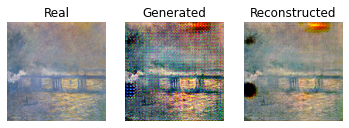

[INFO] Domain B to Domain A


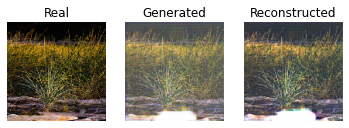

epoch: 77 step: 51 dA_loss: 0.050 dB_loss: 0.022 gAB_loss :4.257 gBA_loss: 4.275
epoch: 77 step: 52 dA_loss: 0.046 dB_loss: 0.015 gAB_loss :3.972 gBA_loss: 4.186
epoch: 77 step: 53 dA_loss: 0.017 dB_loss: 0.030 gAB_loss :4.128 gBA_loss: 4.041
epoch: 77 step: 54 dA_loss: 0.007 dB_loss: 0.060 gAB_loss :4.066 gBA_loss: 3.969
epoch: 77 step: 55 dA_loss: 0.031 dB_loss: 0.057 gAB_loss :3.968 gBA_loss: 3.974
epoch: 77 step: 56 dA_loss: 0.085 dB_loss: 0.048 gAB_loss :3.833 gBA_loss: 4.173
epoch: 77 step: 57 dA_loss: 0.041 dB_loss: 0.040 gAB_loss :3.725 gBA_loss: 3.990
epoch: 77 step: 58 dA_loss: 0.059 dB_loss: 0.015 gAB_loss :4.040 gBA_loss: 3.946
epoch: 77 step: 59 dA_loss: 0.036 dB_loss: 0.014 gAB_loss :3.805 gBA_loss: 3.605
epoch: 77 step: 60 dA_loss: 0.046 dB_loss: 0.018 gAB_loss :4.042 gBA_loss: 3.693
epoch: 77 step: 61 dA_loss: 0.052 dB_loss: 0.015 gAB_loss :4.006 gBA_loss: 4.065
epoch: 77 step: 62 dA_loss: 0.044 dB_loss: 0.018 gAB_loss :3.581 gBA_loss: 3.494
epoch: 77 step: 63 dA_loss: 

 78%|███████▊  | 78/100 [2:08:22<36:00, 98.20s/it]

epoch: 77 step: 73 dA_loss: 0.038 dB_loss: 0.026 gAB_loss :4.442 gBA_loss: 4.433
epoch: 78 step: 0 dA_loss: 0.057 dB_loss: 0.023 gAB_loss :4.041 gBA_loss: 4.259
[INFO] Domain A to Domain B


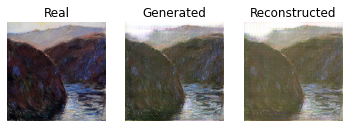

[INFO] Domain B to Domain A


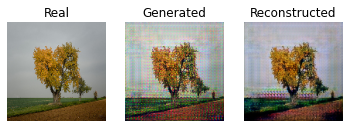

epoch: 78 step: 1 dA_loss: 0.015 dB_loss: 0.043 gAB_loss :4.019 gBA_loss: 4.111
epoch: 78 step: 2 dA_loss: 0.007 dB_loss: 0.032 gAB_loss :3.885 gBA_loss: 4.041
epoch: 78 step: 3 dA_loss: 0.052 dB_loss: 0.038 gAB_loss :3.749 gBA_loss: 3.634
epoch: 78 step: 4 dA_loss: 0.030 dB_loss: 0.007 gAB_loss :3.847 gBA_loss: 3.724
epoch: 78 step: 5 dA_loss: 0.023 dB_loss: 0.022 gAB_loss :4.205 gBA_loss: 3.923
epoch: 78 step: 6 dA_loss: 0.016 dB_loss: 0.017 gAB_loss :3.894 gBA_loss: 3.807
epoch: 78 step: 7 dA_loss: 0.041 dB_loss: 0.074 gAB_loss :3.339 gBA_loss: 3.333
epoch: 78 step: 8 dA_loss: 0.129 dB_loss: 0.036 gAB_loss :3.476 gBA_loss: 4.086
epoch: 78 step: 9 dA_loss: 0.056 dB_loss: 0.022 gAB_loss :3.711 gBA_loss: 3.703
epoch: 78 step: 10 dA_loss: 0.028 dB_loss: 0.025 gAB_loss :4.646 gBA_loss: 4.722
epoch: 78 step: 11 dA_loss: 0.048 dB_loss: 0.018 gAB_loss :4.109 gBA_loss: 4.024
epoch: 78 step: 12 dA_loss: 0.067 dB_loss: 0.011 gAB_loss :3.979 gBA_loss: 3.981
epoch: 78 step: 13 dA_loss: 0.008 dB_

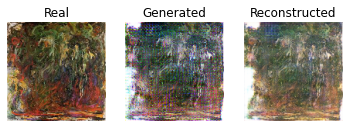

[INFO] Domain B to Domain A


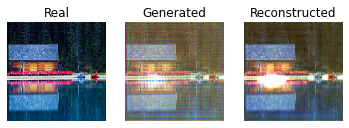

epoch: 78 step: 51 dA_loss: 0.019 dB_loss: 0.028 gAB_loss :4.416 gBA_loss: 4.296
epoch: 78 step: 52 dA_loss: 0.034 dB_loss: 0.036 gAB_loss :4.114 gBA_loss: 4.228
epoch: 78 step: 53 dA_loss: 0.014 dB_loss: 0.016 gAB_loss :4.071 gBA_loss: 4.001
epoch: 78 step: 54 dA_loss: 0.007 dB_loss: 0.048 gAB_loss :3.941 gBA_loss: 3.940
epoch: 78 step: 55 dA_loss: 0.032 dB_loss: 0.055 gAB_loss :3.958 gBA_loss: 4.021
epoch: 78 step: 56 dA_loss: 0.017 dB_loss: 0.061 gAB_loss :4.003 gBA_loss: 4.141
epoch: 78 step: 57 dA_loss: 0.012 dB_loss: 0.049 gAB_loss :3.745 gBA_loss: 3.958
epoch: 78 step: 58 dA_loss: 0.034 dB_loss: 0.020 gAB_loss :3.953 gBA_loss: 4.023
epoch: 78 step: 59 dA_loss: 0.026 dB_loss: 0.023 gAB_loss :3.753 gBA_loss: 3.616
epoch: 78 step: 60 dA_loss: 0.038 dB_loss: 0.027 gAB_loss :4.050 gBA_loss: 3.872
epoch: 78 step: 61 dA_loss: 0.007 dB_loss: 0.015 gAB_loss :3.917 gBA_loss: 4.117
epoch: 78 step: 62 dA_loss: 0.100 dB_loss: 0.036 gAB_loss :3.530 gBA_loss: 3.381
epoch: 78 step: 63 dA_loss: 

 79%|███████▉  | 79/100 [2:10:01<34:24, 98.32s/it]

epoch: 78 step: 73 dA_loss: 0.040 dB_loss: 0.023 gAB_loss :4.394 gBA_loss: 4.450
epoch: 79 step: 0 dA_loss: 0.019 dB_loss: 0.019 gAB_loss :4.058 gBA_loss: 4.182
[INFO] Domain A to Domain B


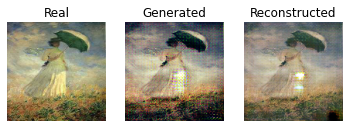

[INFO] Domain B to Domain A


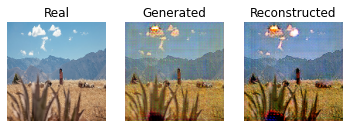

epoch: 79 step: 1 dA_loss: 0.014 dB_loss: 0.042 gAB_loss :4.225 gBA_loss: 4.101
epoch: 79 step: 2 dA_loss: 0.012 dB_loss: 0.041 gAB_loss :3.910 gBA_loss: 4.134
epoch: 79 step: 3 dA_loss: 0.046 dB_loss: 0.034 gAB_loss :3.628 gBA_loss: 3.674
epoch: 79 step: 4 dA_loss: 0.033 dB_loss: 0.009 gAB_loss :3.771 gBA_loss: 3.686
epoch: 79 step: 5 dA_loss: 0.019 dB_loss: 0.036 gAB_loss :4.173 gBA_loss: 3.878
epoch: 79 step: 6 dA_loss: 0.034 dB_loss: 0.012 gAB_loss :3.886 gBA_loss: 3.751
epoch: 79 step: 7 dA_loss: 0.045 dB_loss: 0.048 gAB_loss :3.310 gBA_loss: 3.296
epoch: 79 step: 8 dA_loss: 0.049 dB_loss: 0.044 gAB_loss :3.603 gBA_loss: 3.879
epoch: 79 step: 9 dA_loss: 0.035 dB_loss: 0.012 gAB_loss :3.752 gBA_loss: 3.730
epoch: 79 step: 10 dA_loss: 0.017 dB_loss: 0.022 gAB_loss :4.612 gBA_loss: 4.760
epoch: 79 step: 11 dA_loss: 0.012 dB_loss: 0.021 gAB_loss :4.069 gBA_loss: 3.942
epoch: 79 step: 12 dA_loss: 0.048 dB_loss: 0.023 gAB_loss :4.004 gBA_loss: 3.943
epoch: 79 step: 13 dA_loss: 0.043 dB_

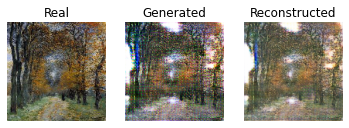

[INFO] Domain B to Domain A


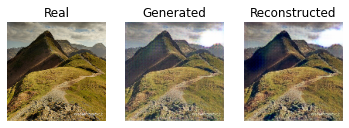

epoch: 79 step: 51 dA_loss: 0.021 dB_loss: 0.056 gAB_loss :4.367 gBA_loss: 4.254
epoch: 79 step: 52 dA_loss: 0.044 dB_loss: 0.023 gAB_loss :3.926 gBA_loss: 4.161
epoch: 79 step: 53 dA_loss: 0.026 dB_loss: 0.029 gAB_loss :3.955 gBA_loss: 3.962
epoch: 79 step: 54 dA_loss: 0.010 dB_loss: 0.075 gAB_loss :3.921 gBA_loss: 3.888
epoch: 79 step: 55 dA_loss: 0.076 dB_loss: 0.057 gAB_loss :3.918 gBA_loss: 4.129
epoch: 79 step: 56 dA_loss: 0.050 dB_loss: 0.067 gAB_loss :3.914 gBA_loss: 4.040
epoch: 79 step: 57 dA_loss: 0.013 dB_loss: 0.032 gAB_loss :3.675 gBA_loss: 3.875
epoch: 79 step: 58 dA_loss: 0.025 dB_loss: 0.027 gAB_loss :3.905 gBA_loss: 3.961
epoch: 79 step: 59 dA_loss: 0.020 dB_loss: 0.038 gAB_loss :3.725 gBA_loss: 3.546
epoch: 79 step: 60 dA_loss: 0.020 dB_loss: 0.035 gAB_loss :4.004 gBA_loss: 3.728
epoch: 79 step: 61 dA_loss: 0.013 dB_loss: 0.018 gAB_loss :3.892 gBA_loss: 4.008
epoch: 79 step: 62 dA_loss: 0.062 dB_loss: 0.098 gAB_loss :3.304 gBA_loss: 3.772
epoch: 79 step: 63 dA_loss: 

 80%|████████  | 80/100 [2:11:39<32:45, 98.30s/it]

epoch: 79 step: 73 dA_loss: 0.037 dB_loss: 0.028 gAB_loss :4.268 gBA_loss: 4.377
epoch: 80 step: 0 dA_loss: 0.025 dB_loss: 0.029 gAB_loss :4.000 gBA_loss: 4.113
[INFO] Domain A to Domain B


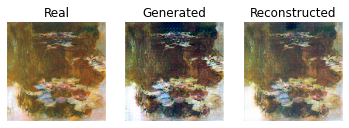

[INFO] Domain B to Domain A


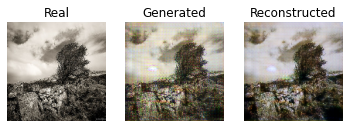

epoch: 80 step: 1 dA_loss: 0.017 dB_loss: 0.034 gAB_loss :4.068 gBA_loss: 4.020
epoch: 80 step: 2 dA_loss: 0.007 dB_loss: 0.066 gAB_loss :4.020 gBA_loss: 4.051
epoch: 80 step: 3 dA_loss: 0.036 dB_loss: 0.060 gAB_loss :3.507 gBA_loss: 3.657
epoch: 80 step: 4 dA_loss: 0.020 dB_loss: 0.025 gAB_loss :3.706 gBA_loss: 3.724
epoch: 80 step: 5 dA_loss: 0.018 dB_loss: 0.063 gAB_loss :4.149 gBA_loss: 3.878
epoch: 80 step: 6 dA_loss: 0.018 dB_loss: 0.016 gAB_loss :3.798 gBA_loss: 3.709
epoch: 80 step: 7 dA_loss: 0.060 dB_loss: 0.067 gAB_loss :3.250 gBA_loss: 3.212
epoch: 80 step: 8 dA_loss: 0.044 dB_loss: 0.044 gAB_loss :3.508 gBA_loss: 3.765
epoch: 80 step: 9 dA_loss: 0.069 dB_loss: 0.019 gAB_loss :3.740 gBA_loss: 3.822
epoch: 80 step: 10 dA_loss: 0.019 dB_loss: 0.021 gAB_loss :4.658 gBA_loss: 4.779
epoch: 80 step: 11 dA_loss: 0.017 dB_loss: 0.051 gAB_loss :4.102 gBA_loss: 3.943
epoch: 80 step: 12 dA_loss: 0.051 dB_loss: 0.017 gAB_loss :3.931 gBA_loss: 3.950
epoch: 80 step: 13 dA_loss: 0.033 dB_

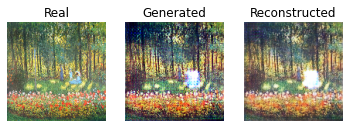

[INFO] Domain B to Domain A


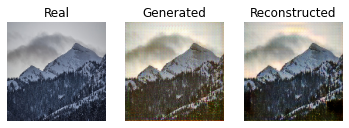

epoch: 80 step: 51 dA_loss: 0.049 dB_loss: 0.055 gAB_loss :4.172 gBA_loss: 4.257
epoch: 80 step: 52 dA_loss: 0.034 dB_loss: 0.042 gAB_loss :3.920 gBA_loss: 4.161
epoch: 80 step: 53 dA_loss: 0.040 dB_loss: 0.045 gAB_loss :4.119 gBA_loss: 3.861
epoch: 80 step: 54 dA_loss: 0.005 dB_loss: 0.059 gAB_loss :4.049 gBA_loss: 3.865
epoch: 80 step: 55 dA_loss: 0.140 dB_loss: 0.066 gAB_loss :3.958 gBA_loss: 4.123
epoch: 80 step: 56 dA_loss: 0.056 dB_loss: 0.056 gAB_loss :3.827 gBA_loss: 4.029
epoch: 80 step: 57 dA_loss: 0.043 dB_loss: 0.030 gAB_loss :3.594 gBA_loss: 3.802
epoch: 80 step: 58 dA_loss: 0.040 dB_loss: 0.026 gAB_loss :3.926 gBA_loss: 3.840
epoch: 80 step: 59 dA_loss: 0.016 dB_loss: 0.018 gAB_loss :3.737 gBA_loss: 3.486
epoch: 80 step: 60 dA_loss: 0.020 dB_loss: 0.043 gAB_loss :4.049 gBA_loss: 3.708
epoch: 80 step: 61 dA_loss: 0.013 dB_loss: 0.026 gAB_loss :3.900 gBA_loss: 3.924
epoch: 80 step: 62 dA_loss: 0.026 dB_loss: 0.050 gAB_loss :3.478 gBA_loss: 3.466
epoch: 80 step: 63 dA_loss: 

 81%|████████  | 81/100 [2:13:17<31:06, 98.26s/it]

epoch: 80 step: 73 dA_loss: 0.013 dB_loss: 0.021 gAB_loss :4.363 gBA_loss: 4.493
epoch: 81 step: 0 dA_loss: 0.015 dB_loss: 0.014 gAB_loss :3.969 gBA_loss: 4.071
[INFO] Domain A to Domain B


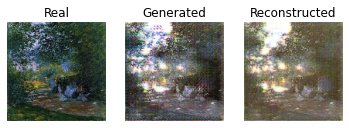

[INFO] Domain B to Domain A


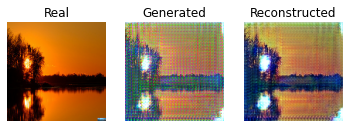

epoch: 81 step: 1 dA_loss: 0.008 dB_loss: 0.026 gAB_loss :4.022 gBA_loss: 4.001
epoch: 81 step: 2 dA_loss: 0.010 dB_loss: 0.051 gAB_loss :3.865 gBA_loss: 4.015
epoch: 81 step: 3 dA_loss: 0.034 dB_loss: 0.049 gAB_loss :3.643 gBA_loss: 3.716
epoch: 81 step: 4 dA_loss: 0.018 dB_loss: 0.007 gAB_loss :3.782 gBA_loss: 3.736
epoch: 81 step: 5 dA_loss: 0.024 dB_loss: 0.039 gAB_loss :4.235 gBA_loss: 3.750
epoch: 81 step: 6 dA_loss: 0.021 dB_loss: 0.021 gAB_loss :3.920 gBA_loss: 3.713
epoch: 81 step: 7 dA_loss: 0.027 dB_loss: 0.057 gAB_loss :3.244 gBA_loss: 3.319
epoch: 81 step: 8 dA_loss: 0.022 dB_loss: 0.029 gAB_loss :3.504 gBA_loss: 3.584
epoch: 81 step: 9 dA_loss: 0.066 dB_loss: 0.016 gAB_loss :3.724 gBA_loss: 3.777
epoch: 81 step: 10 dA_loss: 0.012 dB_loss: 0.018 gAB_loss :4.661 gBA_loss: 4.811
epoch: 81 step: 11 dA_loss: 0.017 dB_loss: 0.018 gAB_loss :4.162 gBA_loss: 4.068
epoch: 81 step: 12 dA_loss: 0.067 dB_loss: 0.028 gAB_loss :3.974 gBA_loss: 3.957
epoch: 81 step: 13 dA_loss: 0.021 dB_

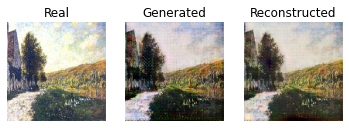

[INFO] Domain B to Domain A


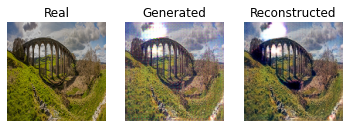

epoch: 81 step: 51 dA_loss: 0.009 dB_loss: 0.026 gAB_loss :4.281 gBA_loss: 4.151
epoch: 81 step: 52 dA_loss: 0.039 dB_loss: 0.021 gAB_loss :4.127 gBA_loss: 4.287
epoch: 81 step: 53 dA_loss: 0.021 dB_loss: 0.007 gAB_loss :4.222 gBA_loss: 4.060
epoch: 81 step: 54 dA_loss: 0.008 dB_loss: 0.041 gAB_loss :4.038 gBA_loss: 3.953
epoch: 81 step: 55 dA_loss: 0.021 dB_loss: 0.040 gAB_loss :3.919 gBA_loss: 3.919
epoch: 81 step: 56 dA_loss: 0.020 dB_loss: 0.035 gAB_loss :3.991 gBA_loss: 4.000
epoch: 81 step: 57 dA_loss: 0.018 dB_loss: 0.017 gAB_loss :3.712 gBA_loss: 3.990
epoch: 81 step: 58 dA_loss: 0.027 dB_loss: 0.017 gAB_loss :3.925 gBA_loss: 4.034
epoch: 81 step: 59 dA_loss: 0.018 dB_loss: 0.013 gAB_loss :3.742 gBA_loss: 3.551
epoch: 81 step: 60 dA_loss: 0.051 dB_loss: 0.013 gAB_loss :4.011 gBA_loss: 3.644
epoch: 81 step: 61 dA_loss: 0.015 dB_loss: 0.019 gAB_loss :3.981 gBA_loss: 3.936
epoch: 81 step: 62 dA_loss: 0.028 dB_loss: 0.021 gAB_loss :3.518 gBA_loss: 3.529
epoch: 81 step: 63 dA_loss: 

 82%|████████▏ | 82/100 [2:14:55<29:28, 98.22s/it]

epoch: 81 step: 73 dA_loss: 0.020 dB_loss: 0.014 gAB_loss :4.503 gBA_loss: 4.373
epoch: 82 step: 0 dA_loss: 0.038 dB_loss: 0.017 gAB_loss :4.019 gBA_loss: 4.184
[INFO] Domain A to Domain B


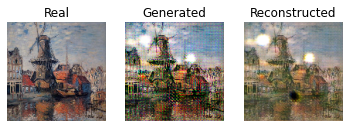

[INFO] Domain B to Domain A


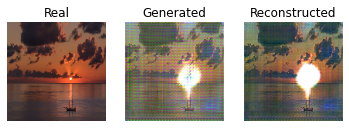

epoch: 82 step: 1 dA_loss: 0.017 dB_loss: 0.024 gAB_loss :3.974 gBA_loss: 3.961
epoch: 82 step: 2 dA_loss: 0.011 dB_loss: 0.031 gAB_loss :3.770 gBA_loss: 3.996
epoch: 82 step: 3 dA_loss: 0.048 dB_loss: 0.036 gAB_loss :3.642 gBA_loss: 3.507
epoch: 82 step: 4 dA_loss: 0.034 dB_loss: 0.010 gAB_loss :3.787 gBA_loss: 3.660
epoch: 82 step: 5 dA_loss: 0.009 dB_loss: 0.030 gAB_loss :4.121 gBA_loss: 3.752
epoch: 82 step: 6 dA_loss: 0.019 dB_loss: 0.007 gAB_loss :3.833 gBA_loss: 3.767
epoch: 82 step: 7 dA_loss: 0.041 dB_loss: 0.030 gAB_loss :3.241 gBA_loss: 3.268
epoch: 82 step: 8 dA_loss: 0.015 dB_loss: 0.027 gAB_loss :3.514 gBA_loss: 3.683
epoch: 82 step: 9 dA_loss: 0.043 dB_loss: 0.012 gAB_loss :3.732 gBA_loss: 3.603
epoch: 82 step: 10 dA_loss: 0.023 dB_loss: 0.018 gAB_loss :4.696 gBA_loss: 4.791
epoch: 82 step: 11 dA_loss: 0.021 dB_loss: 0.016 gAB_loss :4.104 gBA_loss: 4.068
epoch: 82 step: 12 dA_loss: 0.032 dB_loss: 0.011 gAB_loss :4.003 gBA_loss: 4.018
epoch: 82 step: 13 dA_loss: 0.018 dB_

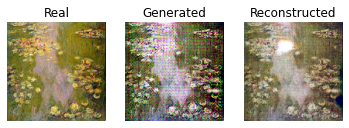

[INFO] Domain B to Domain A


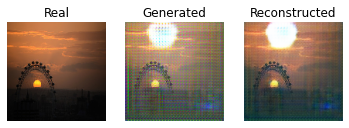

epoch: 82 step: 51 dA_loss: 0.009 dB_loss: 0.033 gAB_loss :4.315 gBA_loss: 4.218
epoch: 82 step: 52 dA_loss: 0.017 dB_loss: 0.016 gAB_loss :4.098 gBA_loss: 4.131
epoch: 82 step: 53 dA_loss: 0.011 dB_loss: 0.013 gAB_loss :4.237 gBA_loss: 4.074
epoch: 82 step: 54 dA_loss: 0.005 dB_loss: 0.042 gAB_loss :4.043 gBA_loss: 4.009
epoch: 82 step: 55 dA_loss: 0.009 dB_loss: 0.049 gAB_loss :3.931 gBA_loss: 3.923
epoch: 82 step: 56 dA_loss: 0.008 dB_loss: 0.038 gAB_loss :3.895 gBA_loss: 4.093
epoch: 82 step: 57 dA_loss: 0.009 dB_loss: 0.021 gAB_loss :3.659 gBA_loss: 3.874
epoch: 82 step: 58 dA_loss: 0.009 dB_loss: 0.015 gAB_loss :4.000 gBA_loss: 4.030
epoch: 82 step: 59 dA_loss: 0.007 dB_loss: 0.021 gAB_loss :3.709 gBA_loss: 3.575
epoch: 82 step: 60 dA_loss: 0.016 dB_loss: 0.020 gAB_loss :3.983 gBA_loss: 3.683
epoch: 82 step: 61 dA_loss: 0.007 dB_loss: 0.019 gAB_loss :3.989 gBA_loss: 3.924
epoch: 82 step: 62 dA_loss: 0.027 dB_loss: 0.034 gAB_loss :3.576 gBA_loss: 3.396
epoch: 82 step: 63 dA_loss: 

 83%|████████▎ | 83/100 [2:16:34<27:49, 98.19s/it]

epoch: 82 step: 73 dA_loss: 0.014 dB_loss: 0.014 gAB_loss :4.388 gBA_loss: 4.536
epoch: 83 step: 0 dA_loss: 0.007 dB_loss: 0.016 gAB_loss :3.994 gBA_loss: 4.097
[INFO] Domain A to Domain B


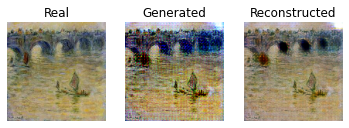

[INFO] Domain B to Domain A


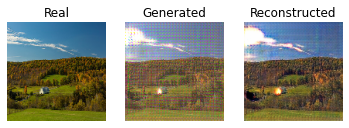

epoch: 83 step: 1 dA_loss: 0.005 dB_loss: 0.023 gAB_loss :3.986 gBA_loss: 3.911
epoch: 83 step: 2 dA_loss: 0.010 dB_loss: 0.024 gAB_loss :3.779 gBA_loss: 3.975
epoch: 83 step: 3 dA_loss: 0.016 dB_loss: 0.038 gAB_loss :3.671 gBA_loss: 3.586
epoch: 83 step: 4 dA_loss: 0.017 dB_loss: 0.007 gAB_loss :3.776 gBA_loss: 3.740
epoch: 83 step: 5 dA_loss: 0.012 dB_loss: 0.021 gAB_loss :4.146 gBA_loss: 3.844
epoch: 83 step: 6 dA_loss: 0.026 dB_loss: 0.021 gAB_loss :3.897 gBA_loss: 3.686
epoch: 83 step: 7 dA_loss: 0.022 dB_loss: 0.032 gAB_loss :3.255 gBA_loss: 3.153
epoch: 83 step: 8 dA_loss: 0.086 dB_loss: 0.023 gAB_loss :3.431 gBA_loss: 3.867
epoch: 83 step: 9 dA_loss: 0.086 dB_loss: 0.013 gAB_loss :3.667 gBA_loss: 3.544
epoch: 83 step: 10 dA_loss: 0.008 dB_loss: 0.013 gAB_loss :4.653 gBA_loss: 4.619
epoch: 83 step: 11 dA_loss: 0.038 dB_loss: 0.011 gAB_loss :4.138 gBA_loss: 3.986
epoch: 83 step: 12 dA_loss: 0.037 dB_loss: 0.023 gAB_loss :4.011 gBA_loss: 3.959
epoch: 83 step: 13 dA_loss: 0.010 dB_

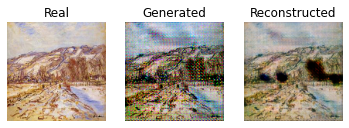

[INFO] Domain B to Domain A


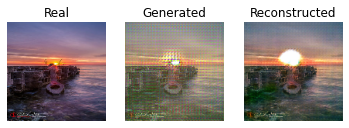

epoch: 83 step: 51 dA_loss: 0.008 dB_loss: 0.021 gAB_loss :4.170 gBA_loss: 4.260
epoch: 83 step: 52 dA_loss: 0.030 dB_loss: 0.014 gAB_loss :3.904 gBA_loss: 4.149
epoch: 83 step: 53 dA_loss: 0.026 dB_loss: 0.030 gAB_loss :4.170 gBA_loss: 3.932
epoch: 83 step: 54 dA_loss: 0.006 dB_loss: 0.043 gAB_loss :4.102 gBA_loss: 3.921
epoch: 83 step: 55 dA_loss: 0.032 dB_loss: 0.041 gAB_loss :3.944 gBA_loss: 3.984
epoch: 83 step: 56 dA_loss: 0.008 dB_loss: 0.025 gAB_loss :3.865 gBA_loss: 4.079
epoch: 83 step: 57 dA_loss: 0.014 dB_loss: 0.014 gAB_loss :3.678 gBA_loss: 3.858
epoch: 83 step: 58 dA_loss: 0.014 dB_loss: 0.008 gAB_loss :3.955 gBA_loss: 3.961
epoch: 83 step: 59 dA_loss: 0.021 dB_loss: 0.015 gAB_loss :3.746 gBA_loss: 3.576
epoch: 83 step: 60 dA_loss: 0.013 dB_loss: 0.023 gAB_loss :3.956 gBA_loss: 3.720
epoch: 83 step: 61 dA_loss: 0.007 dB_loss: 0.020 gAB_loss :3.916 gBA_loss: 3.926
epoch: 83 step: 62 dA_loss: 0.032 dB_loss: 0.024 gAB_loss :3.573 gBA_loss: 3.242
epoch: 83 step: 63 dA_loss: 

 84%|████████▍ | 84/100 [2:18:12<26:10, 98.17s/it]

epoch: 83 step: 73 dA_loss: 0.007 dB_loss: 0.018 gAB_loss :4.506 gBA_loss: 4.452
epoch: 84 step: 0 dA_loss: 0.006 dB_loss: 0.014 gAB_loss :4.071 gBA_loss: 4.064
[INFO] Domain A to Domain B


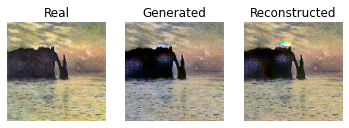

[INFO] Domain B to Domain A


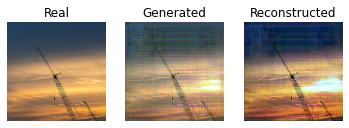

epoch: 84 step: 1 dA_loss: 0.005 dB_loss: 0.037 gAB_loss :4.033 gBA_loss: 3.935
epoch: 84 step: 2 dA_loss: 0.015 dB_loss: 0.034 gAB_loss :3.734 gBA_loss: 4.026
epoch: 84 step: 3 dA_loss: 0.015 dB_loss: 0.033 gAB_loss :3.606 gBA_loss: 3.639
epoch: 84 step: 4 dA_loss: 0.027 dB_loss: 0.013 gAB_loss :3.766 gBA_loss: 3.690
epoch: 84 step: 5 dA_loss: 0.010 dB_loss: 0.029 gAB_loss :4.209 gBA_loss: 3.797
epoch: 84 step: 6 dA_loss: 0.018 dB_loss: 0.013 gAB_loss :3.887 gBA_loss: 3.831
epoch: 84 step: 7 dA_loss: 0.031 dB_loss: 0.037 gAB_loss :3.304 gBA_loss: 3.221
epoch: 84 step: 8 dA_loss: 0.015 dB_loss: 0.026 gAB_loss :3.487 gBA_loss: 3.529
epoch: 84 step: 9 dA_loss: 0.121 dB_loss: 0.015 gAB_loss :3.724 gBA_loss: 3.814
epoch: 84 step: 10 dA_loss: 0.038 dB_loss: 0.013 gAB_loss :4.645 gBA_loss: 4.713
epoch: 84 step: 11 dA_loss: 0.014 dB_loss: 0.020 gAB_loss :4.068 gBA_loss: 3.957
epoch: 84 step: 12 dA_loss: 0.027 dB_loss: 0.017 gAB_loss :4.047 gBA_loss: 3.886
epoch: 84 step: 13 dA_loss: 0.009 dB_

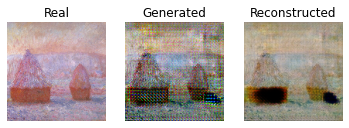

[INFO] Domain B to Domain A


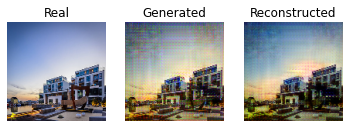

epoch: 84 step: 51 dA_loss: 0.008 dB_loss: 0.046 gAB_loss :4.388 gBA_loss: 4.100
epoch: 84 step: 52 dA_loss: 0.022 dB_loss: 0.055 gAB_loss :3.941 gBA_loss: 4.146
epoch: 84 step: 53 dA_loss: 0.012 dB_loss: 0.035 gAB_loss :4.064 gBA_loss: 4.015
epoch: 84 step: 54 dA_loss: 0.008 dB_loss: 0.039 gAB_loss :4.138 gBA_loss: 3.931
epoch: 84 step: 55 dA_loss: 0.013 dB_loss: 0.078 gAB_loss :3.861 gBA_loss: 3.819
epoch: 84 step: 56 dA_loss: 0.011 dB_loss: 0.024 gAB_loss :3.819 gBA_loss: 3.964
epoch: 84 step: 57 dA_loss: 0.018 dB_loss: 0.072 gAB_loss :3.744 gBA_loss: 3.902
epoch: 84 step: 58 dA_loss: 0.010 dB_loss: 0.049 gAB_loss :3.823 gBA_loss: 4.085
epoch: 84 step: 59 dA_loss: 0.013 dB_loss: 0.114 gAB_loss :3.716 gBA_loss: 3.610
epoch: 84 step: 60 dA_loss: 0.019 dB_loss: 0.041 gAB_loss :3.764 gBA_loss: 3.651
epoch: 84 step: 61 dA_loss: 0.004 dB_loss: 0.076 gAB_loss :3.880 gBA_loss: 3.906
epoch: 84 step: 62 dA_loss: 0.029 dB_loss: 0.034 gAB_loss :3.580 gBA_loss: 3.553
epoch: 84 step: 63 dA_loss: 

 85%|████████▌ | 85/100 [2:19:50<24:32, 98.16s/it]

epoch: 84 step: 73 dA_loss: 0.023 dB_loss: 0.021 gAB_loss :4.447 gBA_loss: 4.425
epoch: 85 step: 0 dA_loss: 0.011 dB_loss: 0.016 gAB_loss :4.058 gBA_loss: 4.108
[INFO] Domain A to Domain B


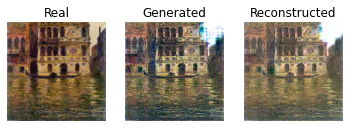

[INFO] Domain B to Domain A


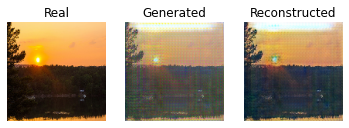

epoch: 85 step: 1 dA_loss: 0.010 dB_loss: 0.029 gAB_loss :3.982 gBA_loss: 3.989
epoch: 85 step: 2 dA_loss: 0.006 dB_loss: 0.028 gAB_loss :3.866 gBA_loss: 3.994
epoch: 85 step: 3 dA_loss: 0.019 dB_loss: 0.033 gAB_loss :3.680 gBA_loss: 3.564
epoch: 85 step: 4 dA_loss: 0.018 dB_loss: 0.007 gAB_loss :3.765 gBA_loss: 3.743
epoch: 85 step: 5 dA_loss: 0.013 dB_loss: 0.030 gAB_loss :4.060 gBA_loss: 3.879
epoch: 85 step: 6 dA_loss: 0.027 dB_loss: 0.025 gAB_loss :3.872 gBA_loss: 3.674
epoch: 85 step: 7 dA_loss: 0.017 dB_loss: 0.030 gAB_loss :3.324 gBA_loss: 3.217
epoch: 85 step: 8 dA_loss: 0.016 dB_loss: 0.027 gAB_loss :3.470 gBA_loss: 3.596
epoch: 85 step: 9 dA_loss: 0.042 dB_loss: 0.016 gAB_loss :3.674 gBA_loss: 3.614
epoch: 85 step: 10 dA_loss: 0.027 dB_loss: 0.016 gAB_loss :4.586 gBA_loss: 4.892
epoch: 85 step: 11 dA_loss: 0.014 dB_loss: 0.013 gAB_loss :4.148 gBA_loss: 3.998
epoch: 85 step: 12 dA_loss: 0.027 dB_loss: 0.023 gAB_loss :4.120 gBA_loss: 3.972
epoch: 85 step: 13 dA_loss: 0.022 dB_

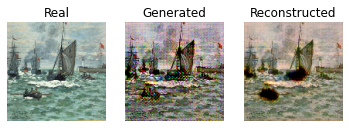

[INFO] Domain B to Domain A


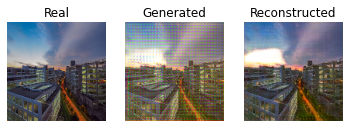

epoch: 85 step: 51 dA_loss: 0.004 dB_loss: 0.048 gAB_loss :4.134 gBA_loss: 4.148
epoch: 85 step: 52 dA_loss: 0.015 dB_loss: 0.032 gAB_loss :3.867 gBA_loss: 4.076
epoch: 85 step: 53 dA_loss: 0.007 dB_loss: 0.086 gAB_loss :3.881 gBA_loss: 3.932
epoch: 85 step: 54 dA_loss: 0.004 dB_loss: 0.069 gAB_loss :3.976 gBA_loss: 3.913
epoch: 85 step: 55 dA_loss: 0.011 dB_loss: 0.058 gAB_loss :3.990 gBA_loss: 3.867
epoch: 85 step: 56 dA_loss: 0.009 dB_loss: 0.064 gAB_loss :4.027 gBA_loss: 4.037
epoch: 85 step: 57 dA_loss: 0.009 dB_loss: 0.017 gAB_loss :3.657 gBA_loss: 3.836
epoch: 85 step: 58 dA_loss: 0.006 dB_loss: 0.011 gAB_loss :3.880 gBA_loss: 3.999
epoch: 85 step: 59 dA_loss: 0.007 dB_loss: 0.014 gAB_loss :3.656 gBA_loss: 3.601
epoch: 85 step: 60 dA_loss: 0.005 dB_loss: 0.038 gAB_loss :3.918 gBA_loss: 3.724
epoch: 85 step: 61 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :3.919 gBA_loss: 3.898
epoch: 85 step: 62 dA_loss: 0.017 dB_loss: 0.028 gAB_loss :3.464 gBA_loss: 3.454
epoch: 85 step: 63 dA_loss: 

 86%|████████▌ | 86/100 [2:21:28<22:54, 98.15s/it]

epoch: 85 step: 73 dA_loss: 0.011 dB_loss: 0.083 gAB_loss :4.393 gBA_loss: 4.466
epoch: 86 step: 0 dA_loss: 0.007 dB_loss: 0.025 gAB_loss :3.968 gBA_loss: 4.024
[INFO] Domain A to Domain B


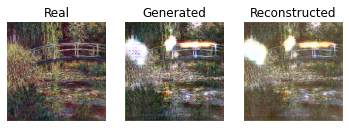

[INFO] Domain B to Domain A


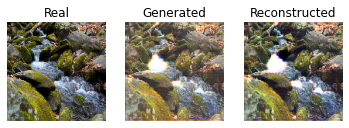

epoch: 86 step: 1 dA_loss: 0.004 dB_loss: 0.043 gAB_loss :4.017 gBA_loss: 3.898
epoch: 86 step: 2 dA_loss: 0.007 dB_loss: 0.042 gAB_loss :3.755 gBA_loss: 3.926
epoch: 86 step: 3 dA_loss: 0.018 dB_loss: 0.036 gAB_loss :3.571 gBA_loss: 3.611
epoch: 86 step: 4 dA_loss: 0.007 dB_loss: 0.025 gAB_loss :3.692 gBA_loss: 3.668
epoch: 86 step: 5 dA_loss: 0.010 dB_loss: 0.023 gAB_loss :4.087 gBA_loss: 3.843
epoch: 86 step: 6 dA_loss: 0.008 dB_loss: 0.026 gAB_loss :3.763 gBA_loss: 3.765
epoch: 86 step: 7 dA_loss: 0.029 dB_loss: 0.033 gAB_loss :3.222 gBA_loss: 3.254
epoch: 86 step: 8 dA_loss: 0.011 dB_loss: 0.026 gAB_loss :3.533 gBA_loss: 3.541
epoch: 86 step: 9 dA_loss: 0.036 dB_loss: 0.016 gAB_loss :3.698 gBA_loss: 3.577
epoch: 86 step: 10 dA_loss: 0.021 dB_loss: 0.019 gAB_loss :4.615 gBA_loss: 4.787
epoch: 86 step: 11 dA_loss: 0.011 dB_loss: 0.018 gAB_loss :4.046 gBA_loss: 4.057
epoch: 86 step: 12 dA_loss: 0.021 dB_loss: 0.020 gAB_loss :3.995 gBA_loss: 4.042
epoch: 86 step: 13 dA_loss: 0.010 dB_

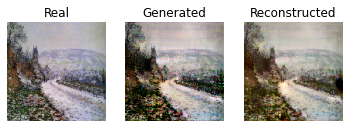

[INFO] Domain B to Domain A


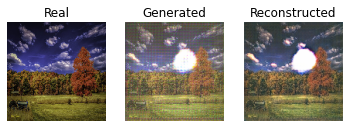

epoch: 86 step: 51 dA_loss: 0.007 dB_loss: 0.012 gAB_loss :4.224 gBA_loss: 4.098
epoch: 86 step: 52 dA_loss: 0.012 dB_loss: 0.010 gAB_loss :3.890 gBA_loss: 4.016
epoch: 86 step: 53 dA_loss: 0.005 dB_loss: 0.010 gAB_loss :3.959 gBA_loss: 3.845
epoch: 86 step: 54 dA_loss: 0.005 dB_loss: 0.017 gAB_loss :3.935 gBA_loss: 3.852
epoch: 86 step: 55 dA_loss: 0.008 dB_loss: 0.028 gAB_loss :3.945 gBA_loss: 3.823
epoch: 86 step: 56 dA_loss: 0.006 dB_loss: 0.029 gAB_loss :3.952 gBA_loss: 3.888
epoch: 86 step: 57 dA_loss: 0.015 dB_loss: 0.015 gAB_loss :3.639 gBA_loss: 3.814
epoch: 86 step: 58 dA_loss: 0.008 dB_loss: 0.011 gAB_loss :3.844 gBA_loss: 3.928
epoch: 86 step: 59 dA_loss: 0.012 dB_loss: 0.020 gAB_loss :3.720 gBA_loss: 3.509
epoch: 86 step: 60 dA_loss: 0.008 dB_loss: 0.013 gAB_loss :3.936 gBA_loss: 3.624
epoch: 86 step: 61 dA_loss: 0.004 dB_loss: 0.008 gAB_loss :3.850 gBA_loss: 3.819
epoch: 86 step: 62 dA_loss: 0.006 dB_loss: 0.037 gAB_loss :3.216 gBA_loss: 3.451
epoch: 86 step: 63 dA_loss: 

 87%|████████▋ | 87/100 [2:23:06<21:15, 98.13s/it]

epoch: 86 step: 73 dA_loss: 0.011 dB_loss: 0.017 gAB_loss :4.344 gBA_loss: 4.400
epoch: 87 step: 0 dA_loss: 0.004 dB_loss: 0.024 gAB_loss :3.987 gBA_loss: 4.063
[INFO] Domain A to Domain B


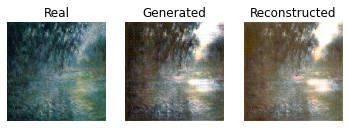

[INFO] Domain B to Domain A


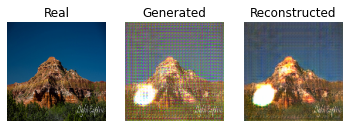

epoch: 87 step: 1 dA_loss: 0.006 dB_loss: 0.021 gAB_loss :4.073 gBA_loss: 3.946
epoch: 87 step: 2 dA_loss: 0.004 dB_loss: 0.024 gAB_loss :3.949 gBA_loss: 3.948
epoch: 87 step: 3 dA_loss: 0.005 dB_loss: 0.019 gAB_loss :3.711 gBA_loss: 3.621
epoch: 87 step: 4 dA_loss: 0.006 dB_loss: 0.007 gAB_loss :3.707 gBA_loss: 3.726
epoch: 87 step: 5 dA_loss: 0.008 dB_loss: 0.019 gAB_loss :4.121 gBA_loss: 3.839
epoch: 87 step: 6 dA_loss: 0.007 dB_loss: 0.012 gAB_loss :3.800 gBA_loss: 3.731
epoch: 87 step: 7 dA_loss: 0.007 dB_loss: 0.026 gAB_loss :3.197 gBA_loss: 3.388
epoch: 87 step: 8 dA_loss: 0.011 dB_loss: 0.023 gAB_loss :3.453 gBA_loss: 3.562
epoch: 87 step: 9 dA_loss: 0.012 dB_loss: 0.011 gAB_loss :3.671 gBA_loss: 3.489
epoch: 87 step: 10 dA_loss: 0.006 dB_loss: 0.010 gAB_loss :4.624 gBA_loss: 4.671
epoch: 87 step: 11 dA_loss: 0.018 dB_loss: 0.012 gAB_loss :4.064 gBA_loss: 3.918
epoch: 87 step: 12 dA_loss: 0.010 dB_loss: 0.015 gAB_loss :3.873 gBA_loss: 3.969
epoch: 87 step: 13 dA_loss: 0.007 dB_

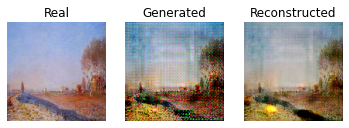

[INFO] Domain B to Domain A


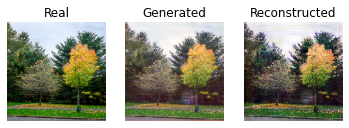

epoch: 87 step: 51 dA_loss: 0.004 dB_loss: 0.035 gAB_loss :4.130 gBA_loss: 4.111
epoch: 87 step: 52 dA_loss: 0.006 dB_loss: 0.032 gAB_loss :3.790 gBA_loss: 4.110
epoch: 87 step: 53 dA_loss: 0.003 dB_loss: 0.027 gAB_loss :3.902 gBA_loss: 3.911
epoch: 87 step: 54 dA_loss: 0.005 dB_loss: 0.026 gAB_loss :3.948 gBA_loss: 3.844
epoch: 87 step: 55 dA_loss: 0.004 dB_loss: 0.033 gAB_loss :3.950 gBA_loss: 3.805
epoch: 87 step: 56 dA_loss: 0.008 dB_loss: 0.032 gAB_loss :3.888 gBA_loss: 3.887
epoch: 87 step: 57 dA_loss: 0.003 dB_loss: 0.011 gAB_loss :3.568 gBA_loss: 3.733
epoch: 87 step: 58 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.842 gBA_loss: 3.938
epoch: 87 step: 59 dA_loss: 0.006 dB_loss: 0.018 gAB_loss :3.651 gBA_loss: 3.573
epoch: 87 step: 60 dA_loss: 0.005 dB_loss: 0.021 gAB_loss :4.010 gBA_loss: 3.746
epoch: 87 step: 61 dA_loss: 0.005 dB_loss: 0.010 gAB_loss :3.915 gBA_loss: 3.958
epoch: 87 step: 62 dA_loss: 0.008 dB_loss: 0.029 gAB_loss :3.488 gBA_loss: 3.522
epoch: 87 step: 63 dA_loss: 

 88%|████████▊ | 88/100 [2:24:44<19:37, 98.13s/it]

epoch: 87 step: 73 dA_loss: 0.007 dB_loss: 0.010 gAB_loss :4.280 gBA_loss: 4.273
epoch: 88 step: 0 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.946 gBA_loss: 3.861
[INFO] Domain A to Domain B


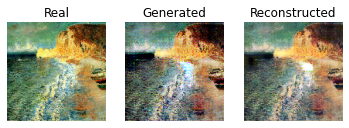

[INFO] Domain B to Domain A


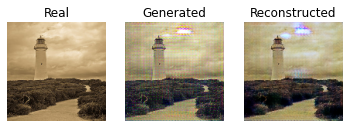

epoch: 88 step: 1 dA_loss: 0.010 dB_loss: 0.012 gAB_loss :4.006 gBA_loss: 3.862
epoch: 88 step: 2 dA_loss: 0.005 dB_loss: 0.019 gAB_loss :3.815 gBA_loss: 3.911
epoch: 88 step: 3 dA_loss: 0.009 dB_loss: 0.015 gAB_loss :3.644 gBA_loss: 3.534
epoch: 88 step: 4 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :3.661 gBA_loss: 3.675
epoch: 88 step: 5 dA_loss: 0.004 dB_loss: 0.020 gAB_loss :4.020 gBA_loss: 3.747
epoch: 88 step: 6 dA_loss: 0.006 dB_loss: 0.010 gAB_loss :3.740 gBA_loss: 3.675
epoch: 88 step: 7 dA_loss: 0.007 dB_loss: 0.025 gAB_loss :3.203 gBA_loss: 3.184
epoch: 88 step: 8 dA_loss: 0.005 dB_loss: 0.020 gAB_loss :3.314 gBA_loss: 3.557
epoch: 88 step: 9 dA_loss: 0.010 dB_loss: 0.013 gAB_loss :3.505 gBA_loss: 3.436
epoch: 88 step: 10 dA_loss: 0.004 dB_loss: 0.013 gAB_loss :4.533 gBA_loss: 4.625
epoch: 88 step: 11 dA_loss: 0.005 dB_loss: 0.015 gAB_loss :4.052 gBA_loss: 3.827
epoch: 88 step: 12 dA_loss: 0.008 dB_loss: 0.015 gAB_loss :3.881 gBA_loss: 3.935
epoch: 88 step: 13 dA_loss: 0.005 dB_

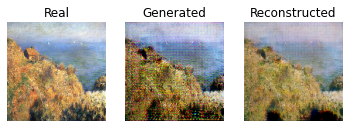

[INFO] Domain B to Domain A


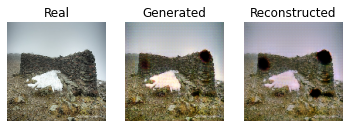

epoch: 88 step: 51 dA_loss: 0.009 dB_loss: 0.008 gAB_loss :4.278 gBA_loss: 4.048
epoch: 88 step: 52 dA_loss: 0.024 dB_loss: 0.012 gAB_loss :3.991 gBA_loss: 3.986
epoch: 88 step: 53 dA_loss: 0.017 dB_loss: 0.010 gAB_loss :3.963 gBA_loss: 3.868
epoch: 88 step: 54 dA_loss: 0.005 dB_loss: 0.013 gAB_loss :3.870 gBA_loss: 3.831
epoch: 88 step: 55 dA_loss: 0.039 dB_loss: 0.025 gAB_loss :3.817 gBA_loss: 3.897
epoch: 88 step: 56 dA_loss: 0.010 dB_loss: 0.015 gAB_loss :3.902 gBA_loss: 4.000
epoch: 88 step: 57 dA_loss: 0.006 dB_loss: 0.011 gAB_loss :3.602 gBA_loss: 3.716
epoch: 88 step: 58 dA_loss: 0.013 dB_loss: 0.008 gAB_loss :3.827 gBA_loss: 3.845
epoch: 88 step: 59 dA_loss: 0.009 dB_loss: 0.007 gAB_loss :3.588 gBA_loss: 3.479
epoch: 88 step: 60 dA_loss: 0.004 dB_loss: 0.014 gAB_loss :3.927 gBA_loss: 3.538
epoch: 88 step: 61 dA_loss: 0.003 dB_loss: 0.007 gAB_loss :3.840 gBA_loss: 3.793
epoch: 88 step: 62 dA_loss: 0.021 dB_loss: 0.012 gAB_loss :3.417 gBA_loss: 3.402
epoch: 88 step: 63 dA_loss: 

 89%|████████▉ | 89/100 [2:26:23<18:00, 98.25s/it]

epoch: 88 step: 73 dA_loss: 0.008 dB_loss: 0.014 gAB_loss :4.259 gBA_loss: 4.310
epoch: 89 step: 0 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :3.908 gBA_loss: 3.903
[INFO] Domain A to Domain B


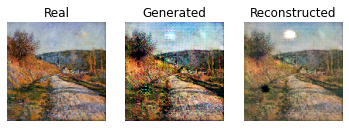

[INFO] Domain B to Domain A


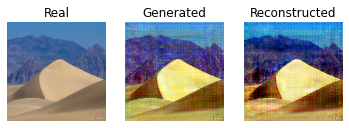

epoch: 89 step: 1 dA_loss: 0.003 dB_loss: 0.013 gAB_loss :3.997 gBA_loss: 3.817
epoch: 89 step: 2 dA_loss: 0.014 dB_loss: 0.014 gAB_loss :3.799 gBA_loss: 3.913
epoch: 89 step: 3 dA_loss: 0.009 dB_loss: 0.016 gAB_loss :3.586 gBA_loss: 3.544
epoch: 89 step: 4 dA_loss: 0.010 dB_loss: 0.005 gAB_loss :3.633 gBA_loss: 3.616
epoch: 89 step: 5 dA_loss: 0.009 dB_loss: 0.016 gAB_loss :4.073 gBA_loss: 3.785
epoch: 89 step: 6 dA_loss: 0.009 dB_loss: 0.007 gAB_loss :3.746 gBA_loss: 3.683
epoch: 89 step: 7 dA_loss: 0.021 dB_loss: 0.016 gAB_loss :3.135 gBA_loss: 3.098
epoch: 89 step: 8 dA_loss: 0.013 dB_loss: 0.012 gAB_loss :3.329 gBA_loss: 3.527
epoch: 89 step: 9 dA_loss: 0.008 dB_loss: 0.012 gAB_loss :3.555 gBA_loss: 3.500
epoch: 89 step: 10 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :4.538 gBA_loss: 4.623
epoch: 89 step: 11 dA_loss: 0.011 dB_loss: 0.011 gAB_loss :4.053 gBA_loss: 3.951
epoch: 89 step: 12 dA_loss: 0.008 dB_loss: 0.019 gAB_loss :3.941 gBA_loss: 3.956
epoch: 89 step: 13 dA_loss: 0.004 dB_

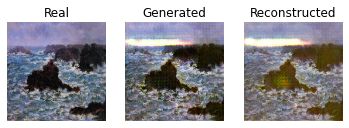

[INFO] Domain B to Domain A


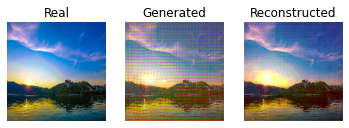

epoch: 89 step: 51 dA_loss: 0.010 dB_loss: 0.012 gAB_loss :4.202 gBA_loss: 3.998
epoch: 89 step: 52 dA_loss: 0.006 dB_loss: 0.022 gAB_loss :3.911 gBA_loss: 4.039
epoch: 89 step: 53 dA_loss: 0.004 dB_loss: 0.007 gAB_loss :3.928 gBA_loss: 3.867
epoch: 89 step: 54 dA_loss: 0.002 dB_loss: 0.015 gAB_loss :3.971 gBA_loss: 3.845
epoch: 89 step: 55 dA_loss: 0.008 dB_loss: 0.022 gAB_loss :3.883 gBA_loss: 3.736
epoch: 89 step: 56 dA_loss: 0.009 dB_loss: 0.018 gAB_loss :3.918 gBA_loss: 3.867
epoch: 89 step: 57 dA_loss: 0.004 dB_loss: 0.011 gAB_loss :3.590 gBA_loss: 3.721
epoch: 89 step: 58 dA_loss: 0.005 dB_loss: 0.014 gAB_loss :3.801 gBA_loss: 3.912
epoch: 89 step: 59 dA_loss: 0.005 dB_loss: 0.011 gAB_loss :3.572 gBA_loss: 3.544
epoch: 89 step: 60 dA_loss: 0.004 dB_loss: 0.012 gAB_loss :3.847 gBA_loss: 3.557
epoch: 89 step: 61 dA_loss: 0.003 dB_loss: 0.015 gAB_loss :3.890 gBA_loss: 3.798
epoch: 89 step: 62 dA_loss: 0.008 dB_loss: 0.011 gAB_loss :3.429 gBA_loss: 3.297
epoch: 89 step: 63 dA_loss: 

 90%|█████████ | 90/100 [2:28:01<16:22, 98.27s/it]

epoch: 89 step: 73 dA_loss: 0.005 dB_loss: 0.010 gAB_loss :4.284 gBA_loss: 4.302
epoch: 90 step: 0 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :3.895 gBA_loss: 3.848
[INFO] Domain A to Domain B


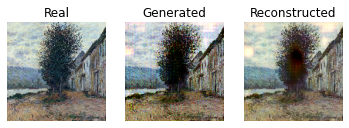

[INFO] Domain B to Domain A


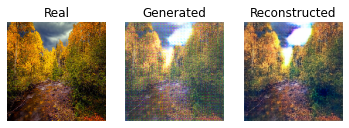

epoch: 90 step: 1 dA_loss: 0.004 dB_loss: 0.015 gAB_loss :3.960 gBA_loss: 3.778
epoch: 90 step: 2 dA_loss: 0.007 dB_loss: 0.011 gAB_loss :3.770 gBA_loss: 3.856
epoch: 90 step: 3 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :3.562 gBA_loss: 3.468
epoch: 90 step: 4 dA_loss: 0.006 dB_loss: 0.005 gAB_loss :3.600 gBA_loss: 3.614
epoch: 90 step: 5 dA_loss: 0.008 dB_loss: 0.017 gAB_loss :4.094 gBA_loss: 3.705
epoch: 90 step: 6 dA_loss: 0.005 dB_loss: 0.006 gAB_loss :3.702 gBA_loss: 3.616
epoch: 90 step: 7 dA_loss: 0.005 dB_loss: 0.014 gAB_loss :3.161 gBA_loss: 3.218
epoch: 90 step: 8 dA_loss: 0.028 dB_loss: 0.016 gAB_loss :3.291 gBA_loss: 3.346
epoch: 90 step: 9 dA_loss: 0.021 dB_loss: 0.008 gAB_loss :3.437 gBA_loss: 3.337
epoch: 90 step: 10 dA_loss: 0.013 dB_loss: 0.009 gAB_loss :4.473 gBA_loss: 4.596
epoch: 90 step: 11 dA_loss: 0.016 dB_loss: 0.013 gAB_loss :3.977 gBA_loss: 3.847
epoch: 90 step: 12 dA_loss: 0.013 dB_loss: 0.009 gAB_loss :3.952 gBA_loss: 3.899
epoch: 90 step: 13 dA_loss: 0.006 dB_

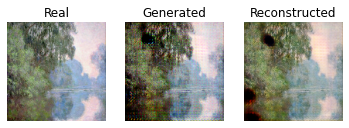

[INFO] Domain B to Domain A


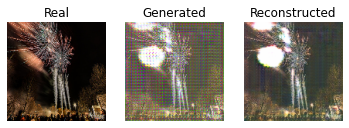

epoch: 90 step: 51 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :4.120 gBA_loss: 3.969
epoch: 90 step: 52 dA_loss: 0.015 dB_loss: 0.014 gAB_loss :3.928 gBA_loss: 3.972
epoch: 90 step: 53 dA_loss: 0.003 dB_loss: 0.017 gAB_loss :3.975 gBA_loss: 3.791
epoch: 90 step: 54 dA_loss: 0.002 dB_loss: 0.013 gAB_loss :3.899 gBA_loss: 3.742
epoch: 90 step: 55 dA_loss: 0.005 dB_loss: 0.034 gAB_loss :3.796 gBA_loss: 3.757
epoch: 90 step: 56 dA_loss: 0.005 dB_loss: 0.031 gAB_loss :3.881 gBA_loss: 3.944
epoch: 90 step: 57 dA_loss: 0.005 dB_loss: 0.013 gAB_loss :3.631 gBA_loss: 3.690
epoch: 90 step: 58 dA_loss: 0.004 dB_loss: 0.008 gAB_loss :3.872 gBA_loss: 3.880
epoch: 90 step: 59 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.527 gBA_loss: 3.426
epoch: 90 step: 60 dA_loss: 0.005 dB_loss: 0.019 gAB_loss :3.731 gBA_loss: 3.585
epoch: 90 step: 61 dA_loss: 0.007 dB_loss: 0.017 gAB_loss :3.786 gBA_loss: 3.731
epoch: 90 step: 62 dA_loss: 0.005 dB_loss: 0.051 gAB_loss :3.728 gBA_loss: 3.301
epoch: 90 step: 63 dA_loss: 

 91%|█████████ | 91/100 [2:29:39<14:44, 98.24s/it]

epoch: 90 step: 73 dA_loss: 0.006 dB_loss: 0.042 gAB_loss :4.289 gBA_loss: 4.246
epoch: 91 step: 0 dA_loss: 0.004 dB_loss: 0.017 gAB_loss :3.815 gBA_loss: 3.844
[INFO] Domain A to Domain B


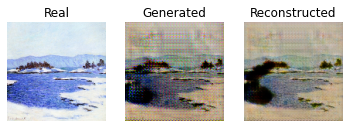

[INFO] Domain B to Domain A


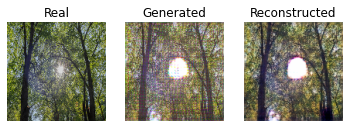

epoch: 91 step: 1 dA_loss: 0.004 dB_loss: 0.035 gAB_loss :3.767 gBA_loss: 3.776
epoch: 91 step: 2 dA_loss: 0.007 dB_loss: 0.123 gAB_loss :3.989 gBA_loss: 3.877
epoch: 91 step: 3 dA_loss: 0.007 dB_loss: 0.065 gAB_loss :3.495 gBA_loss: 3.546
epoch: 91 step: 4 dA_loss: 0.009 dB_loss: 0.011 gAB_loss :3.513 gBA_loss: 3.563
epoch: 91 step: 5 dA_loss: 0.004 dB_loss: 0.030 gAB_loss :3.863 gBA_loss: 3.673
epoch: 91 step: 6 dA_loss: 0.008 dB_loss: 0.039 gAB_loss :3.809 gBA_loss: 3.567
epoch: 91 step: 7 dA_loss: 0.006 dB_loss: 0.032 gAB_loss :3.290 gBA_loss: 3.166
epoch: 91 step: 8 dA_loss: 0.012 dB_loss: 0.032 gAB_loss :3.366 gBA_loss: 3.550
epoch: 91 step: 9 dA_loss: 0.016 dB_loss: 0.020 gAB_loss :3.373 gBA_loss: 3.272
epoch: 91 step: 10 dA_loss: 0.011 dB_loss: 0.020 gAB_loss :4.386 gBA_loss: 4.465
epoch: 91 step: 11 dA_loss: 0.018 dB_loss: 0.012 gAB_loss :3.925 gBA_loss: 3.824
epoch: 91 step: 12 dA_loss: 0.006 dB_loss: 0.023 gAB_loss :3.860 gBA_loss: 3.842
epoch: 91 step: 13 dA_loss: 0.007 dB_

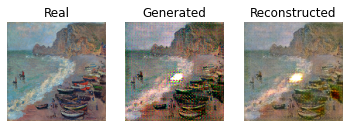

[INFO] Domain B to Domain A


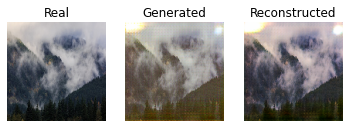

epoch: 91 step: 51 dA_loss: 0.048 dB_loss: 0.021 gAB_loss :4.119 gBA_loss: 3.897
epoch: 91 step: 52 dA_loss: 0.049 dB_loss: 0.010 gAB_loss :3.847 gBA_loss: 3.959
epoch: 91 step: 53 dA_loss: 0.073 dB_loss: 0.027 gAB_loss :3.961 gBA_loss: 3.884
epoch: 91 step: 54 dA_loss: 0.017 dB_loss: 0.025 gAB_loss :3.965 gBA_loss: 3.744
epoch: 91 step: 55 dA_loss: 0.034 dB_loss: 0.026 gAB_loss :3.804 gBA_loss: 3.571
epoch: 91 step: 56 dA_loss: 0.047 dB_loss: 0.029 gAB_loss :3.749 gBA_loss: 3.915
epoch: 91 step: 57 dA_loss: 0.014 dB_loss: 0.010 gAB_loss :3.514 gBA_loss: 3.690
epoch: 91 step: 58 dA_loss: 0.033 dB_loss: 0.009 gAB_loss :3.833 gBA_loss: 3.834
epoch: 91 step: 59 dA_loss: 0.021 dB_loss: 0.018 gAB_loss :3.623 gBA_loss: 3.507
epoch: 91 step: 60 dA_loss: 0.039 dB_loss: 0.033 gAB_loss :3.815 gBA_loss: 3.613
epoch: 91 step: 61 dA_loss: 0.016 dB_loss: 0.012 gAB_loss :3.721 gBA_loss: 3.776
epoch: 91 step: 62 dA_loss: 0.040 dB_loss: 0.016 gAB_loss :3.425 gBA_loss: 3.270
epoch: 91 step: 63 dA_loss: 

 92%|█████████▏| 92/100 [2:31:17<13:05, 98.25s/it]

epoch: 91 step: 73 dA_loss: 0.039 dB_loss: 0.021 gAB_loss :4.215 gBA_loss: 4.307
epoch: 92 step: 0 dA_loss: 0.019 dB_loss: 0.011 gAB_loss :3.859 gBA_loss: 3.845
[INFO] Domain A to Domain B


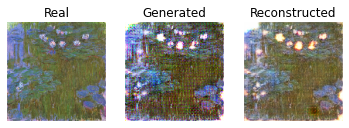

[INFO] Domain B to Domain A


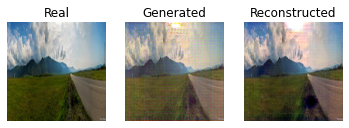

epoch: 92 step: 1 dA_loss: 0.018 dB_loss: 0.049 gAB_loss :3.992 gBA_loss: 3.707
epoch: 92 step: 2 dA_loss: 0.017 dB_loss: 0.085 gAB_loss :3.590 gBA_loss: 3.788
epoch: 92 step: 3 dA_loss: 0.013 dB_loss: 0.043 gAB_loss :3.483 gBA_loss: 3.403
epoch: 92 step: 4 dA_loss: 0.017 dB_loss: 0.012 gAB_loss :3.567 gBA_loss: 3.531
epoch: 92 step: 5 dA_loss: 0.033 dB_loss: 0.028 gAB_loss :3.888 gBA_loss: 3.630
epoch: 92 step: 6 dA_loss: 0.024 dB_loss: 0.017 gAB_loss :3.686 gBA_loss: 3.517
epoch: 92 step: 7 dA_loss: 0.032 dB_loss: 0.053 gAB_loss :3.307 gBA_loss: 3.101
epoch: 92 step: 8 dA_loss: 0.026 dB_loss: 0.031 gAB_loss :3.390 gBA_loss: 3.546
epoch: 92 step: 9 dA_loss: 0.024 dB_loss: 0.031 gAB_loss :3.390 gBA_loss: 3.342
epoch: 92 step: 10 dA_loss: 0.019 dB_loss: 0.012 gAB_loss :4.371 gBA_loss: 4.410
epoch: 92 step: 11 dA_loss: 0.021 dB_loss: 0.023 gAB_loss :3.946 gBA_loss: 3.787
epoch: 92 step: 12 dA_loss: 0.021 dB_loss: 0.012 gAB_loss :3.923 gBA_loss: 3.846
epoch: 92 step: 13 dA_loss: 0.008 dB_

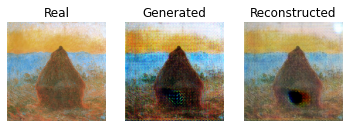

[INFO] Domain B to Domain A


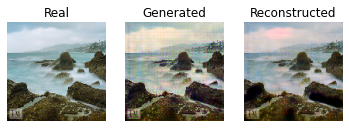

epoch: 92 step: 51 dA_loss: 0.006 dB_loss: 0.023 gAB_loss :4.185 gBA_loss: 3.921
epoch: 92 step: 52 dA_loss: 0.009 dB_loss: 0.019 gAB_loss :3.828 gBA_loss: 3.950
epoch: 92 step: 53 dA_loss: 0.016 dB_loss: 0.009 gAB_loss :3.861 gBA_loss: 3.714
epoch: 92 step: 54 dA_loss: 0.010 dB_loss: 0.016 gAB_loss :3.797 gBA_loss: 3.735
epoch: 92 step: 55 dA_loss: 0.033 dB_loss: 0.015 gAB_loss :3.764 gBA_loss: 3.842
epoch: 92 step: 56 dA_loss: 0.011 dB_loss: 0.015 gAB_loss :3.756 gBA_loss: 3.853
epoch: 92 step: 57 dA_loss: 0.007 dB_loss: 0.023 gAB_loss :3.497 gBA_loss: 3.611
epoch: 92 step: 58 dA_loss: 0.024 dB_loss: 0.010 gAB_loss :3.803 gBA_loss: 3.754
epoch: 92 step: 59 dA_loss: 0.011 dB_loss: 0.010 gAB_loss :3.601 gBA_loss: 3.407
epoch: 92 step: 60 dA_loss: 0.011 dB_loss: 0.014 gAB_loss :3.871 gBA_loss: 3.688
epoch: 92 step: 61 dA_loss: 0.005 dB_loss: 0.011 gAB_loss :3.706 gBA_loss: 3.753
epoch: 92 step: 62 dA_loss: 0.043 dB_loss: 0.015 gAB_loss :3.185 gBA_loss: 3.169
epoch: 92 step: 63 dA_loss: 

 93%|█████████▎| 93/100 [2:32:56<11:27, 98.24s/it]

epoch: 92 step: 73 dA_loss: 0.020 dB_loss: 0.008 gAB_loss :4.040 gBA_loss: 4.161
epoch: 93 step: 0 dA_loss: 0.011 dB_loss: 0.024 gAB_loss :3.854 gBA_loss: 3.897
[INFO] Domain A to Domain B


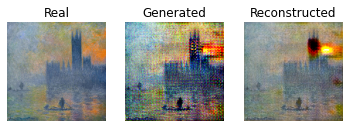

[INFO] Domain B to Domain A


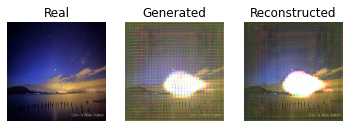

epoch: 93 step: 1 dA_loss: 0.006 dB_loss: 0.011 gAB_loss :4.001 gBA_loss: 3.815
epoch: 93 step: 2 dA_loss: 0.010 dB_loss: 0.016 gAB_loss :3.796 gBA_loss: 3.838
epoch: 93 step: 3 dA_loss: 0.012 dB_loss: 0.011 gAB_loss :3.544 gBA_loss: 3.466
epoch: 93 step: 4 dA_loss: 0.017 dB_loss: 0.006 gAB_loss :3.560 gBA_loss: 3.484
epoch: 93 step: 5 dA_loss: 0.007 dB_loss: 0.018 gAB_loss :3.913 gBA_loss: 3.679
epoch: 93 step: 6 dA_loss: 0.029 dB_loss: 0.006 gAB_loss :3.540 gBA_loss: 3.433
epoch: 93 step: 7 dA_loss: 0.016 dB_loss: 0.013 gAB_loss :3.065 gBA_loss: 3.111
epoch: 93 step: 8 dA_loss: 0.017 dB_loss: 0.022 gAB_loss :3.329 gBA_loss: 3.547
epoch: 93 step: 9 dA_loss: 0.013 dB_loss: 0.010 gAB_loss :3.528 gBA_loss: 3.361
epoch: 93 step: 10 dA_loss: 0.023 dB_loss: 0.017 gAB_loss :4.415 gBA_loss: 4.388
epoch: 93 step: 11 dA_loss: 0.011 dB_loss: 0.021 gAB_loss :3.799 gBA_loss: 3.696
epoch: 93 step: 12 dA_loss: 0.018 dB_loss: 0.026 gAB_loss :3.939 gBA_loss: 3.874
epoch: 93 step: 13 dA_loss: 0.008 dB_

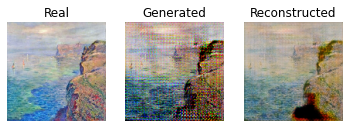

[INFO] Domain B to Domain A


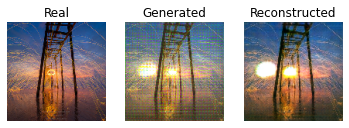

epoch: 93 step: 51 dA_loss: 0.007 dB_loss: 0.014 gAB_loss :3.985 gBA_loss: 3.932
epoch: 93 step: 52 dA_loss: 0.007 dB_loss: 0.017 gAB_loss :3.828 gBA_loss: 3.978
epoch: 93 step: 53 dA_loss: 0.005 dB_loss: 0.005 gAB_loss :3.872 gBA_loss: 3.758
epoch: 93 step: 54 dA_loss: 0.006 dB_loss: 0.011 gAB_loss :3.826 gBA_loss: 3.693
epoch: 93 step: 55 dA_loss: 0.008 dB_loss: 0.017 gAB_loss :3.719 gBA_loss: 3.660
epoch: 93 step: 56 dA_loss: 0.004 dB_loss: 0.012 gAB_loss :3.753 gBA_loss: 3.729
epoch: 93 step: 57 dA_loss: 0.008 dB_loss: 0.006 gAB_loss :3.493 gBA_loss: 3.604
epoch: 93 step: 58 dA_loss: 0.006 dB_loss: 0.006 gAB_loss :3.756 gBA_loss: 3.818
epoch: 93 step: 59 dA_loss: 0.008 dB_loss: 0.010 gAB_loss :3.564 gBA_loss: 3.368
epoch: 93 step: 60 dA_loss: 0.006 dB_loss: 0.025 gAB_loss :3.863 gBA_loss: 3.468
epoch: 93 step: 61 dA_loss: 0.007 dB_loss: 0.009 gAB_loss :3.752 gBA_loss: 3.669
epoch: 93 step: 62 dA_loss: 0.012 dB_loss: 0.029 gAB_loss :3.178 gBA_loss: 3.446
epoch: 93 step: 63 dA_loss: 

 94%|█████████▍| 94/100 [2:34:34<09:49, 98.23s/it]

epoch: 93 step: 73 dA_loss: 0.007 dB_loss: 0.009 gAB_loss :4.086 gBA_loss: 4.178
epoch: 94 step: 0 dA_loss: 0.006 dB_loss: 0.007 gAB_loss :3.792 gBA_loss: 3.782
[INFO] Domain A to Domain B


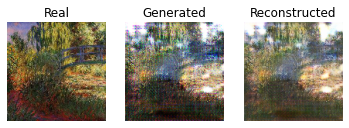

[INFO] Domain B to Domain A


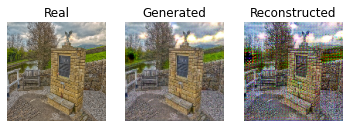

epoch: 94 step: 1 dA_loss: 0.004 dB_loss: 0.026 gAB_loss :3.913 gBA_loss: 3.708
epoch: 94 step: 2 dA_loss: 0.005 dB_loss: 0.031 gAB_loss :3.704 gBA_loss: 3.705
epoch: 94 step: 3 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.484 gBA_loss: 3.384
epoch: 94 step: 4 dA_loss: 0.008 dB_loss: 0.007 gAB_loss :3.515 gBA_loss: 3.535
epoch: 94 step: 5 dA_loss: 0.008 dB_loss: 0.009 gAB_loss :3.956 gBA_loss: 3.606
epoch: 94 step: 6 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :3.547 gBA_loss: 3.493
epoch: 94 step: 7 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :3.062 gBA_loss: 3.100
epoch: 94 step: 8 dA_loss: 0.007 dB_loss: 0.013 gAB_loss :3.323 gBA_loss: 3.486
epoch: 94 step: 9 dA_loss: 0.008 dB_loss: 0.009 gAB_loss :3.463 gBA_loss: 3.316
epoch: 94 step: 10 dA_loss: 0.007 dB_loss: 0.008 gAB_loss :4.413 gBA_loss: 4.478
epoch: 94 step: 11 dA_loss: 0.003 dB_loss: 0.009 gAB_loss :3.843 gBA_loss: 3.753
epoch: 94 step: 12 dA_loss: 0.008 dB_loss: 0.016 gAB_loss :3.700 gBA_loss: 3.761
epoch: 94 step: 13 dA_loss: 0.002 dB_

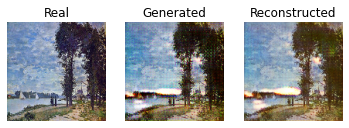

[INFO] Domain B to Domain A


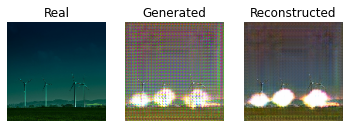

epoch: 94 step: 51 dA_loss: 0.003 dB_loss: 0.006 gAB_loss :4.045 gBA_loss: 3.876
epoch: 94 step: 52 dA_loss: 0.004 dB_loss: 0.008 gAB_loss :3.802 gBA_loss: 3.928
epoch: 94 step: 53 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :3.821 gBA_loss: 3.776
epoch: 94 step: 54 dA_loss: 0.002 dB_loss: 0.010 gAB_loss :3.827 gBA_loss: 3.670
epoch: 94 step: 55 dA_loss: 0.007 dB_loss: 0.012 gAB_loss :3.749 gBA_loss: 3.677
epoch: 94 step: 56 dA_loss: 0.006 dB_loss: 0.016 gAB_loss :3.737 gBA_loss: 3.710
epoch: 94 step: 57 dA_loss: 0.003 dB_loss: 0.009 gAB_loss :3.419 gBA_loss: 3.602
epoch: 94 step: 58 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :3.699 gBA_loss: 3.840
epoch: 94 step: 59 dA_loss: 0.005 dB_loss: 0.011 gAB_loss :3.575 gBA_loss: 3.435
epoch: 94 step: 60 dA_loss: 0.004 dB_loss: 0.010 gAB_loss :3.837 gBA_loss: 3.497
epoch: 94 step: 61 dA_loss: 0.002 dB_loss: 0.011 gAB_loss :3.818 gBA_loss: 3.689
epoch: 94 step: 62 dA_loss: 0.006 dB_loss: 0.015 gAB_loss :3.268 gBA_loss: 3.354
epoch: 94 step: 63 dA_loss: 

 95%|█████████▌| 95/100 [2:36:12<08:11, 98.25s/it]

epoch: 94 step: 73 dA_loss: 0.002 dB_loss: 0.012 gAB_loss :4.142 gBA_loss: 4.251
epoch: 95 step: 0 dA_loss: 0.003 dB_loss: 0.010 gAB_loss :3.833 gBA_loss: 3.803
[INFO] Domain A to Domain B


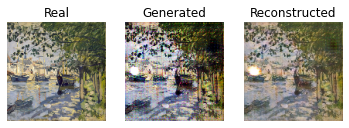

[INFO] Domain B to Domain A


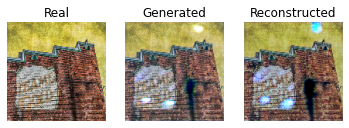

epoch: 95 step: 1 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :3.880 gBA_loss: 3.751
epoch: 95 step: 2 dA_loss: 0.003 dB_loss: 0.012 gAB_loss :3.765 gBA_loss: 3.746
epoch: 95 step: 3 dA_loss: 0.002 dB_loss: 0.011 gAB_loss :3.567 gBA_loss: 3.370
epoch: 95 step: 4 dA_loss: 0.003 dB_loss: 0.006 gAB_loss :3.540 gBA_loss: 3.537
epoch: 95 step: 5 dA_loss: 0.003 dB_loss: 0.008 gAB_loss :3.922 gBA_loss: 3.730
epoch: 95 step: 6 dA_loss: 0.004 dB_loss: 0.004 gAB_loss :3.563 gBA_loss: 3.507
epoch: 95 step: 7 dA_loss: 0.007 dB_loss: 0.010 gAB_loss :3.021 gBA_loss: 3.117
epoch: 95 step: 8 dA_loss: 0.005 dB_loss: 0.007 gAB_loss :3.270 gBA_loss: 3.446
epoch: 95 step: 9 dA_loss: 0.009 dB_loss: 0.006 gAB_loss :3.465 gBA_loss: 3.334
epoch: 95 step: 10 dA_loss: 0.003 dB_loss: 0.009 gAB_loss :4.418 gBA_loss: 4.490
epoch: 95 step: 11 dA_loss: 0.003 dB_loss: 0.006 gAB_loss :3.937 gBA_loss: 3.748
epoch: 95 step: 12 dA_loss: 0.003 dB_loss: 0.010 gAB_loss :3.800 gBA_loss: 3.831
epoch: 95 step: 13 dA_loss: 0.003 dB_

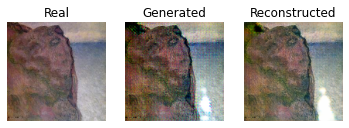

[INFO] Domain B to Domain A


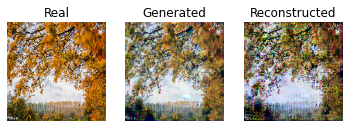

epoch: 95 step: 51 dA_loss: 0.017 dB_loss: 0.014 gAB_loss :3.961 gBA_loss: 3.828
epoch: 95 step: 52 dA_loss: 0.009 dB_loss: 0.008 gAB_loss :3.702 gBA_loss: 3.926
epoch: 95 step: 53 dA_loss: 0.010 dB_loss: 0.007 gAB_loss :3.720 gBA_loss: 3.741
epoch: 95 step: 54 dA_loss: 0.002 dB_loss: 0.008 gAB_loss :3.758 gBA_loss: 3.657
epoch: 95 step: 55 dA_loss: 0.018 dB_loss: 0.012 gAB_loss :3.728 gBA_loss: 3.605
epoch: 95 step: 56 dA_loss: 0.005 dB_loss: 0.009 gAB_loss :3.741 gBA_loss: 3.679
epoch: 95 step: 57 dA_loss: 0.006 dB_loss: 0.007 gAB_loss :3.458 gBA_loss: 3.560
epoch: 95 step: 58 dA_loss: 0.023 dB_loss: 0.010 gAB_loss :3.660 gBA_loss: 3.892
epoch: 95 step: 59 dA_loss: 0.006 dB_loss: 0.007 gAB_loss :3.462 gBA_loss: 3.393
epoch: 95 step: 60 dA_loss: 0.040 dB_loss: 0.012 gAB_loss :3.767 gBA_loss: 3.389
epoch: 95 step: 61 dA_loss: 0.008 dB_loss: 0.011 gAB_loss :3.735 gBA_loss: 3.532
epoch: 95 step: 62 dA_loss: 0.023 dB_loss: 0.007 gAB_loss :3.366 gBA_loss: 3.244
epoch: 95 step: 63 dA_loss: 

 96%|█████████▌| 96/100 [2:37:50<06:33, 98.26s/it]

epoch: 95 step: 73 dA_loss: 0.008 dB_loss: 0.024 gAB_loss :4.156 gBA_loss: 4.205
epoch: 96 step: 0 dA_loss: 0.013 dB_loss: 0.012 gAB_loss :3.821 gBA_loss: 3.968
[INFO] Domain A to Domain B


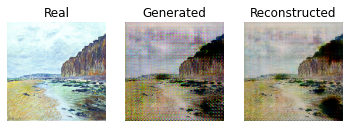

[INFO] Domain B to Domain A


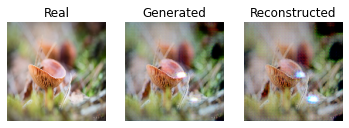

epoch: 96 step: 1 dA_loss: 0.003 dB_loss: 0.024 gAB_loss :3.928 gBA_loss: 3.651
epoch: 96 step: 2 dA_loss: 0.005 dB_loss: 0.015 gAB_loss :3.684 gBA_loss: 3.741
epoch: 96 step: 3 dA_loss: 0.003 dB_loss: 0.014 gAB_loss :3.496 gBA_loss: 3.403
epoch: 96 step: 4 dA_loss: 0.008 dB_loss: 0.005 gAB_loss :3.494 gBA_loss: 3.450
epoch: 96 step: 5 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :3.883 gBA_loss: 3.671
epoch: 96 step: 6 dA_loss: 0.004 dB_loss: 0.007 gAB_loss :3.513 gBA_loss: 3.443
epoch: 96 step: 7 dA_loss: 0.004 dB_loss: 0.019 gAB_loss :3.065 gBA_loss: 3.048
epoch: 96 step: 8 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.206 gBA_loss: 3.424
epoch: 96 step: 9 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :3.319 gBA_loss: 3.188
epoch: 96 step: 10 dA_loss: 0.009 dB_loss: 0.008 gAB_loss :4.282 gBA_loss: 4.396
epoch: 96 step: 11 dA_loss: 0.007 dB_loss: 0.011 gAB_loss :3.848 gBA_loss: 3.678
epoch: 96 step: 12 dA_loss: 0.004 dB_loss: 0.008 gAB_loss :3.825 gBA_loss: 3.664
epoch: 96 step: 13 dA_loss: 0.004 dB_

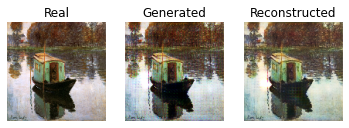

[INFO] Domain B to Domain A


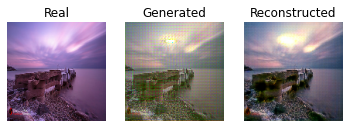

epoch: 96 step: 51 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.965 gBA_loss: 3.827
epoch: 96 step: 52 dA_loss: 0.014 dB_loss: 0.005 gAB_loss :3.756 gBA_loss: 3.796
epoch: 96 step: 53 dA_loss: 0.003 dB_loss: 0.005 gAB_loss :3.738 gBA_loss: 3.589
epoch: 96 step: 54 dA_loss: 0.005 dB_loss: 0.005 gAB_loss :3.725 gBA_loss: 3.581
epoch: 96 step: 55 dA_loss: 0.025 dB_loss: 0.014 gAB_loss :3.681 gBA_loss: 3.778
epoch: 96 step: 56 dA_loss: 0.007 dB_loss: 0.006 gAB_loss :3.712 gBA_loss: 3.814
epoch: 96 step: 57 dA_loss: 0.010 dB_loss: 0.005 gAB_loss :3.443 gBA_loss: 3.509
epoch: 96 step: 58 dA_loss: 0.021 dB_loss: 0.005 gAB_loss :3.691 gBA_loss: 3.705
epoch: 96 step: 59 dA_loss: 0.014 dB_loss: 0.007 gAB_loss :3.464 gBA_loss: 3.286
epoch: 96 step: 60 dA_loss: 0.008 dB_loss: 0.007 gAB_loss :3.627 gBA_loss: 3.478
epoch: 96 step: 61 dA_loss: 0.005 dB_loss: 0.015 gAB_loss :3.678 gBA_loss: 3.648
epoch: 96 step: 62 dA_loss: 0.027 dB_loss: 0.016 gAB_loss :3.321 gBA_loss: 3.090
epoch: 96 step: 63 dA_loss: 

 97%|█████████▋| 97/100 [2:39:29<04:54, 98.28s/it]

epoch: 96 step: 73 dA_loss: 0.014 dB_loss: 0.042 gAB_loss :4.198 gBA_loss: 4.319
epoch: 97 step: 0 dA_loss: 0.011 dB_loss: 0.012 gAB_loss :3.838 gBA_loss: 3.733
[INFO] Domain A to Domain B


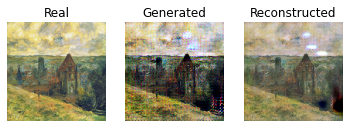

[INFO] Domain B to Domain A


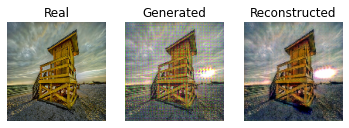

epoch: 97 step: 1 dA_loss: 0.004 dB_loss: 0.020 gAB_loss :3.792 gBA_loss: 3.623
epoch: 97 step: 2 dA_loss: 0.004 dB_loss: 0.016 gAB_loss :3.736 gBA_loss: 3.626
epoch: 97 step: 3 dA_loss: 0.005 dB_loss: 0.012 gAB_loss :3.536 gBA_loss: 3.335
epoch: 97 step: 4 dA_loss: 0.010 dB_loss: 0.010 gAB_loss :3.504 gBA_loss: 3.526
epoch: 97 step: 5 dA_loss: 0.010 dB_loss: 0.014 gAB_loss :3.817 gBA_loss: 3.580
epoch: 97 step: 6 dA_loss: 0.006 dB_loss: 0.009 gAB_loss :3.505 gBA_loss: 3.425
epoch: 97 step: 7 dA_loss: 0.003 dB_loss: 0.020 gAB_loss :3.117 gBA_loss: 3.019
epoch: 97 step: 8 dA_loss: 0.014 dB_loss: 0.017 gAB_loss :3.218 gBA_loss: 3.435
epoch: 97 step: 9 dA_loss: 0.007 dB_loss: 0.009 gAB_loss :3.382 gBA_loss: 3.299
epoch: 97 step: 10 dA_loss: 0.006 dB_loss: 0.009 gAB_loss :4.303 gBA_loss: 4.364
epoch: 97 step: 11 dA_loss: 0.007 dB_loss: 0.005 gAB_loss :3.801 gBA_loss: 3.665
epoch: 97 step: 12 dA_loss: 0.016 dB_loss: 0.012 gAB_loss :3.800 gBA_loss: 3.803
epoch: 97 step: 13 dA_loss: 0.006 dB_

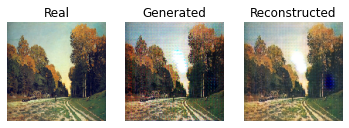

[INFO] Domain B to Domain A


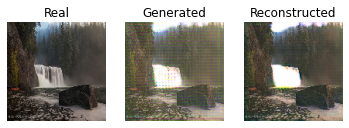

epoch: 97 step: 51 dA_loss: 0.074 dB_loss: 0.005 gAB_loss :3.985 gBA_loss: 3.974
epoch: 97 step: 52 dA_loss: 0.096 dB_loss: 0.008 gAB_loss :3.709 gBA_loss: 3.844
epoch: 97 step: 53 dA_loss: 0.032 dB_loss: 0.006 gAB_loss :3.724 gBA_loss: 3.716
epoch: 97 step: 54 dA_loss: 0.012 dB_loss: 0.015 gAB_loss :3.797 gBA_loss: 3.587
epoch: 97 step: 55 dA_loss: 0.096 dB_loss: 0.011 gAB_loss :3.742 gBA_loss: 3.731
epoch: 97 step: 56 dA_loss: 0.041 dB_loss: 0.017 gAB_loss :3.687 gBA_loss: 3.666
epoch: 97 step: 57 dA_loss: 0.058 dB_loss: 0.007 gAB_loss :3.375 gBA_loss: 3.457
epoch: 97 step: 58 dA_loss: 0.023 dB_loss: 0.014 gAB_loss :3.727 gBA_loss: 3.689
epoch: 97 step: 59 dA_loss: 0.012 dB_loss: 0.008 gAB_loss :3.500 gBA_loss: 3.357
epoch: 97 step: 60 dA_loss: 0.014 dB_loss: 0.017 gAB_loss :3.600 gBA_loss: 3.409
epoch: 97 step: 61 dA_loss: 0.021 dB_loss: 0.024 gAB_loss :3.655 gBA_loss: 3.570
epoch: 97 step: 62 dA_loss: 0.060 dB_loss: 0.019 gAB_loss :3.498 gBA_loss: 3.299
epoch: 97 step: 63 dA_loss: 

 98%|█████████▊| 98/100 [2:41:07<03:16, 98.30s/it]

epoch: 97 step: 73 dA_loss: 0.015 dB_loss: 0.009 gAB_loss :4.031 gBA_loss: 4.130
epoch: 98 step: 0 dA_loss: 0.025 dB_loss: 0.015 gAB_loss :3.691 gBA_loss: 3.831
[INFO] Domain A to Domain B


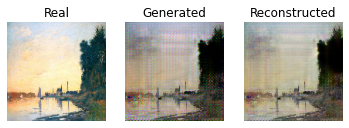

[INFO] Domain B to Domain A


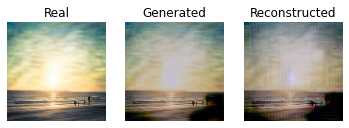

epoch: 98 step: 1 dA_loss: 0.009 dB_loss: 0.012 gAB_loss :3.795 gBA_loss: 3.773
epoch: 98 step: 2 dA_loss: 0.007 dB_loss: 0.011 gAB_loss :3.699 gBA_loss: 3.646
epoch: 98 step: 3 dA_loss: 0.011 dB_loss: 0.013 gAB_loss :3.555 gBA_loss: 3.319
epoch: 98 step: 4 dA_loss: 0.021 dB_loss: 0.006 gAB_loss :3.505 gBA_loss: 3.418
epoch: 98 step: 5 dA_loss: 0.023 dB_loss: 0.011 gAB_loss :3.803 gBA_loss: 3.591
epoch: 98 step: 6 dA_loss: 0.027 dB_loss: 0.005 gAB_loss :3.455 gBA_loss: 3.439
epoch: 98 step: 7 dA_loss: 0.029 dB_loss: 0.009 gAB_loss :2.963 gBA_loss: 3.045
epoch: 98 step: 8 dA_loss: 0.015 dB_loss: 0.021 gAB_loss :3.364 gBA_loss: 3.446
epoch: 98 step: 9 dA_loss: 0.027 dB_loss: 0.009 gAB_loss :3.449 gBA_loss: 3.324
epoch: 98 step: 10 dA_loss: 0.022 dB_loss: 0.006 gAB_loss :4.322 gBA_loss: 4.428
epoch: 98 step: 11 dA_loss: 0.009 dB_loss: 0.016 gAB_loss :3.782 gBA_loss: 3.672
epoch: 98 step: 12 dA_loss: 0.008 dB_loss: 0.007 gAB_loss :3.717 gBA_loss: 3.754
epoch: 98 step: 13 dA_loss: 0.005 dB_

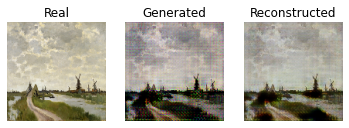

[INFO] Domain B to Domain A


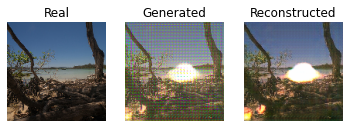

epoch: 98 step: 51 dA_loss: 0.010 dB_loss: 0.012 gAB_loss :3.936 gBA_loss: 3.822
epoch: 98 step: 52 dA_loss: 0.018 dB_loss: 0.017 gAB_loss :3.829 gBA_loss: 4.004
epoch: 98 step: 53 dA_loss: 0.003 dB_loss: 0.016 gAB_loss :3.805 gBA_loss: 3.746
epoch: 98 step: 54 dA_loss: 0.006 dB_loss: 0.012 gAB_loss :3.774 gBA_loss: 3.602
epoch: 98 step: 55 dA_loss: 0.013 dB_loss: 0.024 gAB_loss :3.777 gBA_loss: 3.606
epoch: 98 step: 56 dA_loss: 0.006 dB_loss: 0.030 gAB_loss :3.605 gBA_loss: 3.647
epoch: 98 step: 57 dA_loss: 0.008 dB_loss: 0.009 gAB_loss :3.319 gBA_loss: 3.481
epoch: 98 step: 58 dA_loss: 0.012 dB_loss: 0.017 gAB_loss :3.707 gBA_loss: 3.665
epoch: 98 step: 59 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :3.513 gBA_loss: 3.216
epoch: 98 step: 60 dA_loss: 0.011 dB_loss: 0.014 gAB_loss :3.717 gBA_loss: 3.342
epoch: 98 step: 61 dA_loss: 0.004 dB_loss: 0.008 gAB_loss :3.593 gBA_loss: 3.569
epoch: 98 step: 62 dA_loss: 0.018 dB_loss: 0.009 gAB_loss :3.221 gBA_loss: 3.188
epoch: 98 step: 63 dA_loss: 

 99%|█████████▉| 99/100 [2:42:46<01:38, 98.33s/it]

epoch: 98 step: 73 dA_loss: 0.007 dB_loss: 0.008 gAB_loss :3.996 gBA_loss: 4.067
epoch: 99 step: 0 dA_loss: 0.007 dB_loss: 0.017 gAB_loss :3.625 gBA_loss: 3.771
[INFO] Domain A to Domain B


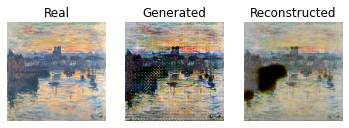

[INFO] Domain B to Domain A


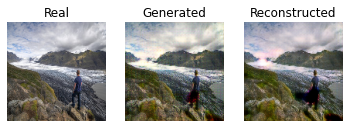

epoch: 99 step: 1 dA_loss: 0.003 dB_loss: 0.021 gAB_loss :3.852 gBA_loss: 3.611
epoch: 99 step: 2 dA_loss: 0.007 dB_loss: 0.016 gAB_loss :3.668 gBA_loss: 3.784
epoch: 99 step: 3 dA_loss: 0.004 dB_loss: 0.015 gAB_loss :3.507 gBA_loss: 3.337
epoch: 99 step: 4 dA_loss: 0.006 dB_loss: 0.005 gAB_loss :3.485 gBA_loss: 3.440
epoch: 99 step: 5 dA_loss: 0.004 dB_loss: 0.015 gAB_loss :3.731 gBA_loss: 3.545
epoch: 99 step: 6 dA_loss: 0.004 dB_loss: 0.017 gAB_loss :3.448 gBA_loss: 3.354
epoch: 99 step: 7 dA_loss: 0.006 dB_loss: 0.021 gAB_loss :3.103 gBA_loss: 3.042
epoch: 99 step: 8 dA_loss: 0.005 dB_loss: 0.010 gAB_loss :3.192 gBA_loss: 3.405
epoch: 99 step: 9 dA_loss: 0.004 dB_loss: 0.010 gAB_loss :3.326 gBA_loss: 3.192
epoch: 99 step: 10 dA_loss: 0.011 dB_loss: 0.011 gAB_loss :4.267 gBA_loss: 4.386
epoch: 99 step: 11 dA_loss: 0.005 dB_loss: 0.007 gAB_loss :3.789 gBA_loss: 3.768
epoch: 99 step: 12 dA_loss: 0.004 dB_loss: 0.009 gAB_loss :3.688 gBA_loss: 3.604
epoch: 99 step: 13 dA_loss: 0.004 dB_

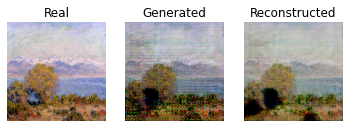

[INFO] Domain B to Domain A


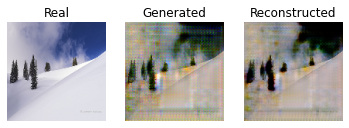

epoch: 99 step: 51 dA_loss: 0.004 dB_loss: 0.007 gAB_loss :3.863 gBA_loss: 3.861
epoch: 99 step: 52 dA_loss: 0.004 dB_loss: 0.013 gAB_loss :3.782 gBA_loss: 3.856
epoch: 99 step: 53 dA_loss: 0.002 dB_loss: 0.004 gAB_loss :3.762 gBA_loss: 3.673
epoch: 99 step: 54 dA_loss: 0.003 dB_loss: 0.006 gAB_loss :3.710 gBA_loss: 3.536
epoch: 99 step: 55 dA_loss: 0.007 dB_loss: 0.007 gAB_loss :3.640 gBA_loss: 3.576
epoch: 99 step: 56 dA_loss: 0.005 dB_loss: 0.008 gAB_loss :3.696 gBA_loss: 3.664
epoch: 99 step: 57 dA_loss: 0.007 dB_loss: 0.011 gAB_loss :3.384 gBA_loss: 3.460
epoch: 99 step: 58 dA_loss: 0.005 dB_loss: 0.008 gAB_loss :3.595 gBA_loss: 3.683
epoch: 99 step: 59 dA_loss: 0.006 dB_loss: 0.008 gAB_loss :3.440 gBA_loss: 3.257
epoch: 99 step: 60 dA_loss: 0.002 dB_loss: 0.048 gAB_loss :3.831 gBA_loss: 3.304
epoch: 99 step: 61 dA_loss: 0.003 dB_loss: 0.042 gAB_loss :3.575 gBA_loss: 3.539
epoch: 99 step: 62 dA_loss: 0.006 dB_loss: 0.072 gAB_loss :3.215 gBA_loss: 3.179
epoch: 99 step: 63 dA_loss: 

100%|██████████| 100/100 [2:44:24<00:00, 98.65s/it]

epoch: 99 step: 73 dA_loss: 0.003 dB_loss: 0.045 gAB_loss :4.009 gBA_loss: 4.065


In [43]:
# training loop
for epoch in tqdm(range(epochs)):
    # reset the iterators after each epoch
    iter_A = iter(data_A_TF)
    iter_B = iter(data_B_TF)
    # iterate through the steps per epoch
    for step in range(steps_per_epoch):
        # get the images
        images_A = iter_A.next()
        images_B = iter_B.next()

        # train the discriminator A
        dA_loss = train_discriminator_A(d_model_A, g_model_BtoA, images_B, images_A, d_model_A_opt)
        disc_A_metric(dA_loss)

        # train the discriminator B
        dB_loss = train_discriminator_B(d_model_B, g_model_AtoB, images_A, images_B, d_model_B_opt)
        disc_B_metric(dB_loss)

        # train generator AB
        gen_AB_loss = train_generator_AB(d_model_B, g_model_AtoB, g_model_BtoA, images_A, images_B, g_AtoB_opt)
        gen_AB_metric(gen_AB_loss)

        # train generator BA
        gen_BA_loss = train_generator_BA(d_model_A, g_model_BtoA, g_model_AtoB, images_B, images_A, g_BtoA_opt)
        gen_BA_metric(gen_BA_loss)

        # logging
        print(f"epoch: {epoch} step: {step} dA_loss: {disc_A_metric.result():.3f} dB_loss: {disc_B_metric.result():.3f} "
            f"gAB_loss :{gen_AB_metric.result():.3f} gBA_loss: {gen_BA_metric.result():.3f}")

        # visualization
        if step % visualize_every == 0:
            show_model_progress(g_model_AtoB, g_model_BtoA, scaled_dataA, scaled_dataB)

        # reset metrics
        disc_A_metric.reset_states()
        disc_B_metric.reset_states()
        gen_AB_metric.reset_states()
        gen_BA_metric.reset_states()

## Demo prediction on new images

In [0]:
def load_image(filename, size=(128,128)):
	# load and resize the image
	pixels = load_img(filename, target_size=size)
	# convert to numpy array
	pixels = img_to_array(pixels)
	# scale pixels to [-1,1]
	pixels = (pixels - 127.5) / 127.5
    # return the pixel array with batch dimension added
	return np.expand_dims(np.array(pixels), axis=0)

# plot the image, the translation, and the reconstruction
def show_plot(imagesX, imagesY1, imagesY2):
	images = np.vstack((imagesX, imagesY1, imagesY2))
	titles = ['Real', 'Generated', 'Reconstructed']
	# scale from [-1,1] to [0,1]
	images = (images + 1) / 2.0
	# plot images row by row
	for i in range(len(images)):
		# define subplot
		plt.subplot(1, len(images), 1 + i)
		# turn off axis
		plt.axis('off')
		# plot raw pixel data
		plt.imshow(images[i])
		# title
		plt.title(titles[i])
	plt.show()
 
def show_inference(g_model_BtoA, g_model_AtoB, filename):
	# load, generate, reconstruct, and show
	pixels = load_image(filename)
	generated  = g_model_BtoA(pixels)
	reconstructed = g_model_AtoB(generated)
	show_plot(pixels, generated, reconstructed)

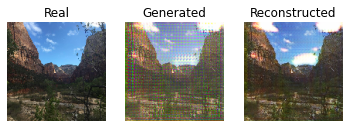

In [81]:
show_inference(g_model_BtoA, g_model_AtoB, "1.jpg")

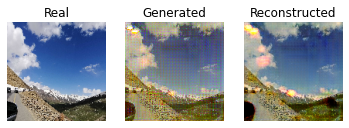

In [82]:
show_inference(g_model_BtoA, g_model_AtoB, "2.jpg")

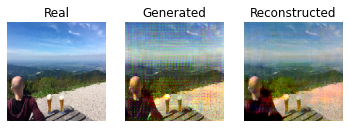

In [83]:
show_inference(g_model_BtoA, g_model_AtoB, "3.jpg")

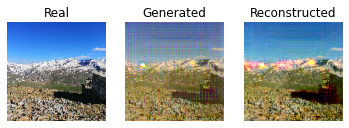

In [84]:
show_inference(g_model_BtoA, g_model_AtoB, "4.jpg")